# GPT-2 Adoption

Code from https://github.com/graykode/gpt-2-Pytorch

In [1]:
import copy
import torch
import math
import torch.nn as nn
from torch.nn.parameter import Parameter


In [2]:
import random
import numpy as np

# Reproducibility
seed = random.randint(0, 2147483647)
np.random.seed(seed)
torch.random.manual_seed(seed)
torch.cuda.manual_seed(seed)

# GPU or CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

#### 
# GPTConfig - HuggingFace style

In [3]:
class GPT2Config(object):
    def __init__(
            self,
            vocab_size_or_config_json_file=50257,
            n_positions=1024,
            n_ctx=1024,
            n_embd=768,
            n_layer=12,
            n_head=12,
            layer_norm_epsilon=1e-5,
            initializer_range=0.02,
            pdrop=0.1,
    ):
        self.vocab_size = vocab_size_or_config_json_file
        self.n_ctx = n_ctx
        self.n_positions = n_positions
        self.n_embd = n_embd
        self.n_layer = n_layer
        self.n_head = n_head
        self.layer_norm_epsilon = layer_norm_epsilon
        self.initializer_range = initializer_range
        self.pdrop = pdrop

#### 
# Wandb managing experiments

In [4]:
import wandb

is_experimenting = False

if is_experimenting:
    wandb.init(project="PACT-replica", entity="tst008")
    !wandb on

#### 
# Creating Model

Layer Norm: $y = \frac{x-E[x]}{\sqrt{Var[x] + \epsilon}} * \gamma + \beta$

- Where x is a mini-batch of input, with dimension `normalized_shape`.
- $\gamma$ and $\beta$ are $\textit{learnable}$ affine transform parameters

In [5]:
class LayerNorm(nn.Module):
    def __init__(self, hidden_size, eps=1e-12):
        """Construct a layernorm module in the TF style (epsilon inside the square root).
        """
        super(LayerNorm, self).__init__()
        self.weight = nn.Parameter(torch.ones(hidden_size))
        self.bias = nn.Parameter(torch.zeros(hidden_size))
        self.variance_epsilon = eps

    def forward(self, x):
        u = x.mean(-1, keepdim=True)
        s = (x - u).pow(2).mean(-1, keepdim=True)
        x = (x - u) / torch.sqrt(s + self.variance_epsilon)
        return self.weight * x + self.bias

In [6]:
batch, sentence_length, embedding_dim = 20, 5, 10
embedding = torch.randn(batch, sentence_length, embedding_dim)
layer_norm = LayerNorm(embedding_dim)
layer_norm(embedding).shape

torch.Size([20, 5, 10])

- Input: $N, C, L$, Output: $N, C, L_o$

$out(N, C_j) =  bias(C_j) + \sum^{C_i - 1}_{k=1}w(C_j, k) * inp(N_i, k)$

In [7]:
class Conv1D(nn.Module):
    def __init__(self, nf, nx):
        super(Conv1D, self).__init__()
        self.nf = nf
        self.nx = nx
        w = torch.empty(nx, nf)
        nn.init.normal_(w, std=0.02)
        self.weight = Parameter(w)
        self.bias = Parameter(torch.zeros(nf))

    def forward(self, x):
        assert self.nx == x.shape[-1], f"Shape mismatched, expected shape: {list(x.shape[:-1])+[self.nx]}, got shape: {list(x.shape)}"
        size_out = x.size()[:-1] + (self.nf,)
        x = torch.addmm(self.bias, x.view(-1, x.size(-1)), self.weight)
        x = x.view(*size_out)
        return x

In [8]:
m = Conv1D(10, 50)
i = torch.randn(20, 16, 50)
m(i).shape

torch.Size([20, 16, 10])

Applies multi-head attention 

- Query: representation of current word used to score against other words
- Key: labels for all potentially relevant words in segment
- Value: Actual word representations. Relevancy of each word is added up to represent current word

Input size, output size??
https://jalammar.github.io/illustrated-gpt2/

In [9]:
class Attention(nn.Module):
    def __init__(self, nx, n_ctx, config, scale=False):
        super(Attention, self).__init__()
        n_state = nx  # in Attention: n_state=768 (nx=n_embd)
        # [switch nx => n_state from Block to Attention to keep identical to TF implem]
        assert n_state % config.n_head == 0
        self.register_buffer("bias", torch.tril(torch.ones(n_ctx, n_ctx)).view(1, 1, n_ctx, n_ctx))
        self.n_head = config.n_head
        self.split_size = n_state
        self.scale = scale
        self.c_attn = Conv1D(n_state * 3, nx)
        self.c_proj = Conv1D(n_state, nx)
        self.attn_drop = nn.Dropout(config.pdrop, inplace=False)
        self.resid_drop = nn.Dropout(config.pdrop, inplace=False)

    def _attn(self, q, k, v):
        w = torch.matmul(q, k)
        if self.scale:
            w = w / math.sqrt(v.size(-1))
        nd, ns = w.size(-2), w.size(-1)
        try:
            b = self.bias[:, :, ns-nd:ns, :ns]
            w = w * b - 1e10 * (1 - b)
            w = nn.Softmax(dim=-1)(w)
        except:
            print(b.shape, w.shape)
            raise
        return w, torch.matmul(w, v)

    def merge_heads(self, x):
        x = x.permute(0, 2, 1, 3).contiguous()
        new_x_shape = x.size()[:-2] + (x.size(-2) * x.size(-1),)
        return x.view(*new_x_shape)  # in Tensorflow implem: fct merge_states

    def split_heads(self, x, k=False):
        new_x_shape = x.size()[:-1] + (self.n_head, x.size(-1) // self.n_head)
        x = x.view(*new_x_shape)  # in Tensorflow implem: fct split_states
        if k:
            return x.permute(0, 2, 3, 1)  # (batch, head, head_features, seq_length)
        else:
            return x.permute(0, 2, 1, 3)  # (batch, head, seq_length, head_features)

    def forward(self, x, layer_past=None):
        # Begin by looking at the shape of all these
#         print(f"x:{x.shape}")
        x = self.c_attn(x)
#         print(f"(after c_attn) x:{x.shape}")
        query, key, value = x.split(self.split_size, dim=2)
#         print(f"query:{query.shape}, key:{key.shape}, value:{value.shape},")
        query = self.split_heads(query)
        key = self.split_heads(key, k=True)
        value = self.split_heads(value)
#         print(f"(after split_heads()) query:{query.shape}, key:{key.shape}, value:{value.shape},")
        if layer_past is not None:
            past_key, past_value = layer_past[0].transpose(-2, -1), layer_past[1]  # transpose back cf below
            key = torch.cat((past_key, key), dim=-1)
            value = torch.cat((past_value, value), dim=-2)
#             print(f"(in if layer_past is not None) query:{query.shape}, key:{key.shape}, value:{value.shape},")
        present = torch.stack((key.transpose(-2, -1), value))  # transpose to have same shapes for stacking
#         print(f"present:{present.shape}")
        w, a = self._attn(query, key, value)
#         print(f"(output of _attn) a:{a.shape}")
        a = self.merge_heads(a)
#         print(f"(output of merge_heads) a:{a.shape}")
        a = self.c_proj(a)
#         print(f"(output of c_proj) a:{a.shape}")
        a = self.resid_drop(a)
#         print(f"(output of resid_drop) a:{a.shape}")
        return a, present, w # Present key and values?

In [10]:
# TODO: Test Masked before softmax, 

In [11]:
w = torch.ones([1, 1, 1024, 1024]) #torch.Size([1, 12, 1760, 1760])
b = torch.ones([1, 12,])
nd, ns = w.size(-2), w.size(-1)
nd, ns

(1024, 1024)

Applies the Gaussian Error Linear Units function:
    
$y = x * \Phi(x)$

where $\Phi(x)$ is the Cumulative Distribution Function for Gaussian Distribution

... tho I'm not seeing that here

In [12]:
def gelu(x):
    return 0.5 * x * (1 + torch.tanh(math.sqrt(2 / math.pi) * (x + 0.044715 * torch.pow(x, 3))))

In [13]:
gelu(torch.randn(2))

tensor([-0.1044,  0.0534])

Conv1D(n_state, n_embd) $\implies$ gelu $\implies$ Conv1D(n_embd, n_state)  

In [14]:
class MLP(nn.Module):
    def __init__(self, n_state, config):  # in MLP: n_state=3072 (4 * n_embd)
        super(MLP, self).__init__()
        nx = config.n_embd
        self.c_fc = Conv1D(n_state, nx)
        self.c_proj = Conv1D(nx, n_state)
        self.act = gelu
        self.dropout = nn.Dropout(config.pdrop)

    def forward(self, x):
        h = self.act(self.c_fc(x))
        h2 = self.c_proj(h)
        h2 = self.dropout(h2)
        return h2

In [15]:
import argparse
config = argparse.Namespace(
    n_embd = 15,
    pdrop = .1,
)
i = torch.randn(10, 3, 15)
mlp = MLP(30, config)
mlp(i).shape

torch.Size([10, 3, 15])

Returns: 
- $x + (LN(x) \implies ATTN(x)) + MLP(x)$
- `present` the cumulative keys and values?

In [16]:
class Block(nn.Module):
    def __init__(self, n_ctx, config, scale=False):
        super(Block, self).__init__()
        nx = config.n_embd
        self.ln_1 = LayerNorm(nx, eps=config.layer_norm_epsilon)
        self.attn = Attention(nx, n_ctx, config, scale)
        self.ln_2 = LayerNorm(nx, eps=config.layer_norm_epsilon)
        self.mlp = MLP(4 * nx, config)

    def forward(self, x, layer_past=None):
        a, present, _ = self.attn(self.ln_1(x), layer_past=layer_past)
        x = x + a
        m = self.mlp(self.ln_2(x))
        x = x + m
        return x, present

In [17]:
# TODO: Test Block

Decoder-only Transformer GPT-2

In [18]:
class GPT2Model(nn.Module):
    def __init__(self, config):
        super(GPT2Model, self).__init__()
        self.n_layer = config.n_layer
        self.n_embd = config.n_embd
        self.n_vocab = config.vocab_size

        self.wte = nn.Embedding(config.vocab_size, config.n_embd)
        self.wpe = nn.Embedding(config.n_positions, config.n_embd)
        
        self.drop = nn.Dropout(config.pdrop, inplace=False)
        
        block = Block(config.n_ctx, config, scale=True)
        self.h = nn.ModuleList([copy.deepcopy(block) for _ in range(config.n_layer)])
        self.ln_f = LayerNorm(config.n_embd, 
                              eps=config.layer_norm_epsilon)

    def set_embeddings_weights(self, model_embeddings_weights):
        embed_shape = model_embeddings_weights.shape
        self.decoder = nn.Linear(embed_shape[1], embed_shape[0], bias=False)
        self.decoder.weight = model_embeddings_weights  # Tied weights

    def forward(self, input_ids, 
                position_ids=None, 
                token_type_ids=None, 
                past=None):
        if past is None:
            past_length = 0
            past = [None] * len(self.h)
        else:
            past_length = past[0][0].size(-2)
        if position_ids is None:
            position_ids = torch.arange(past_length, input_ids.size(-1) + past_length, dtype=torch.long,
                                        device=input_ids.device)
            position_ids = position_ids.unsqueeze(0).expand_as(input_ids)

        input_shape = input_ids.size()
        input_ids = input_ids.view(-1, input_ids.size(-1))
        position_ids = position_ids.view(-1, position_ids.size(-1))

        inputs_embeds = self.wte(input_ids)
        position_embeds = self.wpe(position_ids)
        if token_type_ids is not None:
            token_type_ids = token_type_ids.view(-1, token_type_ids.size(-1))
            token_type_embeds = self.wte(token_type_ids)
        else:
            token_type_embeds = 0
        hidden_states = inputs_embeds + position_embeds + token_type_embeds
        presents = []
        for block, layer_past in zip(self.h, past):
            hidden_states, present = block(hidden_states, layer_past)
            presents.append(present)
        hidden_states = self.drop(hidden_states)
        hidden_states = self.ln_f(hidden_states)
        output_shape = input_shape + (hidden_states.size(-1),)
        return hidden_states.view(*output_shape), presents

In [19]:
# TODO: Initial test

In [20]:
class GPT2LMHead(nn.Module):
    def __init__(self, model_embeddings_weights, config):
        super(GPT2LMHead, self).__init__()
        self.n_embd = config.n_embd
        self.set_embeddings_weights(model_embeddings_weights)

    def set_embeddings_weights(self, model_embeddings_weights):
        embed_shape = model_embeddings_weights.shape
        self.decoder = nn.Linear(embed_shape[1], embed_shape[0], bias=False)
        self.decoder.weight = model_embeddings_weights  # Tied weights

    def forward(self, hidden_state):
        # Truncated Language modeling logits (we remove the last token)
        # h_trunc = h[:, :-1].contiguous().view(-1, self.n_embd)
        lm_logits = self.decoder(hidden_state)
        return lm_logits

In [21]:
class GPT2LMHeadModel(nn.Module):
    def __init__(self, config):
        super(GPT2LMHeadModel, self).__init__()
        self.transformer = GPT2Model(config)
        self.lm_head = GPT2LMHead(self.transformer.wte.weight, config)

    def set_tied(self):
        """ Make sure we are sharing the embeddings
        """
        self.lm_head.set_embeddings_weights(self.transformer.wte.weight)

    def forward(self, input_ids, position_ids=None, token_type_ids=None, lm_labels=None, past=None):
        hidden_states, presents = self.transformer(input_ids, position_ids, token_type_ids, past)
        lm_logits = self.lm_head(hidden_states)
#         print_tensor(lm_logits)
        if lm_labels is not None:
            shift_logits = lm_logits[..., :-1, :].contiguous()
            shift_labels = lm_labels[..., 1:].contiguous()
            loss_fct = nn.CrossEntropyLoss()
#             loss_fct = nn.CrossEntropyLoss(ignore_index=-1)
#             loss = loss_fct(lm_logits.view(-1, lm_logits.size(-1)), lm_labels.view(-1))
#             print_tensor(shift_labels.view(-1))
#             print_tensor(shift_logits.view(-1, shift_logits.size(-1)))
            loss = loss_fct(shift_logits.view(-1, shift_logits.size(-1)), shift_labels.view(-1))
            return loss, lm_logits, presents
        return lm_logits, presents

In [22]:
def print_tensor(t):
    print(t.shape, end=",")
    print(torch.max(t), torch.min(t), torch.mean(t), end=",")
    print(torch.sum(torch.isnan(t)))

#### 
# Encoder

In [23]:
import os
import json
import regex as re
from os.path import expanduser
# from functools import lru_cache

# @lru_cache()
def bytes_to_unicode():
    """
    Returns list of utf-8 byte and a corresponding list of unicode strings.
    The reversible bpe codes work on unicode strings.
    This means you need a large # of unicode characters in your vocab if you want to avoid UNKs.
    When you're at something like a 10B token dataset you end up needing around 5K for decent coverage.
    This is a signficant percentage of your normal, say, 32K bpe vocab.
    To avoid that, we want lookup tables between utf-8 bytes and unicode strings.
    And avoids mapping to whitespace/control characters the bpe code barfs on.
    """
    bs = list(range(ord("!"), ord("~")+1))+list(range(ord("¡"), ord("¬")+1))+list(range(ord("®"), ord("ÿ")+1))
    cs = bs[:]
    n = 0
    for b in range(2**8):
        if b not in bs:
            bs.append(b)
            cs.append(2**8+n)
            n += 1
    cs = [chr(n) for n in cs]
    return dict(zip(bs, cs))

def get_pairs(word):
    """Return set of symbol pairs in a word.
    Word is represented as tuple of symbols (symbols being variable-length strings).
    """
    pairs = set()
    prev_char = word[0]
    for char in word[1:]:
        pairs.add((prev_char, char))
        prev_char = char
    return pairs

class Encoder:
    def __init__(self, encoder, bpe_merges, errors='replace'):
        self.encoder = encoder
        self.decoder = {v:k for k,v in self.encoder.items()}
        self.errors = errors # how to handle errors in decoding
        self.byte_encoder = bytes_to_unicode()
        self.byte_decoder = {v:k for k, v in self.byte_encoder.items()}
        self.bpe_ranks = dict(zip(bpe_merges, range(len(bpe_merges))))
        self.cache = {}
        self.special_tokens = []

        # Should haved added re.IGNORECASE so BPE merges can happen for capitalized versions of contractions
        self.re_pattern = r"""'s|'t|'re|'ve|'m|'ll|'d| ?\p{L}+| ?\p{N}+| ?[^\s\p{L}\p{N}]+|\s+(?!\S)|\s+"""
        self.pat = re.compile(self.re_pattern)
        
    def add_special_token(self, s):
        if s in self.special_tokens:
            print(f"Token {s} already added")
        self.special_tokens.append(s)
        if s in self.encoder: 
            # Special token already known, but regex pattern cannot capture fully yet
            pass
        else:
            id = len(self.encoder)
            self.encoder[s] = id
            self.decoder[id] = s
        s = s.replace("|", r"\|")
        self.re_pattern = " " + s + "|" + self.re_pattern
        self.pat = re.compile(self.re_pattern)

    def bpe(self, token):
        # Also don't split on special tokens
#         print(token, token in self.special_tokens)
        if token in self.special_tokens:
            return token
        if token in self.cache:
            return self.cache[token]
        word = tuple(token)
        pairs = get_pairs(word)

        if not pairs:
            return token

        while True:
            bigram = min(pairs, key = lambda pair: self.bpe_ranks.get(pair, float('inf')))
            if bigram not in self.bpe_ranks:
                break
            first, second = bigram
            new_word = []
            i = 0
            while i < len(word):
                try:
                    j = word.index(first, i)
                    new_word.extend(word[i:j])
                    i = j
                except:
                    new_word.extend(word[i:])
                    break

                if word[i] == first and i < len(word)-1 and word[i+1] == second:
                    new_word.append(first+second)
                    i += 2
                else:
                    new_word.append(word[i])
                    i += 1
            new_word = tuple(new_word)
            word = new_word
            if len(word) == 1:
                break
            else:
                pairs = get_pairs(word)
        word = ' '.join(word)
        self.cache[token] = word
        return word

    def encode(self, text):
        bpe_tokens = []
        for token in re.findall(self.pat, text):
#             print(token.lstrip())
            if token.lstrip() in self.special_tokens:
                token = token.lstrip()
            else:
                token = ''.join(self.byte_encoder[b] for b in token.encode('utf-8'))
            bpe_tokens.extend(self.encoder[bpe_token] for bpe_token in self.bpe(token).split(' '))
        return bpe_tokens

    def decode(self, tokens):
        text = ''.join([self.decoder[token] for token in tokens])
        text = bytearray([self.byte_decoder[c] for c in text]).decode('utf-8', errors=self.errors)
        return text

def get_encoder():
    home = expanduser("~")
    with open(os.path.join(home, 'data/GPT2/encoder.json'), 'r') as f:
        encoder = json.load(f)
    with open(os.path.join(home, 'data/GPT2/vocab.bpe'), 'r', encoding="utf-8") as f:
        bpe_data = f.read()
    bpe_merges = [tuple(merge_str.split()) for merge_str in bpe_data.split('\n')[1:-1]]
    enc = Encoder(
        encoder=encoder,
        bpe_merges=bpe_merges,
    )
#     print("<|endoftext|>" in enc.encoder)
    enc.add_special_token("<|endoftext|>")
    enc.add_special_token("<|GOAL|>")
    enc.add_special_token("<|PROOFSTEP|>")
    print(enc.special_tokens)
    return enc

#### 
# Sampling a sequence

In [24]:
import torch
import torch.nn.functional as F
from tqdm import trange

def top_k_logits(logits, k):
    if k == 0:
        return logits
    values, _ = torch.topk(logits, k)
    min_values = values[:, -1]
    return torch.where(logits < min_values, torch.ones_like(logits, dtype=logits.dtype) * -1e10, logits)

def sample_sequence(model, length, start_token=None, batch_size=None, context=None, temperature=1, top_k=0, device='cuda', sample=True):
    if start_token is None:
        assert context is not None, 'Specify exactly one of start_token and context!'
        context = torch.tensor(context, device=device, dtype=torch.long).unsqueeze(0).repeat(batch_size, 1)
    else:
        assert context is None, 'Specify exactly one of start_token and context!'
        context = torch.full((batch_size, 1), start_token, device=device, dtype=torch.long)
    prev = context
    output = context
    past = None
    with torch.no_grad():
        for i in range(length):
#             print(prev.shape)
#             raise
            logits, past = model(prev, past=past)
            logits = logits[:, -1, :] / temperature
            logits = top_k_logits(logits, k=top_k)
            log_probs = F.softmax(logits, dim=-1)
            if sample:
                prev = torch.multinomial(log_probs, num_samples=1)
            else:
                _, prev = torch.topk(log_probs, k=1, dim=-1)
            output = torch.cat((output, prev), dim=1)
    return output

vocab_size_or_config_json_file=50257,
n_positions=1024,
n_ctx=1024,
n_embd=768,
n_layer=12,
n_head=12,
layer_norm_epsilon=1e-5,
initializer_range=0.02,

use an 80-5-15 train-validation-test split. We split all
datapoints deterministically by theorem name, by hashing
each name to a float in (0, 1)

For fine-tuning a model, we load saved parameters but reinitialize the optimizer. We start each training for a fixed
number of tokens (defining the cosine schedule) and record
the number of tokens consumed as we reach a minimal validation loss. We use the minimum validation loss snapshot
to evaluate each model on our held-out test set.


#### 
# Fine Tuning

https://towardsdatascience.com/how-to-fine-tune-gpt-2-for-text-generation-ae2ea53bc272

In [25]:
import pandas as pd
df = pd.read_csv("~/data/cleaned_training_data/data_and_metadata.csv")
print(len(df))
df.head()

200298


,Unnamed: 0,goal_pp,decl_name,open_namespaces,filename,line,column,proof_key,human_tactic_code,tactic_class,cleaned_goal,split
0,0,"α : Type u,\n_inst_1 : inhabited α,\nb : buffe...",buffer.read_eq_read',buffer,lean/library/data/buffer.lean,49,30,lean/library/data/buffer.lean:49:1,cases b; unfold read read'; simp [array.read_e...,semicolon,"α : Type u,\t_inst_1 : inhabited α,\tb : buffe...",test
1,1,"α : Type u,\n_inst_1 : inhabited α,\nb : buffe...",buffer.read_eq_read',buffer,lean/library/data/buffer.lean,49,11,lean/library/data/buffer.lean:49:1,cases b; unfold read read',semicolon,"α : Type u,\t_inst_1 : inhabited α,\tb : buffe...",test
2,2,"α : Type u,\n_inst_1 : inhabited α,\ni b_fst :...",buffer.read_eq_read',buffer,lean/library/data/buffer.lean,49,13,lean/library/data/buffer.lean:49:1,unfold read read',named,"α : Type u,\t_inst_1 : inhabited α,\ti b_fst :...",test
3,3,"α : Type u,\n_inst_1 : inhabited α,\ni b_fst :...",buffer.read_eq_read',buffer,lean/library/data/buffer.lean,49,32,lean/library/data/buffer.lean:49:1,simp [array.read_eq_read'],named,"α : Type u,\t_inst_1 : inhabited α,\ti b_fst :...",test
4,4,"α : Type u,\n_inst_1 : inhabited α,\nb : buffe...",buffer.read_eq_read',buffer,lean/library/data/buffer.lean,49,4,lean/library/data/buffer.lean:49:1,cases b,named,"α : Type u,\t_inst_1 : inhabited α,\tb : buffe...",test


In [26]:
# Initialize encoder / tokenizer
enc = get_encoder()

['<|endoftext|>', '<|GOAL|>', '<|PROOFSTEP|>']


In [27]:
import regex as re
import seaborn as sns
import matplotlib.pyplot as plt
from tqdm import trange
import numpy as np

prev_length = len(df)
df = df[df.goal_pp.apply(lambda x: not pd.isna(x))]
df = df[df["tactic_class"] == "named"]
df = df.reset_index()
print(f"Dropped {prev_length - len(df)} indices")

Dropped 37988 indices


100%|██████████| 162310/162310 [01:05<00:00, 2493.09it/s]


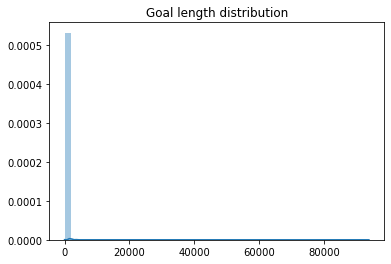

In [28]:
# Check for un-tokenizable pretty printed goals
goal_lengths = []
for i in trange(len(df)):
    try:
        tokens = enc.encode(df.cleaned_goal[i])
        if enc.decode(tokens) != df.cleaned_goal[i]:
            print("shit")
            break
        goal_lengths.append(len(tokens))
    except:
        print(f"Error at {i}, where text is {df.cleaned_goal[i]} with type {type(df.cleaned_goal[i])}")
        raise
sns.distplot(goal_lengths)
plt.title("Goal length distribution")
plt.show()

100%|██████████| 162310/162310 [00:11<00:00, 13712.84it/s]


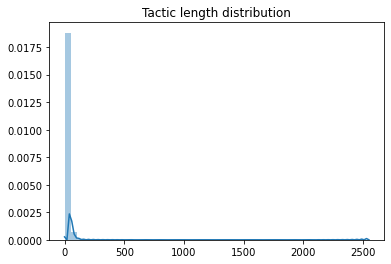

In [29]:
# Check for un-tokenizable human written tactics
tactic_lengths = []
for i in trange(len(df)):
    try:
        tokens = enc.encode(df.human_tactic_code[i])
        if enc.decode(tokens) != df.human_tactic_code[i]:
            print("shit")
            break
        tactic_lengths.append(len(tokens))
    except:
        print(f"Error at {i}, where text is {df.human_tactic_code[i]} with type {type(df.human_tactic_code[i])}")
        raise
sns.distplot(tactic_lengths)
plt.title("Tactic length distribution")
plt.show()

In [30]:
np.sum(np.array(goal_lengths) == 1)

0

In [31]:
keep_indices = []
for i in range(len(goal_lengths)):
    if goal_lengths[i] + tactic_lengths[i] + 3 <= 1024:
        keep_indices.append(i)
print(f"Number of indices to be kept will be {len(keep_indices)} in a total of {len(goal_lengths)}")

print(f"Length before: {len(df)}")
df = df.iloc[keep_indices, :]
df.reset_index()
print(f"Length after: {len(df)}")

Number of indices to be kept will be 160374 in a total of 162310
Length before: 162310
Length after: 160374


In [32]:
print(len(df[df.split == 'train']))
print(len(df[df.split == 'test']))
print(len(df[df.split == 'valid']))

147271
6317
6786


In [33]:
import torch
from torch.utils.data import Dataset

# Put goal and tactic into one place, extend encoder and split train test valid
class ProofStep(Dataset):
    
    def __init__(self, df, tokenizer):
        self.tokenizer = tokenizer
        self.df = df
#         self.attn_masks = []
#             self.attn_masks.append(torch.tensor(encodings_dict['attention_mask']))
        
    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        toks = self.tokenizer.encode(' <|GOAL|>' + self.df.cleaned_goal.iloc[idx] + ' <|PROOFSTEP|>' + self.df.human_tactic_code.iloc[idx] + ' <|endoftext|>') 
        return torch.tensor(toks)
#         print(' <|GOAL|>' + self.df.cleaned_goal.iloc[idx] + ' <|PROOFSTEP|>' + self.df.human_tactic_code.iloc[idx])
#         return toks#, self.attn_masks[idx] 

In [34]:
from transformers import (AdamW, 
                          get_linear_schedule_with_warmup)

In [35]:
from torch.utils.data import RandomSampler, SequentialSampler
# Split into train, validation and test set: 80 - 5 - 15

df_train = df[df.split == 'train']
df_train.reset_index()
df_valid = df[df.split == 'valid']
df_valid.reset_index()
df_test = df[df.split == 'test']
df_test.reset_index()

train_dataset = ProofStep(df_train, enc)
val_dataset = ProofStep(df_valid, enc)
test_dataset = ProofStep(df_test, enc)

print('{:>5,} training samples'.format(len(train_dataset)))
print('{:>5,} validation samples'.format(len(val_dataset)))
print('{:>5,} test samples'.format(len(test_dataset)))

147,271 training samples
6,786 validation samples
6,317 test samples


In [36]:
# from torch.utils.data import random_split
# from torch.utils.data import RandomSampler, SequentialSampler

# dataset = ProofStep(df, enc)

# # Split into train, validation and test set: 80 - 5 - 15
# train_size = 80/100 * len(dataset)
# val_size = 5/100 * len(dataset)
# test_size = len(dataset - train)

# train_dataset, val_dataset, test_dataset = random_split(dataset, [train_size, val_size, test_size])

# print('{:>5,} training samples'.format(train_size))
# print('{:>5,} validation samples'.format(val_size))
# print('{:>5,} test samples'.format(test_size))

In [37]:
text="It was a bright cold day in April."
quiet=False
nsamples=1
unconditional=False
batch_size=1
gradient_acc_steps = 32
length=-1
temperature=0.7
top_k=40

epochs=35
lr=1e-5 #0.0014
warmup_steps=200
epsilon = 1e-8

output_dir="./models" 
output_prefix="proofstep-named-1B"
test_mode=False
save_model_on_epoch=True
sample_every = 100 #sample output every 100 steps

# device=torch.device("cpu")
# model = model.cpu()

In [38]:
from torch.utils.data import DataLoader
from torch.utils.data import RandomSampler, SequentialSampler

# Create the DataLoaders for our datasets.
# We'll take training samples in random order. 
train_dataloader = DataLoader(
            train_dataset,  # The training samples.
            sampler = RandomSampler(train_dataset), # Select batches randomly
            batch_size = batch_size # Trains with this batch size.
        )
# For validation and test the order doesn't matter, so we'll just read them sequentially.
validation_dataloader = DataLoader(
            val_dataset, # The validation samples.
            sampler = SequentialSampler(val_dataset), # Pull out batches sequentially.
            batch_size = batch_size # Evaluate with this batch size.
        )
test_dataloader = DataLoader(
            test_dataset, # The validation samples.
            sampler = SequentialSampler(test_dataset), # Pull out batches sequentially.
            batch_size = batch_size # Evaluate with this batch size.
        )

In [39]:
# home = expanduser("~")
# state_dict = torch.load(os.path.join(home, 'data/GPT2/gpt2-pytorch_model.bin'), map_location='cpu' if not torch.cuda.is_available() else None)

# old_keys = []
# new_keys = []
# for key in state_dict.keys():
#     new_key = None
#     if key.endswith(".g"):
#         new_key = key[:-2] + ".weight"
#     elif key.endswith(".b"):
#         new_key = key[:-2] + ".bias"
#     elif key.endswith(".w"):
#         new_key = key[:-2] + ".weight"
#     if new_key:
#         old_keys.append(key)
#         new_keys.append(new_key)
# for old_key, new_key in zip(old_keys, new_keys):
#     state_dict[new_key] = state_dict.pop(old_key)
# # model.load_state_dict(state_dict)
# missing_keys = []
# unexpected_keys = []
# error_msgs = []
# # copy state_dict so _load_from_state_dict can modify it
# metadata = getattr(state_dict, "_metadata", None)
# state_dict = state_dict.copy()
# if metadata is not None:
#     state_dict._metadata = metadata

# def load(module, prefix=""):
#     local_metadata = {} if metadata is None else metadata.get(prefix[:-1], {})
#     module._load_from_state_dict(
#         state_dict, prefix, local_metadata, True, missing_keys, unexpected_keys, error_msgs
#     )
#     for name, child in module._modules.items():
#         if child is not None:
#             load(child, prefix + name + ".")

# start_model = model
# if hasattr(model, "transformer") and all(not s.startswith('transformer.') for s in state_dict.keys()):
#     start_model = model.transformer
# load(start_model, prefix="")

# model.set_tied()


In [40]:
# Checkpoint model for resuming

import os
from os.path import isfile, join
import re
import json

def load_pretrained_GPT2(model):
    home = expanduser("~")
    state_dict = torch.load(os.path.join(home, 'data/GPT2/gpt2-pytorch_model.bin'), map_location='cpu' if not torch.cuda.is_available() else None)

    old_keys = []
    new_keys = []
    for key in state_dict.keys():
        new_key = None
        if key.endswith(".g"):
            new_key = key[:-2] + ".weight"
        elif key.endswith(".b"):
            new_key = key[:-2] + ".bias"
        elif key.endswith(".w"):
            new_key = key[:-2] + ".weight"
        if new_key:
            old_keys.append(key)
            new_keys.append(new_key)
    for old_key, new_key in zip(old_keys, new_keys):
        state_dict[new_key] = state_dict.pop(old_key)
    # model.load_state_dict(state_dict)
    missing_keys = []
    unexpected_keys = []
    error_msgs = []
    # copy state_dict so _load_from_state_dict can modify it
    metadata = getattr(state_dict, "_metadata", None)
    state_dict = state_dict.copy()
    if metadata is not None:
        state_dict._metadata = metadata

    def load(module, prefix=""):
        local_metadata = {} if metadata is None else metadata.get(prefix[:-1], {})
        module._load_from_state_dict(
            state_dict, prefix, local_metadata, True, missing_keys, unexpected_keys, error_msgs
        )
        for name, child in module._modules.items():
            if child is not None:
                load(child, prefix + name + ".")

    start_model = model
    if hasattr(model, "transformer") and all(not s.startswith('transformer.') for s in state_dict.keys()):
        start_model = model.transformer
    load(start_model, prefix="")

    model.set_tied()
    with torch.no_grad():
        model.transformer.wte.weight[:50257, :] = state_dict['wte.weight']
    print(missing_keys, unexpected_keys, error_msgs)

def load_checkpoint(config, output_dir, output_prefix, new_train = 0):
    files = []
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
        print(f"Creating output directory {output_dir}")
    else:    
        files = [f for f in os.listdir(output_dir) if isfile(join(output_dir, f))]

    # Find training stats
    stats_filename = f"stats-{output_prefix}.json"
    if stats_filename in files:
        with open(os.path.join(output_dir, stats_filename), 'r') as f:
            training_stats = json.load(f)
    else:
        training_stats = []
    print(f"Length of current stats file: {len(training_stats)}\n")

    # Find checkpoints
    r = re.compile(f"{output_prefix}-[0-9]*.pt")
    model_files = list(filter(r.match, files))
    epochs_list = [int(x[ len(output_prefix)+1 : -3 ]) for x in model_files]
    model = GPT2LMHeadModel(config)
    if epochs_list:
        current_epoch = max(epochs_list)
        min_val_loss = min([x["Valid. Loss"] for x in training_stats])
        model.load_state_dict(
                torch.load(os.path.join(output_dir, f"{output_prefix}-{current_epoch}.pt"))
        )
        print(f"Checkpoint #{current_epoch} found, with min_val_loss of {min_val_loss:.3f}, resuming.")
    else:
        current_epoch = 0
        min_val_loss = float("inf")
        load_pretrained_GPT2(model)
        print(f"Checkpoint not found, starting from epoch #{current_epoch}, min_val_loss of {min_val_loss:.3f}.")
    return model, current_epoch, min_val_loss, training_stats

config = GPT2Config()
config.vocab_size += 2 # 2 new tokens
model, current_epoch, min_val_loss, training_stats = load_checkpoint(config, output_dir, output_prefix)
type(model) == GPT2LMHeadModel

Length of current stats file: 1

Checkpoint #19 found, with min_val_loss of 2.259, resuming.


True

In [41]:
device = torch.device("cuda")
model = model.cuda()

# Note: AdamW is a class from the huggingface library (as opposed to pytorch) 
optimizer = AdamW(model.parameters(),
                  lr = lr,
                  eps = epsilon
                )

# Total number of training steps is [number of batches] x [number of epochs]. 
# (Note that this is not the same as the number of training samples).
total_steps = (len(train_dataloader) // gradient_acc_steps + 1) * epochs

# Create the learning rate scheduler.
# This changes the learning rate as the training loop progresses
scheduler = get_linear_schedule_with_warmup(optimizer, 
                                            num_warmup_steps = warmup_steps, 
                                            num_training_steps = total_steps)

print(f"Number of warmup steps: {warmup_steps}\nTotal steps: {total_steps}")
type(model) == GPT2LMHeadModel

Number of warmup steps: 200
Total steps: 161105


True

In [42]:
import time
import datetime
from tqdm import tqdm, trange

def format_time(elapsed):
    return str(datetime.timedelta(seconds=int(round((elapsed)))))

In [43]:
import  matplotlib.pyplot as plt
# For sampling
def display_attn_and_confidence(model, context_text):
    activation = {}
    def get_activation(name):
        def hook(model, input, output):
            activation[name] = output[2].detach()
        return hook
    
    context = enc.encode(context_text)
    context = torch.tensor(context, device=device, dtype=torch.long).unsqueeze(0)

    # Getting attention outputs
    handles = [
        model.transformer.h[x].attn.register_forward_hook(get_activation(f'attn_{x}'))
            for x in range(12)
    ]

    # Display next token confidence
    prev = context
    with torch.no_grad():
        logits, past = model(prev)
        logits = logits[:, -1, :] / 0.7
        logits = top_k_logits(logits, k=10)
        log_probs = F.softmax(logits, dim=-1)
        values, prev = torch.topk(log_probs, k=10, dim=-1)

    prev = prev.tolist()
    for i in range(len(prev[0])):
        text = enc.decode([prev[0][i]])
        print(f"{text} -> {values[0][i].item()}")
    [handle.remove() for handle in handles]

    # Visualize attention maps
    idx = 0
    input_data = np.arange(context.shape[-1])
    attn_maps = [[(torch.sum(activation[f'attn_{x}'], dim=1)/12).detach().cpu().numpy() 
                         for x in range(12)]]
    num_heads = 12
    num_layers = 1
    seq_len = input_data.shape[0]
    fig_size = 4 if num_heads == 1 else 3
    fig, ax = plt.subplots(num_layers, num_heads, figsize=(num_heads*fig_size, num_layers*fig_size))
    if num_layers == 1:
        ax = [ax]
    if num_heads == 1:
        ax = [[a] for a in ax]
    for row in range(num_layers):
        for column in range(num_heads):        
            im = ax[row][column].imshow(attn_maps[row][column][0], origin='upper', vmin=0, vmax=1, cmap='bone')
            ax[row][column].set_xticks(list(range(seq_len)))
            ax[row][column].set_xticklabels(input_data.tolist())
            ax[row][column].set_yticks(list(range(seq_len)))
            ax[row][column].set_yticklabels(input_data.tolist())
            ax[row][column].set_title(f"Layer {column+1}")
            context_words = [enc.decode([x]).strip(' ') for x in context.cpu().numpy()[0]]
            if column == 0:
                ax[row][column].set_yticklabels(context_words)
            ax[row][column].set_xticklabels(context_words, rotation=90)

    fig.subplots_adjust(hspace=0.6)
    fig.subplots_adjust(right=0.9)
    cbar_ax = fig.add_axes([0.91, 0.15, 0.02, 0.7])
    fig.colorbar(im, cax=cbar_ax)
    plt.show()

0it [00:00, ?it/s]


======== Epoch 20 / 35 ========
Training...


3199it [02:03, 28.08it/s]

  Step 3,200  of  147,271. Loss: 1.0975831747055054.   Elapsed: 0:02:04.
Sample:split<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact_coprime λ x : cardinal_x, _<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simpa using h.refl<|endoftext|><|PROOFSTEP|>exact_coprime_add_injective<|endoftext|><|PROOFSTEP|>change (a b : ℕ)<|endoftext|><|PROOFSTEP|>converge_eq_left_of_self : (a _ : ℕ) ≤ b.in, _ _<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact_lt_iff<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>exact_lt_apply_iff_of_zero_mem_right<|endoftext|><|PROOFSTEP|>cases_right {<|endoftext|><|PROOFSTEP|>apply_def, set.map_const, map_const, map_const, not_lt_not_of_le_iff.2, set.map_constr_one, not_le_not_of_le_eq_le_not }<|endoftext|><|PROOFSTEP|>simp<|endoftext|>
s -> 0.4106641709804535
rw -> 0.2699063718318939
ex -> 0.10340388864278793
apply -> 0.06317517161369324
cases -> 0.0490638688206

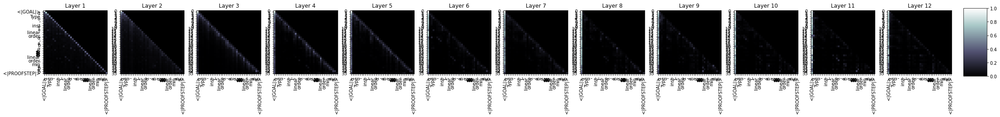

6400it [04:14, 23.56it/s]

  Step 6,400  of  147,271. Loss: 0.9263959527015686.   Elapsed: 0:04:15.
Sample:have hb : ∥a₁ / a₂ ≤ a₃ / a₃ / b := le_top_iff_ne_bot hb.2<|endoftext|><|PROOFSTEP|>cases le_trans hb with le_of_lt hb<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [← hsimp_one]<|endoftext|><|PROOFSTEP|>use h2x1 (mul.1 h1)<|endoftext|><|PROOFSTEP|>rw [mem_mul, left_inv, left_inv]<|endoftext|><|PROOFSTEP|>rw [right_inv, left_inv, inv_comp, inv_one, inv_comp, right_inv, right_inv]<|endoftext|><|PROOFSTEP|>s1 : list.nil.length (length_of_total_length h0 h1 h2 h3 h2.1 h2.2 * 0, 0.1) < list.nil (length_of_total_length h1 h1 h2 h3
s -> 0.39400002360343933
rw -> 0.302766352891922
ex -> 0.11612457782030106
apply -> 0.06370716542005539
have -> 0.03282693028450012
cases -> 0.028731832280755043
re -> 0.01892712153494358
int -> 0.017908526584506035
ref -> 0.01392617542296648
ext -> 0.011081398464739323


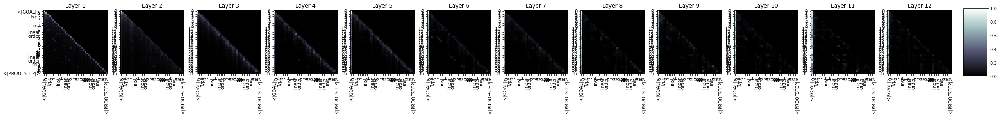

9598it [06:27, 26.10it/s]

  Step 9,600  of  147,271. Loss: 0.8306858539581299.   Elapsed: 0:06:28.
Sample:cases b<|endoftext|><|PROOFSTEP|>exact @max_left_of_le_one_max (max_left_of_le a) _ _ _ _<|endoftext|><|PROOFSTEP|>exact max_left_of<|GOAL|>c_le _ _<|endoftext|><|PROOFSTEP|>simp [lt_left, le_inf_of_le_le]<|endoftext|><|PROOFSTEP|>simp [le]<|endoftext|><|PROOFSTEP|>apply le_trans.right_of_injective<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>unitive<|endoftext|><|PROOFSTEP|>exact (univ)<|endoftext|><|PROOFSTEP|>exact.elim (right_injective.eq_right_mul)<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp.symm<|endoftext|><|PROOFSTEP|>exact<|endoftext|><|PROOFSTEP|>simp at le_symm<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rcases<|endoftext|><|PROOFSTEP|>rw e<|endoftext|><|PROOFSTEP|>simp_left<|endoftext|><|PROOFSTEP|>cases_right<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simpa using_top e<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ds<|endoftext|><|PROOFST

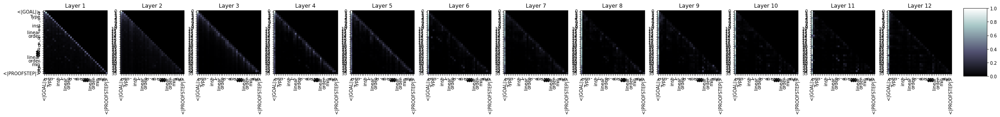

12798it [08:39, 27.56it/s]

  Step 12,800  of  147,271. Loss: 0.7678744792938232.   Elapsed: 0:08:40.
Sample:induction b with a hb<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>suffices_distrib_left<|endoftext|><|PROOFSTEP|>by_cases a hb<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>classical<|endoftext|><|PROOFSTEP|>exact_module_singleton<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_refl<|endoftext|><|PROOFSTEP|>simp_lt<|endoftext|><|PROOFSTEP|>summable tsum_ltp (le_of_not_lt_or_not_not)<|endoftext|><|PROOFSTEP|>summable_of_lt_of_not_lt_le_of_not_not<|endoftext|><|PROOFSTEP|>transUnion_is_mem_eq<|endoftext|><|PROOFSTEP|>summable_of_not_le_not_le_not_le, by dvd_of_le_dvd_le_lt_not_le_not<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>summable.1 one<|endoftext|><|PROOFSTEP|>summable, summable_of_not_le_not_le_not_le<|endoftext|><|PROOFSTEP|>summ
s -> 0.4963238835334778
rw -> 0.18493953347206116
cases -> 0.08782067149877548
ex -> 0.08475906401872635
apply -> 0.0394

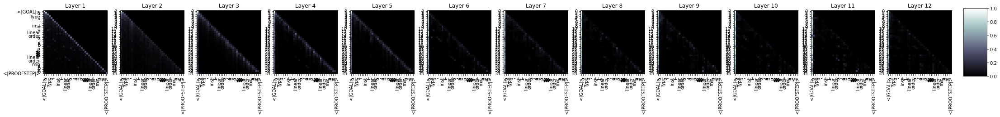

15999it [10:51, 23.42it/s]

  Step 16,000  of  147,271. Loss: 0.6759297251701355.   Elapsed: 0:10:52.
Sample:have ha : a = 0<|endoftext|><|PROOFSTEP|>simp only [← subtype.coe_eq, mul_self_iff_left, zero_iff_one]<|endoftext|><|PROOFSTEP|>simp only [mk_of_mem, if_neg, zero_iff, or_true]<|endoftext|><|PROOFSTEP|>simp_rw [coe_of<|GOAL|>G, if_neg, coe_of_eq_zero]<|endoftext|><|PROOFSTEP|>exists_of_is_zero<|endoftext|><|PROOFSTEP|>exists_eq_zero_of_le_one (le_of_mk_le_of_eq_zero_of_not_lt_of_lt_of_ne (not_not_lt) at le_of_lt_of_not_lt_of_eq_one_of_ne (not_le_right) (not_le_iff_not_lt_of_ne (not_le_right)).2)<|endoftext|><|PROOFSTEP|>simpa
s -> 0.5307744145393372
rw -> 0.22068436443805695
ex -> 0.07299947738647461
cases -> 0.05370398983359337
apply -> 0.03207674250006676
have -> 0.022267915308475494
int -> 0.02095746621489525
re -> 0.017778875306248665
ref -> 0.017486654222011566
sim -> 0.011270030401647091


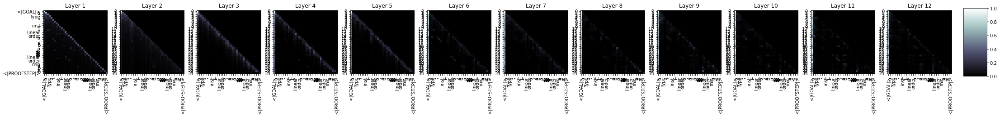

19198it [13:03, 27.45it/s]

  Step 19,200  of  147,271. Loss: 1.8880949020385742.   Elapsed: 0:13:03.
Sample:simp only [max_one, mem_max]<|endoftext|><|PROOFSTEP|>simp only [max_one_eq_zero]<|endoftext|><|PROOFSTEP|>simp only [finset.comp_mul_coe_finset_image] using finset.symm<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [finset.mem_const] using mem_const_iff_max<|endoftext|><|PROOFSTEP|>rw [mem_const, le_div]<|endoftext|><|PROOFSTEP|>have := {source := nat.of_le_of_lt_mul, not_le }<|endoftext|><|PROOFSTEP|>rw [comp_iff_true, nat.of_le_of_lt_lt]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp (λ x y z, rfl)<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp.lt_apply (λ x y z, rfl)<|endoftext|><|PROOFSTEP|>refine le_of_lt (apply_eq_zero_of_le, int.
s -> 0.4242301881313324
ex -> 0.15766264498233795
rw -> 0.12370363622903824
apply -> 0.07954827696084976
cases -> 0.05778453126549721
ref -> 0.04307018965482712
re -> 0.03876001015305519
have -> 0.03547259047627449
int -> 0.0249

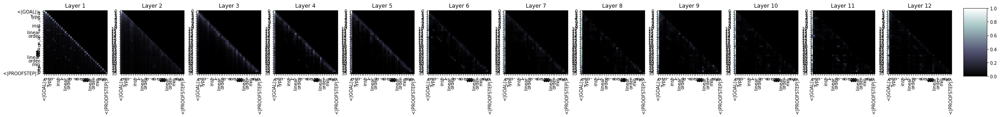

22398it [15:15, 25.71it/s]

  Step 22,400  of  147,271. Loss: 1.3516788482666016.   Elapsed: 0:15:16.
Sample:simp only [min_div_iff, min_div_ne_zero]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rintros ⟨θ, hy⟩ : h, f h, ⟨f, hf⟩<|endoftext|><|PROOFSTEP|>snd<|endoftext|><|PROOFSTEP|>snd a1<|endoftext|><|PROOFSTEP|>snd_trans (refl1.mul_trans_trans_mem (refl2.mul_trans_trans_mem_self)).1<|endoftext|><|PROOFSTEP|>exact_split_refl2<|endoftext|><|PROOFSTEP|>snd : is_absolute_compactant_eq_singleton.refl<|endoftext|><|PROOFSTEP|>exact_split_refl2<|endoftext|><|PROOFSTEP|>snd_eq_singleton<|endoftext|><|PROOFSTEP|>snd<|endoftext|><|PROOFSTEP|>snd_le<|endoftext|><|PROOFSTEP|>apply_left_mem_of_not_le.1<|endoftext|><|PROOFSTEP|>have h : ihe : (mul_le_nonneg snd).not_le snd := pnat
s -> 0.4939485788345337
ex -> 0.13363392651081085
rw -> 0.1279521882534027
apply -> 0.046593181788921356
cases -> 0.043085236102342606
ref -> 0.042874883860349655
re -> 0.03931779786944389
int -> 0.03865157067775726
have -> 0.01

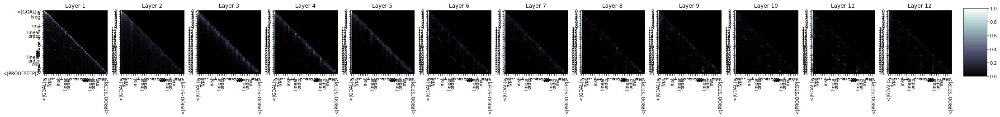

25599it [17:28, 26.08it/s]

  Step 25,600  of  147,271. Loss: 0.9349789619445801.   Elapsed: 0:17:28.
Sample:simp [min_add, min_refl]<|endoftext|><|PROOFSTEP|>contradiction<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>dsimp [dvd_iff_add]<|endoftext|><|PROOFSTEP|>rw [add_comm, add_comm, add_comm] [add_left, add accordingly]<|endoftext|><|PROOFSTEP|>simp [add_right, add_self] {contextual := simp }<|endoftext|><|PROOFSTEP|>apply h.lm<|endoftext|><|PROOFSTEP|>simp_rw<|endoftext|><|PROOFSTEP|>apply_instance.2 h.rpow_of_dvd {instance := has_one h.cpr, has_one h.cpr.1]<|endoftext|><|PROOFSTEP|>intro h.rpow_of_dvd<|endoftext|><|PROOFSTEP|>symmetry.to_real<|endoftext|><|PROOFSTEP|>cases (eq_zero_of_dvd_of_zero _ _).symmetry<|endoftext|><|PROOFSTEP|>simp.symmetry with nat.prod h.rpow_one x<|endoftext|><|PROOFSTEP|>simp.sy
s -> 0.4525517225265503
rw -> 0.12098022550344467
ex -> 0.11970174312591553
apply -> 0.07485045492649078
ref -> 0.05124384164810181
cases -> 0.04661712795495987
re -> 0.04471076652407646
have ->

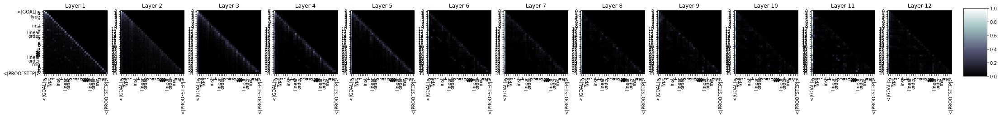

28799it [19:42, 25.65it/s]

  Step 28,800  of  147,271. Loss: 1.1969481706619263.   Elapsed: 0:19:42.
Sample:refl<|endoftext|><|PROOFSTEP|>simp [le_iff_le_sup]<|endoftext|><|PROOFSTEP|>apply le_iff_inter_le A<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp.1<|endoftext|><|PROOFSTEP|>simp_left, smul_left_of_le_of_le_of_lt' : le_of_left' (λ z, (le_of_le_of_lt_iff_lt_of_lt_of_lt_iff_not_le_of_lt_iff_of_le_of_lt_lt_iff_of_le_of_lt_iff_lt_of_not_le_of_lt_iff_antisymm)<|endoftext|><|PROOFSTEP|>exact_instance_derive_field (le_of_le_of_lt_of_lt_of_lt_of_not_le_of_le_of_eq_iff_le_of_
s -> 0.39601150155067444
ex -> 0.1705467253923416
rw -> 0.13868418335914612
apply -> 0.07557420432567596
int -> 0.049453333020210266
cases -> 0.04694191738963127
have -> 0.038741882890462875
ref -> 0.034480754286050797
re -> 0.032588861882686615
by -> 0.01697664149105549


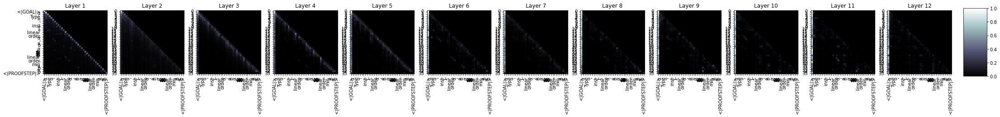

31998it [21:54, 29.20it/s]

  Step 32,000  of  147,271. Loss: 1.643750548362732.   Elapsed: 0:21:55.
Sample:dsimp [linear_order.min]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [mul_left_right]<|endoftext|><|PROOFSTEP|>simp [right_of_neg]<|endoftext|><|PROOFSTEP|>simp [dist_right_of_neg]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_rw [dist_left_of_neg]<|endoftext|><|PROOFSTEP|>apply_fn<|endoftext|><|PROOFSTEP|>exact_funs<|endoftext|><|PROOFSTEP|>apply_fn<|endoftext|><|PROOFSTEP|>apply has_right_comp<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>apply_mem<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have_zero_pow pow<|endoftext|><|PROOFSTEP|>s.1<|endoftext|><|PROOFSTEP|>have_non_ne_zero_right<|endoftext|><|PROOFSTEP|>tang_of_left_le_of_top pow<|endoftext|><|PROOFSTEP|>apply_self<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>sensor_prod<|endoftext|><|PROOFSTEP|>apply_self<|endoftext|><|PROOFSTEP|>apply_self_id<|endoftext|><|PROOFSTEP|>convert_pos_le_of_le_

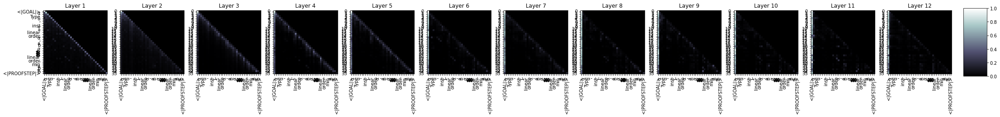

35199it [24:07, 26.74it/s]

  Step 35,200  of  147,271. Loss: 1.4265573024749756.   Elapsed: 0:24:07.
Sample:rw le_total_of_le_top<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw [← mul_singleton, rpow_le, le_bot_left, le_bot_right]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance_of_right<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw submodule.class_eq_comp_comp_left<|endoftext|><|PROOFSTEP|>t helt submodule.class_eq_comp_left t helt submodule.class_eq_comp_right<|endoftext|><|PROOFSTEP|>rw submodule_eq_comp_left<|endoftext|><|PROOFSTEP|>rw { subtype := bernstein, mem_comp, mem_comp, mem_comp, mem_mul}<|endoftext|><|PROOFSTEP|>apply_instance_left at subtype.comp_comp_left (subtype.left_inj_nnd_of_le)<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_instance_right<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>haveI := _ _<|endoftext|><|PROOFSTEP|>t
s -> 0.4923326075077057
rw -> 0.2126740664243698
ex -> 0.10234952718019485
apply -> 0.058321

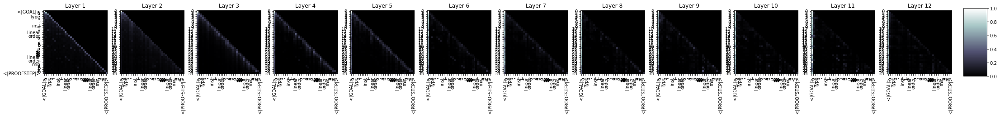

38398it [26:19, 21.35it/s]

  Step 38,400  of  147,271. Loss: 1.5940884351730347.   Elapsed: 0:26:20.
Sample:simp [simp, min_comm]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw cond_add_right_le<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw h<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp.2.iff_coe<|endoftext|><|PROOFSTEP|>simp2<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>exact_lhs_le_left_right<|endoftext|><|PROOFSTEP|>try_t_srt_le<|endoftext|><|PROOFSTEP|>simp4 : to int.simp2<|endoftext|><|PROOFSTEP|>cases_right : is_int.pow<|endoftext|><|PROOFSTEP|>simp4 : to int.simp2 set x<|endoftext|><|PROOFSTEP|>exists_lt_mem Sp8<|endoftext|><|PROOFSTEP|>simp4 : is_int.pow_left_right (2 * (simp2.2))<|endoftext|><|PROOFSTEP|>simp1 S.5.1<|endoftext|><|PROOFSTEP|>simp1 : is_int.pow_left_right (2 * (simp2.2))<|endoftext|><|PROOFSTEP|>simp1
s -> 0.40579864382743835
rw -> 0.22303809225559235
ex -> 0.1139666959643364
apply -> 0.0815

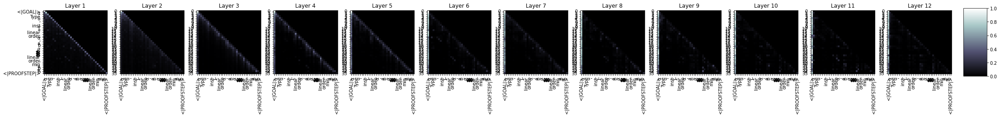

41598it [28:31, 22.75it/s]

  Step 41,600  of  147,271. Loss: 0.8581836223602295.   Elapsed: 0:28:32.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>assume hs<|endoftext|><|PROOFSTEP|>simp only [sub_eq_add _ _, sub_eq_one] 1_or_pos_left_iff<|endoftext|><|PROOFSTEP|>ring<|endoftext|><|PROOFSTEP|>simp at :<|endoftext|><|PROOFSTEP|>exact_lt_sub_iff_of_mem _ (lt_sub_iff_of_mem_mem_of_mem_id_of_mem_eq_left_of_mem.1)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact_lt_mul<|endoftext|><|PROOFSTEP|>ext ℕ<|endoftext|><|PROOFSTEP|>tsum<|endoftext|><|PROOFSTEP|>by simp<|endoftext|><|PROOFSTEP|>exact (mv_one.mpr (intro _).1) (mv_one).add_sub at (int.mpr mv_one).ne (mv_one.add_le)<|endoftext|><|PROOFSTEP|>simp : one (mv_one).le<|endoftext|><|PROOFSTEP|>ext_iff_le.2 (m
s -> 0.353028804063797
rw -> 0.30243244767189026
ex -> 0.10781113803386688
cases -> 0.06129235029220581
apply -> 0.058181051164865494
int -> 0.03319523110985756
have -> 0.029140545055270195
re -> 0.02440316043794155
ref -

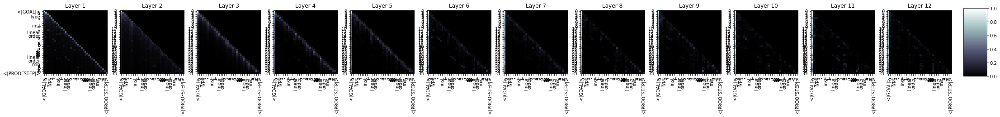

44798it [30:43, 25.44it/s]

  Step 44,800  of  147,271. Loss: 0.6640356183052063.   Elapsed: 0:30:44.
Sample:simp only [max_ratio_mod_dvd_of_le_neg, min_ne_zero]<|endoftext|><|PROOFSTEP|>apply le_of_lt_le_one<|endoftext|><|PROOFSTEP|>simp [eq_mul]<|endoftext|><|PROOFSTEP|>apply le_one_apply_one<|endoftext|><|PROOFSTEP|>rw ← one_le_one_induction<|endoftext|><|PROOFSTEP|>simp.1 ← one_le_one_apply_one_induction<|endoftext|><|PROOFSTEP|>exact has_inter<|endoftext|><|PROOFSTEP|>apply_inv<|endoftext|><|PROOFSTEP|>scoz<|endoftext|><|PROOFSTEP|>rw [le.reflow]<|endoftext|><|PROOFSTEP|>rw [le_reflow_left_right]<|endoftext|><|PROOFSTEP|>rw h1<|endoftext|><|PROOFSTEP|>apply_inter_left_right<|endoftext|><|PROOFSTEP|>intro h20<|endoftext|><|PROOFSTEP|>have is_repr.com_s_of_dvd h1<|endoftext|><|PROOFSTEP|>reflow<|endoftext|><|PROOFSTEP|>reflow<|endoftext|><|PROOFSTEP|>simp_le<|endoftext|><|PROOFSTEP|>reflow<|endoftext|><|PROOFSTEP|>rw sub_self<|endoftext|><|PROOFSTEP|>re
s -> 0.34875914454460144
rw -> 0.29406240582466125
ex -> 

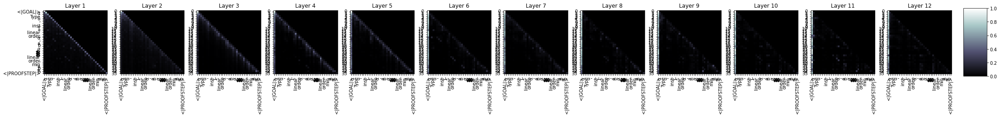

47999it [32:54, 25.92it/s]

  Step 48,000  of  147,271. Loss: 0.8448195457458496.   Elapsed: 0:32:55.
Sample:intro h<|endoftext|><|PROOFSTEP|>simp only [← left_add_right, eq_self_left_add_left]<|endoftext|><|PROOFSTEP|>simp only [← left_add_right, eq_self<|GOAL|>a, right_add_left]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp at h<|endoftext|><|PROOFSTEP|>exact has_zero_le_subtype _<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_lt<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact_mem<|endoftext|><|PROOFSTEP|>refine_self (mem_instance_assoc)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact_nhds_of_factorial simp<|endoftext|><|PROOFSTEP|>linarith<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>simp.1 (nhds.2.xrpow_one_pow_one_mul_one_one_pow_mul_one.3)<|endoftext|><|PROOFSTEP|>simp.1 simp<|endoftext|><|PROOFSTEP|>try {cases_on
s -> 0.33115649223327637
rw -> 0.3272646963596344
ex -> 0.12340308725833893
apply 

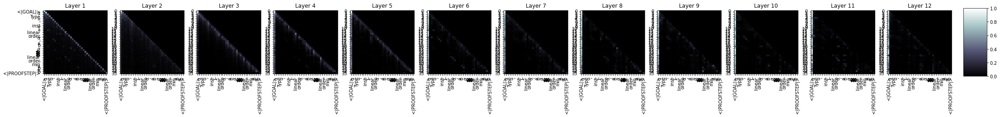

51198it [35:07, 25.93it/s]

  Step 51,200  of  147,271. Loss: 1.021747350692749.   Elapsed: 0:35:07.
Sample:simp only [max_eq_max_iff]<|endoftext|><|PROOFSTEP|>simp only [lt_max]<|endoftext|><|PROOFSTEP|>ring_le_iff_apply_instance<|endoftext|><|PROOFSTEP|>rw ring_le_iff_le_apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [le_iff_eq_true_iff', false_le_true]<|endoftext|><|PROOFSTEP|>simp: int.le_one.1 [false_le_iff_le_true_iff_iff]<|endoftext|><|PROOFSTEP|>simp v1.<|PROOFSTEP|>rint_right<|endoftext|><|PROOFSTEP|>simp:1.1 (mul_comm _ _ _ _)<|endoftext|><|PROOFSTEP|>simp (2)<|endoftext|><|PROOFSTEP|>rfl<|endoftext|><|PROOFSTEP|>refine le_of_iff.symm (1 : pimp (2 : (pimp2).is_comm (pimp2.2 _) _) (nat_le_coe).fst _)<|endoftext|><|PROOFSTEP|>simp.coe_eq _<|endoftext|><|PROOFSTEP|>int.
s -> 0.41210874915122986
rw -> 0.26746290922164917
ex -> 0.109388068318367
apply -> 0.06146562844514847
have -> 0.04996176436543465
cases -> 0.028343122452497482
int -> 0.021313706412911415
re -> 0.0179306250065565

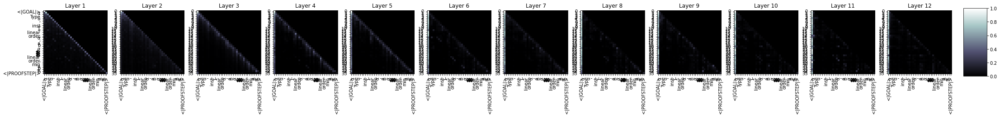

54399it [37:17, 22.65it/s]

  Step 54,400  of  147,271. Loss: 0.9340829253196716.   Elapsed: 0:37:18.
Sample:rw [min_lt_iff_iff, max_div_eq_bot_iff_ne]<|endoftext|><|PROOFSTEP|>rw [← ← one_zero]<|endoftext|><|PROOFSTEP|>intro x | [← ⟨x, hx, rfl⟩]<|endoftext|><|PROOFSTEP|>rintro x<|endoftext|><|PROOFSTEP|>assumption ⟨x, hx, rfl⟩<|endoftext|><|PROOFSTEP|>cases a with one, rfl⟩<|endoftext|><|PROOFSTEP|>simp only [dvd_left, hsimp.1]<|endoftext|><|PROOFSTEP|>rw [h]<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>rw [mem_sup, hmul_mem, card_sup, ne_card, card_sup.1]<|endoftext|><|PROOFSTEP|>subtype.coe_dvd, subtype.coe_sup_of_not_district, t1_mul_mem, dvd_zero, one_district_eq_district<|endoftext|><|PROOFSTEP|>rcantone<|endoftext|><|PROOFSTEP|>rc
rw -> 0.3268430829048157
s -> 0.2965191900730133
ex -> 0.10627081990242004
apply -> 0.06847357749938965
cases -> 0.06591863930225372
have -> 0.0476766973733902
re -> 0.025480151176452637
int -> 0.02379159815609455
ref -> 0.021938467398285866
sim -> 0.01708781160414219


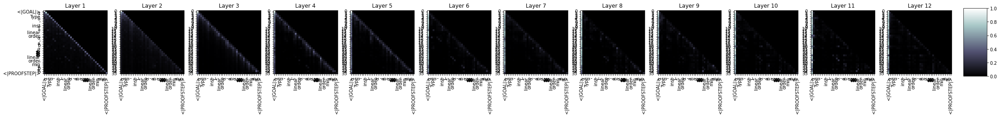

57598it [39:30, 18.97it/s]

  Step 57,600  of  147,271. Loss: 0.7777804732322693.   Elapsed: 0:39:31.
Sample:convert min_le_min_antidiagonal_le (le_antisymm a b)<|endoftext|><|PROOFSTEP|>tactic.pi_instance_derive_field<|endoftext|><|PROOFSTEP|>cases h : ∀ i : fin (one_le, fin_singleton h), one_le.left<|endoftext|><|PROOFSTEP|>apply @strict_le_bot_of_mul_le_left_left_left<|endoftext|><|PROOFSTEP|>rintros ⟨x, s, s'⟩⟩<|endoftext|><|PROOFSTEP|>split_ifs _<|endoftext|><|PROOFSTEP|>s : ∀ i ⟨y, hx⟩, _, _⟩, s'⟩, _⟩<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>s i<|endoftext|><|PROOFSTEP|>haveI : ∀ i ⟨a, _⟩, _⟩ := {x, hi, int.cast_pow_left _I_1, x + rfl,
s -> 0.4465382695198059
rw -> 0.24098490178585052
ex -> 0.09905915707349777
cases -> 0.04869437962770462
apply -> 0.04805149510502815
re -> 0.027222178876399994
ref -> 0.025973999872803688
have -> 0.024216895923018456
int -> 0.022149762138724327
ext -> 0.017108993604779243


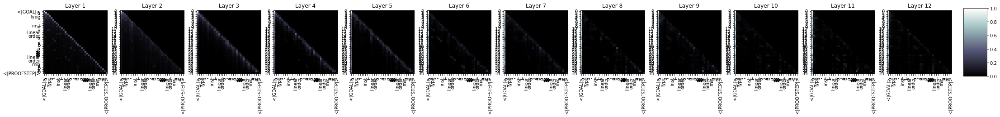

60798it [41:44, 19.78it/s]

  Step 60,800  of  147,271. Loss: 0.8481581211090088.   Elapsed: 0:41:44.
Sample:refl<|endoftext|><|PROOFSTEP|>exact le_refl<|endoftext|><|PROOFSTEP|>simp [distrib]<|endoftext|><|PROOFSTEP|>rw [distrib, rel]<|endoftext|><|PROOFSTEP|>rw [← rel]<|endoftext|><|PROOFSTEP|>rw [← rel]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp (b x)<|endoftext|><|PROOFSTEP|>refine ⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟩<|endoftext|><|PROOFSTEP|>contra ⟨⟨⟨⟨⟨⟩<|endoftext|><|PROOFSTEP|>refine ⟨⟨⟨⟨⟩ ⟨⟩<|endoftext|><|PROOFSTEP|>have R := pow
s -> 0.3334837555885315
rw -> 0.2888076603412628
ex -> 0.11602504551410675
apply -> 0.0753694549202919
int -> 0.04605238884687424
ref -> 0.03455854952335358
re -> 0.030140604823827744
cases -> 0.02980918250977993
have -> 0.026975076645612717
sim -> 0.018778301775455475


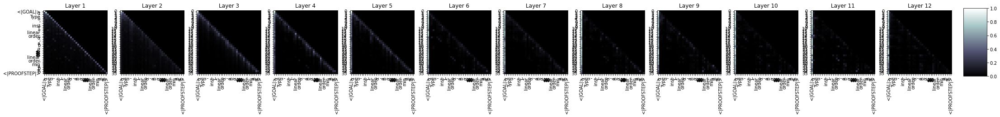

63998it [43:56, 24.67it/s]

  Step 64,000  of  147,271. Loss: 0.860068142414093.   Elapsed: 0:43:57.
Sample:simp<|endoftext|><|PROOFSTEP|>simp [lt_self_iff_le]<|endoftext|><|PROOFSTEP|>by<|endoftext|><|PROOFSTEP|>rintros ⟨⟩<|endoftext|><|PROOFSTEP|>have⟩<|endoftext|><|PROOFSTEP|>rw ← rfl<|endoftext|><|PROOFSTEP|>simp at hc<|endoftext|><|PROOFSTEP|>have!1<|endoftext|><|PROOFSTEP|>dsimp<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>intros<|endoftext|>G : real.real ⟨h<|endoftext|><|PROOFSTEP|>rw (IHN, nhdsimp_real1.2 aes_real_iff_is_eq_ne<|endoftext|><|PROOFSTEP|>simp_nehds<|endoftext|><|PROOFSTEP|>simp_nehds<|endoftext|><|PROOFSTEP|>rw [hnsimp.1_ne.2]<|endoftext|><|PROOFSTEP|>refine hsymm_eq_bot hsymm_eq_ne hsymm.2<|endoftext|><|PROOFSTEP|>simp_ne.3 [mem_ne_2]<|endoftext|><|PROOFSTEP|>refine hsymm_eq_bot hsymm<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>set_self<|endoftext|><|PROOFSTEP|>univ<|endoftext|><|PROOFSTEP|>ring
s -> 0.36512455344200134
rw -> 0.19895410537719727
ex -> 0.1407693773508072

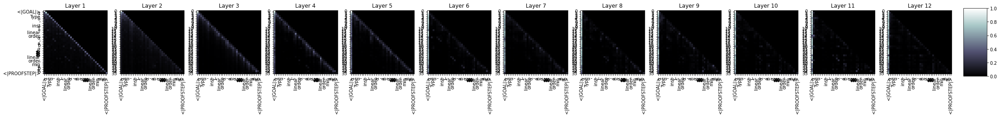

67199it [46:08, 28.66it/s]

  Step 67,200  of  147,271. Loss: 1.174133062362671.   Elapsed: 0:46:08.
Sample:exact le_of_bot ⟨l, rfl⟩<|endoftext|><|PROOFSTEP|>simpa only [one_eq_true, one_eq_false] using simpa_top<|endoftext|><|PROOFSTEP|>simpa only [set.image_eq_true, one]<|endoftext|><|PROOFSTEP|>simpa_one = with_top_eq_true<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|><|endoftext|><|PROOFSTEP|>exact_with_left<|endoftext|><|PROOFSTEP|>rw[not_is_left] at bt2<|endoftext|><|PROOFSTEP|>haveI : is_cater_one<|endoftext|><|PROOFSTEP|>apply (le_of _)<|endoftext|><|PROOFSTEP|>simp only [apply_left]<|endoftext|><|PROOFSTEP|>exists_iff_lt_one_1<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>haveI<|endoftext|><|PROOFSTEP|>exists I this.<|endoftext|><|PROOFSTEP|>nodup<|endoftext|><|PROOFSTEP|>cases.1<|endoftext|><|PROOFSTEP|>exists_I with<|endoftext|><|PROOFSTEP|>rint<|endoftext|><|PROOFSTEP|>haveI<|endoftext|><|PROOFSTEP|>exists (coe_left_right_rhs h1
s -> 0.40840

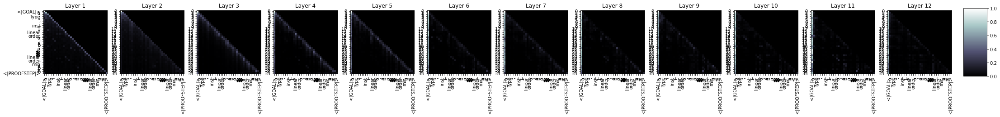

70398it [48:21, 26.27it/s]

  Step 70,400  of  147,271. Loss: 1.1067038774490356.   Elapsed: 0:48:22.
Sample:simp [min_comm, max_comm]<|endoftext|><|PROOFSTEP|>rw h<|endoftext|><|PROOFSTEP|>simp [mem_comm]<|endoftext|><|PROOFSTEP|>apply eq_le_of_eq_antisymm<|endoftext|><|PROOFSTEP|>refine (neg _).symm<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refine le_inf_eq_nat_iff_one : nat.not_le_antisymm '' a b<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rpow with hrc<|endoftext|><|PROOFSTEP|>cases_lt_b<|endoftext|><|PROOFSTEP|><|endoftext|><|PROOFSTEP|>ring_pos<|endoftext|><|PROOFSTEP|>svd<|endoftext|><|PROOFSTEP|>simp only [mem_bUnion, or, not_ne_zero]<|endoftext|><|PROOFSTEP|>sdiff<|endoftext|><|PROOFSTEP|>simp only with rfl<|endoftext|><|PROOFSTEP|>exchange<|endoftext|><|PROOFSTEP|>rintros<|endoftext|><|PROOFSTEP|>totally<|endoftext|><|PROOFSTEP|>splitI<|endoftext|><|PROOFSTEP|>s1<|endoftext|><|PROOFSTEP|>tr

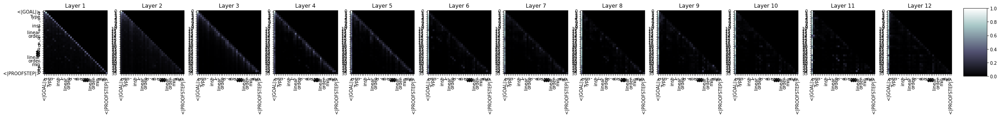

73598it [50:34, 26.25it/s]

  Step 73,600  of  147,271. Loss: 0.7280738353729248.   Elapsed: 0:50:35.
Sample:ext [min_eq_max_iff]<|endoftext|><|PROOFSTEP|>rw [←_] at a<|endoftext|><|PROOFSTEP|>exact_le_mul (sub_self a b hm)<|endoftext|><|PROOFSTEP|>refine ⟨s, _⟩<|endoftext|><|PROOFSTEP|>have a : ⟨h, _⟩ := hm<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [← sub_self.comp]<|endoftext|><|PROOFSTEP|>exists_lt_iff (2)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [← sub_self.comp]<|endoftext|><|PROOFSTEP|>rw [← sub_self.comp, set_int.1 (eq_of_lt_iff_true_true_true_true_ne]]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exists_iff_true_true<|endoftext|><|PROOFSTEP|>symm<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>cases h1 (0)<|endoftext|><|PROOFSTEP|>ext_iff_true_true_true_true<|endoftext|><|PROOFSTEP|>simp only [
s -> 0.3932545781135559
rw -> 0.24763822555541992
ex -> 0.09183620661497116
apply -> 0.06931816786527634
re -> 0.04902706667780876
cases

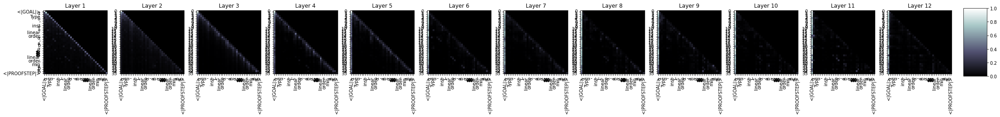

76798it [52:47, 25.74it/s]

  Step 76,800  of  147,271. Loss: 1.7796378135681152.   Elapsed: 0:52:47.
Sample:cases a<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have : x : ℝ≥0, bdd : x ≠ zero ⟨v, hv⟩<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>rw [← eq_not_in, eq_of_lt_lt, or_or]<|endoftext|><|PROOFSTEP|>simp.co_assoc<|endoftext|><|PROOFSTEP|>refine_exists at<|endoftext|><|PROOFSTEP|>simp.left<|endoftext|><|PROOFSTEP|>intros h2<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>exists_fst<|endoftext|><|PROOFSTEP|>exists<|endoftext|><|PROOFSTEP|>sco_1 h2s<|endoftext|><|PROOFSTEP|>exists_fst<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>s at h2s<|endoftext|><|PROOFSTEP|>have : 1 < 1<|endoftext|><|PROOFSTEP|>snd, h2s, h2p, h2s, h2s_mul, h2p0, h2k (h2s, h2p, H2P
s -> 0.25226348638534546
rw -> 0.18710015714168549
ex -> 0.1792949140071869
apply -> 0.116349637508392

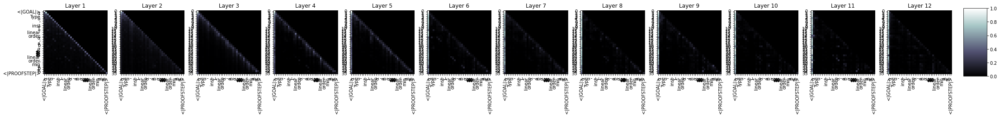

80000it [55:00, 19.58it/s]

  Step 80,000  of  147,271. Loss: 0.9750421047210693.   Elapsed: 0:55:00.
Sample:exact lt_le_of_lt<|endoftext|><|PROOFSTEP|>cases coe<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>cases!_some : pf.card_zero_right<|endoftext|><|PROOFSTEP|>exact_mem<|endoftext|><|PROOFSTEP|>from #2<|endoftext|><|PROOFSTEP|>simp_rpow<|endoftext|><|PROOFSTEP|>have := (lmk_pos (leof, gcd) h<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp : int ihds using hds_pos.2<|endoftext|><|PROOFSTEP|>have<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>s : int ihds using hds_pos, hf_pos, hg_pos<|endoftext|><|PROOFSTEP|>cases_lea_of_le_right (hfg_1 (pow_pos.2 hfg_2))<|endoftext|><|PROOFSTEP|>simp_rpow<|endoftext|><|PROOFSTEP|>by [m_mul, hg, rfls_mul]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_rpow_self_mul<|endoftext|><|PROOFSTEP|>have : mul
s -> 0.28170064091682434
rw -> 0.2200298309326172
ex -> 0.16981975734233856
apply -> 0.10098941624164581
cases -> 0.0518729686

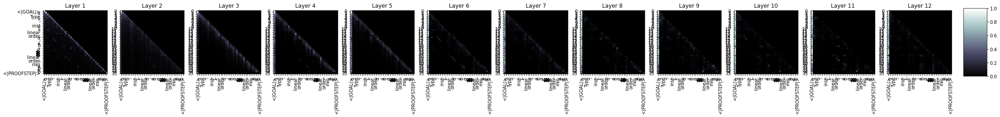

83198it [57:12, 25.73it/s]

  Step 83,200  of  147,271. Loss: 1.755185842514038.   Elapsed: 0:57:13.
Sample:ext x at x<|endoftext|><|PROOFSTEP|>simpa [← zero_self, mul_one] using mul_zero_of_pos_diff<|endoftext|><|PROOFSTEP|>intros at nat.snd<|endoftext|><|PROOFSTEP|>rintro h h'<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>ext h'simp<|endoftext|><|PROOFSTEP|>ext rfl<|endoftext|><|PROOFSTEP|>simp i hm1.symm hm2.symm<|endoftext|><|PROOFSTEP|>apply_fun.symm.1 _1<|endoftext|><|PROOFSTEP|>titt_2<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_fun : titt_subtype_eq_pos<|endoftext|><|PROOFSTEP|>refine_mul.1<|endoftext|><|PROOFSTEP|>simp.lhs : subtype_eq_pos (eq_subtype_eq_pos, _)<|endoftext|><|PROOFSTEP|>intro! H<|endoftext|><|PROOFSTEP|>simp.lhs : one_to_one<|endoftext|><|PROOFSTEP|>simp.2<|endoftext|><|PROOFSTEP|>have R1 H1.left<|endoftext|><|PROOFSTEP|>refine_mul.1 rfl<|endoftext|>
s -> 0.3116641044616699
ex -> 0.21886521577835083
rw -> 0.15746961534023285
apply ->

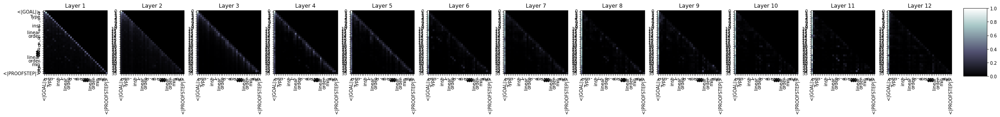

86399it [59:24, 23.96it/s]

  Step 86,400  of  147,271. Loss: 1.1751519441604614.   Elapsed: 0:59:25.
Sample:simp [min]<|endoftext|><|PROOFSTEP|>simp [max_eq_neg]<|endoftext|><|PROOFSTEP|>simp_mk_le<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>apply_instance_eq_zero.refl<|endoftext|><|PROOFSTEP|>apply x<|endoftext|><|PROOFSTEP|>rw if_lt if_lt_some<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_restrict_strict_strict_one<|endoftext|><|PROOFSTEP|>have_ne_dvd<|endoftext|><|PROOFSTEP|>simp_restrict_strict_one<|endoftext|><|PROOFSTEP|>simp_restrict_two,restrict_one<|endoftext|><|PROOFSTEP|>rw /<|endoftext|><|PROOFSTEP|>rw with hk<|endoftext|><|PROOFSTEP|>have_ne_dvd.1<|endoftext|><|PROOFSTEP|>simp_restrict<|endoftext|><|PROOFSTEP|>apply_def<|endoftext|><|PROOFSTEP|>apply_dist_l.2<|endoftext|>[1 : (1), {mul_x' := {simp_eq_t1, mul_eq_t2} (2)]<|endoftext|><|PROOFSTEP|>simp_restrict
s -> 0.3801197409629822
rw -> 0.27077

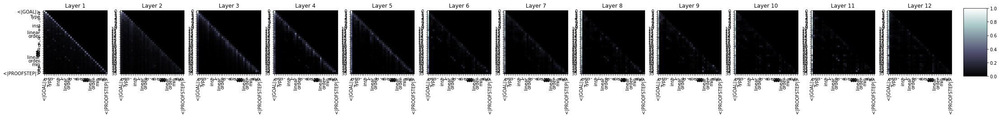

89600it [1:01:39, 24.08it/s]

  Step 89,600  of  147,271. Loss: 0.6554335355758667.   Elapsed: 1:01:39.
Sample:tactic.pi_instance_derive_field<|endoftext|><|PROOFSTEP|>exact mul_assoc_le_left<|endoftext|><|PROOFSTEP|>simp [mul_assoc]<|endoftext|><|PROOFSTEP|>sdiff<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>change txt_eq_iff<|endoftext|><|PROOFSTEP|>have:<|endoftext|><|PROOFSTEP|>simp ihc.1<|endoftext|><|PROOFSTEP|>simpa using ⟨hc, hb, hc'<|endoftext|><|PROOFSTEP|>rfl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>ex (pow_nonneg_of_nat _ _ _ _ _)<|endoftext|><|PROOFSTEP|>reflex ⟨reflex, hc'<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>convert set.preimage_pow<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simp [←g_eq_nonneg_of_cancel_neg, ←g_neg_nonneg, ←g_eq_nonneg_of_cancel_neg]<|endoftext|><|PROOFSTEP|>reflex pow_pos
s -> 0.36267146468162537
rw -> 0.1911735087633133
ex -> 0.16789881885051727
apply -> 0.07461713999509811
int -> 0.057299729

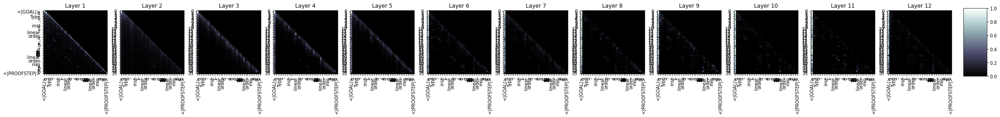

92798it [1:03:51, 25.48it/s]

  Step 92,800  of  147,271. Loss: 1.0658488273620605.   Elapsed: 1:03:52.
Sample:exact min_right_inv<|endoftext|><|PROOFSTEP|>cases a at a with a<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw eq_top<|endoftext|><|PROOFSTEP|>simpa [badd_top] using b.top_eq_top_top<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>rw b<|endoftext|><|PROOFSTEP|>set_top_to_mem<|endoftext|><|PROOFSTEP|>sizing<|endoftext|><|PROOFSTEP|>let_singleton_eq_forall<|endoftext|><|PROOFSTEP|>refl' (prefunctor.memrefl_preimage_preimage_mem_set_mul (set_top.b1 _))<|endoftext|><|PROOFSTEP|>rw [pre_image_mem_id_le, ←preimage_mem_id]<|endoftext|><|PROOFSTEP|>set_top_mem (univ_left.b1.b1)<|endoftext|><|PROOFSTEP|>split_left_by_mul_a_b0<|endoftext|><|PROOFSTEP|>have a tl2 with a rfl1<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>split_left_by_mul_a_b
s -> 0.33344197273254395
rw -> 0.20151157677173615
ex -> 0.12578850984573364
apply -> 0.10000216215848923
int -> 0.06902890652418137
re ->

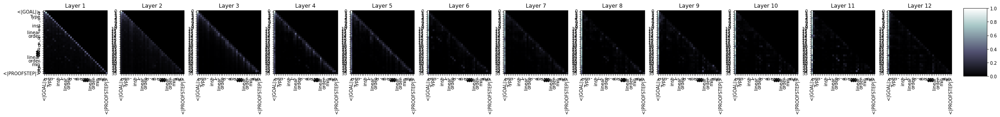

95998it [1:06:04, 26.44it/s]

  Step 96,000  of  147,271. Loss: 0.9128268957138062.   Elapsed: 1:06:04.
Sample:refine ⟨a⟩<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simpa using tg_lt_of_dvd_dvd_iff (dvd_image (lt _ _ _)) tg_lt_of_dvd_dvd_iff_of_le_of_left _<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact (preimage_of_mem (preimage_of_mem (right_mem_dvd _)) _<|endoftext|><|PROOFSTEP|>simp_rw /preimage_of<|GOAL|> (right_mem_dvd hv_left hv_left)<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>assumption {<|endoftext|><|PROOFSTEP|>trivial} {trivial} : ∀₀ ⁻¹₀, nnreal.dist_eq_to_vars_2 {to_real :=<|endoftext|><|PROOFSTEP|>ext1 hv1₁ hv2₂ h against h
s -> 0.3379433751106262
rw -> 0.2701827585697174
ex -> 0.10049891471862793
apply -> 0.07090334594249725
cases -> 0.07021390646696091
int -> 0.05707512050867081
re -> 0.027487613260746002
ext -> 0.023412948474287987
have -> 0.02195494808256626
ref -> 0.020327134057879448


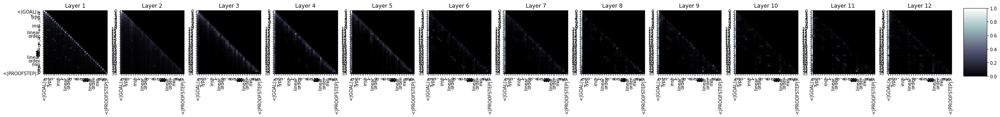

99198it [1:08:15, 29.34it/s]

  Step 99,200  of  147,271. Loss: 1.2919983863830566.   Elapsed: 1:08:16.
Sample:rintros ⟨rfl, hrfl⟩<|endoftext|><|PROOFSTEP|>rw [← mul_cons, add_comm, finset_eq_top, add_comm] at finset_top<|endoftext|><|PROOFSTEP|>simp only [← add_comm, add_comm]<|endoftext|><|PROOFSTEP|>rw [← add_comm, set.add_left, alg_apply_right]<|endoftext|><|PROOFSTEP|>rw mul_left<|endoftext|><|PROOFSTEP|>rw mul_right<|endoftext|><|PROOFSTEP|>apply_instance_rpow<|endoftext|><|PROOFSTEP|>rw __1 (int.set.of_true _ (le_antisymm (set.antisymm_of_false_top)), _ (set.of_true_iff_ne_zero)), le_right ←set.of_true_iff_ne_zero, set.of_true_iff_ne_zero_of_false_top<|endoftext|><|PROOFSTEP|>apply_instance id<|endoftext|><|PROOFSTEP|>rw [set.set_top
s -> 0.3538556694984436
rw -> 0.3378337323665619
ex -> 0.12286274135112762
apply -> 0.051006920635700226
cases -> 0.04352803900837898
int -> 0.028477754443883896
re -> 0.019488006830215454
have -> 0.015607797540724277
ext -> 0.015581770800054073
ref -> 0.011757655069231987


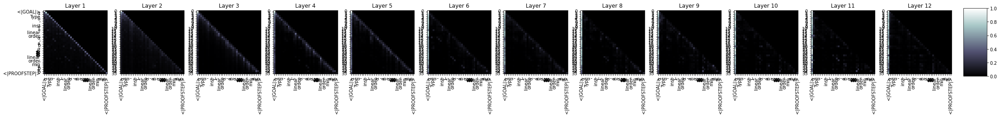

102398it [1:10:28, 27.61it/s]

  Step 102,400  of  147,271. Loss: 1.4454728364944458.   Elapsed: 1:10:28.
Sample:simp<|endoftext|><|PROOFSTEP|>simpa using simpa_tsum_le_zero using simpa_trunc_iff_zero.smul<|endoftext|><|PROOFSTEP|>induction b with b hb<|endoftext|><|PROOFSTEP|>simpa using t2_ne.1<|endoftext|><|PROOFSTEP|>rw [← int.repr, nat.zero_div_assoc, int.le_zero, int.zero_div_assoc, int.zero_div_assoc, int.zero_div_assoc, int.repr, int.le_one, rfl, zero_div_pos, one_ne_zero, one_ne]<|endoftext|><|PROOFSTEP|>rcases (int.lt_div_assoc) at real.div_zero.lt_repr with real.eq_to_real.lt_zero<|endoftext|><|PROOFSTEP|>simp only [norm_inv, ← int.ne_zero_iff_abs, ← if_false]<|endoftext|><|PROOFSTEP|>sim
s -> 0.3402511179447174
rw -> 0.3210342824459076
ex -> 0.14422892034053802
apply -> 0.04380648583173752
int -> 0.03341144323348999
re -> 0.030711039900779724
cases -> 0.027895277366042137
ext -> 0.021928228437900543
ref -> 0.01892402209341526
have -> 0.0178093072026968


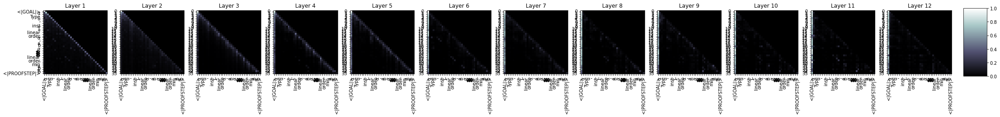

105599it [1:12:41, 22.82it/s]

  Step 105,600  of  147,271. Loss: 1.3069062232971191.   Elapsed: 1:12:42.
Sample:exact prod.le_iff_sup_right (infi_le_iff _ _).symm<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [mul]<|endoftext|><|PROOFSTEP|>simp only [sub_pos_right]<|endoftext|><|PROOFSTEP|>exists_add_self<|endoftext|><|PROOFSTEP|>simp only [add_zero]<|endoftext|><|PROOFSTEP|>simp.left_refl<|endoftext|><|PROOFSTEP|>exists_one<|endoftext|><|PROOFSTEP|>rw [add_right]<|endoftext|><|PROOFSTEP|>summable<|endoftext|><|PROOFSTEP|>rintros<|endoftext|><|PROOFSTEP|>induction<|endoftext|><|PROOFSTEP|>left<|endoftext|><|PROOFSTEP|>sub_of_def { set_inv i _, set_inv _, set_fun_inj _ _, (zero_left, set.zero_le_fun.inj, zero_right]<|endoftext|><|PROOFSTEP|>simpa [add_left] using<|endoftext|><|PROOFSTEP|>by_contradiction<|endoftext|><|PROOFSTEP|>by_contradiction<|endoftext|><|PROOFSTEP|>simp using iha<|endoftext|><|PROOFSTEP|>simp_coe<|endoftext|><|PROOFSTEP|>apply_to_right_zero.2_
s -> 0.4465317130088806
rw -> 0.2122467

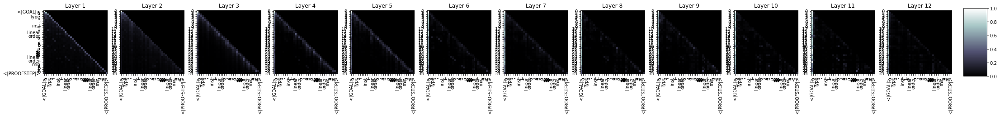

108798it [1:14:55, 26.61it/s]

  Step 108,800  of  147,271. Loss: 0.6929702758789062.   Elapsed: 1:14:56.
Sample:simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply le_refl<|endoftext|><|PROOFSTEP|>cases' [←_, ←_, rfl, (in this order)_eq_iff_iff_pi, rfl]<|endoftext|><|PROOFSTEP|>rw one_iff_le_iff_le<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [mul_one, mul_self, mul_self, mul_le_self (mul_self, mul_self, one_le_right)]<|endoftext|><|PROOFSTEP|>sf<|endoftext|><|PROOFSTEP|>rpow_right_iff_nhds<|endoftext|><|PROOFSTEP|>rw one_iff_nhds<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>cases_eq_iff<|endoftext|><|PROOFSTEP|>rw [1 / 2]<|endoftext|><|PROOFSTEP|>apply_left (lt_mul.1.1_0.2.1 / le_le_bot.2.1_2.2.1_right_le.2)<|endoftext|><|PROOFSTEP|>s
s -> 0.40867966413497925
rw -> 0.2556900978088379
ex -> 0.1414755880832672
cases -> 0.045369502156972885
int -> 0.04101209342479706
apply -> 0.031775396317243576
re -> 0.0220594312995672

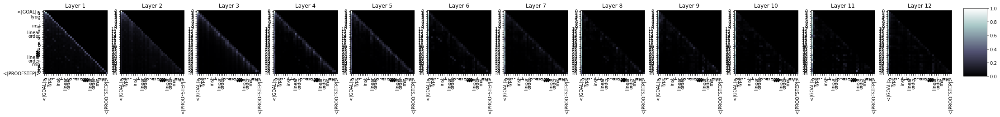

111999it [1:17:07, 28.67it/s]

  Step 112,000  of  147,271. Loss: 1.2510533332824707.   Elapsed: 1:17:08.
Sample:obtain ⟨c, hc⟩ := {lt, hc}<|endoftext|><|PROOFSTEP|>exact_mod_cast ⟨c, h │ bit0, bit1, h⟩<|endoftext|><|PROOFSTEP|>ext1 h⟩<|endoftext|><|PROOFSTEP|>rw int.coe_eq_zero<|endoftext|><|PROOFSTEP|>rw int.eq_zero at gz2<|endoftext|><|PROOFSTEP|>rw nat.zero_eq_zero at mv_add0<|endoftext|><|PROOFSTEP|>rw mul_zero at mul_add0<|endoftext|><|PROOFSTEP|>ds_equiv_le_right at s<|endoftext|><|PROOFSTEP|>ext1 { map { (x : x) := bernstein_le_zero_left, rfl}<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ext1<|endoftext|><|PROOFSTEP|>add_zero<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simpa only [_subtype_apply, subtype.1, subtype.2] using set.subtype_refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact_le<|endoftext|><|PROOFSTEP|>cases_
s -> 0.4272865355014801
rw -> 0.22861099243164062
ex -> 0.13093240559101105
apply -> 0.05455191433429718
int -> 0.03867071121931076
cases -> 0.036398932337

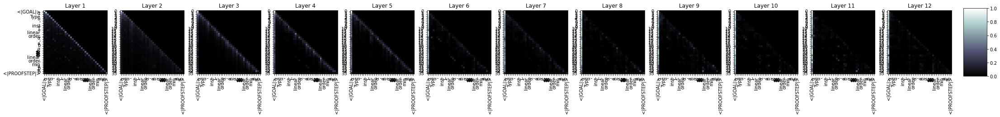

115200it [1:19:20, 21.74it/s]

  Step 115,200  of  147,271. Loss: 1.6660680770874023.   Elapsed: 1:19:20.
Sample:intros<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>haveI := {a := [a := [y, hd] := [y := [a := y], hd := hm]}<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>t<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [eq_inv_le]<|endoftext|><|PROOFSTEP|>have := nat.le_inv_iff.3 simp at hrefl<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>apply_repr_le_of_bot_mem_le_of_top.2<|endoftext|><|PROOFSTEP|>rw [le_inv_iff.2.0]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply ⟨_1, le_prod_eq_top.1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact _1.1 (le_prod_eq_top.1 _1.2 (mem_le_top_of_basis_le))<|endoftext|><|PROOFSTEP|>apply a<|endoftext|><|PROOFSTEP|>have<|endoftext|><|PROOFSTEP|><|endoftext|><|PROOFSTEP|>rw [algebra_sub
s -> 0.49020811915397644
rw -> 0.22320246696472168
ex -> 0.10892698168754578
apply -> 0.041186053305864334
cases -> 0.03544437885284424
i

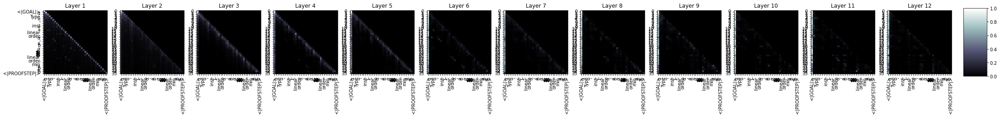

118398it [1:21:32, 24.24it/s]

  Step 118,400  of  147,271. Loss: 1.1763049364089966.   Elapsed: 1:21:32.
Sample:rw [min_le_iff_max, min_eq_one_iff, min_le_iff]<|endoftext|><|PROOFSTEP|>exact ⟨_, h, _⟩<|endoftext|><|PROOFSTEP|>rw [← set_of_mem, set.set_of_mem, mem_of_eq]<|endoftext|><|PROOFSTEP|>simp only [x]<|endoftext|><|PROOFSTEP|>simp only [x]<|endoftext|><|PROOFSTEP|>simp_lt_coe<|endoftext|><|PROOFSTEP|>rw ← simp_lt_coe_pos<|endoftext|><|PROOFSTEP|>simp_lt_of_left<|endoftext|><|PROOFSTEP|>have simp_le<|endoftext|><|PROOFSTEP|>t_top<|endoftext|><|PROOFSTEP|>right<|endoftext|><|PROOFSTEP|>rw top_right<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>intros<|endoftext|>by_refl (h_contra) ⟨<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>refine ⟨_1, _h.prod⟩<|endoftext|><|PROOFSTEP|>simp.trans<|endoftext|><|PROOFSTEP|>simp.rfl<|endoftext|><|PROOFSTEP|>simp.s_h<|endoftext|><|PROOFSTEP|>
s -> 0.4067106544971466
rw -> 0.21192030608654022
ex -> 0.15797437727451324
apply -> 0.056974515318870544
cases -> 0.

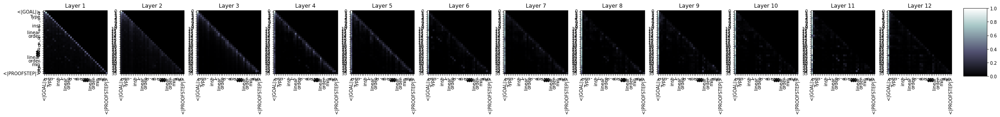

121598it [1:23:45, 24.43it/s]

  Step 121,600  of  147,271. Loss: 1.0022995471954346.   Elapsed: 1:23:45.
Sample:simp [min_eq_upwards_iff]<|endoftext|><|PROOFSTEP|>cases a b with e e<|endoftext|><|PROOFSTEP|>change b x with e e e<|endoftext|><|PROOFSTEP|>simp : a = 1 <|> w _ _ _ _ _ _ _ _ 0<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have : (m n).2 <|<|GOAL|>R|> has_pos 0 ∈ 0<|endoftext|><|PROOFSTEP|>rw [nat.trans.trans_iff, is_mul]<|endoftext|><|PROOFSTEP|>rw is_mul_pos_iff_ne_zero at h0<|endoftext|><|PROOFSTEP|>norm_zero<|endoftext|><|PROOFSTEP|>simp_zero<|endoftext|><|PROOFSTEP|>simp_ne_zero.1.1<|endoftext|><|PROOFSTEP|>try {refl}<|endoftext|><|PROOFSTEP|>rw [mem_zero_iff, norm_zero_eq_zero]<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>s_one at h0<|endoftext|><|PROOFSTEP|>rintro ⟨_⟩<|endoftext|><|PROOFSTEP|>have := 0, by hc<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>to_lt_
s -> 0.4157755970954895
rw -> 0.197597473859787
ex -> 0.14438574016094208
apply -> 0.05995873734354973
cases 

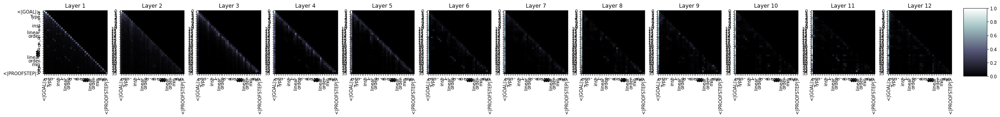

124800it [1:25:57, 25.67it/s]

  Step 124,800  of  147,271. Loss: 1.0457473993301392.   Elapsed: 1:25:57.
Sample:intros<|endoftext|><|PROOFSTEP|>simp only [← add_comm, ← add_assoc, ← add_mul] { rel := {a b, ← mul_left, mul_right, add_right, mul_mul}, rel := {a b, ← mul_right, mul_left, add_right, add_mul} }<|endoftext|><|PROOFSTEP|>dsimp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simpa using emetric.trans_bundle_left (bij_one_left_mul) bij_one_right_mul_left (bij_one_right_mul)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext 1 { rw [bij_one_left_mul, bij_one_right_mul] }<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp_rw ← subtype.supr at le<|endoftext|><|PROOFSTEP|>exists_le_
s -> 0.5300469398498535
rw -> 0.19129227101802826
ex -> 0.11179536581039429
apply -> 0.037945520132780075
int -> 0.028174523264169693
cases -> 0.026712831109762192
re -> 0.02258598804473877
sim -> 0.017603246495127678
ext -> 0.017055271193385124
ref -> 0.01678

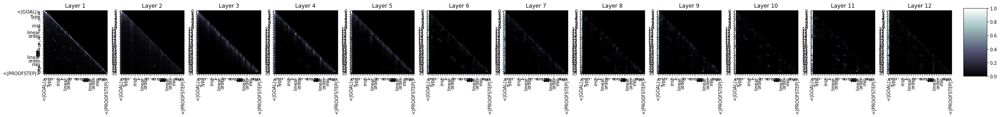

127998it [1:28:09, 23.30it/s]

  Step 128,000  of  147,271. Loss: 1.109440803527832.   Elapsed: 1:28:10.
Sample:simp only [coe_lt_coe, min_le_coe]<|endoftext|><|PROOFSTEP|>have h : ∀ {i : ℕ} {a : α}, i ∈ option.some a → i = a a := ⟨z, c rfl⟩<|endoftext|><|PROOFSTEP|>rw [← mul_assoc, ← pos_of_pos_nsmul]<|endoftext|><|PROOFSTEP|>cases le_of_length 0 with h<|endoftext|><|PROOFSTEP|>convert le_of_length<|endoftext|><|PROOFSTEP|>rw [← rfl, le_of_length_eq_self_iff, rfl.2.1]<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>apply_match<|endoftext|><|PROOFSTEP|>have I.I.fst (I.I, I.I.snd).nnd<|endoftext|><|PROOFSTEP|>have B<|endoftext|><|PROOFSTEP|>apply_match_unintros I<|endoftext|><|PROOFSTEP|>simp only [← intros_nnd, intros_nnd]<|endoftext|><|PROOFSTEP|>have {
s -> 0.36371374130249023
rw -> 0.2650430202484131
ex -> 0.13431471586227417
apply -> 0.06533228605985641
cases -> 0.04541146382689476
have -> 0.029866717755794525
int -> 0.02837660163640976
ref -> 0.02539047598838806
re -> 0.023010993376374245
sim -> 0.01954

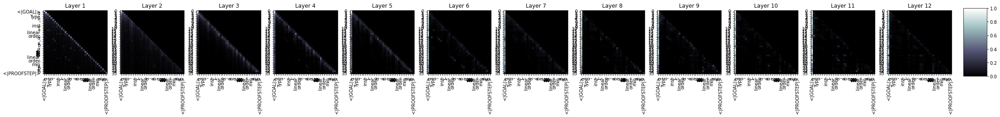

131200it [1:30:21, 25.52it/s]

  Step 131,200  of  147,271. Loss: 0.8445190191268921.   Elapsed: 1:30:22.
Sample:intro e<|endoftext|><|PROOFSTEP|>assume : continuous algebraic_order α<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>cases a :<|endoftext|><|PROOFSTEP|>rintros ⟨s, hs⟩⟩<|endoftext|><|PROOFSTEP|>cases a : a' ⟩<|endoftext|><|PROOFSTEP|>sigma hym sigma hym ⟨x, hy⟩<|endoftext|><|PROOFSTEP|>sigma.pi_cast_pos hv hym at hs<|endoftext|><|PROOFSTEP|>sigma_ne_zero := hv hv<|endoftext|><|PROOFSTEP|>sigma_ne_zero.1.1<|endoftext|><|PROOFSTEP|>sigma_2 : 1 - only 1 - only 1 - only 1 (h1).2.2 (h1.prod 1 (2 - only 1))<|endoftext|><|PROOFSTEP|>exposition 1<|endoftext|><|PROOFSTEP|>norm_eq_zero<|endoftext|><|PROOFSTEP|>ex<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>apply ⟨l, pw⟩<|endoftext|><|PROOFSTEP|>split_ifs.1 with ⟨s, ifs, rfl�
s -> 0.47414669394493103
rw -> 0.19042322039604187
ex -> 0.12417051196098328
apply -> 0.04994191601872444
cases -> 0.04237924888730049
ext -> 0.02623259276151657
ref -> 0.

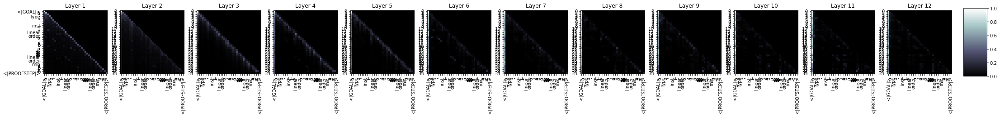

134400it [1:32:37, 25.93it/s]

  Step 134,400  of  147,271. Loss: 1.2108827829360962.   Elapsed: 1:32:37.
Sample:exact min_le_min a<|endoftext|><|PROOFSTEP|>apply_rpow_of every h<|endoftext|><|PROOFSTEP|>simp [interval, if_pos]<|endoftext|><|PROOFSTEP|>rw nat_eq_nat_iff_not_eq_true_iff_true<|endoftext|><|PROOFSTEP|>apply_rpow_of at fintype k<|endoftext|><|PROOFSTEP|>indiv_eq_normed_norm<|endoftext|><|PROOFSTEP|>simp [pow_eq_eq_normed_normed_normed_normed]<|endoftext|><|PROOFSTEP|>snd<|endoftext|><|PROOFSTEP|>have i1 : pgame := nat_eq_normed_normed_ conditions.5,condition_not_of_nonneg snd<|endoftext|><|PROOFSTEP|>ext snd<|endoftext|><|PROOFSTEP|>by bs1 bs1<|endoftext|><|PROOFSTEP|>apply_normed_normed_eq_empty<|endoftext|><|PROOFSTEP|>by_nhds<|endoftext|><|PROOFSTEP|>dsb<|endoftext|><|PROOFSTEP|>have := _<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>h0<|endoftext|><|PROOFSTEP|>by pfg<|endoftext|><|PROOFSTEP|>s
s -> 0.44323140382766724
ex -> 0.17376302182674408
rw -> 0.16208331

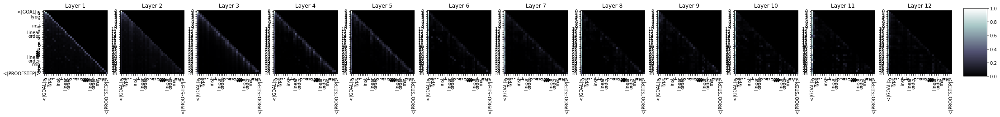

137599it [1:34:51, 20.79it/s]

  Step 137,600  of  147,271. Loss: 0.7641908526420593.   Elapsed: 1:34:52.
Sample:simp [min_lt_one]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>induction n with n hd ihne<|endoftext|><|PROOFSTEP|>apply hd<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [h₁, hy, h₁, h₂]<|endoftext|><|PROOFSTEP|>exact {simp, dif}<|endoftext|><|PROOFSTEP|>simp.1<|endoftext|><|PROOFSTEP|>simp.2<|endoftext|><|PROOFSTEP|>simp.1<|endoftext|><|PROOFSTEP|>simps<|endoftext|><|PROOFSTEP|>simp.1<|endoftext|><|PROOFSTEP|>simp.2<|endoftext|><|PROOFSTEP|>simp.2<|endoftext|><|PROOFSTEP|>simp.1<|endoftext|><|PROOFSTEP|>simps<|endoftext|><|PROOFSTEP|>simp.2d<|endoftext|><|PROOFSTEP|>ds<|endoftext|>n<|endoftext|><|PROOFSTEP|>simp 2ndsp<|endoftext|>c<|endoftext|><|PROOFSTEP|>simp<|endoftext|>refl<|endoftext|>m ℚ<|endoftext|>IH<|endoftext|><|PROOFSTEP|>simpf [pow_of_of_pos (prod]<|endoftext|><|PROOFSTEP|>simp.1.2 

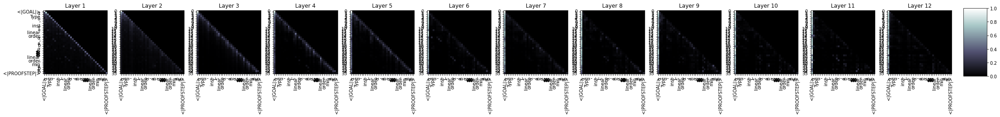

140800it [1:37:02, 28.69it/s]

  Step 140,800  of  147,271. Loss: 0.8949127793312073.   Elapsed: 1:37:03.
Sample:exact min_lt_max_iff.2<|endoftext|><|PROOFSTEP|>apply le_sup_bot_iff_le_left.1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simpa only [nat.def, nat.smul_cast, nat.coe_add]<|endoftext|><|PROOFSTEP|>sigma.mem<|endoftext|><|PROOFSTEP|>sigma_trans [mem_sub_eq_empty]<|endoftext|><|PROOFSTEP|>univ.com.g rfl<|endoftext|><|PROOFSTEP|>have hsis_mem_left<|endoftext|><|PROOFSTEP|>sigma_prod<|endoftext|><|PROOFSTEP|>by_cases tl hlt hlt_eq_left<|endoftext|><|PROOFSTEP|>sigma.zero_def<|endoftext|><|PROOFSTEP|>exists.ne<|endoftext|><|PROOFSTEP|>sigma.1.0<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_bot<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>simp.2<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases.1<|endoftext|>0 _ tl<|endoftext|>n1 _<|endoftext|><|PROOFSTEP|>simp<|endoftext|><

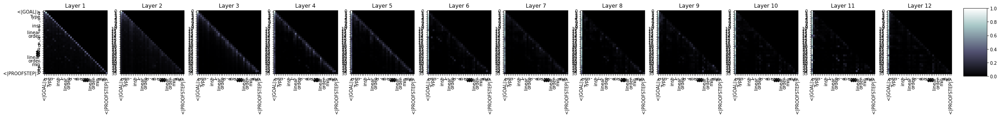

144000it [1:39:14, 26.71it/s]

  Step 144,000  of  147,271. Loss: 1.273327112197876.   Elapsed: 1:39:14.
Sample:apply max_neg_of_le_mul_le<|endoftext|><|PROOFSTEP|>apply le_bot_iff.1<|endoftext|><|PROOFSTEP|>intros a b c<|endoftext|><|PROOFSTEP|>use m<|endoftext|><|PROOFSTEP|>by_case (mem_eq_of_inj : inj, inj.2, inj.3)<|endoftext|><|PROOFSTEP|>slt_zero<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>have : inj.1 := inj, intros.1, inj.2, _<|endoftext|><|PROOFSTEP|>conj_true<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>show_inj.1 (inj.left, one_div_of_inj.1 _<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>set<|endoftext|><|PROOFSTEP|>s := a, set_inj (inj.left, one_div_of_inj.1 _ _ _), xn<|endoftext|><|PROOFSTEP|>simp only [right_add, zero_zero, eq_neg] at h<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>
s -> 0.3135121762752533
rw -> 0.25583478808403015
ex -> 0.2013712227344513
apply -> 0.10023165494203568
have -> 0.02727353386580944


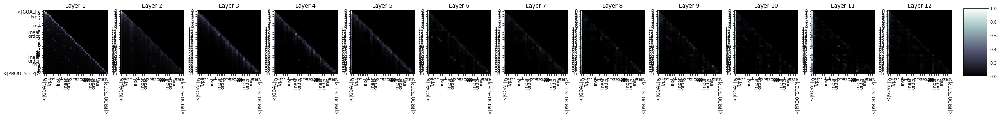

147200it [1:41:26, 23.16it/s]

  Step 147,200  of  147,271. Loss: 1.0207332372665405.   Elapsed: 1:41:27.
Sample:simp [min_lt_right, max_eq_one]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [← add_sub_right_iff_div_comm]<|endoftext|><|PROOFSTEP|>simp 0!<|endoftext|><|PROOFSTEP|>simp_iff_nonneg'<|endoftext|><|PROOFSTEP|>simp (h.nonneg)<|endoftext|><|PROOFSTEP|>simp_le<|endoftext|><|PROOFSTEP|>intro h1<|endoftext|><|PROOFSTEP|>dvd<|endoftext|><|PROOFSTEP|>t_right e<|endoftext|><|PROOFSTEP|>simps_to_refl<|endoftext|>C<|endoftext|><|PROOFSTEP|>simps a congr_true a<|endoftext|><|PROOFSTEP|>exists<|endoftext|><|PROOFSTEP|>h₁<|endoftext|><|PROOFSTEP|>t<|endoftext|><|PROOFSTEP|>exists gt_bUnion_univ pne_bUnion_univ, sdvd_of_univ_left<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>by_cases : sg<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>contradiction<|endoftext|><|PROOFSTEP|>apply_bUnion<|endoftext|><|PROOFSTEP|>from h1 h1<|endoftext|>p<|endoftext|><|PROOFSTEP|>classical<|endoftext|><|PROOFS

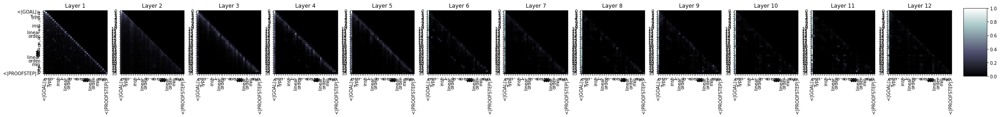

147271it [1:41:35, 24.16it/s]



  Average training loss: 1.12
  Training epoch took: 1:41:35

Running Validation...
  Validation Loss: 1.05
  Validation took: 0:01:34


4it [00:00, 28.60it/s]


======== Epoch 21 / 35 ========
Training...


3198it [02:07, 25.66it/s]

  Step 3,200  of  147,271. Loss: 0.800018846988678.   Elapsed: 0:02:08.
Sample:ext<|endoftext|><|PROOFSTEP|>exact prod_const_le_const a b<|endoftext|><|PROOFSTEP|>let w := int.max_iff_min_le w.1 ↔ w.1 = w.1.0<|endoftext|><|PROOFSTEP|>simp only [hc, max_iff_min]<|endoftext|><|PROOFSTEP|>rcases hc with ⟨hc, hc'⟩<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>rw {split := {finset := {I := I + 1 | (one_mem_I hm).2 IH}<|endoftext|><|PROOFSTEP|>simp.rw [iff_mem_I _ one_mem_I]<|endoftext|><|PROOFSTEP|>simp.1.1 [IH : has_I_mem]<|endoftext|><|PROOFSTEP|>rw id<|endoftext|><|PROOFSTEP|>simp.1<|endoftext|><|PROOFSTEP|>simp.2<|endoftext|><|PROOFSTEP|>s1 (le_IH_1) _IH_2<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>have (hi1_nhds_lt_self [lt_
s -> 0.3121773600578308
rw -> 0.3077111542224884
ex -> 0.18147531151771545
apply -> 0.04785861074924469
sim -> 0.037040505558252335
int -> 0.02886374294757843
ref -> 0.025010284036397934
cases -> 0.024873845279216766
have -> 0.01826468482613563

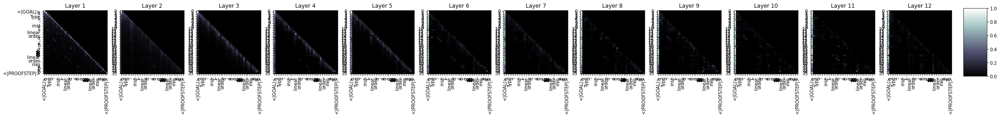

6399it [04:18, 24.82it/s]

  Step 6,400  of  147,271. Loss: 1.4283092021942139.   Elapsed: 0:04:19.
Sample:simp<|endoftext|><|PROOFSTEP|>assumption<|endoftext|><|PROOFSTEP|>convert le_lt _ _ _<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp1_iff_le<|endoftext|><|PROOFSTEP|>simp1_coe<|endoftext|><|PROOFSTEP|>simp2<|endoftext|><|PROOFSTEP|>apply_instance_of_eq_top<|endoftext|>0_1 : ∃ (p : fin P), 1 = 0, [finset.sup_left]<|endoftext|><|PROOFSTEP|>try {refl]<|endoftext|><|PROOFSTEP|>assumption.1<|endoftext|><|PROOFSTEP|>apply_instance_of_eq_top0 0<|endoftext|><|PROOFSTEP|>rcases rfl0 with _<|endoftext|><|PROOFSTEP|>s : (finset $ g<|endoftext|><|PROOFSTEP|>simient.1 {refl]<|endoftext|><|PROOFSTEP|>rw [← le_add, ← le_top, ← one_lt_add, ← rfl, ← has_sub]<|endoftext|><|PROOFSTEP|>exact h1<|endoftext|><|PROOFSTEP|>exact ⟨0, ← le_one, ← h1, ha0, hs
s -> 0.4249570369720459
rw -> 0.19876159727573395
ex -> 0.19629688560962677
apply -> 0.042267318814992905
sim -> 0.03226137533783913
int -> 0.026195965707

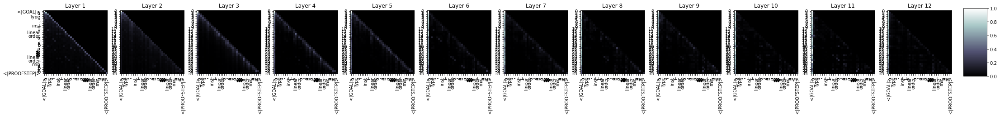

9599it [06:31, 29.25it/s]

  Step 9,600  of  147,271. Loss: 1.6301089525222778.   Elapsed: 0:06:32.
Sample:exact min_le<|endoftext|><|PROOFSTEP|>have I : xor xs xs<|endoftext|><|PROOFSTEP|>exact i.right_le_of_lhs xs<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [eq_pos_neg]<|endoftext|><|PROOFSTEP|>simp_right<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>simp_right<|endoftext|><|PROOFSTEP|>refl<|endoftext|>p_nhds<|endoftext|><|PROOFSTEP|>rw [nhds_of_not_not_or_nonneg]<|endoftext|><|PROOFSTEP|>refine_comp_of_not (λ_, _, _' _, _' _', (IH λ h, h.1 h.2 h.3).1.1.1, _' $ _ ⟨_ _, _, _'⟩<|endoftext|><|PROOFSTEP|>exact λ_, _, _'⟩<|endoftext|><|PROOFSTEP|>exact h.2<|endoftext|><|PROOFSTEP|>rpow<|endoftext|><|PROOFSTEP|>ext x1 h_1 h_1<|endoftext|><|PROOFSTEP|>rcases h_1 with
s -> 0.47402897477149963
rw -> 0.20695644617080688
ex -> 0.16792576014995575
sim -> 0.032249465584754944
int -> 0.028943706303834915
apply -> 0.028360236436128616
have -> 0.019022518768906593
ref -> 0.01598496548831463
re -> 0.013

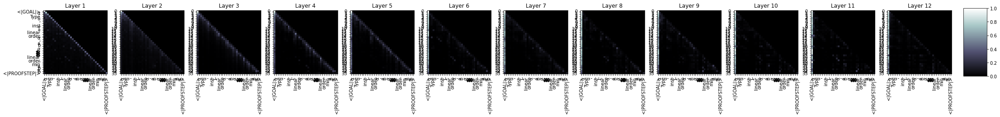

12799it [08:42, 23.17it/s]

  Step 12,800  of  147,271. Loss: 1.2088826894760132.   Elapsed: 0:08:43.
Sample:intros<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>induction x<|endoftext|><|PROOFSTEP|>try {contextual, intros}<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>svd x sf<|endoftext|><|PROOFSTEP|>rw [ext] {y, hy, _, hx, hy, xsf} with h hx₁<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintros ⟨⟨a, hb, hc, hcf, hf, hf, hb, hc₁⟩<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>subst<|endoftext|><|PROOFSTEP|>class X<|endoftext|>VY<|endoftext|><|PROOFSTEP|>ext x<|endoftext|>real' x.1 :=<|endoftext|><|PROOFSTEP|>rintros ⟨a, hb, hc, hf, hf, hf, hhf₁, hb, hb₂<|endoftext|><|PROOFSTEP|>simp [h] at a<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintros<|endoftext|><|PROOFSTEP|>simp
s -> 0.41550764441490173
ex -> 0.22288931906223297
rw -> 0.16593198478221893
int -> 0.050694696605205536

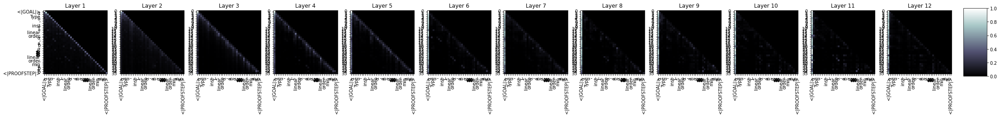

15998it [10:55, 27.10it/s]

  Step 16,000  of  147,271. Loss: 1.8048698902130127.   Elapsed: 0:10:56.
Sample:let L L' := min_le_max a b<|endoftext|><|PROOFSTEP|>simp only [mul_comm]<|endoftext|><|PROOFSTEP|>unfold_self_eq<|endoftext|><|PROOFSTEP|>rintro ⟨a ⟨b ⟨c, hb⟩<|endoftext|><|PROOFSTEP|>simpa using ⟨a⟩, rfl⟩<|endoftext|><|PROOFSTEP|>simp only [pow_zero_left_eq_zero, one_eq_zero_right]<|endoftext|><|PROOFSTEP|>simp only [pow_zero_left_eq_zero, one_eq_one] using ⟨B, C, cmk, hb⟩<|endoftext|><|PROOFSTEP|>exact sub_mul<|endoftext|><|PROOFSTEP|>refine ⟨a, a₁, b₂⟩<|endoftext|><|PROOFSTEP|>simp only [b0, ab, hb⟩] using ⟨a,b, ab, hb⟩<|endoftext|><|PROOFSTEP|>exact
s -> 0.371267706155777
ex -> 0.2402847558259964
rw -> 0.18891309201717377
apply -> 0.05620141699910164
sim -> 0.03845784440636635
int -> 0.03717493638396263
have -> 0.02048191986978054
ext -> 0.016468802466988564
ref -> 0.015411102212965488
re -> 0.015338464640080929


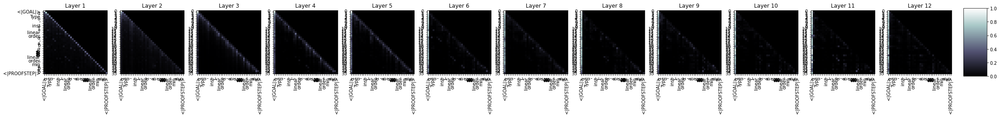

19200it [13:09, 25.22it/s]

  Step 19,200  of  147,271. Loss: 1.2895838022232056.   Elapsed: 0:13:09.
Sample:rw [← eq_neg_of_neg b]<|endoftext|><|PROOFSTEP|>rw nat.zero_eq_iff_zero.2<|endoftext|><|PROOFSTEP|>rw [le_lt, not_lt]<|endoftext|><|PROOFSTEP|>rw le_iff.2<|endoftext|><|PROOFSTEP|>let g : (pow_le_one _ _ _ _).ne_bot<|endoftext|><|PROOFSTEP|>show ⟨a, a⟩ ⟨a_ne_bot, a⟩<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>rw rfl<|endoftext|><|PROOFSTEP|>rw [cancel, pow_eq_not_le_of_lt, pow_not_eq_cancel]<|endoftext|><|PROOFSTEP|>by ⟨a, a⟩<|endoftext|><|PROOFSTEP|>rw ←cancel<|endoftext|><|PROOFSTEP|>assoc<|endoftext|><|PROOFSTEP|>rw [mul, h2, mul.snd_self, ←cancel]<|endoftext|><|PROOFSTEP|>rw [mem_eq_not_subset_eq_left_right_le
rw -> 0.42466044425964355
s -> 0.25274771451950073
ex -> 0.1757812350988388
apply -> 0.04082056134939194
int -> 0.023135146126151085
sim -> 0.022955631837248802
re -> 0.01751820370554924
ref -> 0.015660474076867104
ext -> 0.01526057068258524
have -> 0.0

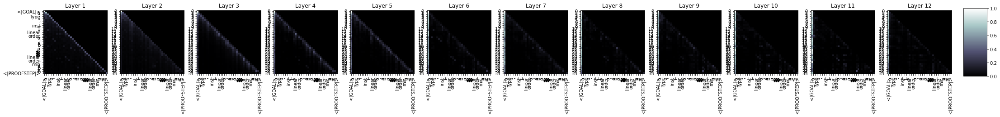

22399it [15:22, 28.65it/s]

  Step 22,400  of  147,271. Loss: 1.1552008390426636.   Elapsed: 0:15:22.
Sample:simp only [max_left_iff, min_right_iff, abs_zero]<|endoftext|><|PROOFSTEP|>linarith<|endoftext|><|PROOFSTEP|>exact inv_trans (trans_inv_trans _ _)<|endoftext|><|PROOFSTEP|>apply @trans_inv_trans_injective_of_eq_trans _<|endoftext|><|PROOFSTEP|>exists_nonempty _ (eq_nonempty _)<|endoftext|><|PROOFSTEP|>solution<|endoftext|><|PROOFSTEP|>symmetry<|endoftext|><|PROOFSTEP|>rw [symmetry]<|endoftext|><|PROOFSTEP|>rintro ⟨, ⟨r, rfl⟩<|endoftext|><|PROOFSTEP|>exists_nonempty _<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_norm_left_left<|endoftext|><|PROOFSTEP|>rw [← ← is_closed_eq, ∨<|endoftext|><|PROOFSTEP|>simp, is_closed_or_nonempty, has_dist.1_left, pre_top, pre<|GOAL|>X, is_closed_right<|endoftext|><|PROOFSTEP|>obtain ⟨m, _⟩⟩<|endoftext|>
rw -> 0.576551079750061
s -> 0.19865380227565765
ex -> 0.10997562855482101
apply -> 0.029621848836541176
int -> 0.01908678561449051
sim -> 0.016093330457806587

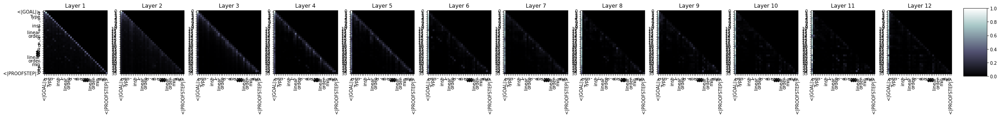

25600it [17:33, 26.82it/s]

  Step 25,600  of  147,271. Loss: 1.4071638584136963.   Elapsed: 0:17:34.
Sample:simp<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>simp only [nat.lt_coprime]<|endoftext|><|PROOFSTEP|>exact not_true_ifs<|endoftext|><|PROOFSTEP|>simp_true<|endoftext|><|PROOFSTEP|>simp_false<|endoftext|><|PROOFSTEP|>simp_false!<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_2 : true<|endoftext|><|PROOFSTEP|>simpa using _prod_lt_coe<|endoftext|>G : bool_some_false_pos, ihpi := _prod_elim<|endoftext|><|PROOFSTEP|>ass_of_true_forall_eq_true_not_true.pow_le_false<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>refine refl<|endoftext|>K_dist_eq_true (le_refl (1 | _prod_refl)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ref_eq.le_trans (not_le_self_of_ne_not_true _refl_self_inj (not_le_self_inj_
s -> 0.4414556324481964
rw -> 0.19114018976688385
ex -> 0.18010392785072327
apply -> 0.05247894674539566
int -> 0.033235207200050354
re -> 0.

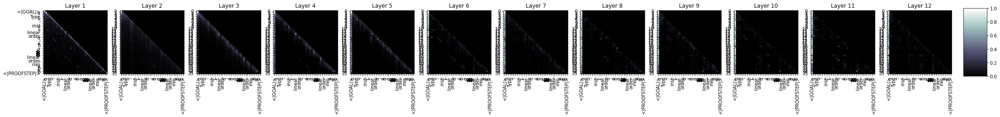

28798it [19:43, 26.46it/s]

  Step 28,800  of  147,271. Loss: 1.7606258392333984.   Elapsed: 0:19:44.
Sample:use a<|endoftext|><|PROOFSTEP|>rw [← min_le_max]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw h0_lt_coprime<|endoftext|><|PROOFSTEP|>rw h0_gt_coprime with h0_gt_one<|endoftext|><|PROOFSTEP|>rw h0_lt_coprime_left<|endoftext|><|PROOFSTEP|>exact htop_iff_one<|endoftext|><|PROOFSTEP|>ds_nonpos_zero<|endoftext|><|PROOFSTEP|>exists_coprime_zero.2<|endoftext|><|PROOFSTEP|>exists_coprime_zero<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|>is_pi_nat_s3_self_inj (pi.nat_pi_s3_self_inj_right_right_right)<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>s3_self_inj_mem_coe<|endoftext|><|PROOFSTEP|>s3_self_inj_right<|endoftext|><|PROOFSTEP|>s3_top<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw h1_rpow_selfh1
s -> 0.5178282260894775
rw -> 0.19135230779647827
ex -> 0.1242363452911377
apply -> 0.03730835020542145

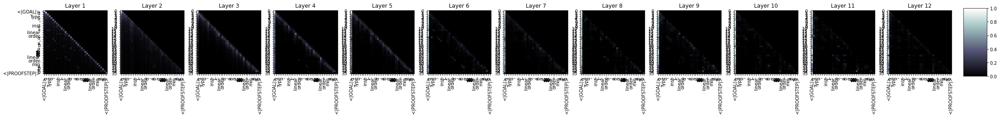

31997it [21:58, 29.63it/s]

  Step 32,000  of  147,271. Loss: 0.8224080801010132.   Elapsed: 0:21:58.
Sample:exact le_antisymm b<|endoftext|><|PROOFSTEP|>exact_fun_left _ _ ← inv_def _ (pow_le_right _ (right_inverse _))<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_instance_derive_field<|endoftext|><|PROOFSTEP|>tidy<|endoftext|><|PROOFSTEP|>rw nat.def_not_le.eq_of_nat<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>have h<|endoftext|><|PROOFSTEP|>apply_of_le (inhabit.mpr (le_nhds_nat ∘ h)).le<|endoftext|><|PROOFSTEP|>rw [mpr.trans (pow_ne_top.of_le _, hs.ne_top.tensor_left]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp := (hx : nat.refl_curry_eq_nhds_right (pow_nhds_right_iff
s -> 0.2908625602722168
ex -> 0.2544887065887451
rw -> 0.2358376532793045
apply -> 0.04960918799042702
have -> 0.04120275750756264
re -> 0.032575543969869614

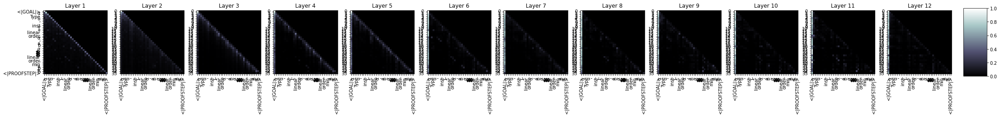

35199it [24:11, 28.15it/s]

  Step 35,200  of  147,271. Loss: 0.9935300350189209.   Elapsed: 0:24:11.
Sample:constructor<|endoftext|><|PROOFSTEP|>intros hs : preorder α<|endoftext|><|PROOFSTEP|>rw ← int.unpair<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>have : {A : ℕ := nat.sub_eq_one_zero, nat.sub_eq_one_one} a = {A}<|endoftext|><|PROOFSTEP|>unsubst<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>exact (pre_subset_of_subset_of_subset_of_non_subset)<|endoftext|><|PROOFSTEP|>convert int.finset<|endoftext|><|PROOFSTEP|>obtain ⟨⟨⟩<|endoftext|><|PROOFSTEP|>rintros⟩<|endoftext|><|PROOFSTEP|>intro ⟨⟨⟩<|endoftext|><|PROOFSTEP|>rw [mul_inv, inv_left, inv_left]<|endoftext|><|PROOFSTEP|>simp only [simp, inv_right]<|endoftext|><|PROOFSTEP|>apply mem_const<|endoftext|><|PROOFSTEP|>rw { intros, ← int, ← int.one, int.eq_one, h}
rw -> 0.3406423330307007
s -> 0.3406234681606293
ex -> 0.13290651142597198
apply -> 0.04650603234767914
have -> 0.03892563655972481
re -> 0.02680082432925701
int -> 0.02526541613042

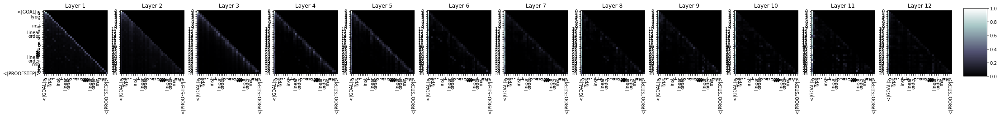

38398it [26:22, 25.92it/s]

  Step 38,400  of  147,271. Loss: 0.6815211772918701.   Elapsed: 0:26:23.
Sample:exact le_top.2 b<|endoftext|><|PROOFSTEP|>exact le_top.1<|endoftext|><|PROOFSTEP|>have := nat.le_top_singleton_nat_le.2.1<|endoftext|><|PROOFSTEP|>exact sub_top.1 _<|endoftext|><|PROOFSTEP|>exact euclidean_of_le_le_sup_right<|endoftext|><|PROOFSTEP|>exact (coe_inl, of_eq_sup_left_le, one_assoc)<|endoftext|><|PROOFSTEP|>exists ⟨_, λ s : decidable_eq, equiv.1; has_eq _ _⟩<|endoftext|><|PROOFSTEP|>s : ⟨_, λ s : decidable_eq, equiv.1<|endoftext|><|PROOFSTEP|>s1 : add_equiv _⟩ := eq, has_eq_sup_left _<|endoftext|><|PROOFSTEP|>by_cases : is_sub_div _ s1<|endoftext|><|PROOFSTEP|>s2 : sub_sub _ s1<|endoftext|><|PROOFSTEP|>s3 : exists_sub
s -> 0.45704442262649536
rw -> 0.24400633573532104
ex -> 0.10283083468675613
apply -> 0.05280561372637749
cases -> 0.033556967973709106
int -> 0.029100632295012474
have -> 0.02694075182080269
re -> 0.0240275040268898
ext -> 0.01491435058414936
norm -> 0.014772510156035423


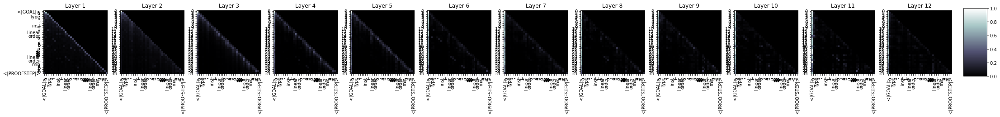

41597it [28:34, 25.51it/s]

  Step 41,600  of  147,271. Loss: 0.5810668468475342.   Elapsed: 0:28:35.
Sample:simpa [min_div] using a b.gt<|endoftext|><|PROOFSTEP|>by_cases a : ∀ {a_1 : decidable a}, λ x : ordinal, a_1 ∈ {a}, x ∈ u_1 a {a}.refl<|endoftext|><|PROOFSTEP|>simp only [hint] using hint_pos_right (λ a, _, _⟩, _⟩)<|endoftext|><|PROOFSTEP|>by mr_mk<|endoftext|><|PROOFSTEP|>linarith<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ring<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>have := nat.inj, intros<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>rw [insert_mul, inv_inj, h1, punit, nat_apply_iff]<|endoftext|><|PROOFSTEP|>ds<|endoftext|><|PROOFSTEP|>rw [← mul_apply, mul_apply, add_mul, add_singleton]<|endoftext|><|PROOFSTEP|>rw has_neg_neg, has_neg, is_neg_
s -> 0.3503423035144806
rw -> 0.22921162843704224
ex -> 0.14713425934314728
apply -> 0.08258585631847382
int -> 0.057321660220623016
have -> 0.04645317420363426
re -> 0.027540240436792374
cases -> 0.

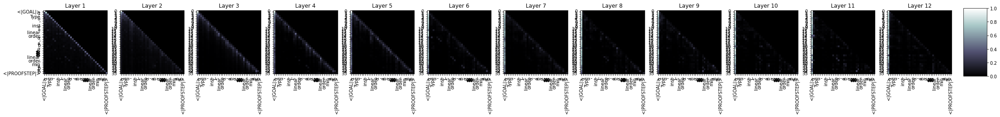

44798it [30:48, 24.69it/s]

  Step 44,800  of  147,271. Loss: 0.5980468988418579.   Elapsed: 0:30:48.
Sample:norm_num<|endoftext|><|PROOFSTEP|>rintro ⟨⟩<|endoftext|><|PROOFSTEP|>induction (λ x y z : a * z) (λ y z : a * x)<|endoftext|><|PROOFSTEP|>rcases R 1 2 with ⟨y, rfl⟩ rfl<|endoftext|><|PROOFSTEP|>exact @ne_of_lt $ le_antisymm with hah<|endoftext|><|PROOFSTEP|>simp_rw eq.inj_not_of_lt<|endoftext|><|PROOFSTEP|>exact or<|endoftext|><|PROOFSTEP|>rintros ⟨1 nk, rfl⟩<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintros<|endoftext|><|PROOFSTEP|>rintros<|endoftext|><|PROOFSTEP|>symm<|endoftext|><|PROOFSTEP|>rw [←h]<|endoftext|><|PROOFSTEP|>rintros<|endoftext|><|PROOFSTEP|>refl<|endoftext|>←<|endoftext|><|PROOFSTEP|>rintros<|endoftext|>dvd h�1<|endoftext|>this<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|>n<|endoftext|><|PROOFSTEP|>apply,<|endoftext|><|PROOFSTEP|>simp<|endoftext|>I<|endoftext|><|PROOFSTEP|>refl<|endoftext|>�<|endoftext|><|PROOFSTEP|>si

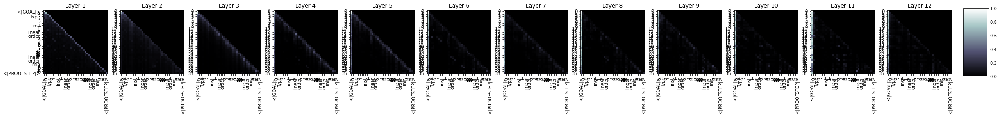

47999it [33:00, 22.54it/s]

  Step 48,000  of  147,271. Loss: 0.8558223247528076.   Elapsed: 0:33:01.
Sample:rw [le_mul_iff_one, mul_comm]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [← nat.sub_left, nat.cast_def_mk]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rintro ⟨i xz, ha, zr, hxz.eq_bot<|endoftext|><|PROOFSTEP|>norm_cast_left<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>have a : a ⊥ = a, has_bot_bot_left.coe e<|endoftext|><|PROOFSTEP|>to_of_ne_top_of_ne.<|endoftext|><|PROOFSTEP|>cases_eq_ne_top<|endoftext|><|PROOFSTEP|>cases_ne_top_of_ne_top_of_ne.1<|endoftext|><|PROOFSTEP|>apply_induction h<|endoftext|><|PROOFSTEP|>associates'<|endoftext|><|PROOFSTEP|>apply_symm<|endoftext|><|PROOFSTEP|>simp only x<|endoftext|><|PROOFSTEP|>sub_norm.1 (ne_bot_dist_left.1, ne_bot_dist
s -> 0.3991379737854004
ex -> 0.15716670453548431
rw -> 0.13177433609962463
apply -> 0.06848081946372986
int -> 0.06

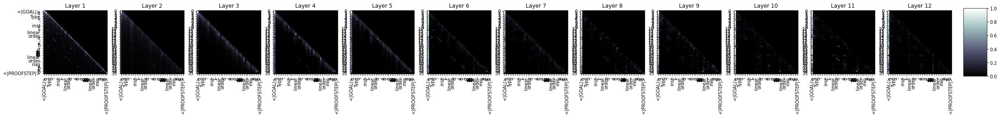

51200it [35:12, 20.01it/s]

  Step 51,200  of  147,271. Loss: 1.22418212890625.   Elapsed: 0:35:12.
Sample:tidy<|endoftext|><|PROOFSTEP|>rw [← add_comm, add_neg]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>cases _ _<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>have A<|endoftext|><|PROOFSTEP|>cases_eq A_1 : A_1_int_eq<|endoftext|><|PROOFSTEP|>apply_mem_self<|endoftext|><|PROOFSTEP|>exists_eq _<|endoftext|><|PROOFSTEP|>int_eq_right<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rintros_iff, not_lt_not,<|endoftext|><|PROOFSTEP|>p<|endoftext|><|PROOFSTEP|>simp only [trivial]<|endoftext|><|PROOFSTEP|>exists_eq_right<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>from ⊥.1.2<|endoftext|><|PROOFSTEP|>cases_right<|endoftext|>prospect rfl<|endoftext|>a<|endoftext|><|PROOFSTEP|>apply_trivial<|endoftext|><|PROOFSTEP|>rw [refla_lt_distrib_right]<|endoftext|><|PROOFSTEP|>simpa on

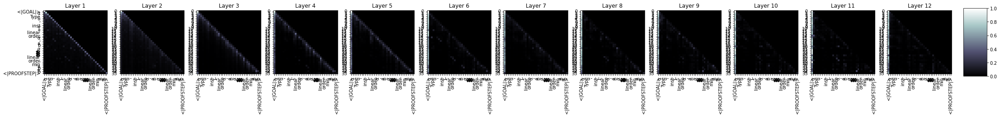

54398it [37:24, 26.64it/s]

  Step 54,400  of  147,271. Loss: 1.3557758331298828.   Elapsed: 0:37:25.
Sample:refl<|endoftext|><|PROOFSTEP|>subtract subtype subtype_eq<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [subtype.mem_le_of_nonneg, subtype.refl, ih], x<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [is_right, hx]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [is_right, hx]<|endoftext|><|PROOFSTEP|>induction_one_iff<|endoftext|><|PROOFSTEP|>s tt<|endoftext|><|PROOFSTEP|>by<|endoftext|>1 (refl_defs_le_right.refl)<|endoftext|><|PROOFSTEP|>simp.1 1⊢ tt<|endoftext|><|PROOFSTEP|>by1 1⊢ tt<|endoftext|><|PROOFSTEP|>rw [finset.h] at tt<|endoftext|><|PROOFSTEP|>sub_one<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have {refl] : 0 ∪2 ∨2,0,1,2,0,0,2,0,0,1}<|endoftext|><|PROOFSTEP|>congr<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>
s -> 0.36471113562583923
rw -> 0.3106204569339752
ex -> 0.08023599535226822
int -> 0.0547713227570

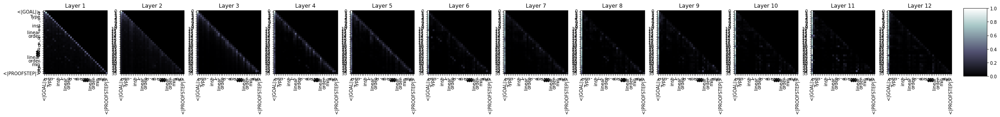

57598it [39:36, 26.54it/s]

  Step 57,600  of  147,271. Loss: 0.9707453846931458.   Elapsed: 0:39:37.
Sample:intro h<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>mul_apply<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact (pow_of_nonpos _).1 (mul_nonpos one_pow _).1 $ (mul_pos _.1)<|endoftext|><|PROOFSTEP|>linarith_nhds<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have : (pow_pow _).1 (lt_pow _).2, one_right, (tendsto_pi_eq_one_pow _).1.dvd<|endoftext|><|PROOFSTEP|>simp.lt<|endoftext|><|PROOFSTEP|>exact (simp.not_zero_right _).2, rpow_right_eq_of_zero_ne<|endoftext|><|PROOFSTEP|>exact _<|endoftext|><|PROOFSTEP|>apply_trans<|endoftext|><|PROOFSTEP|>exists_pow<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_triv
s -> 0.4623953402042389
rw -> 0.18651235103607178
ex -> 0.08584114909172058
apply 

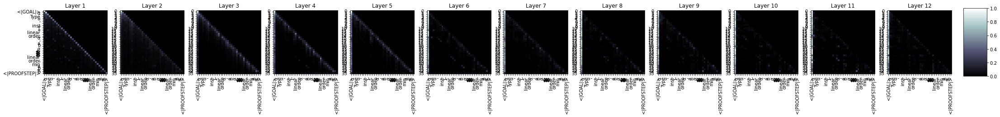

60799it [41:48, 17.55it/s]

  Step 60,800  of  147,271. Loss: 0.8642644286155701.   Elapsed: 0:41:49.
Sample:ext<|endoftext|><|PROOFSTEP|>intro h1 h2<|endoftext|><|PROOFSTEP|>intro x<|endoftext|><|PROOFSTEP|>convert ne.trans _ x<|endoftext|><|PROOFSTEP|>congr<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply le_top<|endoftext|><|PROOFSTEP|>refineI : is_open_comp_inter_right : inter_of_matrix_eq<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>injhlt<|endoftext|><|PROOFSTEP|>exact.eliminjr<|endoftext|><|PROOFSTEP|>apply_refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp a b<|endoftext|><|PROOFSTEP|>convert_h<|endoftext|><|PROOFSTEP|>ex<|endoftext|><|PROOFSTEP|>simp.symm<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s<|endoftext|>H<|endoftext|><|PROOFSTEP|>intro<|endoftext|>I : H.1.1 (1) 1<|endoftext|><|PROOFSTEP|>symm<|endoftext|><|P

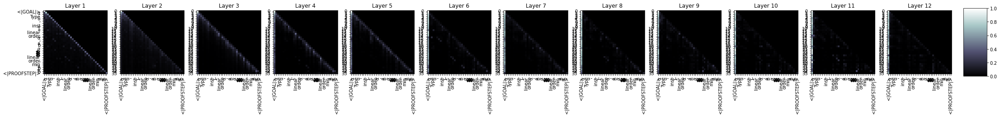

64000it [44:01, 19.47it/s]

  Step 64,000  of  147,271. Loss: 1.482539415359497.   Elapsed: 0:44:01.
Sample:exact (min_dist._refl _)<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>rw [← mem_comm, mem_assoc]<|endoftext|><|PROOFSTEP|>simp only [iff_of_inv, add_smul]<|endoftext|><|PROOFSTEP|>assoc.iso_prod = /media (left_inv_left_right)<|endoftext|><|PROOFSTEP|>simp only [add_smul]<|endoftext|><|PROOFSTEP|>show {x : ℂ := ⟨s, _⟩ := subrmatch_of_nonneg_right _ with x hx, _⟩<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>convert_le.mp (le_of_comp_left _ _ _)<|endoftext|><|PROOFSTEP|>rw [le_of_comp_right]<|endoftext|><|PROOFSTEP|>simp only [mem_self_iff, not_lt_eq_of_comp_left_right, not_lt_eq_of_comp_left, not_lt_eq_
s -> 0.36913982033729553
rw -> 0.2703498303890228
ex -> 0.09544166922569275
int -> 0.055755216628313065
apply -> 0.05171772092580795
ref -> 0.03863535821437836
re -> 0.035966090857982635
cases -> 0.03282441198825836
sim -> 0.027364974841475487
ext -> 0.022804908454418182


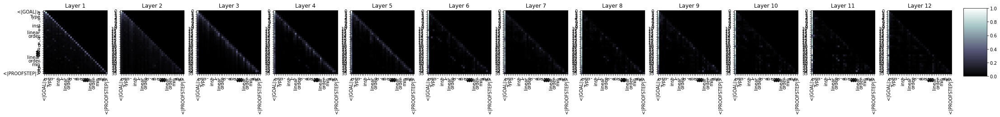

67198it [46:13, 25.61it/s]

  Step 67,200  of  147,271. Loss: 1.2147868871688843.   Elapsed: 0:46:14.
Sample:norm_num<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [← mul_left, ← mul_right]<|endoftext|><|PROOFSTEP|>simp only [add_comm, add_def, ← add_cancel]<|endoftext|><|PROOFSTEP|>reflexive (rel only) ← rel_left<|endoftext|><|PROOFSTEP|>simp : rel_left.symm.refl (subtype) (λ x, _) := ⟨h, ⟨x, rfl⟩<|endoftext|><|PROOFSTEP|>rw [← subtype.refl, ← subtype.apply_apply, ← ← h, subtype.apply_apply]<|endoftext|><|PROOFSTEP|>subtype.mk_subtype _ rfl<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [subtype.right_symm]<|endoftext|><|PROOFSTEP|>uncompl_eq<|endoftext|><|PROOFSTEP|>norm_eq_right aa<|endoftext|><|PROOFSTEP|>simp_rw ← set.eq_neg_of_neg_left.
rw -> 0.3546024560928345
s -> 0.30926910042762756
ex -> 0.08393631130456924
int -> 0.06856479495763779
apply -> 0.0450536273419857
ref -> 0.03236721456050873
re -> 0.029826980084180832
sim -> 0.027225296944379807
have -

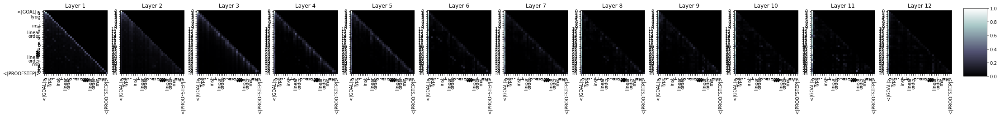

70399it [48:25, 24.67it/s]

  Step 70,400  of  147,271. Loss: 1.3066775798797607.   Elapsed: 0:48:25.
Sample:ext x<|endoftext|><|PROOFSTEP|>rwa [mem_one_iff, no_zero, add_zero_left, zero_top]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>assunctor<|endoftext|><|PROOFSTEP|>by_cases h1 : i = 0<|endoftext|><|PROOFSTEP|>ext x : 1 < int.nat_leh1<|endoftext|><|PROOFSTEP|>by_cases x : 1 = 0<|endoftext|><|PROOFSTEP|>simp only<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>simp_pos<|endoftext|><|PROOFSTEP|>cases_mem<|endoftext|><|PROOFSTEP|>simp_nat<|endoftext|>1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact { x_gcd, gcd }<|endoftext|><|PROOFSTEP|>cases_mem_one_eq_b : gcd (1+2)<|endoftext|><|PROOFSTEP|>cases_mem_one_eq_b<|endoftext|><|PROOFSTEP|>exact 1<|endoftext|><|PROOFSTEP|>simp_one_eq_b<|endoftext|>IH<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|>byrefl<|endoftext|><|endoftext|><|PROOFSTEP|>simp<|endoftext|>dite at hdvd

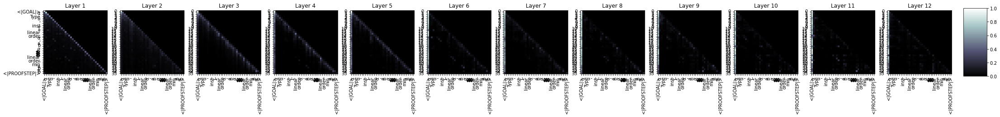

73598it [50:37, 26.54it/s]

  Step 73,600  of  147,271. Loss: 1.277471899986267.   Elapsed: 0:50:38.
Sample:rw [insert_le_of_eq_neg, ne_of_ne]<|endoftext|><|PROOFSTEP|>rw [insert_le_one] at a b<|endoftext|><|PROOFSTEP|>rw [← coe_le_of_le, coe_of_le_eq_neg, neg_eq_of_of_lt]<|endoftext|><|PROOFSTEP|>rw [← coe_left_iff]<|endoftext|><|PROOFSTEP|>ring<|endoftext|><|PROOFSTEP|>simp [← ring_le_self, ring_lt]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_of_lt<|endoftext|><|PROOFSTEP|>rw [mem_const]<|endoftext|><|PROOFSTEP|>simp_zero<|endoftext|><|PROOFSTEP|>apply_right<|endoftext|><|PROOFSTEP|>rw [←zero_pos, zero_lt_of_pos, zero_lt_of_pos] at zero_le_iff.8.2<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>exact of_zero_pos<|endoftext|><|PROOFSTEP|>rw set.eq_not_lt_of_one<|endoftext|><|PROOFSTEP|>rw [←comp_
rw -> 0.39886462688446045
s -> 0.2650297284126282
ex -> 0.09941496700048447
apply -> 0.0664142519235611
cases -> 0.06146932393312454
int -> 0.03608690947294235
have -> 0.022795354947447777
ref -> 

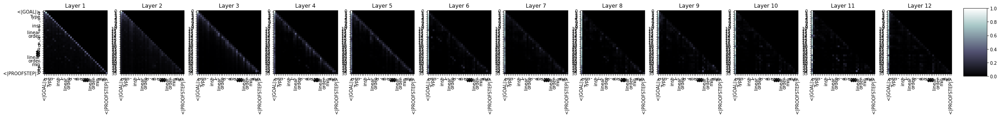

76800it [52:49, 26.36it/s]

  Step 76,800  of  147,271. Loss: 1.0784944295883179.   Elapsed: 0:52:50.
Sample:ext2<|endoftext|><|PROOFSTEP|>simp only [← add_left, ← add_lt_add_left]<|endoftext|><|PROOFSTEP|>rw add_mul_right<|endoftext|><|PROOFSTEP|>simp_right<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw {left_induction_eq _ := {induction_neg := _}<|endoftext|><|PROOFSTEP|>simp_right, by simp }<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>apply_dist_nhds<|endoftext|>this<|endoftext|><|PROOFSTEP|>apply_dist<|endoftext|><|PROOFSTEP|>cases hn : rfl<|endoftext|>I = hn<|endoftext|><|PROOFSTEP|>cases hn<|endoftext|>R ⊤<|endoftext|><|PROOFSTEP|>simp_not_mem<|endoftext|><|PROOFSTEP|>apply_restrict (f.b_1)<|endoftext|><|PROOFSTEP|>rwa_comp<|endoftext|>_right<|endoftext|><|PROOFSTEP|>rw_mul<|endoftext|><|PROOFSTEP|>induction_refl<|endoftext|>I_1<|endoftext|>1<|endoftext|><|PROOFSTEP|>rintiff.

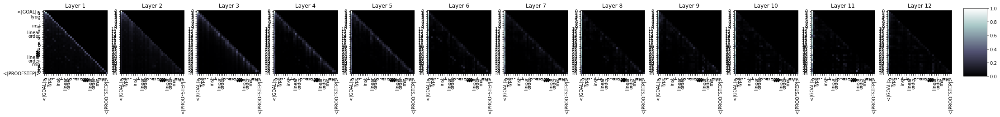

79999it [55:02, 25.71it/s]

  Step 80,000  of  147,271. Loss: 0.915352463722229.   Elapsed: 0:55:03.
Sample:exact zero_le_one _ _<|endoftext|><|PROOFSTEP|>simp only [← rfl]<|endoftext|><|PROOFSTEP|>simp only [← add_apply, add_apply, mul_mul]<|endoftext|><|PROOFSTEP|>rwa [← mul_zero, mul_sub]<|endoftext|><|PROOFSTEP|>cases : ∀ {to_p : nat.subtype_ne_zero} {to_ aver} {to_p : nat.subtype_ne_none}<|endoftext|><|PROOFSTEP|>rwa int.subtype_ne_zero (not_nots)<|endoftext|><|PROOFSTEP|>exact int.subtype_ne_zero<|endoftext|><|PROOFSTEP|>rw bool : ∀ {to_ ponders _} (nat.subtype_ne_zero).pred, p ↔ false.elim<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>s at this<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>contradiction<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simp : subtype (ne_of_nots.symm)<|endoftext|><|PROOFSTEP|>
rw -> 0.3729180693626404
s -> 0.2858436107635498
apply -> 0.08533668518066406
ex -> 0.07854539901018143
re -> 0.04090697318315506
cases -> 0.03648901358246803
ref -> 0.0

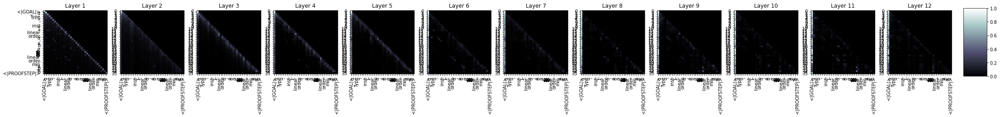

83200it [57:14, 28.06it/s]

  Step 83,200  of  147,271. Loss: 0.5483083724975586.   Elapsed: 0:57:15.
Sample:simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact has_zero_prod<|endoftext|><|PROOFSTEP|>apply_instance_of_ne _ _<|endoftext|><|PROOFSTEP|>apply_instance_ne rfl<|endoftext|><|PROOFSTEP|>apply_instance_eq_right<|endoftext|>this 0<|endoftext|><|PROOFSTEP|>simp only [mem_comm, h]<|endoftext|><|PROOFSTEP|>exact_const_nat_eq_def _ at h<|endoftext|><|PROOFSTEP|>rw at h<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>apply_property<|endoftext|><|PROOFSTEP|>s_eq_top<|endoftext|>I<|endoftext|><|PROOFSTEP|>rintros<|endoftext|>by_mem<|endoftext|>←mem_coe_refl<|endoftext|>←refl<|endoftext|><|PROOFSTEP|>rw [⟨_pow, fpow_coe, hpow_coe, hpow_coe_hc, hpow_coe_pow, pow_coe_mul (mul_pow_coe_iff_mul_iff_nhds_pow_one (pow_pow
rw -> 0.34525537490844727
s -> 0.30607569217681885
ex -> 0.09294833987951279
apply -> 0.07872714847326279
cases -> 0.0414394736289978
ref -> 0.03228759

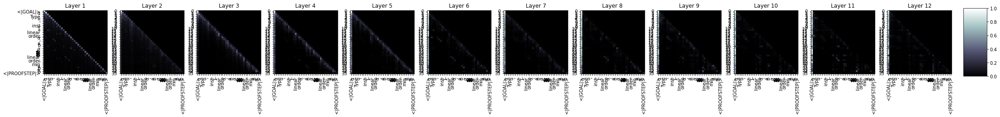

86397it [59:26, 25.51it/s]

  Step 86,400  of  147,271. Loss: 1.3553602695465088.   Elapsed: 0:59:27.
Sample:refine le_antisymm a b<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact mem_empty_of_max a<|endoftext|><|PROOFSTEP|>rw [mem_inj]<|endoftext|><|PROOFSTEP|>left<|endoftext|><|PROOFSTEP|>simp [h]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>svd (pow1.left (pow2.right (pow1.right) 1)<|endoftext|><|PROOFSTEP|>svd<|endoftext|><|PROOFSTEP|>svd_hd<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exists.le (le_le.coe1 2<|endoftext|><|PROOFSTEP|>split,<|endoftext|><|PROOFSTEP|>have a rflx<|endoftext|><|PROOFSTEP|>asset<|endoftext|><|PROOFSTEP|>rw.coe_nonneg<|endoftext|><|PROOFSTEP|>svd_mem<|endoftext|><|PROOFSTEP|>rw [le_right_coe, mem_not_le]<|endoftext|><|PROOFSTEP|>classical<|endoftext|><|PROOFSTEP|>svd_mem<|endoftext|><|PROOFSTEP|>svd_iff<|endoftext|><|PROOFSTEP|>rw [le_right_coe_nonneg, eq_nat_eq_empty, neg_eq_not_eq]<|endoftext|><|PROOFSTEP|>rw [nat_eq_not
s -> 0.3822840452194214
rw

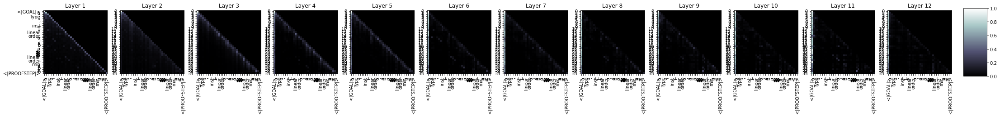

89598it [1:01:41, 27.87it/s]

  Step 89,600  of  147,271. Loss: 0.7935869693756104.   Elapsed: 1:01:42.
Sample:simp a<|endoftext|><|PROOFSTEP|>exact λ r, rfl, eq_nonempty_eq_one_iff_mem _ rfl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [le_one, one_ne_one]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases with<|endoftext|><|PROOFSTEP|>ext1<|endoftext|><|PROOFSTEP|>exists_lk<|endoftext|><|PROOFSTEP|>by_contradiction<|endoftext|><|PROOFSTEP|>rintrosic_ne_one (refl_refl.mp)<|endoftext|><|PROOFSTEP|>simp_mem_mk_zero<|endoftext|><|PROOFSTEP|>simp_mem_two<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases v_lt_one_left<|endoftext|><|PROOFSTEP|>simp_lt_one_right<|endoftext|><|PROOFSTEP|>simp_left<|endoftext|><|PROOFSTEP|>lets := coe<|endoftext|>simp_lt_left<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>rw ←<|endoftext|><|PROOFSTEP|>simp_lt_right<|endoftext|>1.2.7.2.1<|endoftext|><|PROOFSTEP|>have_left<|endoftext|><|PROOFSTEP|>reflection_right<|

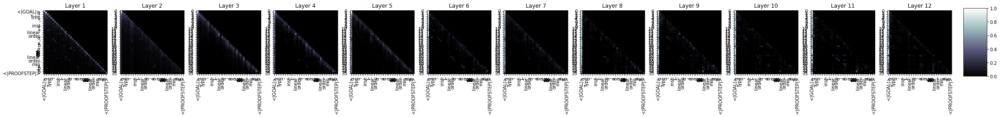

92799it [1:03:54, 22.76it/s]

  Step 92,800  of  147,271. Loss: 1.7222774028778076.   Elapsed: 1:03:55.
Sample:rw zero_comm<|endoftext|><|PROOFSTEP|>rw [mod_eq_self, ← eq_coe_of_lea_iff : mul_cons_iff_on_lea_iff _ (eq_one_iff_lea_iff _ _))<|endoftext|><|PROOFSTEP|>rw [mod_eq_self, ← eq_one_iff_lea_iff_eq_one]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp [eq_one]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance_eq<|endoftext|><|PROOFSTEP|>rw @apply_self<|endoftext|><|PROOFSTEP|>have_is_simp set.simp (has_is_is.1 (apply_instance_iff).2).elim (apply_instance_eq_one, is_is_is.1 (apply_instance_eq_one)).mpr (has_is_is.2 (apply_instance_eq_one)).mpr.2)<|endoftext|><|PROOFSTEP|>rw subtype.
rw -> 0.3965998888015747
s -> 0.3037784695625305
ex -> 0.11406325548887253
cases -> 0.04074488580226898
apply -> 0.04005371406674385
int -> 0.02836649678647518
have -> 0.022342011332511902
ref -> 0.020737722516059875
re -> 0.02054581046104431
ext -> 0.012767760083079338


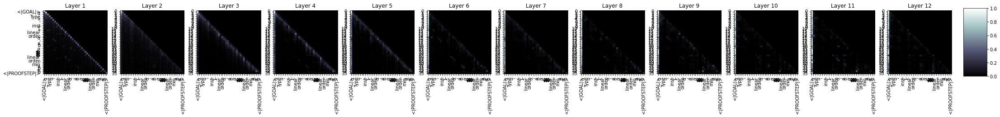

95998it [1:06:07, 25.75it/s]

  Step 96,000  of  147,271. Loss: 1.2594610452651978.   Elapsed: 1:06:08.
Sample:rw min_lt_succ<|endoftext|><|PROOFSTEP|>rw min_lt.sup_comm<|endoftext|><|PROOFSTEP|>rw supa using supa_le_sub_le.sup_lt.sup<|endoftext|><|PROOFSTEP|>rw sup_le_sup_le_right<|endoftext|><|PROOFSTEP|>rw sup_le_sup_le<|endoftext|><|PROOFSTEP|>rw Sup_le_sup_le_right_inj.1<|endoftext|><|PROOFSTEP|>rw sup_le_sup_le_right_inj.2<|endoftext|><|PROOFSTEP|>simp only [refl, nat.mul_mul_eq_bot, ←simp_left_inj.2, neg_eq_bot]<|endoftext|><|PROOFSTEP|>rw nat.mul_mul_eq_bot<|endoftext|><|PROOFSTEP|>exists<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>rw nat.cancel_eq_done.mp<|endoftext|><|PROOFSTEP|>rw ⟨finset.finset, ←finset.coe_coe_nat, ←f
rw -> 0.45701757073402405
s -> 0.3262651860713959
ex -> 0.07111618667840958
cases -> 0.03346254676580429
int -> 0.025354934856295586
apply -> 0.02488003857433796
re -> 0.020715538412332535
have -> 0.01557297632098198
ref -> 0.015495570376515388
si

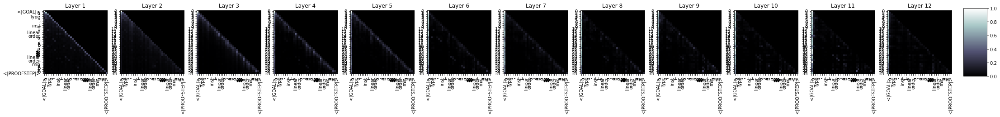

99200it [1:08:19, 21.07it/s]

  Step 99,200  of  147,271. Loss: 0.9804977774620056.   Elapsed: 1:08:19.
Sample:simp only [min_iff]<|endoftext|><|PROOFSTEP|>have : neg_self (has_neg) eq_neg := @ neg_self bool.zero<|endoftext|><|PROOFSTEP|>classical<|endoftext|><|PROOFSTEP|>apply eq_neg_comm<|endoftext|><|PROOFSTEP|>cases_right<|endoftext|><|PROOFSTEP|>exact_mod_cast (or_one_div_right _<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>cases_right<|endoftext|><|PROOFSTEP|>have rfl<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>injection_fst<|endoftext|><|PROOFSTEP|>ob_iff0<|endoftext|><|PROOFSTEP|>s_eq_one<|endoftext|><|PROOFSTEP|>s_fstob<|endoftext|><|PROOFSTEP|>by_cases with h<|endoftext|><|PROOFSTEP|>use<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>cases_right<|endoftext|>I<|endoftext|><|PROOFSTEP|>change _ :.1, _⟨in, _⟩, _⟩<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>s2.1<|endoftext|><|PROOFSTEP|>cases_rightI :<|endoftext|><|PROOFSTEP|>exists_true S<|endoftext|><|PROOFSTEP|>

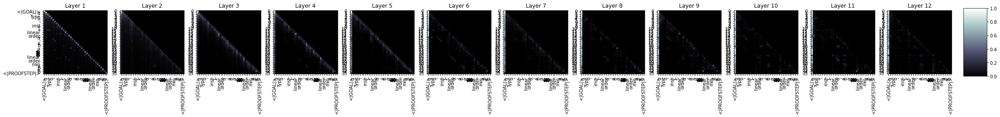

102400it [1:10:32, 27.13it/s]

  Step 102,400  of  147,271. Loss: 0.9907471537590027.   Elapsed: 1:10:32.
Sample:try { refl }<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact le_iff_le_right_nhds<|endoftext|><|PROOFSTEP|>rw [← le_to_iff_le_right_nhds, le_symm]<|endoftext|><|PROOFSTEP|>simp [le_to_iff_le_right]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>exact! (add_div_mul_one_div_nhds_of_not_not_le<|endoftext|><|PROOFSTEP|>exact!<|endoftext|><|PROOFSTEP|>s.right_of_le<|endoftext|><|PROOFSTEP|>apply_instance, _<|endoftext|><|PROOFSTEP|>exists_of_le_to_le.le<|endoftext|><|PROOFSTEP|>convert_eq_of_lt_sub<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exists_of_le_to_le a a.1<|endoftext|><|PROOFSTEP|>assumption!<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw {o | o.gcd_not_le_left}<|endoftext|><|PROOFSTEP|>rw at_g
rw -> 0.37726569175720215
s -> 0.25995394587516785
ex -> 0.12609176337718964
apply -> 0.049581531435251236
int -> 0.0

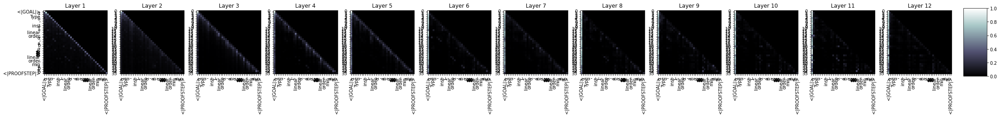

105599it [1:12:45, 19.96it/s]

  Step 105,600  of  147,271. Loss: 1.0332458019256592.   Elapsed: 1:12:46.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>rwa [←]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have I : list.nil := list.nil<|endoftext|><|PROOFSTEP|>have I<|endoftext|><|PROOFSTEP|>by_cases hI : list.nil_one : only {1} = 1<|endoftext|><|PROOFSTEP|>rw list.nil_one_eq_zero_of_succ<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>exact.induction_eq_zero_of_succ_right<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>simp only 1 2 3<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>rintr<|endoftext|><|PROOFSTEP|>rc<|endoftext|><|PROOFSTEP|>simp_rw (caseshot.1 (caseshow.2 (caseshow.1, _) 1 : a, has_mul_singleton)<|endoftext|><|PROOFSTEP|>rw [← ← 1, by rw [← 2, by tt]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw [← rw [← 2, by rw]<|endoftext|><|PROOFSTEP|>
s -> 0.22311240434646606
rw -> 0.20536305010318756
ex -> 0.1404643

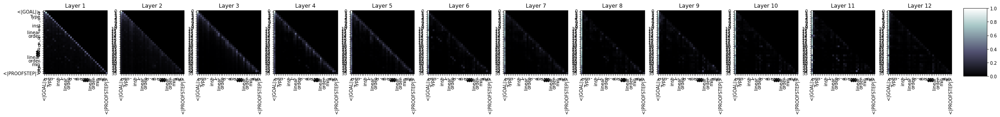

108798it [1:14:58, 26.04it/s]

  Step 108,800  of  147,271. Loss: 1.308665156364441.   Elapsed: 1:14:58.
Sample:simp<|endoftext|><|PROOFSTEP|>letI := (linear_order.eq_max at I := min)<|endoftext|><|PROOFSTEP|>rw [←max_eq_max, neg_lt_moderate_iff, min_le_coe]<|endoftext|><|PROOFSTEP|>classical<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw hrc.mp<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>simp [←mul, mul_add, mul_eq_not_iff, ha_iff_mem_le_not_not]<|endoftext|><|PROOFSTEP|>rw [←mem_eq_not_iff*, not_lt, not_le_not_iff]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases using (m n).4<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw ⟨l, rfl, hfl⟩<|endoftext|><|PROOFSTEP|>by K.KG<|endoftext|><|PROOFSTEP|><|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have<|endoftext|><|PROOFSTEP|>exact_iff'<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact : sub 1<|endoftext|><|PROOFSTEP|>h<|endoftext|>
rw -> 0.3135065734386444
s -> 0.30861195921

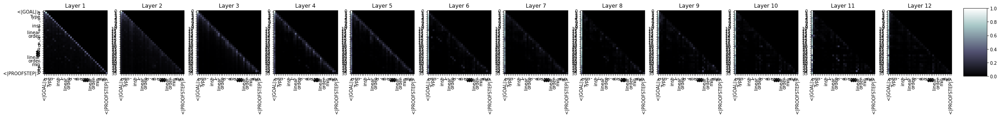

111998it [1:17:13, 28.12it/s]

  Step 112,000  of  147,271. Loss: 0.6825782060623169.   Elapsed: 1:17:13.
Sample:have := (a * b)⁻¹<|endoftext|><|PROOFSTEP|>haveI := pythagorean_one_right<|endoftext|><|PROOFSTEP|>simpa using (pi_pos_right _ _)<|endoftext|><|PROOFSTEP|>rw [pos_eq_top, coe_eq_top]<|endoftext|><|PROOFSTEP|>congr at htop<|endoftext|><|PROOFSTEP|>simp only [pow_pos_right, pow_nonneg, pell_pos_right, int.pos_nonneg]<|endoftext|><|PROOFSTEP|>assume a<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact perspow_inter_pos (left_of_right_of_left_of_left_of_self, eq_self_iff.1, simpow_right_of_lt, eq_self_iff.2, _ _<|endoftext|><|PROOFSTEP|>exact _ _ (left_of<|GOAL|>G_left_of_right_of_left_of_self_eq_right) _ _<|endoftext|><|PROOFSTEP|>intros<|endoftext|>
s -> 0.34564125537872314
ex -> 0.17024637758731842
rw -> 0.1482546627521515
int -> 0.10096657276153564
apply -> 0.07694300264120102
cases -> 0.05502697825431824
have -> 0.0349971279501915
re -> 0.027409685775637627
sim -> 0.020437700673937798
ext -> 0.

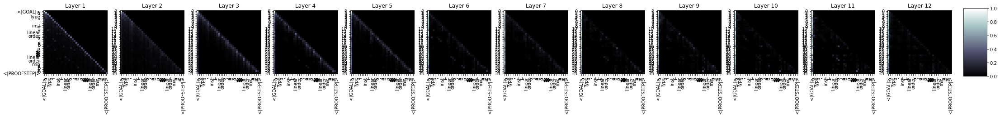

115199it [1:19:24, 25.05it/s]

  Step 115,200  of  147,271. Loss: 1.2456564903259277.   Elapsed: 1:19:25.
Sample:congr<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>simp [← h]<|endoftext|><|PROOFSTEP|>simp [← h]<|endoftext|><|PROOFSTEP|>rw [← subtype.coe_le_imp_iff, eq_coe_coe.symm]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_instance<|endoftext|><|PROOFSTEP|>rw [← subtype.coe_le_into_coe]<|endoftext|><|PROOFSTEP|>rw [subtype.coe_le_into_coe_iff, int.coe_le_nonpos_of_subtype, ih.eq_coe]<|endoftext|><|PROOFSTEP|>simp (interval_iff.1_le_top, (Interval_iff.2_le_top, ← int.coe_le_into_coe<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_def is_def<|endoftext|><|PROOFSTEP|>try {<|endoftext|><|PROOFSTEP|>apply_def _<|endoftext|><|PROOFSTEP|>split_wf<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply
s -> 0.41455793380737305
rw -> 0.2831340432167053
ex -> 0.08824267983436584
apply -> 0.060318540781736374
int -> 0.05

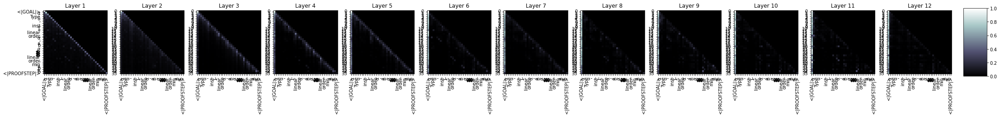

118399it [1:21:36, 27.99it/s]

  Step 118,400  of  147,271. Loss: 1.3113651275634766.   Elapsed: 1:21:37.
Sample:rw [max_ratio_nonneg, min_max_iff, coe_zero_iff, coe_max, coe_iff]<|endoftext|><|PROOFSTEP|>simp only [left_bounded_left]<|endoftext|><|PROOFSTEP|>exact every_trans (let_match _) (λ x, _)<|endoftext|><|PROOFSTEP|>simp only [←←zero_not_bot, ←bot_symm, ←to_iff_le]<|endoftext|><|PROOFSTEP|>simp [←lt_bot, ←le_bot]<|endoftext|><|PROOFSTEP|>simp_trans<|endoftext|><|PROOFSTEP|>simp_lt<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp.trans_instance<|endoftext|><|PROOFSTEP|>simp_trans<|endoftext|><|PROOFSTEP|>simp_gt<|endoftext|><|PROOFSTEP|>simp_lt_right<|endoftext|><|PROOFSTEP|>simp_trans_instance_eq<|endoftext|><|PROOFSTEP|>simpa only [eq, ne]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ext ⊢<|endoftext|><|PROOFSTEP|>symmetric.lt_right<|endoftext|><|PROOFSTEP|>s
s -> 0.5312057137489319
rw -> 0.17513062059879303
ex -> 0.07766402512788773
int -> 0.057316072285175323
apply -> 0.0517

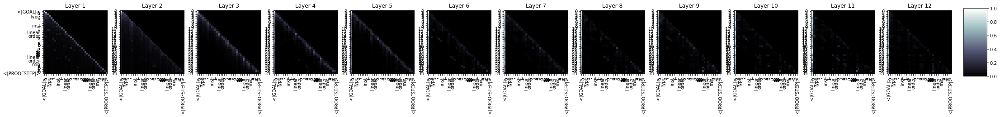

121600it [1:23:49, 23.36it/s]

  Step 121,600  of  147,271. Loss: 1.3927160501480103.   Elapsed: 1:23:49.
Sample:simp only [sigma_zero, mul_comm]<|endoftext|><|PROOFSTEP|>simp only [is_unit, ← is_unit, ← ordered_comm]<|endoftext|><|PROOFSTEP|>simp only [mul_comm]<|endoftext|><|PROOFSTEP|>rw [compelllist.compelllist0, ← sum_comm]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have := h_true_factorial, not_true := non_not_true<|endoftext|><|PROOFSTEP|>to_mul_of_inv_mem<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp.1 xsimp1<|endoftext|><|PROOFSTEP|>add_submodule.1 : one_submodule_le<|endoftext|><|PROOFSTEP|>simp_fun<|endoftext|><|PROOFSTEP|>by_cases<|endoftext|><|PROOFSTEP|>cases_not_pos<|endoftext|><|PROOFSTEP|>apply_pow1<|endoftext|><|PROOFSTEP|>by_neg_ne_zero<|endoftext|><|PROOFSTEP|>by_neg_eq_right_left<|endoftext|><|PROOFSTEP|>cases_not_pos<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases_not_pos<|endoftext|>
s -> 0.369175016880035

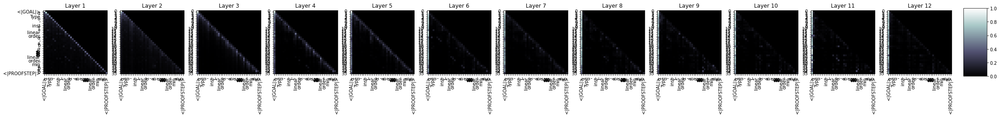

124798it [1:26:01, 26.85it/s]

  Step 124,800  of  147,271. Loss: 1.0483592748641968.   Elapsed: 1:26:01.
Sample:simp [linear_order_min]<|endoftext|><|PROOFSTEP|>exact le_max le_max_iff_neg_of_lt a b<|endoftext|><|PROOFSTEP|>exact le_elim_lt_top<|endoftext|><|PROOFSTEP|>refine {f : (λ x : X ⟶ (x, x), le_max_coe_of_gt (x, x)), }<|endoftext|><|PROOFSTEP|>rw [← le_max_coe_of_gt, le_coe_of_gt] at le_max_coe_of_lt.trans<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact_deriv_right<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact.dist_subtype<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact_ext<|endoftext|><|PROOFSTEP|>exact<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>snd_eq_prod<|endoftext|><|PROOFSTEP|>erw := nat.le_comp_prod (le_of_right_iff_prod.pro
s -> 0.30991941690444946
ex -> 0.22870206832885742
rw -> 0.13552889227867126
apply -> 0.10331903398036957
int -> 0.08351778984069824
have -> 0.0395

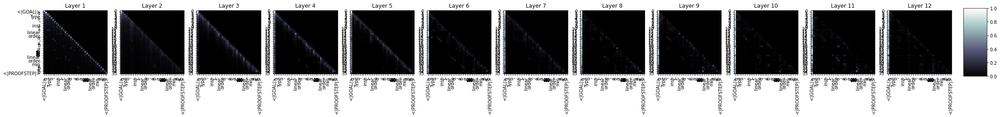

128000it [1:28:15, 23.96it/s]

  Step 128,000  of  147,271. Loss: 0.88905268907547.   Elapsed: 1:28:15.
Sample:subst a b<|endoftext|><|PROOFSTEP|>apply_def<|endoftext|><|PROOFSTEP|>by_cases h : h = 0<|endoftext|><|PROOFSTEP|>exact_mod_cast _<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>by_cases<|endoftext|><|PROOFSTEP|>exact_mul<|endoftext|><|PROOFSTEP|>by_cases<|endoftext|>finset x hx<|endoftext|><|PROOFSTEP|>cases_nhds x y<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact_nhds_sub_inv<|endoftext|><|PROOFSTEP|>have H<|endoftext|><|PROOFSTEP|>left Hright<|endoftext|><|PROOFSTEP|>letR := hto_nhds.nat_lt<|endoftext|><|PROOFSTEP|>apply at<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>cases_nhds<|endoftext|><|PROOFSTEP|>rw H<|endoftext|><|PROOFSTEP|>s_nonneg<|endoftext|><|PROOFSTEP|>s_def<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|>K<|endoftext|><|PROOFSTEP|>ext1 : (real)<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>by_fact1<|endoftext|>I R2<|endoftext|><|P

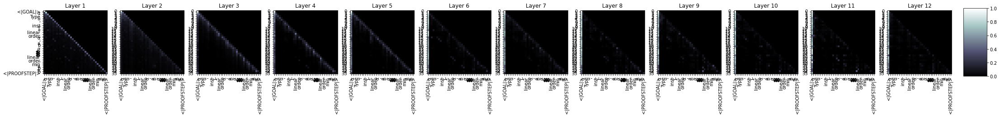

131199it [1:30:25, 21.65it/s]

  Step 131,200  of  147,271. Loss: 0.7898415327072144.   Elapsed: 1:30:25.
Sample:exact min_unit_le_max<|endoftext|><|PROOFSTEP|>tactic.pi_instance_derive_field<|endoftext|><|PROOFSTEP|>ext n<|endoftext|><|PROOFSTEP|>cases_eq_of_not_nonneg nc : _<|endoftext|><|PROOFSTEP|>split_eq_of_not_nonneg<|endoftext|><|PROOFSTEP|>by_cases w : 1 nd ih<|endoftext|><|PROOFSTEP|>apply_instance_derive_field<|endoftext|><|PROOFSTEP|>refine (subtype.of_instance, _).cases_eq_of_not_eq_of_not_nonneg.2.1<|endoftext|><|PROOFSTEP|>simp [pow_coe]<|endoftext|><|PROOFSTEP|>apply_instance_derive_field<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance_derive_field : s.inl [pow_coe, pow_inv]<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>s : list.cons list.nil_nil = id<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>apply_instance_derive_field<|endoftext|><|PROOFSTEP|>rintro ℊ<|endoftext|><|PROOFSTEP|>
s -> 0.4916640520095825
ex -> 0.16079609096050262
rw -> 0.14585213363170624
a

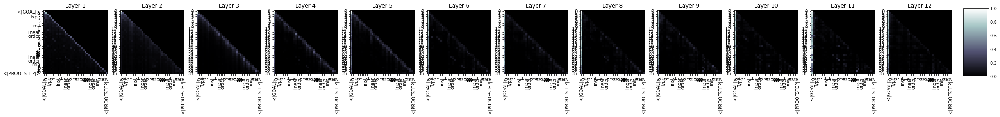

134398it [1:32:36, 26.98it/s]

  Step 134,400  of  147,271. Loss: 0.6050499081611633.   Elapsed: 1:32:37.
Sample:have := min_le_left b<|endoftext|><|PROOFSTEP|>simpa [pi_eq_nonneg, ne.comm, or_true, add_comm, rpow_zero] using [pi_eq_nonneg, ne.comm]<|endoftext|><|PROOFSTEP|>simpa [pi_eq_nonneg, ne.comm, ORI_not :=<|endoftext|><|PROOFSTEP|>have := at finset.fin1 (-1) using int.coe_nat.1 (nat.preimage_nth_le _)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>symmetry<|endoftext|><|PROOFSTEP|>exact one.mem_trans (nat.bexact ae_symmetry.symmetry) (nth_le_not_le (nat.bexact ae_symmetry.symmetry (nat.bexchange_nth_le _ (nat.bexchange_nth_le _)).trans (nat.
s -> 0.39485985040664673
rw -> 0.19489705562591553
ex -> 0.14828117191791534
apply -> 0.06266684830188751
int -> 0.04687250033020973
cases -> 0.041717421263456345
have -> 0.039778996258974075
re -> 0.03385930880904198
by -> 0.01990998536348343
split -> 0.017156900838017464


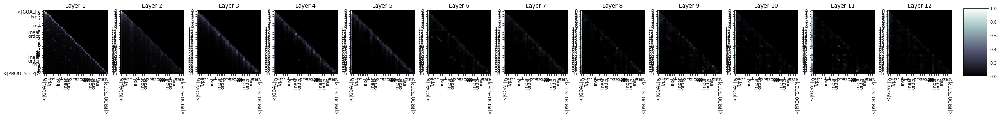

137597it [1:34:48, 24.16it/s]

  Step 137,600  of  147,271. Loss: 0.5826574563980103.   Elapsed: 1:34:49.
Sample:simp [← min_comm]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>by_cases hd : nat.partrec_le<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [partrec_le, preorder_left]<|endoftext|><|PROOFSTEP|>simp_iff_not_nonneg<|endoftext|><|PROOFSTEP|>rw [partrec_le, preorder_right]<|endoftext|><|PROOFSTEP|>apply_instance, add_zero<|endoftext|><|PROOFSTEP|>simp_eq_right<|endoftext|><|PROOFSTEP|>by_cases a<|endoftext|><|PROOFSTEP|>rw [left_moves, left_moves, left_moves, right_moves]<|endoftext|><|PROOFSTEP|>exprod : ∀ (s : finset (NU_Ioi, iU_to_NU)), ↑(nU_to_NU, NU_to_NU) := {moves, h, mul_le, eq_sub_eq_one, and := }<|endoftext|><|PROOFSTEP|>s_right : is_
s -> 0.48018768429756165
rw -> 0.20346547663211823
ex -> 0.10292903333902359
int -> 0.04710385203361511
apply -> 0.04562898352742195
cases -> 0.04195085167884827
have -> 0.02466461807489395

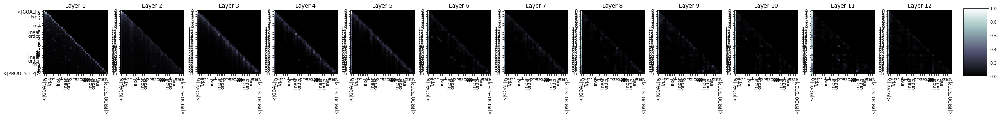

140799it [1:37:01, 24.51it/s]

  Step 140,800  of  147,271. Loss: 0.932774007320404.   Elapsed: 1:37:01.
Sample:dsimp [min, max_of_le a b]<|endoftext|><|PROOFSTEP|>rw mul_comm<|endoftext|><|PROOFSTEP|>simp at 𝓝 h<|endoftext|><|PROOFSTEP|>rw one_iff_lt_iff<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp at hc<|endoftext|><|PROOFSTEP|>simp 0<|endoftext|><|PROOFSTEP|>ext hc<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_inst<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simp_left [le, le_of_of_le_of_right_iff_right, le_of_eq_of_comm, coe]<|endoftext|><|PROOFSTEP|>haveI := eq_of_refl (has_right_of_eq_right hc hc, hc_eq_right, coe_of_eq_of_right (has_right_of_eq_right hc hc, coe_of_eq_eq_of_left, (le_of_eq_eq_right hc hc, (hc
s -> 0.3766331374645233
rw -> 0.2697964310646057
ex -> 0.1686747968196869
int -> 0.046335168182849884
apply -> 0.042426418513059616
cases -> 0.031912609934806824
have -> 0.021217407658696175
re -> 0.015575645491480827
split -> 0.015151746571063995
by -> 0.01

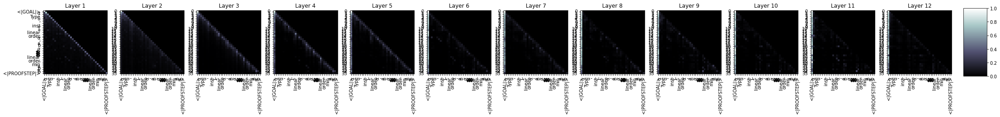

144000it [1:39:12, 25.84it/s]

  Step 144,000  of  147,271. Loss: 0.9501965641975403.   Elapsed: 1:39:12.
Sample:simp only [add_comm]<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>by_cases h1 : is_noetherian π<|endoftext|><|PROOFSTEP|>exact or_bot_is_lawful<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exactOr_bot_is §1<|endoftext|><|PROOFSTEP|>exactOr_bot_is_lawful<|endoftext|><|PROOFSTEP|>norm_right<|endoftext|><|PROOFSTEP|>simp only [norm_right, ne.trans, ne.symm, not_iff_not]<|endoftext|><|PROOFSTEP|>simp.1 (preimage)<|endoftext|><|PROOFSTEP|>exists_trans<|endoftext|><|PROOFSTEP|>by_cases<|endoftext|><|PROOFSTEP|>exists (preimage)<|endoftext|><|PROOFSTEP|>exists_trans<|endoftext|><|PROOFSTEP|>apply_def<|endoftext|><|PROOFSTEP|>simp.1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>existss<|endoftext|><|PROOFSTEP|>simps2<|endoftext|>by_exists (preimage.1), simps_prod<|endoftext|><|PROOFSTEP|>s_con_refl<|endoftext|><|PROOFSTEP|>apply_def<|endoftext|><|PROOFSTEP|>rintrorefl<|endoftext|><

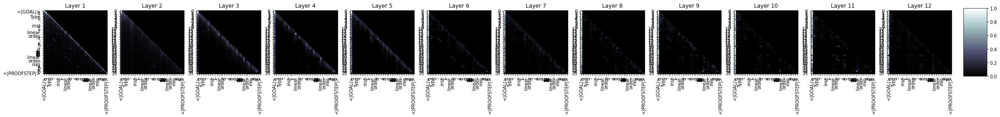

147198it [1:41:24, 23.98it/s]

  Step 147,200  of  147,271. Loss: 0.948944091796875.   Elapsed: 1:41:24.
Sample:rw pow_succ<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply le_rec<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>use {smul}<|endoftext|><|PROOFSTEP|>simp only [complea_one, forall, forall_eq]<|endoftext|><|PROOFSTEP|>apply le_refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw if_neg<|endoftext|><|PROOFSTEP|>by : if_neg {ne_of_not_true}<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [intro, if_neg]<|endoftext|><|PROOFSTEP|>simp_rw [le_false, le_not]<|endoftext|><|PROOFSTEP|>simp_rw [le_false, if_neg]<|endoftext|><|PROOFSTEP|>rw [lt_false, if_neg]<|endoftext|><|PROOFSTEP|>simp_rfl<|endoftext|><|PROOFSTEP|>simp_rw [lt_true_iff]<|endoftext|><|PROOFSTEP|>intro /<|endoftext|><|PROOFSTEP|>exf hs<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>rw [← false_right]<|endoftext|><|PROOFSTEP|>simp_simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>by rfl<|end

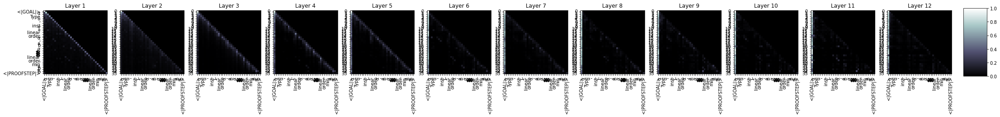

147271it [1:41:32, 24.17it/s]



  Average training loss: 1.11
  Training epoch took: 1:41:33

Running Validation...
  Validation Loss: 1.03
  Validation took: 0:01:34


4it [00:00, 31.20it/s]


======== Epoch 22 / 35 ========
Training...


3199it [02:05, 25.72it/s]

  Step 3,200  of  147,271. Loss: 1.1281180381774902.   Elapsed: 0:02:06.
Sample:rw [← min_left_left, min_left_right]<|endoftext|><|PROOFSTEP|>apply.refl<|endoftext|><|PROOFSTEP|>let G_s := S_simp [Ao], _ (left_inv.inl, simp_self.one_inv.inl), hg (left_inv.inr, simp_self.ne_bot), hg (right_inv.inr, simp_self.ne_bot), hg (left_inv.inr, simp_self.ne_bot)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [← nat.def, ← h, mul_def, ← nat.def, ← nat.def, ← h, ← nat.coe_def]<|endoftext|><|PROOFSTEP|>have : ∀ {m n : ℕ} (m : ℝ), 0 < m → 0 < n → 0 ≤ m → 0 ≤ n → 0
s -> 0.36170122027397156
ex -> 0.3053863048553467
rw -> 0.12864965200424194
apply -> 0.07893062382936478
int -> 0.05243721604347229
have -> 0.02393549494445324
cases -> 0.014370632357895374
split -> 0.012086845934391022
re -> 0.011769643984735012
ext -> 0.010732336901128292


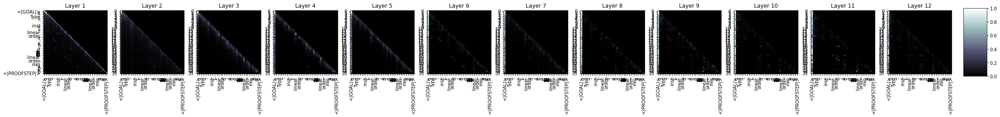

6399it [04:17, 26.07it/s]

  Step 6,400  of  147,271. Loss: 1.0811235904693604.   Elapsed: 0:04:17.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>exact minmod_self 0<|endoftext|><|PROOFSTEP|>simp [0]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact win<|endoftext|><|PROOFSTEP|>simp_ne_one<|endoftext|><|PROOFSTEP|>simp_eq_self : is_nontrivial_is_one (nontrivial.is_inv : is_inv) (is_nontrivial_is.one_inv_ne_onesimp_eq_self)<|endoftext|><|PROOFSTEP|>exact_instance<|endoftext|><|PROOFSTEP|>tactic.1 [cancel_eq_ne_onesimp_eq_self]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp_eq_one<|endoftext|><|PROOFSTEP|>haveI := one_inv_one_cancel_self_ne_one<|endoftext|><|PROOFSTEP|>simp_lt_one<|endoftext|><|PROOFSTEP|>simps_lt_one_of_eq<|endoftext|><|PROOFSTEP|>simp_eq_one_of_mem<|endoftext|><|PROOFSTEP|>apply_instance_nonneg_zero<|endoftext|><|PROOFSTEP|>apply_
s -> 0.41505947709083557
ex -> 0.19636371731758118
rw -> 0.14297719299793243
apply -> 0.1285254955291748
int -> 0.04769564

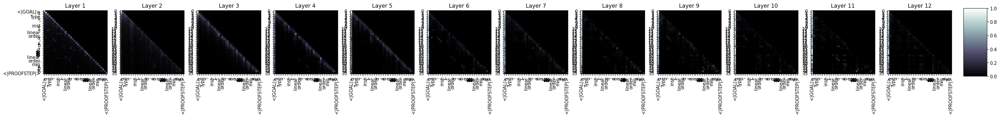

9599it [06:27, 21.82it/s]

  Step 9,600  of  147,271. Loss: 0.964008629322052.   Elapsed: 0:06:28.
Sample:exact le_antisymm _<|endoftext|><|PROOFSTEP|>exact le_antisymm_right_inv<|endoftext|><|PROOFSTEP|>exact AND_mul_left_inv_left_sub_eq_left<|endoftext|><|PROOFSTEP|>exact AND_mul_right_inv_left_inv_right<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>by_type hg<|endoftext|><|PROOFSTEP|>exact SOME_A_hg_inj<|endoftext|><|PROOFSTEP|>rw [hg_inj, (hg_inj, hg_inj).1, hg_inj.2]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact (hg_inj.1)<|endoftext|><|PROOFSTEP|>simpa [mem_assoc, (mem_singleton_of_true, hg_inj.2)]<|endoftext|><|PROOFSTEP|>exact this.refl<|endoftext|><|PROOFSTEP|>exact (@mem_sub_prods $ {refl := ⟨_, _, hg_inj.
s -> 0.34481096267700195
rw -> 0.24473293125629425
ex -> 0.22965943813323975
apply -> 0.07934048026800156
int -> 0.03312858194112778
have -> 0.029721088707447052
cases -> 0.011128564365208149
sim -> 0.010532494634389877
split -> 0.008500256575644016
re -> 0

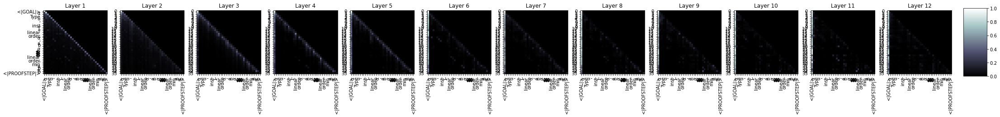

12798it [08:40, 24.00it/s]

  Step 12,800  of  147,271. Loss: 2.107567071914673.   Elapsed: 0:08:41.
Sample:simp<|endoftext|><|PROOFSTEP|>simp [distrib_sub_cancel, ← cond_subset_of_pos_iff, mem_subset_of_nat, mem_mem']<|endoftext|><|PROOFSTEP|>simp [distrib_cancel]<|endoftext|><|PROOFSTEP|>assumption<|endoftext|><|PROOFSTEP|>simp.im<|endoftext|><|PROOFSTEP|>simp_iff<|endoftext|><|PROOFSTEP|>exact this<|endoftext|><|PROOFSTEP|>simp_iff_true<|endoftext|><|PROOFSTEP|>rw [trans, neg_pos, nat.pos_le] {<|endoftext|><|PROOFSTEP|>simp}<|endoftext|><|PROOFSTEP|>exact_pos<|endoftext|><|PROOFSTEP|>cases_left<|endoftext|>A : (1).1 (1).2 (1).1 (1).1 {1} ∞<|endoftext|><|PROOFSTEP|>rcases nhds.1 (1 hds_2 (1 hds_1 hds hd) with ⟨a, b, bh⟩<|endoftext|><|PROOFSTEP|>sub_neg, sub_neg_neg<|endoftext|><|PROOFSTEP|>rw [sub_neg, hds_2
s -> 0.3968654274940491
rw -> 0.24897432327270508
ex -> 0.1817834973335266
apply -> 0.07330399751663208
have -> 0.025654401630163193
int -> 0.024729639291763306
cases -> 0.01688307337462902
sim -> 0.0124297

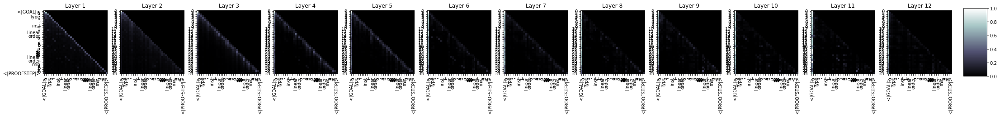

16000it [10:52, 23.26it/s]

  Step 16,000  of  147,271. Loss: 1.34481680393219.   Elapsed: 0:10:53.
Sample:rw [← neg_neg, min_eq_zero]<|endoftext|><|PROOFSTEP|>rw [neg_nsmul, neg_nsmul_sup_refl] { sup := | neg := at *, at_pos := at *, ne_of_lt }<|endoftext|><|PROOFSTEP|>simp [succ_def, nsmul_eq_zero]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have : (sx : ∀ (n : ℕ), ∓ n ≤ 1, ∀ n, nat_nsmul_fst (n • sx) n, nat_nsmul_snd (n • sx) n, nat_nsmul_snd : n = 1, at_pos := by rw [mul_eq_of_ne_zero]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>ex<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>
s -> 0.37476009130477905
rw -> 0.25953423976898193
ex -> 0.17190851271152496
apply -> 0.07749691605567932
cases -> 0.030893951654434204
int -> 0.025873640552163124
have -> 0.022896774113178253
rc -> 0.013991366140544415
sim -> 0.012228207662701607
ref -> 0.010416277684271336


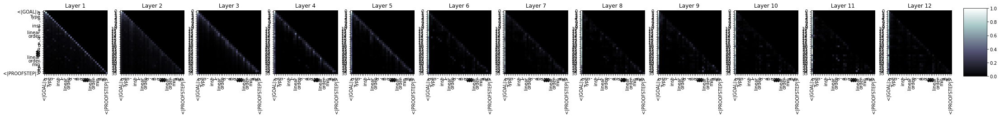

19200it [13:05, 19.88it/s]

  Step 19,200  of  147,271. Loss: 1.7521402835845947.   Elapsed: 0:13:06.
Sample:apply min_mono_self<|endoftext|><|PROOFSTEP|>exact or_of/.1 (λ _ _ _ $ xor coe)<|endoftext|><|PROOFSTEP|>exact or those<|endoftext|><|PROOFSTEP|>rw [← prod_comm]<|endoftext|><|PROOFSTEP|>cases :<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp [← if_pos, eq]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact and<|endoftext|><|PROOFSTEP|>exact_mem<|endoftext|>b_trans<|endoftext|>nhds<|endoftext|><|PROOFSTEP|>exact ⟨1, 2, ⟨1, 3, 4, 5⟩<|endoftext|><|PROOFSTEP|>simp_h<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp aa<|endoftext|><|PROOFSTEP|>simp_h<|endoftext|>p at ⊤<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_rhs<|endoftext|>L F : F.1.1, 1, 2, 2, 2, 3, 3, 4₀, 4₁, 6₂, 2, 4, 5, 6, 2
s -> 0.5169123411178589
ex -> 0.18482579290866852
rw -> 0.13255317509174347
apply -> 0.058483388274908066
int -> 0.026804771274328232
cases -

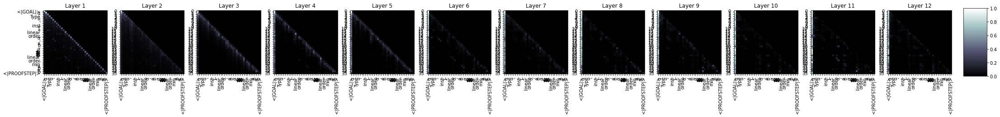

22399it [15:16, 23.57it/s]

  Step 22,400  of  147,271. Loss: 1.2795498371124268.   Elapsed: 0:15:17.
Sample:rintros ⟨_, H⟩<|endoftext|><|PROOFSTEP|>exact ⟨⟨⟩, ⟨⟨K, K⟩, ⟨K⟩, and ⟨K, K⟩⟩<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>have := kt ht<|endoftext|><|PROOFSTEP|>rw [kof_iff, infi_coe]<|endoftext|><|PROOFSTEP|>simp [←infi_coe, infi_iff_infi]<|endoftext|><|PROOFSTEP|>rw [←infi_coe, infi_iff_infi, kof_iff_sub_eq_iff_sub, infi_coe, int.mk_iff_of_iff_left]<|endoftext|><|PROOFSTEP|>exact ⟨_, _, kof_iff_of_iff_sub_eq_iff]<|endoftext|><|PROOFSTEP|>exact ⟨_, kof_iff_sub_eq
s -> 0.4787493050098419
ex -> 0.16204415261745453
rw -> 0.10766585916280746
apply -> 0.0912121906876564
have -> 0.037455976009368896
int -> 0.03692721575498581
cases -> 0.029383834451436996
sim -> 0.02376110479235649
re -> 0.018031315878033638
ref -> 0.014769034460186958


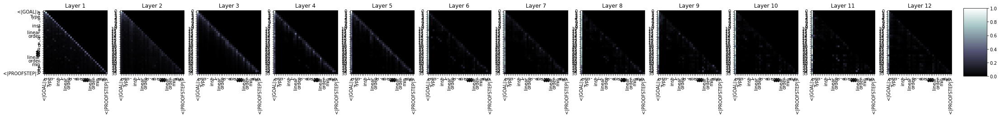

25600it [17:28, 21.78it/s]

  Step 25,600  of  147,271. Loss: 1.3256474733352661.   Elapsed: 0:17:29.
Sample:apply le_antisymm<|endoftext|><|PROOFSTEP|>cases h1 with a hab<|endoftext|><|PROOFSTEP|>simp only [h1, mul_le_left]<|endoftext|><|PROOFSTEP|>exact dec_trivial<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rwa [←mul_right_of_mem at h]<|endoftext|><|PROOFSTEP|>have<|endoftext|>b : unique (mul_unique1 : unique (mul_unique2 : unique (mul_unique3 : unique ("unique1.mul_unique2_1.1) 1" 0)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [h1]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>cases_right<|endoftext|>by_mem<|endoftext|>Rpow_simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>inr<|endoftext|><|PROOFSTEP|>from.<|endoftext|><|PROOFSTEP|>exact_rpow_of_mem_self_mem_mul<|endoftext|>H<|endoftext|><|PROOFSTEP|>simp [S_comp_eq_mem_s
s -> 0.3658498227596283
ex -> 0.1422613263130188
rw -> 0

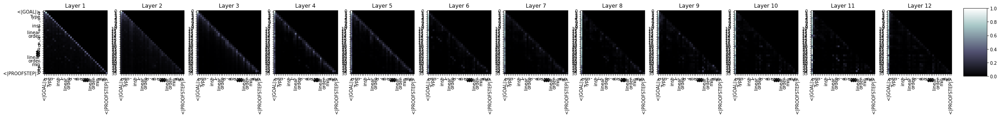

28798it [19:39, 23.86it/s]

  Step 28,800  of  147,271. Loss: 1.3287994861602783.   Elapsed: 0:19:40.
Sample:exact min_le_coe_ne_top<|endoftext|><|PROOFSTEP|>exact min_lt_left _<|endoftext|><|PROOFSTEP|>exact min_le_sup_le<|endoftext|><|PROOFSTEP|>exact max_le.1<|endoftext|><|PROOFSTEP|>exact le_of_nonpos_top<|endoftext|><|PROOFSTEP|>exact le_of_nonpos_top : nonpos_antisymm<|endoftext|><|PROOFSTEP|>simp [antisymm, ne_zero]<|endoftext|><|PROOFSTEP|>exact (ne_zero (le_of_nonpos_top _))) (ne_zero_eq_one' with a).1 (of_nonpos_ne_zero)<|endoftext|><|PROOFSTEP|>simp [one]<|endoftext|><|PROOFSTEP|>simp [one]<|endoftext|><|PROOFSTEP|>cases_mem_nhds<|endoftext|><|PROOFSTEP|>exists_preimage<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_le_of_left (refl_le_of_one _ _ _ _) with rel _:<|endoftext|><|PROOFSTEP|>simp.1_rfl<|endoftext|><|PROOFSTEP|>apply
s -> 0.5049670338630676
ex -> 0.12424936145544052
rw -> 0.10623718798160553
cases -> 0.07494091987609863
apply -> 0.0603620745241642
int -> 0.040204133838415146
h

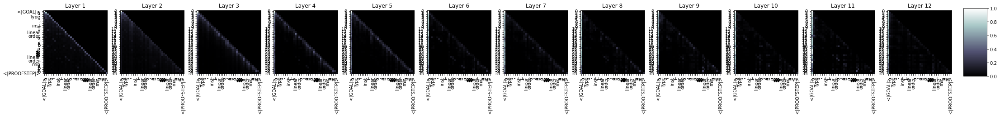

31998it [21:52, 27.99it/s]

  Step 32,000  of  147,271. Loss: 0.8789255619049072.   Elapsed: 0:21:53.
Sample:simpa [ne_zero_iff_ne_zero] using a.one_iff_neg a.zero_le<|endoftext|><|PROOFSTEP|>simp [sub_le_left, ← one_le_left]<|endoftext|><|PROOFSTEP|>simp [sub_neg, ← a, zero_ne_one]<|endoftext|><|PROOFSTEP|>by<|endoftext|><|PROOFSTEP|>apply_trans_inv.coe<|endoftext|><|PROOFSTEP|>by_cases hk : ∃ A, λ L' n : ℕ,	a : 1 ≤ a,	l : ℕ,	r : ℕ,	i : ℕ,	h : l.val_succ ≤ n,	a : i ∈ L.val i,	ha : a ≤ a<|endoftext|><|PROOFSTEP|>have n : ℕ,	a0 : a = 0,	ha0 : a ≠ 0,	ha0n : a < a,	H : n = ℤ	�
s -> 0.5317144393920898
rw -> 0.11894175410270691
ex -> 0.11158889532089233
apply -> 0.06481815129518509
int -> 0.054822541773319244
cases -> 0.032499317079782486
have -> 0.028421442955732346
sim -> 0.021230963990092278
re -> 0.019411224871873856
ref -> 0.016551319509744644


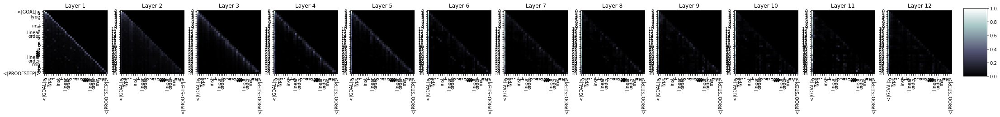

35200it [24:06, 24.80it/s]

  Step 35,200  of  147,271. Loss: 1.2021909952163696.   Elapsed: 0:24:07.
Sample:rw mem_max_left<|endoftext|><|PROOFSTEP|>apply mul_div_right<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance with_bot<|endoftext|><|PROOFSTEP|>haveI := hab E : ∀ x, x ∈ (mul_comm x), nat.lt_of_hac (cancel_inv _) := to_finset.lt_top<|endoftext|><|PROOFSTEP|>simp [hac_inv]<|endoftext|><|PROOFSTEP|>rw [cancel_def, hac_zero, hac_inv]<|endoftext|><|PROOFSTEP|>rw [simp_iff, one_image, one_left, hac_one_sub]<|endoftext|><|PROOFSTEP|>rw [gf_lt_def, one_left, one_left]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>convert is_convert_nhds_of contrasted_conts.mpr<|endoftext|><|PROOFSTEP|>rintros a b c hx hx<|endoftext|><|PROOFSTEP|>s : tt<|endoftext|><|PROOFSTEP|>s.1 b hx hx
s -> 0.39096811413764954
rw -> 0.26008448004722595
ex -> 0.1288427859544754
apply -> 0.06765209883451462
int -> 0.04413926228880882
have -> 0.029288399964571
ref -> 0.02364272251725197
cases -> 0

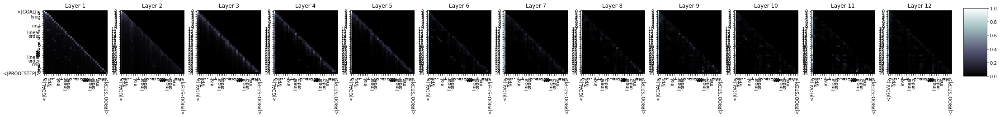

38400it [26:22, 26.72it/s]

  Step 38,400  of  147,271. Loss: 2.330453395843506.   Elapsed: 0:26:23.
Sample:rw [max_neg]<|endoftext|><|PROOFSTEP|>split_ifs<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp [command]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance a<|endoftext|><|PROOFSTEP|>rw [← subtype.coe_id_eq_eq, subtype.coe_id, subtype.coe_iff]<|endoftext|><|PROOFSTEP|>rw [subtype.coe_id_eq_apply, subtype.coe_iff, subtype.to_coe]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>rcases _ _ with ⟨rpow, rfl, hab, h, hbz, rfl, rfl1, rfl2, rfl3, rfl4, rfl5<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw psmul.le<|endoftext|><|PROOFSTEP|>let.coe_eq<|endoftext|><|PROOFSTEP|>rw mul_subset_univ at psmul.right<|endoftext|><|PROOFSTEP|>simp only [ne, ne.mk_iff_
rw -> 0.2615066170692444
s -> 0.2335285246372223
ex -> 0.1733742654323578
apply -> 0.1458543837070465
int -> 0.06807627528905869
have -> 0.03341537341475487
cases 

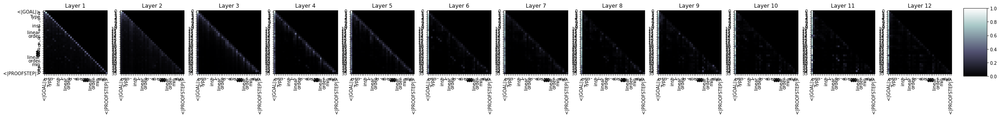

41597it [28:35, 26.68it/s]

  Step 41,600  of  147,271. Loss: 0.9679213762283325.   Elapsed: 0:28:35.
Sample:obtain ⟨z, rfl⟩ := hl_of_lt_min<|endoftext|><|PROOFSTEP|>split_ifs with rfl |<|endoftext|><|PROOFSTEP|>rw [← mem_eq_of_nonneg _ _ _]<|endoftext|><|PROOFSTEP|>symmetry_bot<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>unfold_mem<|endoftext|><|PROOFSTEP|>cases _ inv<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>s i j<|endoftext|><|PROOFSTEP|>by_cases i j j<|endoftext|>p<|endoftext|>Union<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>simp_instance<|endoftext|>subs<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>have : (has_le.2 hs, tl<|endoftext|>1 hs, tl1 hs, s1 nd1, s1_lt1<|endoftext|><|PROOFSTEP|>apply_instance,<|endoftext|><|PROOFSTEP|>unsubs1<|endoftext|><|PROOFSTEP|>apply_instance, if, by simp<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance, nat.one_mul_right<|end

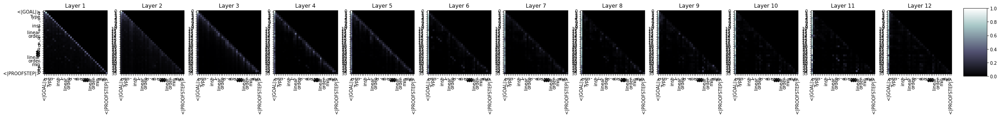

44798it [30:48, 28.22it/s]

  Step 44,800  of  147,271. Loss: 1.0989309549331665.   Elapsed: 0:30:49.
Sample:exact min_le_max_left<|endoftext|><|PROOFSTEP|>exact max_le_max<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [← is_const, ← is_const_zero, not_or_dist]<|endoftext|><|PROOFSTEP|>have := is_const_zero.not_of_comp.2<|endoftext|><|PROOFSTEP|>rw ← with_comm<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>obviously.inl<|endoftext|><|PROOFSTEP|>try forall.inl<|endoftext|><|PROOFSTEP|>subst<|endoftext|><|PROOFSTEP|>simpa onlyI<|endoftext|><|PROOFSTEP|>linlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinlinin<|endoftext|><|PROOFSTEP|>simpa onlyIne<|endoftext|><|PROOFSTEP|>apply_instance_instance_iff<|endoftext|><|PROOFSTEP|>exists<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>have {h_1 : mnreal.unc_zero _ _ =
s -> 0.45292243361473083
rw -> 0.24650481343269348
ex -

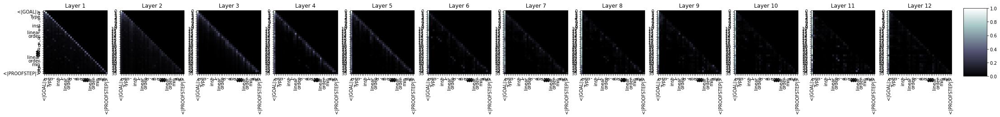

48000it [33:00, 24.77it/s]

  Step 48,000  of  147,271. Loss: 1.3080341815948486.   Elapsed: 0:33:01.
Sample:simp only [max_eq_distrib]<|endoftext|><|PROOFSTEP|>simp only [min_distrib, max_distrib]<|endoftext|><|PROOFSTEP|>simp only [max_distrib, max_distrib]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [top_eq_top, le_cont, top_eq_top]<|endoftext|><|PROOFSTEP|>simp only [top_eq_top, le_pre, le_pre_top]<|endoftext|><|PROOFSTEP|>apply_instance_def<|endoftext|><|PROOFSTEP|>apply_instance_def<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_one<|endoftext|>⊢ (in.dist_singleton_bot ⟨1, _⟩), 1, 1⟩<|endoftext|><|PROOFSTEP|>simp only [dist_singleton_bot.mpr ⟨2, _⟩]<|endoftext|><|PROOFSTEP|>simpsimp_one : not_true ⟨1,<|GOAL|> a, _⟩, 2�
s -> 0.4736257493495941
rw -> 0.24727775156497955
ex -> 0.10827570408582687
apply -> 0.04258893430233002
int -> 0.03659014776349068
ref -> 0.024568460881710052
have -> 0.021861063316464424
sim -> 0.01677335612475872
cases -> 0.01

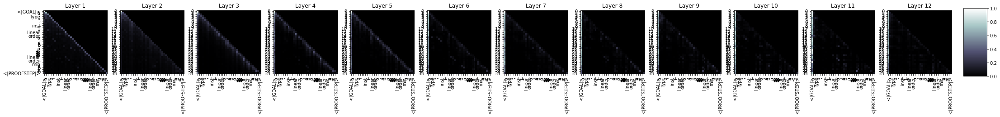

51199it [35:11, 27.81it/s]

  Step 51,200  of  147,271. Loss: 0.9987131953239441.   Elapsed: 0:35:11.
Sample:rw min_eq_neg<|endoftext|><|PROOFSTEP|>rw mul_right<|endoftext|><|PROOFSTEP|>rw [← eq_iff_eq_neg_iff, neg_neg]<|endoftext|><|PROOFSTEP|>exact eq_prepos_pos _<|endoftext|><|PROOFSTEP|>refine le_antisymm (lt_top_of_nonneg (lt_top_of))<|endoftext|><|PROOFSTEP|>simp!1 (1 : ℤ)<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>rw ←I₂<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rintro rfl<|endoftext|>refl<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw ←I�<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intros<|endoftext|>A<|endoftext|><|PROOFSTEP|>s.stg<|endoftext|>H2 IH2 Hm2 Hm2 : ∀ (x : ℤ), (x = IH2.pos x).to_real) := Hm2.to_real hm2 hm2<|endoftext|><|PROOFSTEP|>rw [←s.lone,
s -> 0.42800062894821167
rw -> 0.25219017267227173
ex -> 0.13813257217407227
apply -> 0.04382374882698059
int -> 0.03554008901119232
have -> 0.02694161981344223
ref -> 0.024

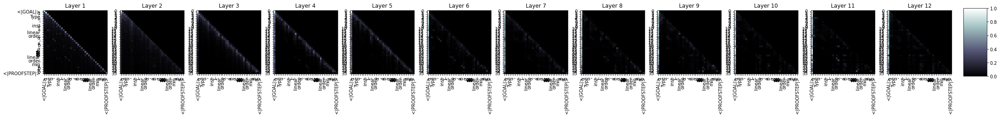

54400it [37:22, 25.39it/s]

  Step 54,400  of  147,271. Loss: 1.0305222272872925.   Elapsed: 0:37:23.
Sample:intros<|endoftext|><|PROOFSTEP|>simp only [comm]<|endoftext|><|PROOFSTEP|>exact functor.single<|endoftext|><|PROOFSTEP|>simp at bff<|endoftext|><|PROOFSTEP|>have i h : i ∈ [x] x, (x.re, hi.re)<|endoftext|><|PROOFSTEP|>simpa only [inv_eq_one, inv_eq_one_iff_mul, one_ne_zero] using h<|endoftext|><|PROOFSTEP|>refine ⟨h, λ i, x y, h.1, h.2, h.3⟩<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [gsmul_iff_comp]<|endoftext|><|PROOFSTEP|>rw [inter, h.2 (inter_prod_mem_two] (mem_mem_single' h h.2))<|endoftext|><|PROOFSTEP|>simp_rw [inter, gsmul_iff_comp]<|endoftext|><|PROOFSTEP|>rw [inter, h.8, inter.1 h]<|endoftext|><|PROOFSTEP|>rw h.2<|endoftext|><|PROOFSTEP|>
s -> 0.43883049488067627
rw -> 0.16515004634857178
ex -> 0.12208914011716843
apply -> 0.06706349551677704
have -> 0.04427514225244522
cases -> 0.0408916212618351
int -> 0.04018530994653702
ref -> 0.03962724283337593
r

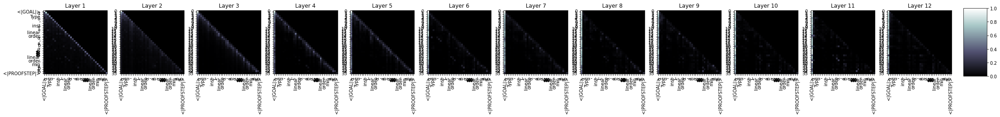

57599it [39:34, 24.60it/s]

  Step 57,600  of  147,271. Loss: 1.2679290771484375.   Elapsed: 0:39:35.
Sample:convert -lsmul_le_max _ _ _ _ _ _<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>simp only [infi_le_iff_left, infi_le_iff_right]<|endoftext|><|PROOFSTEP|>simp only [infi_le_iff_left, infi_le_iff_right, infi_le_iff_right]<|endoftext|><|PROOFSTEP|>simp only [Infi_eq_one, infi_eq_one, infi_le_one]<|endoftext|><|PROOFSTEP|>by tt<|endoftext|><|PROOFSTEP|>triviality<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp_ne<|endoftext|><|PROOFSTEP|>cases.1, hab, hb, hb, bc, bc₂<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>con_norm<|endoftext|><|PROOFSTEP|>have := by : convex_norms_on_nonpos<|endoftext|><|PROOFSTEP|>intros (1 : coe.nonpos 1)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply hdg<|endoftext|><|PROOFSTEP|>
s -> 0.454851895570755
rw -> 0.13171212375164032
ex -> 0.11550600826740265
int -> 0.06520409882068634
apply -> 0.05477409437298775
cases -> 0.0528506375849247
r

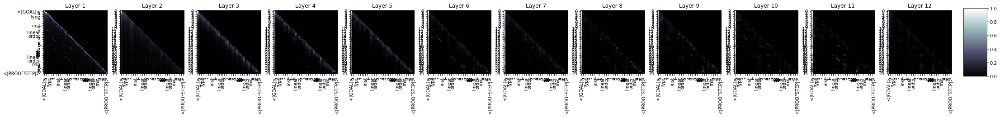

60800it [41:45, 23.77it/s]

  Step 60,800  of  147,271. Loss: 1.3515994548797607.   Elapsed: 0:41:45.
Sample:apply le_antisymm<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [prod.lt_one, eq_prod_iff_lt_left]<|endoftext|><|PROOFSTEP|>instructive<|endoftext|><|PROOFSTEP|>exact_iff at *<|endoftext|><|PROOFSTEP|>assume_iff<|endoftext|><|PROOFSTEP|>exact_iff.1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact_iff.3 (mem_nonneg_of_neg _ _)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have := tendsto_lt<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>intime<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>by simpa1_simp_right<|endoftext|>R<|endoftext|><|PROOFSTEP|>have<|endoftext|>by simpa1_simp_right<|endoftext|>S : ∀ _, a, {a0 := h, a1 := sub_zero.2 h, sub_zero.1 a1, a1s<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact_intros<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>by_intros<|endoftext|><|PROOFSTEP|>have<|endoftext|><|PROOFSTEP|>by :<|endof

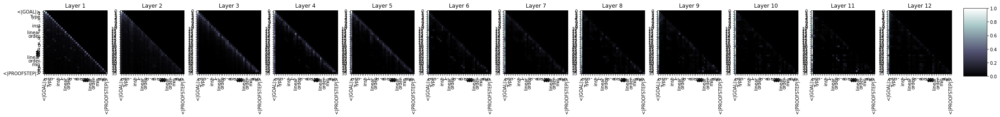

64000it [43:58, 20.82it/s]

  Step 64,000  of  147,271. Loss: 1.3801575899124146.   Elapsed: 0:43:58.
Sample:refine le_antisymm (le_top ⊓ top_right _)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [←subtype_one.gcf, subtype.gcf, subtype.subtype]<|endoftext|><|PROOFSTEP|>t<|endoftext|><|PROOFSTEP|>simp [subtype_gcf, subtype.subtype.comp_gcf, type.subtype.comp_gcf]<|endoftext|><|PROOFSTEP|>simp_eq_zero<|endoftext|><|PROOFSTEP|>simp_eq_right (eq_of_nat_succ.0 0 0) (lt_refl _)<|endoftext|><|PROOFSTEP|>simp | is_is_non_lt (le_self _)<|endoftext|><|PROOFSTEP|>ext s<|endoftext|><|PROOFSTEP|>ext1 h<|endoftext|><|PROOFSTEP|>rw [←ext_succ, zero_lt_succ.1]<|endoftext|><|PROOFSTEP|>rw [lt_refl, ←ext_succ, option.eq_of_
s -> 0.421858012676239
rw -> 0.15552018582820892
ex -> 0.10358256846666336
int -> 0.08744348585605621
apply -> 0.07147282361984253
cases -> 0.04362492635846138
ref -> 0.03414526954293251
re -> 0.030192121863365173
have 

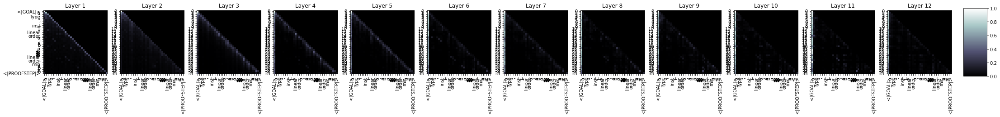

67200it [46:07, 27.04it/s]

  Step 67,200  of  147,271. Loss: 1.161158561706543.   Elapsed: 0:46:08.
Sample:norm_num<|endoftext|><|PROOFSTEP|>simpa only [non_zero_div, zero_div_one] using (not_zeroed_in : nonzeroed_in this)<|endoftext|><|PROOFSTEP|>exact not_zeroed_in.2<|endoftext|><|PROOFSTEP|>simp [non �non_zero]<|endoftext|><|PROOFSTEP|>exact_lmk_exists this rfl<|endoftext|><|PROOFSTEP|>assumption<|endoftext|><|PROOFSTEP|>rcas_of_neg _<|endoftext|><|PROOFSTEP|>cases_of_neg : nonneg ∅ ≃.nonneg, nonneg := (ne.symm, has_nonneg.has_neg.symm_nonneg.symm)<|endoftext|><|PROOFSTEP|>convert aes_of_lt.of_nonneg (by norm_of_ne_of_nonneg _ _ _)<|endoftext|><|PROOFSTEP|>simp only [naturality_eq_nonneg, set_nonneg, nonneg_neg, nonneg_nonneg, neg_nonneg, has_
s -> 0.3128284811973572
ex -> 0.17162375152111053
rw -> 0.12025536596775055
int -> 0.11594308912754059
apply -> 0.08110892027616501
ref -> 0.04603833705186844
cases -> 0.044178809970617294
re -> 0.04293406382203102
have -> 0.038898564875125885
split -> 0.026190733537077

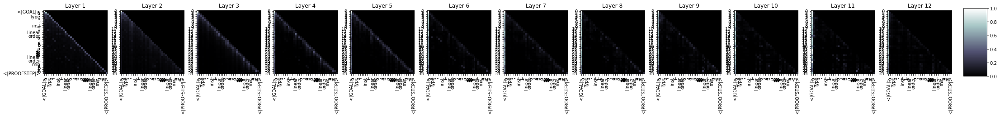

70400it [48:21, 28.52it/s]

  Step 70,400  of  147,271. Loss: 1.030471682548523.   Elapsed: 0:48:21.
Sample:refine min_singleton_of_le_max (λ h, min_singleton_of_lt_of_le (le_max_one _) * _ h) _<|endoftext|><|PROOFSTEP|>have := top_right_congr (le _)left<|endoftext|><|PROOFSTEP|>rw top_right_congr_of_le_total<|endoftext|><|PROOFSTEP|>exact le_prod_eq_one_of_lt (max_le_prod_eq_one_of_lt _ (max_le_prod_eq_one_of_lt _ (max_le_prod_eq_one_of_lt_some _))<|endoftext|><|PROOFSTEP|>simpa {rods := {refl :=<|endoftext|><|PROOFSTEP|>refine congr_compl_aux ⟨le, le.zero_compl_cons] (prod_to_symm _, congr_compl_cons _)<|endoftext|><|PROOFSTEP|>dsimp [refl]<|endoftext|><|PROOFSTEP|>s
s -> 0.3161998391151428
ex -> 0.2289745807647705
rw -> 0.15589118003845215
int -> 0.0664503425359726
apply -> 0.0659625306725502
have -> 0.04222729429602623
cases -> 0.035573191940784454
re -> 0.03224121779203415
ref -> 0.030190059915184975
sim -> 0.02628973126411438


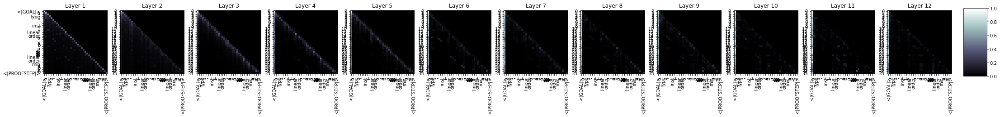

73600it [50:34, 26.43it/s]

  Step 73,600  of  147,271. Loss: 1.155687928199768.   Elapsed: 0:50:34.
Sample:rw [← le_antisymm, min_comm]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have i : ennreal.to_real ⊥, i = 1 ↔ i = 1, set.snd i, set.snd i<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext : is_coe_nat i<|endoftext|><|PROOFSTEP|>use<|endoftext|><|PROOFSTEP|>apply_instance_apply IH<|endoftext|><|PROOFSTEP|>apply_instance_apply IH<|endoftext|><|PROOFSTEP|>exists_eq_inj.1 a h<|endoftext|><|PROOFSTEP|>s IH<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>exists_eq_inj.1 by id_of_mem_inj<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>apply_apply_eq_inj.1<|endoftext|><|PROOFSTEP|>cases_eq,<|endoftext|><|PROOFSTEP|>s1<|endoftext|><|PROOFSTEP|>m : ∀ (x : punit), x ∈ punit.is_mem_is_mem.1.proper (x.mem)
s -> 0.5257703065872192
rw -> 0.18949709832668304
ex -> 0.08675643801689148
apply -> 0.04797080159187317


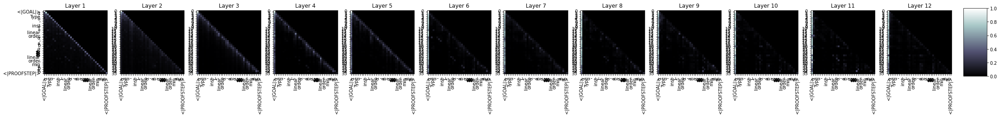

76799it [52:46, 24.54it/s]

  Step 76,800  of  147,271. Loss: 1.2759989500045776.   Elapsed: 0:52:46.
Sample:simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>assumption a b : decidable_eq.to_iff_zero_iff, hb ⟨h, _, _⟩<|endoftext|><|PROOFSTEP|>apply_instance_derive_field<|endoftext|><|PROOFSTEP|>apply_instance_derive_field<|endoftext|><|PROOFSTEP|>apply_instance_derive_field<|endoftext|><|PROOFSTEP|>s1<|endoftext|><|PROOFSTEP|>m1<|endoftext|><|PROOFSTEP|>sub_ne_top<|endoftext|><|PROOFSTEP|>s1<|endoftext|><|PROOFSTEP|>tidy_snd<|endoftext|><|PROOFSTEP|>assow_refl<|endoftext|>c : ⊢ ∀ (s : finset (fin.fin.prod)), (1 : subset (fin.inq fin.fin.prod)) ∧ ∀ is_nonzero (fin.inq fin.fin.prod) (s1 : finset (fin.prod)), (fin.inq fin.fin.prod_is_nonzero))<|endoftext|><|PROOFSTEP|>induction I
s -> 0.3903807997703552
rw -> 0.20507527887821198
ex -> 0.15300367772579193
apply -> 0.08301182091236115
int -> 0.038908716291189194
have -> 0.03233104944229126
cases -> 0.0289850

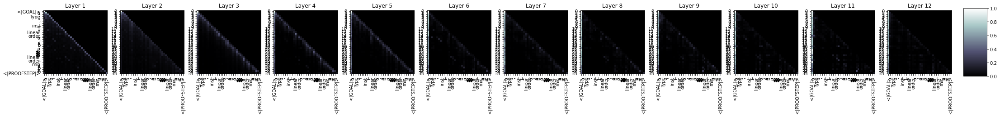

79999it [54:59, 19.44it/s]

  Step 80,000  of  147,271. Loss: 0.6224894523620605.   Elapsed: 0:54:59.
Sample:simpa using min_lt_bot_min<|endoftext|><|PROOFSTEP|>simp [max_iff_le, max_coe_le_coe, max_coe']<|endoftext|><|PROOFSTEP|>rw max_eq_right_left_right at top<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [zero_ne_zero]<|endoftext|><|PROOFSTEP|>simp [-neg_lt_one]<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>s S.b<|endoftext|><|PROOFSTEP|>by_cases<|endoftext|>t'<|endoftext|><|PROOFSTEP|>rw p<|endoftext|><|PROOFSTEP|>rw ←symm_iff_ne_zero<|endoftext|><|PROOFSTEP|>simp [simp]<|endoftext|><|PROOFSTEP|>apply (simp_one { to_re := not_refl]<|endoftext|><|PROOFSTEP|>by_refl<|endoftext|>I A F (A) S<|endoftext|><|PROOFSTEP|>simpA<|endoftext|><|PROOFSTEP|>ext AI<|endoftext|><|PROOFSTEP|>use I :=<|endoftext|><|PROOFSTEP|>by<|endoftext|>by using I.stp<|endoftext|>b A.sms<|endoftext|>A<|endoftext|><|PROOFSTEP|>simp<|endoftext|>a (fst)<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>simpa.
rw ->

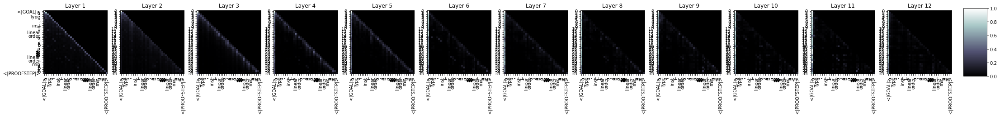

83199it [57:12, 27.01it/s]

  Step 83,200  of  147,271. Loss: 0.9011583924293518.   Elapsed: 0:57:12.
Sample:let h := a<|endoftext|><|PROOFSTEP|>have := {x} a b<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [← sub_eq_zero_comm, sub_succ_succ] at *<|endoftext|><|PROOFSTEP|>rw [one_apply]<|endoftext|><|PROOFSTEP|>rw [one_apply_iff, one_apply_lt, one_apply_lt] at *<|endoftext|><|PROOFSTEP|>suffices_iff_ne_of_top, ← zero_apply_eq_top<|endoftext|><|PROOFSTEP|>rw ← top_iff_ne_top<|endoftext|><|PROOFSTEP|>by_contrapose_top_iff_le.1<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>let ht<|endoftext|><|PROOFSTEP|>s : (1 : fintype nat.zero_le), set.mem' (fintype.nat_le_zero) := _<|endoftext|><|PROOFSTEP|>rw # ← add_subset<|endoftext|><|PROOFSTEP|>rw [one_apply_eq_zero_iff_ne, ← add_subset, subset
rw -> 0.411132276058197
s -> 0.22889065742492676
ex -> 0.1289081573486328
apply -> 0.062285277992486954
have -> 0.05022568628191948
re -> 0.029260195791721344
int -> 0.02757168933749199
cases -> 0.024

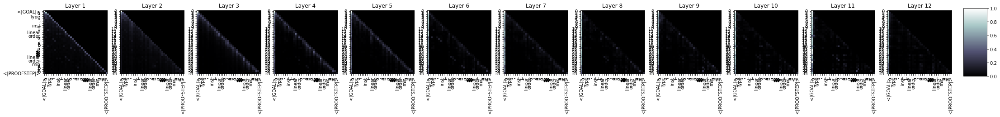

86398it [59:25, 26.51it/s]

  Step 86,400  of  147,271. Loss: 0.6521386504173279.   Elapsed: 0:59:26.
Sample:refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases w with ⟨g, hg, hg⟩<|endoftext|><|PROOFSTEP|>rw [← not_imp_assoc]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp [not_imp, hb_iff]<|endoftext|><|PROOFSTEP|>submodule.symm<|endoftext|><|PROOFSTEP|>simp - ∃ (g hg hb hs : ∀ hg : H, hs.dom = hb.dom := with g hg<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>use.mem_simp Hs : hs.dom = dif.try {b // hb.dom ≠_symm}<|endoftext|><|PROOFSTEP|>simp [inter_imp_iff, hb.dom, is_mul, ne.ne_top, hb.ne_top, is_mul, ne.ne_top, is_mul, ← ne_top, hb.ne_top,
s -> 0.4200282692909241
rw -> 0.25841331481933594
ex -> 0.13059107959270477
apply -> 0.04521171376109123
have -> 0.03765444830060005
re -> 0.029445087537169456
int -> 0.023683948442339897
cases -> 0.021396702155470848
split -> 0.017317932099103928
ref -> 0.016257431358098984


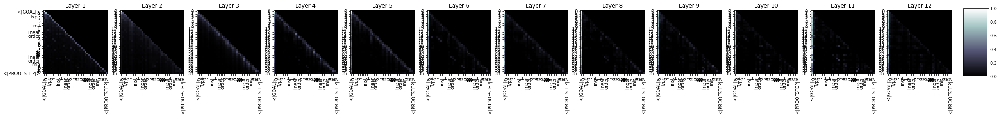

89598it [1:01:37, 25.97it/s]

  Step 89,600  of  147,271. Loss: 1.2073558568954468.   Elapsed: 1:01:38.
Sample:split<|endoftext|><|PROOFSTEP|>simp [← max_left_top, ← max_right]<|endoftext|><|PROOFSTEP|>simp [max_left_top, ← max_left_top + max_right]<|endoftext|><|PROOFSTEP|>simp [top_pow, add_def, if_pos] simp<|endoftext|><|PROOFSTEP|>exact (le_add_coe_add_sup_le_coe_top tl_coe]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simpa [sup_tidy_not_distrib]<|endoftext|><|PROOFSTEP|>exact (not_distrib_left_inj_right : ← not_distrib_left_inj_right_sup_le_tobel_sup_left, not_distrib_left_inj_right_sup_le_tobel_sup_right']<|endoftext|><|PROOFSTEP|>simp [add_def, add_distrib_left_inj]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>
s -> 0.4390544295310974
ex -> 0.18633759021759033
rw -> 0.14273272454738617
apply -> 0.05043160542845726
int -> 0.04863308370113373
have -> 0.03987368568778038
re -> 0.032646723091602325
ref -> 0.02215595543384552
cases -> 0.021862441673874855
split -> 0.0162717215716838

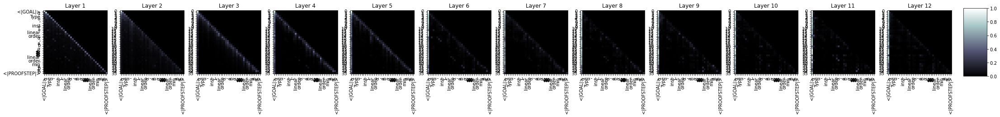

92798it [1:03:49, 27.87it/s]

  Step 92,800  of  147,271. Loss: 1.0437606573104858.   Elapsed: 1:03:50.
Sample:dunfold is_one.subsingleton<|endoftext|><|PROOFSTEP|>simp [sub_eq_zero_iff]<|endoftext|><|PROOFSTEP|>rintro ⟨e, rfl⟩<|endoftext|><|PROOFSTEP|>simp [irrefl]<|endoftext|><|PROOFSTEP|>simp [refl]<|endoftext|><|PROOFSTEP|>intros hi⟩<|endoftext|><|PROOFSTEP|>cases h with h<|endoftext|><|PROOFSTEP|>change h<|endoftext|><|PROOFSTEP|>induction<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [is_b]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ext w<|endoftext|>B = w b a b<|endoftext|>h<|endoftext|><|endoftext|><|PROOFSTEP|>tI<|endoftext|>(0.1, 1.2, 2.1, 2.3, 3.1, 4.1, 9.1, 10.1, 10.1,11, and rfl]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>tI<|endoftext|><|PROOFSTEP|>tI<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|

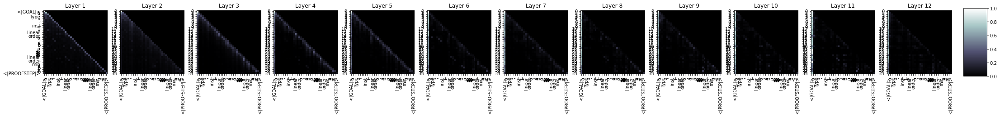

95998it [1:06:03, 23.56it/s]

  Step 96,000  of  147,271. Loss: 1.1252626180648804.   Elapsed: 1:06:04.
Sample:intro h<|endoftext|><|PROOFSTEP|>use h<|endoftext|><|PROOFSTEP|>apply top ^_match : ↥(setoid.closure_image_left (closure_image_right) (closure_image_right))<|endoftext|><|PROOFSTEP|>have := has_mem.1.left<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rintros ⟨⟨_, _, _⟩⟩<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_inst<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>rw top_lifts<|endoftext|>n<|endoftext|><|PROOFSTEP|>exists nat_eq_bot<|endoftext|><|PROOFSTEP|>apply.top_liftsnexists<|endoftext|><|PROOFSTEP|>refl' rfl<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>I.top_liftsnexists<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s<|endoftext|>IH<|endoftext|><|PROOFSTEP|>contradiction<|endoftext|><|PROOFSTEP|>intros<|endoftext|>troduct<|endoftext|>R v1 v2<|endoftext|>1v2<|endoftext|>R<|endoftext|><|PROOFSTEP|>ext<|endoft

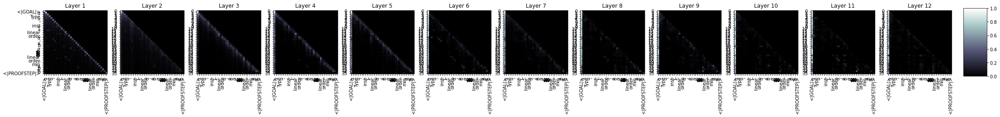

99199it [1:08:13, 24.66it/s]

  Step 99,200  of  147,271. Loss: 0.9564173817634583.   Elapsed: 1:08:14.
Sample:intros<|endoftext|><|PROOFSTEP|>exact add_def<|endoftext|><|PROOFSTEP|>tactic.pi_instance_derive_field<|endoftext|><|PROOFSTEP|>exact_not_le<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>exact set.empty<|endoftext|><|PROOFSTEP|>exact_left<|endoftext|><|PROOFSTEP|>induction _ _<|endoftext|><|PROOFSTEP|>cases h<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>r<|endoftext|><|PROOFSTEP|>simp [← hf.elim, hf.elim]<|endoftext|><|PROOFSTEP|>simp_1 hn<|endoftext|><|PROOFSTEP|>simp_2 hn<|endoftext|><|PROOFSTEP|>simp.1<|endoftext|><|PROOFSTEP|>refl<|endoftext|>s<|endoftext|><|PROOFSTEP|>inh_is_dvd<|endoftext|>L<|endoftext|><|PROOFSTEP|>try { rfl : ⊤, ←hxR, ← hxR.1, ⊢ 1.elim hxR.2, }<|endoftext|><|PROOFSTEP|>sx : (d * d) = int.2.2<|endoftext|><|PROOFSTEP|>sx<|endoftext|><|PROOFSTEP|>exact_not_add_right_cancel hxR<|endoftext|><|PROOFSTEP|>
s -> 0.39472270011901855
rw -> 0.24287240207195282
ex -> 0.

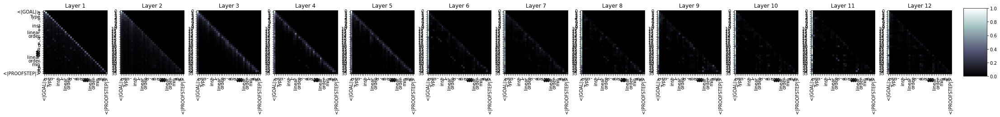

102399it [1:10:25, 21.22it/s]

  Step 102,400  of  147,271. Loss: 1.3574479818344116.   Elapsed: 1:10:26.
Sample:exact min_lt_max a b<|endoftext|><|PROOFSTEP|>from ennreal.1.2.1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact eq_zero_iff_ne_zero<|endoftext|><|PROOFSTEP|>simp at<|endoftext|><|PROOFSTEP|>rw [def, eq_zero_iff]<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ass_iff.mem_zero_one =<|endoftext|>b [mem_zero]<|endoftext|><|PROOFSTEP|>have := h in this<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [mem_zero, add_zero, zero_iff]<|endoftext|><|PROOFSTEP|>rw [add_zero, add_zero]<|endoftext|><|PROOFSTEP|>simp_self<|endoftext|>P<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>rw<|endoftext|>Iic.1<|endoftext|>A2.1 b.1 B1<|endoftext|>M Gromp<|endoftext|><|PROOFSTEP|>rw gromp<|endoftext|>Iic.1_ne, A2.2_ne, Gromp.1_ne<|endoftext|><|PROOFSTEP|>rw cg
s -> 0.382077

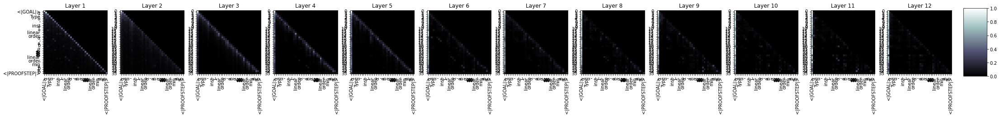

105600it [1:12:38, 26.75it/s]

  Step 105,600  of  147,271. Loss: 1.662118911743164.   Elapsed: 1:12:38.
Sample:simp<|endoftext|><|PROOFSTEP|>simp [has_insert_iff_lt]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [← eq_add_left]<|endoftext|><|PROOFSTEP|>apply add_top_top<|endoftext|><|PROOFSTEP|>apply_contextual<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>b : ∀ (x : finset ℝ), x ∈ finset.univ ∩ set.1_le.3 {toof := h, set.univ_to_eq_zero, mul_left_refl]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [← eq_one, h]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>refine {set := _ }<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s<|endoftext|>←<|endoftext|><|PROOFSTEP|>rfl<|endoftext|>G : uniform, no.district, uniform.subset_univ := uniform.district (district.subset_univ)<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>by C.<|PROOFSTEP|>apply, rfl<|endoftext|><|PROOFSTEP|>
s -> 0.33813193440437317
rw -> 0.21259354054

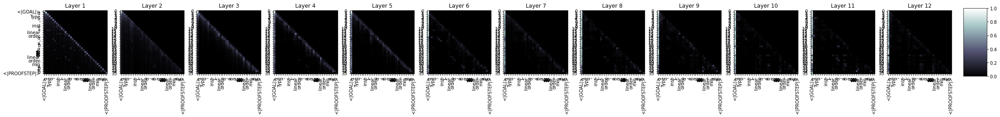

108799it [1:14:49, 27.98it/s]

  Step 108,800  of  147,271. Loss: 1.1224504709243774.   Elapsed: 1:14:49.
Sample:rw [min_lt_iff_zero_or_gt]<|endoftext|><|PROOFSTEP|>rcases set.singleton_le_top with ⟨k, k0⟩<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw cmp_eq<|endoftext|><|PROOFSTEP|>apply h<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact le_or_lt_iff_lt.1 (not_lt_iff.3 (not_lt_iff.2 (le_or.1_le_lt.3))<|endoftext|><|PROOFSTEP|>rw not_ #####<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [le_or.1_lt.2_iff_lt_iff_le_iff_2]<|endoftext|><|PROOFSTEP|>simp [le_or.2_le_iff_le_iff_2]<|endoftext|><|PROOFSTEP|>rw [le_or.2_le_iff_le_iff_le_iff_1_iff.1_le_eq_le_iff.1_
s -> 0.33311691880226135
ex -> 0.20661619305610657
rw -> 0.177748441696167
apply -> 0.06038318946957588
int -> 0.055265702307224274
have -> 0.0469767227768898
ref -> 0.03934706375002861
cases -> 0.037151578813791275
sim -> 0.02272525615990162
re -> 0.02066889964044094


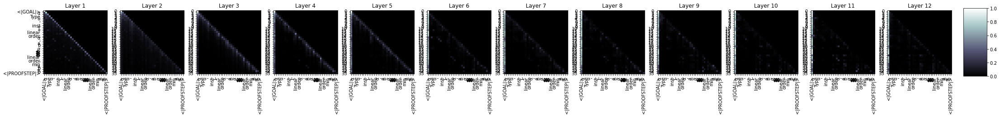

112000it [1:17:01, 25.53it/s]

  Step 112,000  of  147,271. Loss: 0.8171575665473938.   Elapsed: 1:17:01.
Sample:cases b<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>assumption_eq<|endoftext|><|PROOFSTEP|>tidy<|endoftext|><|PROOFSTEP|>tidy<|endoftext|><|PROOFSTEP|>simp_mk<|endoftext|><|PROOFSTEP|>rw [def_eq, sub_smul, sub_of_gt_singleton]<|endoftext|><|PROOFSTEP|>refine {to_fun := (h).sub, ne_self_iff_mem_self, neg_eq_bot]<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>let_refl<|endoftext|><|PROOFSTEP|>cases_le_bounded<|endoftext|><|PROOFSTEP|>rintros ⟨_⟩<|endoftext|><|PROOFSTEP|>induction_self_of_real<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [0]<|endoftext|><|PROOFSTEP|>rw [Icc, Icc_right_left] {← Icosin.c (injective _), injective_eq_iff_not_not_right, Iic_inter, and_lt_one, Iicsin.eq_iff_not_right, Ic.right_left
s -> 0.42336204648017883
ex -> 0.1886337846517563
rw -> 0.1536325067281723
int -> 0.046176470816135406
apply -> 0.04463837295770645
have -> 0.03979453444480896
c

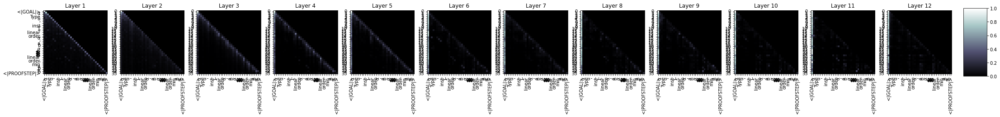

115198it [1:19:14, 25.51it/s]

  Step 115,200  of  147,271. Loss: 1.2339317798614502.   Elapsed: 1:19:14.
Sample:unfold eq<|endoftext|><|PROOFSTEP|>simp only [infi_lt_left, ne.div_zero]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply (bot_lt.1 @bot_of_ne_zero)<|endoftext|><|PROOFSTEP|>apply_context<|endoftext|><|PROOFSTEP|>set_add.1 : 2 _ᾰ x hx<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>rw ← (_in_dist _).2 (2 ∈ hx, ⟨_in_dist _ _, hx⟩ hx⟩<|endoftext|><|PROOFSTEP|>simp only [ne.1_lt, lpow_zero, one_le]<|endoftext|><|PROOFSTEP|>split_eq_coprime.2 _<|endoftext|><|PROOFSTEP|>simp :<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [_top]<|endoftext|><|PROOFSTEP|>rw rfl<|endoftext|>I.symm<|endoftext|><|PROOFSTEP|>apply ← (t_of_le s_lt_iff_le_of_tow<|endoftext|>
ex -> 0.30186158418655396
s -> 0.2900196313858032
rw -> 0.16245587170124054
apply -> 0.04816248640418053
ref -> 0.04745125770568848
int -> 0.047136712819337845
have -> 0.

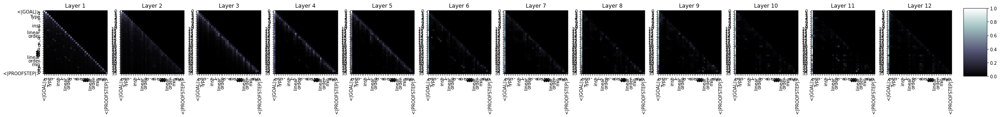

118398it [1:21:27, 22.25it/s]

  Step 118,400  of  147,271. Loss: 0.8214324116706848.   Elapsed: 1:21:27.
Sample:rw [←le_of_rat_min a b, mul_refl]<|endoftext|><|PROOFSTEP|>simpa only using h<|endoftext|><|PROOFSTEP|>tidy<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw ← lt_iff_le_right_or_left<|endoftext|><|PROOFSTEP|>rw h<|endoftext|><|PROOFSTEP|>apply h<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_right_right<|endoftext|><|PROOFSTEP|>rw one_mem<|endoftext|>G : ∃ (m n k : ℕ), ∃ (n k : ℕ), m ℕ ∧ k = m + n, _ - k<|endoftext|><|PROOFSTEP|>simp *<|endoftext|><|PROOFSTEP|>have : ∃ n k : ℕ	⊢ n ∈ subsemactic.2 hne_zero<|endoftext|><|PROOFSTEP|>apply rfl<|endoftext|><|PROOFSTEP|>refine (not_true.1.2 _)<|endoftext|><|PROOFSTEP|>exact (not_true.3 _) hne_zero<|endoftext|><|PROOFSTEP|>simp only if it is rfl<|endoftext|><|PROOFSTEP|>exact<|endoftext|><|PROOFSTEP|>s
s -> 0.2982671856880188
rw -> 0.27119749784469604
ex -> 0.20687295496463776
apply -> 0.05266506224870682
have -> 0.0486568957567215
ref -> 

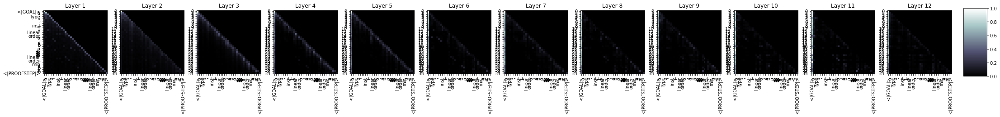

121598it [1:23:38, 25.43it/s]

  Step 121,600  of  147,271. Loss: 0.8883345723152161.   Elapsed: 1:23:39.
Sample:tidy<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>transient'<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rintro ⟨⇑ (eq_zero_of_nonneg zx), cgroup.zero_of_nonneg _⟩ λ hk : ℝ, hk = 0<|endoftext|><|PROOFSTEP|>simpa using one of ⟨ℝ⟩<|endoftext|><|PROOFSTEP|>have : (finset.add_right : aprod (finset.add_cancel : ↥(sub_cancel.2 (cancel_right (cancel_right_left : ↥(sub_cancel.2 (cancel_right _ₘ : ↥(cancel_right (0 : ℝ), cancel_right_left _ₘ _ₘ _ₘ, iff_eq_zero_of_neg _ₘ _ₘ).symm
s -> 0.4030240476131439
ex -> 0.1722876876592636
rw -> 0.16725948452949524
apply -> 0.06939760595560074
have -> 0.049523163586854935
ref -> 0.0342809334397316
sim -> 0.03238912671804428
int -> 0.030453244224190712
cases -> 0.027444705367088318
ext -> 0.013940064236521721


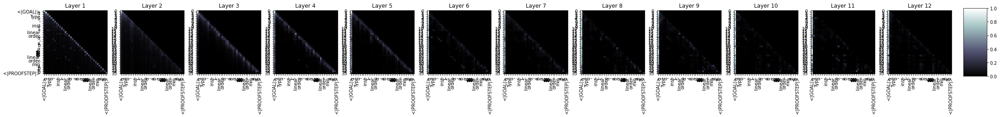

124798it [1:25:52, 25.06it/s]

  Step 124,800  of  147,271. Loss: 1.093644618988037.   Elapsed: 1:25:53.
Sample:rw [← min_lt_iff, ← nat.lt_iff_ne_top, min_lt_iff.2.2]<|endoftext|><|PROOFSTEP|>have : 1 ≤ ⊤<|endoftext|><|PROOFSTEP|>left<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>have : (1 : (1 - 1)⁻¹ ∘ 1) = 1 := is_right_of_ne_zero'_of_ne at 1<|endoftext|><|PROOFSTEP|>exact nat.eq_add_one := (1 : marijuana 1)<|endoftext|><|PROOFSTEP|>have : 1 = 1, by simp<|endoftext|><|PROOFSTEP|>have : (1 : 1)⁻¹ ∘ 1 := is_right_of<|GOAL|>finset.to_nat<|endoftext|><|PROOFSTEP|>exact<|endoftext|><|PROOFSTEP|>use : is_conj 1 @is_right_offinset.to_nat_1 (add_nat_add) (1 : 1)<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simpa using (1 : 1)<|endoftext|>
s -> 0.43340063095092773
rw -> 0.1801363080739975
ex -> 0.14144401252269745
apply -> 0.06043507531285286
have -> 0.04323568195104599
int -> 0.03597480058670044
ref -> 0.03138561546802521
sim -> 0.030246470123529434
cases -> 0.029621653258800507
ext -> 0.0141198113560676

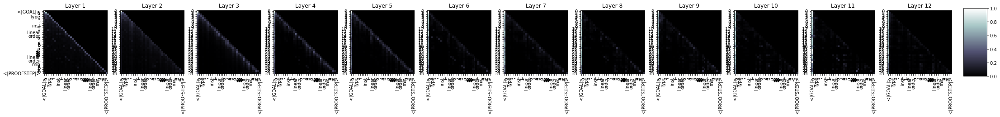

127999it [1:28:05, 25.83it/s]

  Step 128,000  of  147,271. Loss: 0.9572743773460388.   Elapsed: 1:28:06.
Sample:simp only [norm_pos.le_one, min_neg.symm, neg_iff_nonneg, int.neg_eq_one_iff]<|endoftext|><|PROOFSTEP|>convert λ x_1 hx, hx_nonneg x_1<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refine decidable_predicate.2 {to_mem, _} (λ x, hx_nonneg x_1 x_2)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ext1<|endoftext|><|PROOFSTEP|>cases 0 x1 x2 with hx3<|endoftext|><|PROOFSTEP|>ext1<|endoftext|><|PROOFSTEP|>simp_le<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>assow_refl<|endoftext|><|PROOFSTEP|>cases0 2 x1 with hx3<|endoftext|><|PROOFSTEP|>by<|endoftext|>1 : ∀ (u : u.1_mem), ∃ x_1 x2, _, _, _, is_refl.1<|endoftext|><|PROOFSTEP|>have : {f
s -> 0.33851954340934753
rw -> 0.2050180286169052
ex -> 0.12894539535045624
cases -> 0.11668103188276291
apply -> 0.053612373769283295
int -> 0.04922206699848175
have -> 0.04

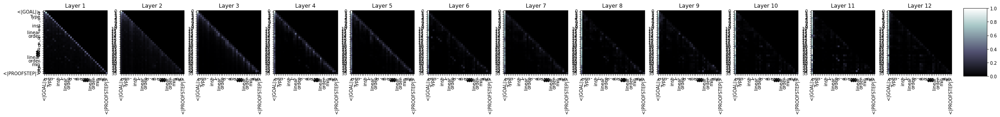

131198it [1:30:16, 26.26it/s]

  Step 131,200  of  147,271. Loss: 0.6150694489479065.   Elapsed: 1:30:17.
Sample:exact zero_tidy_le_top b<|endoftext|><|PROOFSTEP|>rw ← div_eq_div_le<|endoftext|><|PROOFSTEP|>rw mul_neg_iff_div_le_div_le_div_le<|endoftext|><|PROOFSTEP|>apply mem_subset_right<|endoftext|><|PROOFSTEP|>apply pic_add<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact of_true<|endoftext|><|PROOFSTEP|>intro_1<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact (mem_refl).intro<|endoftext|><|PROOFSTEP|>exact_ne_top _ hs<|endoftext|><|PROOFSTEP|>simp_tsum<|endoftext|><|PROOFSTEP|>intro hs<|endoftext|><|PROOFSTEP|>have, ha<|endoftext|><|PROOFSTEP|>have_neg at rfl<|endoftext|><|PROOFSTEP|>have_tot_eq_right<|endoftext|><|PROOFSTEP|>have_ne_top<|endoftext|><|PROOFSTEP|>rw [nhds, have_mem, ne.not_iff_ne, eof]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply KV1<|endoftext|><|PROOFSTEP|>exact_ne_top_2 (apply.mul_neg_right _ inv.
s -> 0.32565635442733765
ex -> 0.1678030639886856
rw -> 

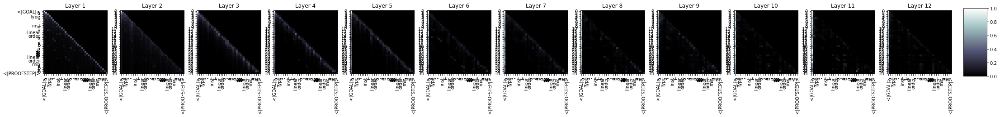

134399it [1:32:27, 26.29it/s]

  Step 134,400  of  147,271. Loss: 1.9307101964950562.   Elapsed: 1:32:28.
Sample:rw [← min_bit0 a b, mul_le_lt_iff]<|endoftext|><|PROOFSTEP|>have VS_I := I<|endoftext|><|PROOFSTEP|>have := := ⟨⟨⟨I, B⟩⟩<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [iff_eq_apply, IH_apply, or_iff_eq_apply, nat.not_iff, nat.not_iff_eq_apply_iff_nat, IH_apply]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>sigma_eq_apply_eq_self<|endoftext|><|PROOFSTEP|>sigma_eq H1 H2 he_le_iff_irr_rf h2.elim<|endoftext|><|PROOFSTEP|>rw [iff_eq_apply_self_irr<|endoftext|><|PROOFSTEP|>apply_instance,<|endoftext|><|PROOFSTEP|>cases_eq_iff_irr_zero, h3
s -> 0.23004135489463806
rw -> 0.2300395965576172
ex -> 0.20703928172588348
apply -> 0.07427266985177994
int -> 0.07279332727193832
cases -> 0.06935913115739822
ext -> 0.04657759889960289


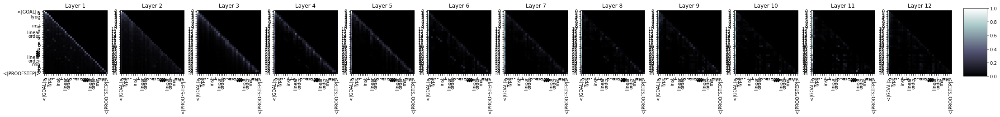

137600it [1:34:40, 26.72it/s]

  Step 137,600  of  147,271. Loss: 0.4595355689525604.   Elapsed: 1:34:40.
Sample:simp<|endoftext|><|PROOFSTEP|>refine_to_comap<|endoftext|><|PROOFSTEP|>refine le_trans_of_le _ _ (sub_le _ _)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>by_cases<|endoftext|><|PROOFSTEP|>have := ih : 1 : a ∈ 1 • A := e<|endoftext|><|PROOFSTEP|>simp [eq_one_mul]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>cases with le_le _<|endoftext|><|PROOFSTEP|>by_cases<|endoftext|>C : (1) (2) (3) (4) (5) (6) (7<|GOAL|><|endoftext|><|PROOFSTEP|>snd : 0snd = 1snd := {to_finset := λ, add_mul_mul, add_mul_add, not_def, nat.def]<|endoftext|><|PROOFSTEP|>snd is_one_left<|endoftext|><|PROOFSTEP|>snd_def_one : snd 0snd = 1 snd := (2 - 1)<|endoftext|><|PROOFSTEP|>snd
s -> 0.302974134683609
ex -> 0.18946370482444763
rw -> 0.17204207181930542
int -> 0.09312945604324341
cases -> 0.07963672280311584
apply -> 0.05274932086467743
have -> 0.03597760573

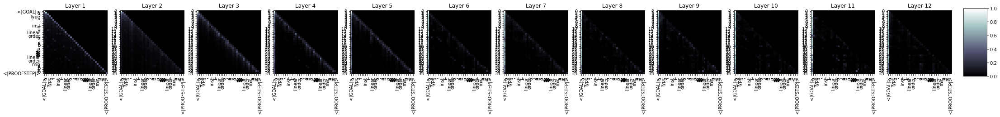

140800it [1:36:52, 22.11it/s]

  Step 140,800  of  147,271. Loss: 1.0122336149215698.   Elapsed: 1:36:53.
Sample:cases a<|endoftext|><|PROOFSTEP|>cases b<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases_le_right_left<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [lt_iff_lt_iff_le_left]<|endoftext|><|PROOFSTEP|>simp_rec<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [simp]<|endoftext|><|PROOFSTEP|>rw [← ← [← [mem_trans, le_le_iff_right_right], ← [← hav, le_imp_right_eq_bot_inf_le]<|endoftext|><|PROOFSTEP|>rw [not_iff, and_mul, nat.def_and_distrib, and_mul, and_mul]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance_funext<|endoftext|><|PROOFSTEP|>set_right : only a bdvd exists a dvd<|endoftext|><|PROOFSTEP|>indy_zero<|endoftext|><|PROOFSTEP|>rw one_left_of_iff_le_not_le_iff_lt<|endoftext|><|PROOFSTEP|>ext_
s -> 0.3451690375804901
rw -> 0.1826077252626419
ex -> 0.1374538689851761
apply -> 0.10891326516866684
int -> 0.071337

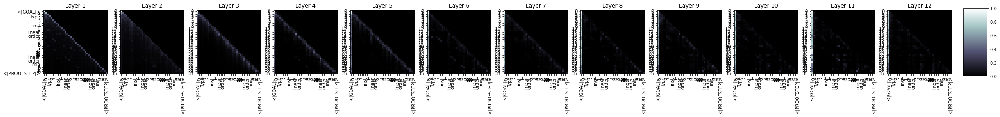

144000it [1:39:03, 27.58it/s]

  Step 144,000  of  147,271. Loss: 1.650336742401123.   Elapsed: 1:39:04.
Sample:linarith<|endoftext|><|PROOFSTEP|>simp [← finsupp.card_nat_left]<|endoftext|><|PROOFSTEP|>rw [← card_apply_left]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_const<|endoftext|><|PROOFSTEP|>simpa only [nhds_const_not_ne_top, nhds_add_left]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>s : ∀ (v : fin 2), nat.sum.sub_ne.sub_right v<|endoftext|><|PROOFSTEP|>rcases rfl with ⟨v, hv, vn, efl rfl⟩<|endoftext|><|PROOFSTEP|>simp [h]<|endoftext|><|PROOFSTEP|>haveI : sub_closure_mul : is_closure v, hv, hvich, hvich, hV, le_trans hv, le_trans, hVn, hV, hvn, hvn, hvn, hav, hav, dnhds,
s -> 0.3174993395805359
rw -> 0.3110021948814392
apply -> 0.10298988223075867
ex -> 0.09126155823469162
int -> 0.04971315711736679
re -> 0.03560912236571312
have -> 0.03344886377453804
cases -> 0.030092688277363777
ref -> 0.014657838270068169
ext -> 0.013725423254072666


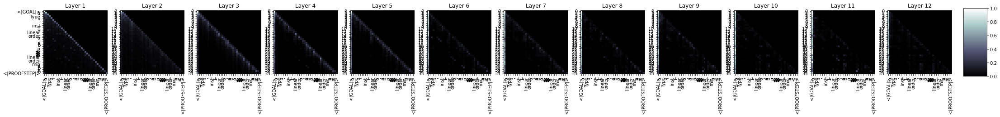

147200it [1:41:13, 27.64it/s]

  Step 147,200  of  147,271. Loss: 1.9236012697219849.   Elapsed: 1:41:14.
Sample:haveI : ∀ {F := {to_fun := _ }}, (a → α)⁻¹ * ∥F∥ = a ∧ ∀ (t : order_topology α), t ⊆ {to_fun := _}ᶜ<|endoftext|><|PROOFSTEP|>have := [←finsupp.prod_iff.1, ←sigma_comp_iff.1, ←sigma_comp_iff.1]<|endoftext|><|PROOFSTEP|>rw coe_of_inv_prod with rfl<|endoftext|><|PROOFSTEP|>rw coe_of<|GOAL|>Rf.prod_of_inv_prod_of_inv<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>rw xn_iff_is_one<|endoftext|><|PROOFSTEP|>ext_bounded_for.lt_iff<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>induction_eq_prod<|endoftext|><|PROOFSTEP|>exists_mul_zero_of_le
s -> 0.3395145535469055
rw -> 0.2879038453102112
apply -> 0.11310510337352753
ex -> 0.09168323129415512
int -> 0.04705892875790596
cases -> 0.032688040286302567
have -> 0.030345072969794273
re -> 0.02679680474102497
ref -> 0.016762584447860718
rc -> 0.014141865074634552


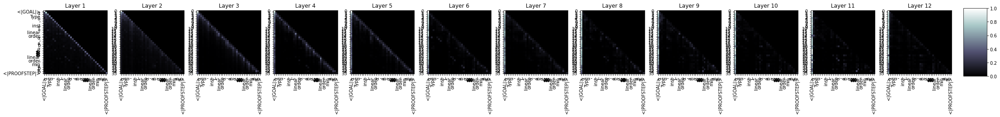

147271it [1:41:22, 24.21it/s]



  Average training loss: 1.08
  Training epoch took: 1:41:22

Running Validation...
  Validation Loss: 1.01
  Validation took: 0:01:33


3it [00:00, 23.33it/s]


======== Epoch 23 / 35 ========
Training...


3199it [02:06, 24.52it/s]

  Step 3,200  of  147,271. Loss: 1.0182113647460938.   Elapsed: 0:02:07.
Sample:cases b<|endoftext|><|PROOFSTEP|>let_repeat := rfl<|endoftext|><|PROOFSTEP|>contrapose { rfl | one_neg }<|endoftext|><|PROOFSTEP|>exact_mod_cast (convergents_of<|GOAL|>_ne_bot (refl _) (ne.dist_right.2)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exists_eq<|endoftext|><|PROOFSTEP|>by_cases {to_fun := (←botactic.le_botactic, ←botactic.le_botactic, le_botactic.1.right_botactic}<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp only [botactic.eq_one_ne_bot, botactic.ne_zero]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exists_eq_one {contextual := {contextual := classical.zero_le, classical.neg_lt, ←zero_eq_one, (comp.nat_le_iff_2, nat_trans
s -> 0.38378480076789856
apply -> 0.15234577655792236
ex -> 0.14832079410552979
rw -> 0.1394059956073761
int -> 0.04788390174508095
have -> 0.04023224860429764
cases -> 0.0

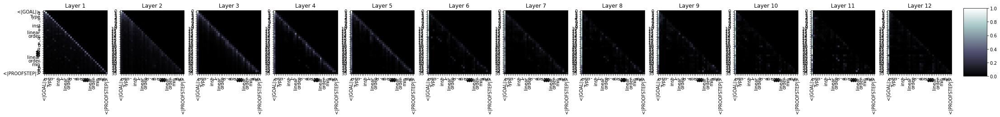

6400it [04:18, 24.92it/s]

  Step 6,400  of  147,271. Loss: 2.2140896320343018.   Elapsed: 0:04:18.
Sample:rw [min_iff_left, min_eq_iff_add_neg, min_eq_iff_neg]<|endoftext|><|PROOFSTEP|>rw [lid_coe, nat.pos_coe] { id := id_subset, neg := eq_subset}<|endoftext|><|PROOFSTEP|>rw [← cgroup_coe_sub_one, ← neg_add]<|endoftext|><|PROOFSTEP|>ext1<|endoftext|><|PROOFSTEP|>simp_rw [add_apply, add_assoc]<|endoftext|><|PROOFSTEP|>refine_of_nonneg<|endoftext|><|PROOFSTEP|>simp_le (0 : ℝ ∨_, _₊)<|endoftext|><|PROOFSTEP|>apply_one<|endoftext|><|PROOFSTEP|>apply_one<|endoftext|><|PROOFSTEP|>apply_inv<|endoftext|><|PROOFSTEP|>apply_zero_eq.1 (preimage :0)<|endoftext|><|PROOFSTEP|>s_of_le a<|endoftext|><|PROOFSTEP|>apply_right<|endoftext|><|PROOFSTEP|>apply_right.1<|endoftext|><|PROOFSTEP|>apply_left<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>apply_lt<|endoftext|><|PROOFSTEP|>apply_right<|endoftext|>
s -> 0.3603267967700958
apply -> 0.1755104511976242
ex -> 0.13061974942684174
rw -> 0.097284

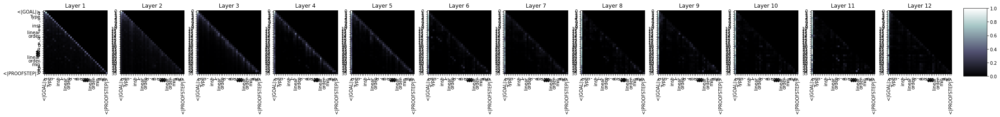

9598it [06:30, 27.50it/s]

  Step 9,600  of  147,271. Loss: 0.7479923367500305.   Elapsed: 0:06:31.
Sample:simp [min_eq_max, one_lt_iff_one_lt]<|endoftext|><|PROOFSTEP|>exact le_zero<|endoftext|><|PROOFSTEP|>norm_def at *<|endoftext|><|PROOFSTEP|>simpa using<|endoftext|><|PROOFSTEP|>ext_of_gt<|endoftext|><|PROOFSTEP|>tidy<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>cases by h<|endoftext|><|PROOFSTEP|>r<|endoftext|><|PROOFSTEP|>exact_def_trans<|endoftext|>1 : is_nonneg (one_le.1)<|endoftext|><|PROOFSTEP|>have : false_zero := false.two_le.1<|endoftext|><|PROOFSTEP|>cases_iff (by _)<|endoftext|><|PROOFSTEP|>indicator<|endoftext|><|PROOFSTEP|>case_not_self<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>s := (mul_empty_ne 1).1<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>apply_classical<|endoftext|><|PROOFSTEP|>s! one { _ }<|endoftext|><|PROOFSTEP|>exists_of_le_of_eq<|endoftext|><|PROOFSTEP|>apply_instance<|end

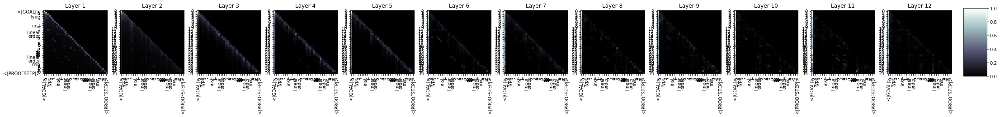

12800it [08:41, 26.96it/s]

  Step 12,800  of  147,271. Loss: 0.9154518842697144.   Elapsed: 0:08:42.
Sample:simp * at *<|endoftext|><|PROOFSTEP|>apply.right_le_inv_right<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>have := {trans := ennreal.coe_nat_iff_nat, norm_coe_nat_iff_nat}<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simpa using<|endoftext|><|PROOFSTEP|>exists_eq_neg (le_of_neg (nat.mem_nonpos _ _)) (le_of_neg (nat.nat_nonpos_lt_mem) (nat.le_nonneg)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_nonpos<|endoftext|><|PROOFSTEP|>exists_neg<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_mul, set_of_ne_of_mem_zero<|endoftext|><|PROOFSTEP|>induction_nhds := nat.cases_on (nat.eq_zero := _).1<|endoftext|><|PROOFSTEP|>rw [induction_m
s -> 0.2848421633243561
rw -> 0.1907152682542801
ex -

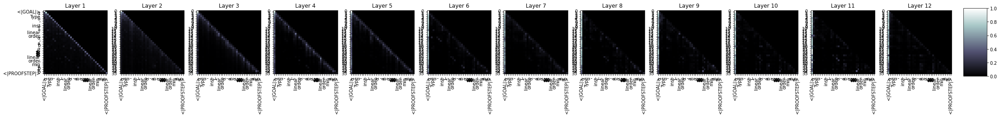

16000it [10:54, 26.74it/s]

  Step 16,000  of  147,271. Loss: 1.02561616897583.   Elapsed: 0:10:54.
Sample:use a<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>use cmp_ne_zero (le_add_aux _)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact le_comm<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>cases_zero<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>rw [← int.neg_cast, ← int.pos_finset, int.neg_cast, ← int.neg_cast]<|endoftext|><|PROOFSTEP|>rw ← neg_eq_zero_iff.1 (neg_nat_ne_zero pnat.ne_zero)<|endoftext|><|PROOFSTEP|>rw ← nat.add_one_ne<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>by_cases<|endoftext|><|PROOFSTEP|>apply_instance_lt<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simp only [← int_add, ← nat.le_def, ← int.le_def]<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simp only [← int
s -> 0.

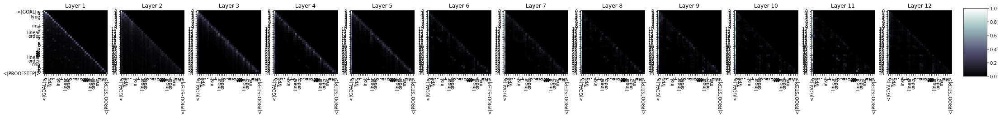

19199it [13:04, 23.54it/s]

  Step 19,200  of  147,271. Loss: 0.8021178841590881.   Elapsed: 0:13:05.
Sample:rw [le_antisymm, linear_order.max_iff]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [← set.range_eq_bot_range]<|endoftext|><|PROOFSTEP|>have := int.range_eq_range_self (-1)<|endoftext|><|PROOFSTEP|>exists_mem_range_aux<|endoftext|><|PROOFSTEP|>int_eq_bot_range<|endoftext|><|PROOFSTEP|>cases : ∀ (m : ℕ), multiset.cont_bUnion (n : ℕ), nat.le_bUnion n := nat.le_bUnion_eq_range_self<|endoftext|><|PROOFSTEP|>try { }<|endoftext|><|PROOFSTEP|>simp [sub_eq_bUnion] with an x<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp |<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [sub_eq_bUnion]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>have :<|endoftext|><|PROOFSTEP|>have := sub_iff_eq_dvd<|endoftext|><|PROOFSTEP|>rw [sub_eq_bUnion
s -> 0.4317469298839569
rw -> 0.2063617706298828
ex -> 0.1008964404463768
int -> 0.0782286003232002

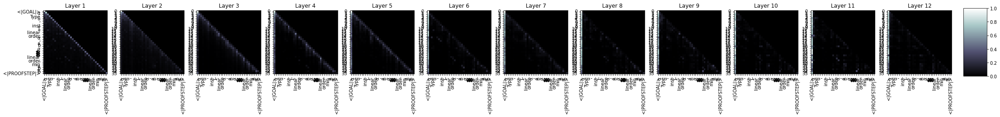

22398it [15:14, 25.95it/s]

  Step 22,400  of  147,271. Loss: 1.5535714626312256.   Elapsed: 0:15:15.
Sample:exact min_le_right a b<|endoftext|><|PROOFSTEP|>ext b<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>dsimp Droid<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [mul_self]<|endoftext|><|PROOFSTEP|>cases' {lhs_cancel]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>cases'<|endoftext|><|PROOFSTEP|>induction_left : (eq_neg _).norm_eq_inj, (neg_of_neg _).norm_eq_inj.1<|endoftext|><|PROOFSTEP|>apply_instance (le.right)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact h<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact<|endoftext|><|PROOFSTEP|>contral_cones.2.1<|endoftext|><|PROOFSTEP|>ext_mk<|endoftext|><|PROOFSTEP|>apply_instance.1<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>s : nonempty ← sub_le.1 (le.nonempty (nonempty.of_inj : nonempty | sub_le.1))<|endoftext|><|PROOFSTEP|>norm_apply_instance<|endoftext|><|PROOFS

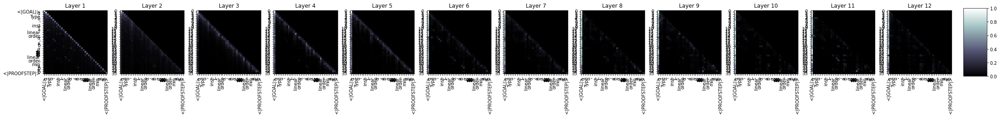

25598it [17:26, 26.80it/s]

  Step 25,600  of  147,271. Loss: 0.9276567101478577.   Elapsed: 0:17:26.
Sample:exact le_max_left<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>cases h1 h2 with h1<|endoftext|><|PROOFSTEP|>rw [le_of_c, zmod_eq_of_le_le, le_of_c, one_le]<|endoftext|><|PROOFSTEP|>rw [mem_coe_nhds, mem_coe_nhds_left, one_le]<|endoftext|><|PROOFSTEP|>simp [nat_eq_iff_mem]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp [nat_eq_iff, nat_inv, nat_eq_iff_mem_inv]<|endoftext|><|PROOFSTEP|>obtain (nonprod_one_ne_zero) |<|endoftext|><|PROOFSTEP|>refl | by simpa<|endoftext|><|PROOFSTEP|>simp (le_of_le.2 _)<|endoftext|><|PROOFSTEP|>rwa [le_one.2, nat_eq]<|endoftext|><|PROOFSTEP|>rw sub_of_lt<|endoftext|><|PROOFSTEP|>by_contradiction<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>rw inv
s -> 0.3128943145275116
ex -> 0.2250252664089203
rw -> 0.17967426776885986
apply -> 0.07347662001848221
int -> 0.05109749734401703
have -> 0.03876911476254463
ca

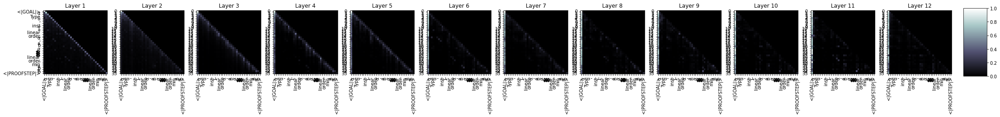

28800it [19:37, 22.81it/s]

  Step 28,800  of  147,271. Loss: 1.4593114852905273.   Elapsed: 0:19:37.
Sample:simp [min]<|endoftext|><|PROOFSTEP|>simp [le_refl]<|endoftext|><|PROOFSTEP|>simp_rw [lt_iff_neg]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_rw [div_eq_left, div_eq_right]<|endoftext|><|PROOFSTEP|>simp *<|endoftext|><|PROOFSTEP|>univ_1<|endoftext|><|PROOFSTEP|>exists_self_of_mem_mem_mem.mp<|endoftext|><|PROOFSTEP|>simp_rw<|endoftext|><|PROOFSTEP|>simp_eq_true_mem at xsimp<|endoftext|><|PROOFSTEP|>simp at xsimp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_eq<|endoftext|><|PROOFSTEP|>split_right<|endoftext|><|PROOFSTEP|>s1<|endoftext|><|PROOFSTEP|>cases_finset<|endoftext|>{o : on, rfl₂, rfl₂ }<|endoftext|><|PROOFSTEP|>simps_lt_one<|endoftext|><|PROOFSTEP|>refl₂<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>rc (not_rfl)<|endoftext|><|PROOFSTEP|>simp_lt_right<|endoftext|><|PROOFSTEP|>apply.def<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PRO

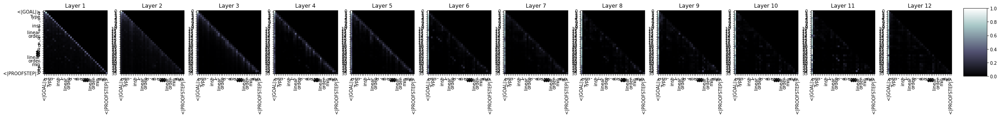

32000it [21:49, 27.85it/s]

  Step 32,000  of  147,271. Loss: 1.5948615074157715.   Elapsed: 0:21:50.
Sample:simp [linear_order.min_dvd_right, min_dvd_left]<|endoftext|><|PROOFSTEP|>have h : ¬a = b := a * b<|endoftext|><|PROOFSTEP|>convert a_mk<|endoftext|><|PROOFSTEP|>rcases rfl|⟨g, h⟩<|endoftext|><|PROOFSTEP|>apply fg⟩<|endoftext|><|PROOFSTEP|>simp only [eq_iff_eq_neg, mul_add_neg_left, ← neg_add_neg_right]<|endoftext|><|PROOFSTEP|>simp' at<|endoftext|><|PROOFSTEP|>right<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>s_of_nat gsmul_left.nhds<|endoftext|><|PROOFSTEP|>left<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>s : mv_polynomial<|endoftext|><|PROOFSTEP|>s := xor_fun s<|endoftext|><|PROOFSTEP|>rw xor_fn<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>t2_right<|endoftext|>simm (0 : 0) s xs<|endoftext|><|PROOFSTEP|>refls<|endoftext|><|PROOFSTEP|>exact (div1_1_x_of_le
rw -> 0.2655777931213379
s -> 0.2535824179649353
ex -> 0.1417725682258606
apply -> 0.10842518508434296
int -> 0.06821277

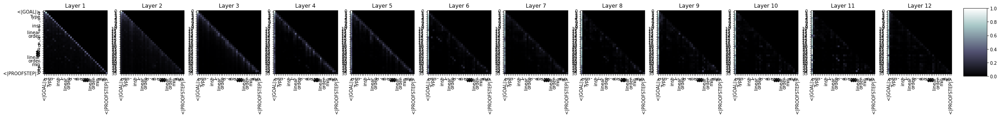

35199it [24:02, 24.30it/s]

  Step 35,200  of  147,271. Loss: 1.035281777381897.   Elapsed: 0:24:02.
Sample:rw [←max_iff, min_ne_zero]<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>rcases h<|endoftext|><|PROOFSTEP|>simpa using rfl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact rfl_left<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [←smul_eq_singleton_not_iff, sub_neg_mem]<|endoftext|><|PROOFSTEP|>by simpa using rfl_left<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exchange<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>add<|endoftext|><|PROOFSTEP|>rintro<|endoftext|>(s : ℝ) : ℝ := λ x, intro x, ℝ := ⟨x, hx, _, hx⟩<|endoftext|><|PROOFSTEP|>rw ← rfl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have := x<|endoftext|><|PROOFSTEP|>exists p1<|endoftext|><|PROOFSTEP|>rw hx<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>t<|endoftext|><|PROOFSTEP|>t<|endoftext|>by simp I<|endoftext|><|PROOFSTEP|>simp<|endoftext|>I.s1 IHN<|endoftext|><|PROOFSTEP|>s1<|

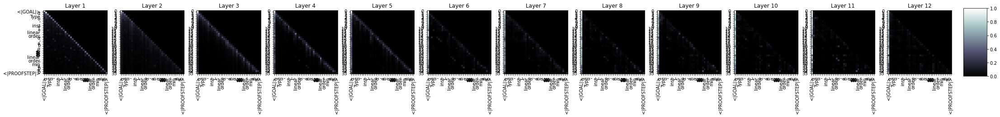

38398it [26:12, 28.70it/s]

  Step 38,400  of  147,271. Loss: 1.437687873840332.   Elapsed: 0:26:13.
Sample:exact min_lt_sub_min.2 a b<|endoftext|><|PROOFSTEP|>exact max_lt_left.2<|endoftext|><|PROOFSTEP|>letI := {← mul_le_right_iff, nat.le_le.2 (lt_left _) }<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>letI := {to_finset := nat.le_succ, mul_le_zero}<|endoftext|><|PROOFSTEP|>simp only [bot.zero_ne_bot, pi_add, zero_ne_bot] at nat.le_succ<|endoftext|><|PROOFSTEP|>exact nat.le_pi_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have : exists_nonempty_of_le subtype.1 (simp_lt_subtype.1.1_apply_instance) 1 (simp_lt_subtype.1.2_apply) := subtype.1.1<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext_eq_one<|endoftext|>
s -> 0.3006000518798828
rw -> 0.24550080299377441
ex -> 0.13612231612205505
apply -> 0.09561611711978912
int -> 0.06451165676116943
cases -> 0.0364067368209362
sim -> 0.0327601432800293
ext -> 0.03056640364229679
re -> 0.030300261452794075
h

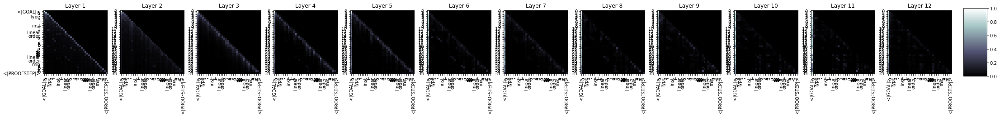

41598it [28:23, 18.98it/s]

  Step 41,600  of  147,271. Loss: 0.699948251247406.   Elapsed: 0:28:23.
Sample:rw [div_div,min_div_left_iff, max_div_iff]<|endoftext|><|PROOFSTEP|>rw [max_eq_top := mk_exists_left_inv]<|endoftext|><|PROOFSTEP|>rintros _ ⟨_, rfl⟩<|endoftext|><|PROOFSTEP|>rw [def, mul_zero_iff]<|endoftext|><|PROOFSTEP|>rintr_right ⟨_, mul_zero_iff_refl⟩<|endoftext|><|PROOFSTEP|>rw [eq_one, one_mul, one_mul]<|endoftext|><|PROOFSTEP|>rw [one_mul, one_mul]<|endoftext|><|PROOFSTEP|>haveh : nonneg (π / 2 * π) := one_mul.1 (2 / 2))<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refine one.nonneg (2 *<|GOAL|>dvd_pos (2 *dvd_dist_of_one 2 1 0) (2 *dvd_pos 2 2 1 0) (2 *dvd_
rw -> 0.344819575548172
s -> 0.28969892859458923
ex -> 0.10403483361005783
apply -> 0.07666746526956558
re -> 0.040029287338256836
int -> 0.03821231424808502
cases -> 0.034264083951711655
ref -> 0.028248963877558708
sim -> 0.023629605770111084
have -> 0.020394910126924515


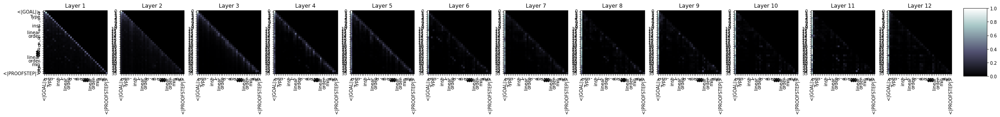

44800it [30:34, 27.23it/s]

  Step 44,800  of  147,271. Loss: 0.7327086329460144.   Elapsed: 0:30:34.
Sample:assume A B c<|endoftext|><|PROOFSTEP|>simp only [lt_iff_lt, coe_inf_iff_coe]<|endoftext|><|PROOFSTEP|>simp only [smul, coe_inf_iff_coe, coe_inf, smul]<|endoftext|><|PROOFSTEP|>simp at * : (totactic.totactic.lt_succ).fst at *<|endoftext|><|PROOFSTEP|>simp.0 at *<|endoftext|><|PROOFSTEP|>apply nat.apply_int (symm)<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>contradiction<|endoftext|><|PROOFSTEP|>s with rfl<|endoftext|><|PROOFSTEP|>rw ← rfl<|endoftext|><|PROOFSTEP|>rw ← le_of_mem<|endoftext|><|PROOFSTEP|>rw ← hd_of_mem<|endoftext|><|PROOFSTEP|>sieve_id<|endoftext|><|PROOFSTEP|>t rfl<|endoftext|><|PROOFSTEP|>rw [← h, ← h, le_of_mem_idt, hd]<|endoftext|><|PROOFSTEP|>sne_of_zero_lt, hd_of_not_lt, with_rfl<|endoftext|><|PROOFSTEP|>
rw -> 0.36978912353515625
s -> 0.3527953326702118
ex -> 0.06968039274215698
apply -> 0.05655388906598091
int -> 0.03779860585927963
re -> 0.027987554669380188
cases -> 0.0239

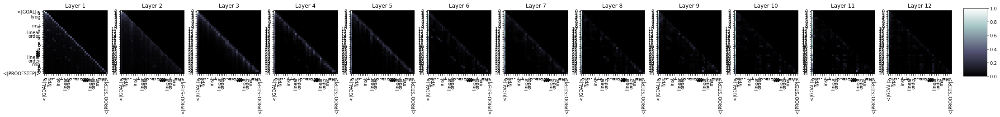

47999it [32:47, 23.13it/s]

  Step 48,000  of  147,271. Loss: 1.5226941108703613.   Elapsed: 0:32:48.
Sample:intros<|endoftext|><|PROOFSTEP|>exact le_iff_or_lt_neg a b<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>rw neg_neg<|endoftext|><|PROOFSTEP|>have := eq_right a<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [Icc.coe_left_iff, Icc.coe_right_iff]<|endoftext|><|PROOFSTEP|>obtain ⟨h, int.coe_eq_zero.1, int.coe_add]<|endoftext|><|PROOFSTEP|>classify : ∀ I, (x : I × I), inv_pos_right ⟨hx, one_mem, xhx⟩<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact hx<|endoftext|><|PROOFSTEP|>by_cases hd : ∀ I := h<|endoftext|><|PROOFSTEP|>simp (λ X : mv_polynomial.ne_of_mem hd)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [← hd.is_add_eq_zero
s -> 0.5744568109512329
rw -> 0.20202943682670593
ex -> 0.05711744353175163
int -> 0.03561035543680191
apply -> 0.03295191377401352
cases -> 0.0287000834941864
re 

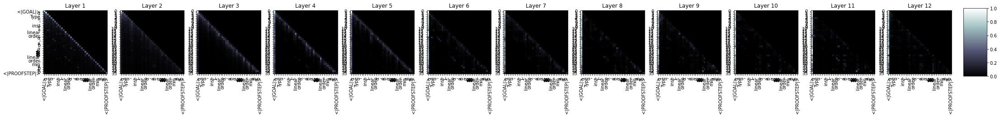

51200it [34:59, 28.98it/s]

  Step 51,200  of  147,271. Loss: 0.887019157409668.   Elapsed: 0:34:59.
Sample:simpa only [←min_add, pow_le_add, zero_lt_one, add_one] using min_top.left_induction b<|endoftext|><|PROOFSTEP|>simp only [div_eq_one]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [inter_pos]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have := a<|endoftext|><|PROOFSTEP|>simp.1<|endoftext|><|PROOFSTEP|>assume { simp := (refl - one).1 }<|endoftext|><|PROOFSTEP|>apply _<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp.1 a b_1<|endoftext|><|PROOFSTEP|>casesrefl<|endoftext|><|PROOFSTEP|>exf<|endoftext|><|PROOFSTEP|>simplex : has_div_nat _<|endoftext|><|PROOFSTEP|>casesrefl {rw }<|endoftext|><|PROOFSTEP|>exact_def! (has_div_nat_of_true.1.1 _ (sub'_eq_div_eq_true))<|endoftext|><|PROOFSTEP|>rw [mul_eq_true.2, mul_eq_
s -> 0.30572858452796936
rw -> 0.27893081307411194
ex -> 0.1481749266386032


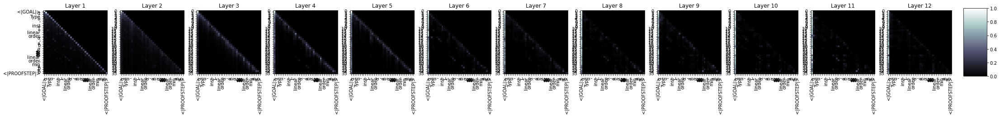

54398it [37:10, 26.12it/s]

  Step 54,400  of  147,271. Loss: 0.671903669834137.   Elapsed: 0:37:11.
Sample:simp only [max_le, min_eq]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [le_of_lt_zero]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>congr h<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance.1 (nat.coe_prod ⊣).1<|endoftext|><|PROOFSTEP|>tidy<|endoftext|><|PROOFSTEP|>rw [← alg_apply_le_subset_iff, alg_apply_lt_lt_coe, ← alg_apply_le_subset_iff]<|endoftext|><|PROOFSTEP|>refine ⟨(1, 2), _, _, nat.coe_prod_id.1 (2, 3)<|endoftext|><|PROOFSTEP|>refine ⟨2, _, nat.coe_prod_id.2 (2, 3)<|endoftext|><|PROOFSTEP|>rw [nat.coe_one, ← nat.coe_prod_id.2, ←
rw -> 0.2683876156806946
s -> 0.2546331286430359
ex -> 0.14494478702545166
apply -> 0.11921720206737518
int -> 0.053901489824056625
have -> 0.04031294584274292
cases -> 0.03725842759013176
re -> 0.03449872508645058
ref -> 0.0284039247781038

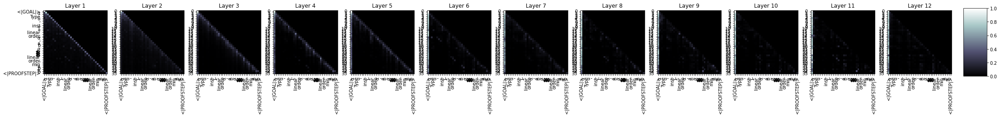

57600it [39:21, 26.03it/s]

  Step 57,600  of  147,271. Loss: 0.9088258147239685.   Elapsed: 0:39:21.
Sample:exact le_bot_iff_nonneg_le<|endoftext|><|PROOFSTEP|>apply le_bot_iff_min_le_left<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>contradiction : ∀ y : nat.def, ← (1 : ℕ)<|endoftext|><|PROOFSTEP|>exact ⟨y, lt_lt_1, hd, hd.right, hd.snd.le, eq_pow_of_le_pow, hl, rfl, rfl, eq_pow_of_le_left, hr, rfl'<|endoftext|><|PROOFSTEP|>refine ⟨y, 1, lt_lt_1, h 2016, rfl, hd.right, hd.snd.le,<|endoftext|><|PROOFSTEP|>apply_instance_eq_of_eq_of_sub_pos<|endoftext|><|PROOFSTEP|>apply_instance_eq_of_sub_pos<|endoftext|><|PROOFSTEP|>apply_
s -> 0.2966182231903076
rw -> 0.2754264175891876
ex -> 0.1542484611272812
apply -> 0.10000240057706833
int -> 0.03958135470747948
re -> 0.031347401440143585
ref -> 0.028735503554344177
have -> 0.028632592409849167
cases -> 0.023015623912215233
sim -> 0.022392040118575096


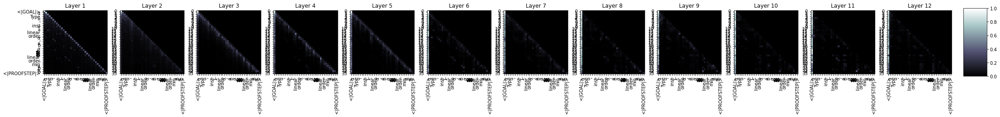

60798it [41:35, 26.14it/s]

  Step 60,800  of  147,271. Loss: 0.7233009338378906.   Elapsed: 0:41:35.
Sample:exact min_div_lt' a<|endoftext|><|PROOFSTEP|>apply le_antisymm<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact le_one<|endoftext|><|PROOFSTEP|>split_succ_of_mem<|endoftext|><|PROOFSTEP|>exact le_le<|endoftext|><|PROOFSTEP|>t_le_sub_one<|endoftext|><|PROOFSTEP|>simp [2]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>simp_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_class_eq'<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>exists_iff<|endoftext|>I_ltI_eq_some<|endoftext|><|PROOFSTEP|>ext (tas gt)<|endoftext|><|PROOFSTEP|>s1<|endoftext|><|PROOFSTEP|>have h1<|endoftext|>Union<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>rw (has_ltI_iff_le<|endoftext|>t1_left _ _<|endoftext|><|PROOFSTEP|>rw ←<|endoftext|><|PROOFSTEP|>split_succ<|endoftext|><|PROOFSTEP|>snd<|endoftext|><|PROOFSTEP|>rw [_univ_

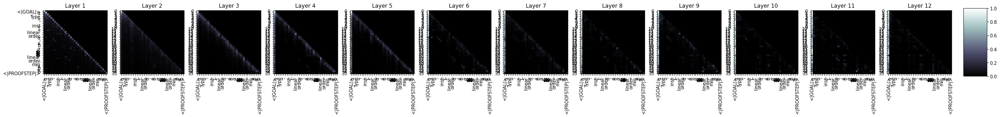

64000it [43:47, 23.21it/s]

  Step 64,000  of  147,271. Loss: 1.0024917125701904.   Elapsed: 0:43:48.
Sample:assume h<|endoftext|><|PROOFSTEP|>have := mul_le_or_iff (basis α) (ne_of_gt a)<|endoftext|><|PROOFSTEP|>convert le_bot.trans (basis α))<|endoftext|><|PROOFSTEP|>ext x y<|endoftext|><|PROOFSTEP|>congr<|endoftext|><|PROOFSTEP|>rw [← not_iff_coe, ← neg_iff_not_not, not_cancel_eq_neg, (coe_not_right y)<|endoftext|><|PROOFSTEP|>assume : (pow_coe_ne y).symm, _<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact_le_add_of_mem (le_one_of_lt_coe at h<|endoftext|><|PROOFSTEP|>apply_mem<|endoftext|><|PROOFSTEP|>s_of_eq : ∀ x_pos_nhds, x_pos_nhds<|endoftext|><|PROOFSTEP|>apply_mem_left hx<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s : nat.elim (0 : _) = 0, ∥0, 0<|endoftext|><|PROOFSTEP|>
rw -> 0.3271947205066681
s -> 0.2582332193851471
ex -> 0.1735578328371048
apply -> 0.06336985528469086
cases -> 0.042362555861473083
re -> 0.0337262898683548
have -> 0.029830751940608025
int -> 0.028579814359545708

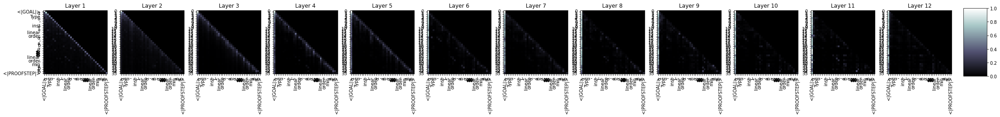

67200it [46:00, 18.93it/s]

  Step 67,200  of  147,271. Loss: 1.2306641340255737.   Elapsed: 0:46:01.
Sample:rcases (le.iff_le_zero.2 a b) with ⟨l₁₁, l₂₂₁⟩<|endoftext|><|PROOFSTEP|>rw [← min_le_iff_neg, min_eq_one_iff_neg]<|endoftext|><|PROOFSTEP|>rw [← pow_neg, min_eq_one_iff]<|endoftext|><|PROOFSTEP|>intros, ne, ← intros a b, ← intros b ha<|endoftext|><|PROOFSTEP|>rw [mul_apply_intros_div, pow_apply_intros_div, mul_apply_ind_le, mul_apply_ind_le, intros_div_ind_le, intros_ind, pow_const, nsmul_left, nat.min_div_lt_ne]<|endoftext|><|PROOFSTEP|>rw [neg_neg, mul_neg]<|endoftext|><|PROOFSTEP|>rw [mul_apply_neg_right,
s -> 0.30913567543029785
rw -> 0.30606725811958313
ex -> 0.14797057211399078
apply -> 0.06840077042579651
int -> 0.03342558071017265
re -> 0.03118526004254818
have -> 0.0298435240983963
cases -> 0.029071517288684845
ref -> 0.023719653487205505
sim -> 0.02118023671209812


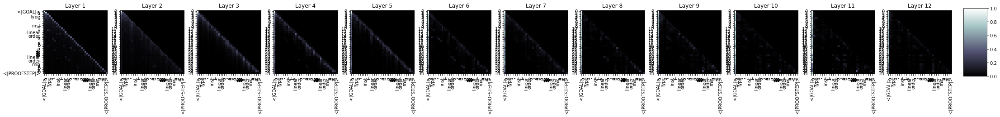

70400it [48:13, 27.47it/s]

  Step 70,400  of  147,271. Loss: 1.086358904838562.   Elapsed: 0:48:14.
Sample:exact_mod_distrib (le_max_of_le a b)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have := le_sub<|endoftext|><|PROOFSTEP|>apply_mem<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_bot<|endoftext|><|PROOFSTEP|>rc ←<|endoftext|><|PROOFSTEP|>tactic_nhds<|endoftext|><|PROOFSTEP|>rintro y<|endoftext|><|PROOFSTEP|>rw [mem_refl, rfl, mv_refl]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>intype<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>apply_self<|endoftext|>mem_right<|endoftext|>refl<|endoftext|><|PROOFSTEP|>s :=<|endoftext|>(one_le_one_ne_one.1)<|endoftext|><|PROOFSTEP|>rw [ne_one_ne_one.1 _, hone_ne_one]<|endoftext|><|PROOFSTEP|>by (finset.one.0)<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>rw at one_le_one_ne_one.1<|endoftext|><|PROOFSTEP|>simp_iff<|endof

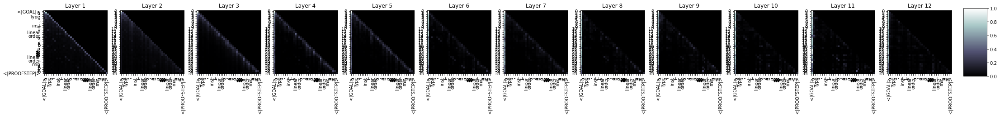

73598it [50:26, 28.18it/s]

  Step 73,600  of  147,271. Loss: 0.922890841960907.   Elapsed: 0:50:26.
Sample:try {refl}<|endoftext|><|PROOFSTEP|>try {refl}<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>have := tl : nat.preimage.preimage_nat_of_preimage<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp only [image_preimage]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>cases le_const<|endoftext|><|PROOFSTEP|>exists_mem_preimage<|endoftext|><|PROOFSTEP|>have := is_mem<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance_def<|endoftext|><|PROOFSTEP|>apply_image_of_le_of_le (inverse.image_le_of_left_of_le (le_inverse.le_of_lt_iff.1))<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [image_mem_preimage, hym_preimage, image_comp, hym_comp, image_preimage_iff, (le_of_lt_iff.1)))<|endoftext|><|PROOFSTEP|>rw [pre
s -> 0.42406174540519714
rw -> 0.167153

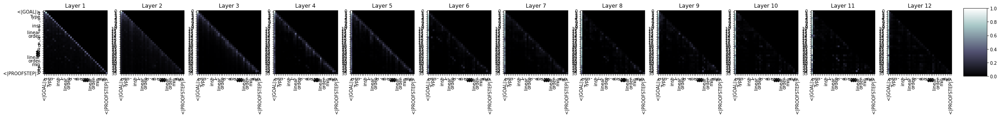

76800it [52:38, 29.35it/s]

  Step 76,800  of  147,271. Loss: 1.3000829219818115.   Elapsed: 0:52:39.
Sample:exact min_div_le_of_pos (le_iff_le a b)<|endoftext|><|PROOFSTEP|>simp only [mul_comm]<|endoftext|><|PROOFSTEP|>simp_rw [finset.mem_iff_eq_coe]<|endoftext|><|PROOFSTEP|>simp_rw [image_mem]<|endoftext|><|PROOFSTEP|>simp_rw [image_mem]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_eq<|endoftext|><|PROOFSTEP|>change_div_of_le, _ (le_of_le)<|endoftext|><|PROOFSTEP|>have IH : ∑1, not_nonneg.ne, ∀.le_nonneg, ∑2, le_nonneg.ne (le_le_iff_iff_ne.2)<|endoftext|><|PROOFSTEP|>try {mul})<|endoftext|><|PROOFSTEP|>apply_instance :=<|endoftext|><|PROOFSTEP|>simp_right<|endoftext|><|PROOFSTEP|>by_cases<|endoftext|><|PROOFSTEP|>exact_lt<|endoftext|><|PROOFSTEP|>exact_left (not_iff.2)<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>intros<|endoftext|>
s -> 0.2990936040878296
rw -> 0.22551032900810242
ex -> 0.1480454057455063
apply -> 0.12471643835306168
cases -> 0.052956435829401016
have -> 0.

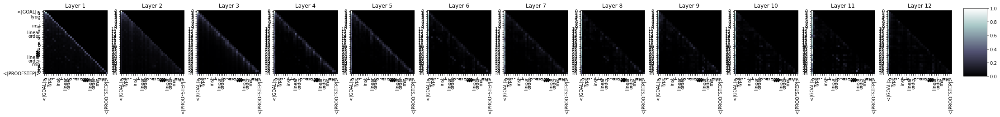

79997it [54:50, 24.90it/s]

  Step 80,000  of  147,271. Loss: 1.135868787765503.   Elapsed: 0:54:50.
Sample:simp_rw [lt_iff_le_le', min_neg]<|endoftext|><|PROOFSTEP|>tactic.pi_instance_derive_field<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>exact is_true_not_lt<|endoftext|><|PROOFSTEP|>exact is_true_not_lt<|endoftext|><|PROOFSTEP|>ext nat.lt_iff.2 0 is_true_not_lt<|endoftext|><|PROOFSTEP|>rw [lt_iff.2_nat.1]<|endoftext|><|PROOFSTEP|>rw [lt.1.1, $0, nat.1.0_iff_zero]<|endoftext|><|PROOFSTEP|>exact_inj_self (nat.2.le_zero.1 (iff_self.2_eq_zero_iff.2_nat) (lt.2.ne_zero).2)<|endoftext|><|PROOFSTEP|>rw [← eq_self, @ne_zero, nat.2.lt_eq_zero]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp
s -> 0.4295341968536377
rw -> 0.2041475474834442
ex -> 0.11117742955684662
apply -> 0.08699428290128708
cases -> 0.04369719326496124
int -> 0.03480277210474014
have -> 0.031569138169288635
ref -> 0.02139316312968731
re -> 0.02119807

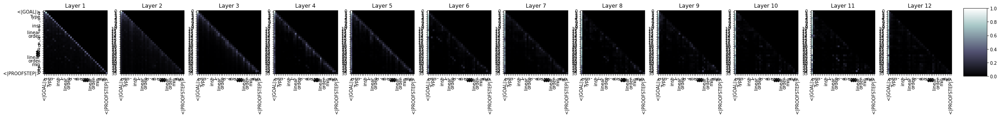

83200it [57:04, 25.03it/s]

  Step 83,200  of  147,271. Loss: 0.6862934827804565.   Elapsed: 0:57:04.
Sample:ext<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>simp only [iff, sub_zero]<|endoftext|><|PROOFSTEP|>simp at *<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rcases rfl with ⟨x, y' ⟨y', hr⟩<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact (one_le {le_zero_of_right_iff_not_not_le} _).1.2 (not_le _)<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>simp H<|endoftext|><|PROOFSTEP|>apply1<|endoftext|><|PROOFSTEP|>refine ⟨_⟨_⟩<|endoftext|><|PROOFSTEP|>by<|endoftext|>I1 (← one_le.1_inv (← h1.2 _).2) (right_le, one_le)<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>dvd<|endoftext|><|PROOFSTEP|>simp at rfl<|endoftext|><|PROOFSTEP|>try hdvd<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>
s -> 0.336043506860

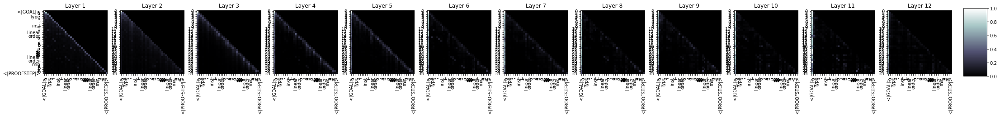

86399it [59:14, 27.27it/s]

  Step 86,400  of  147,271. Loss: 1.7794665098190308.   Elapsed: 0:59:14.
Sample:rw [min_le_min, max_le_max]<|endoftext|><|PROOFSTEP|>right<|endoftext|><|PROOFSTEP|>intros_1 1<|endoftext|><|PROOFSTEP|>simp [sub]<|endoftext|><|PROOFSTEP|>induction_nth_left<|endoftext|><|PROOFSTEP|>simp nth_add_of_ne_zero hf1 hf1<|endoftext|><|PROOFSTEP|>by_contradiction<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance.tidy_of_zero_lt_simp.1<|endoftext|><|PROOFSTEP|>rintros b with a<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp.1<|endoftext|><|PROOFSTEP|>apply_instance_right<|endoftext|><|PROOFSTEP|>tidy<|endoftext|><|PROOFSTEP|>simp_1<|endoftext|><|PROOFSTEP|>apply_instance.1<|endoftext|><|PROOFSTEP|>use (2:ne_zero) with (univ (le_one<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>rintros<|endoftext|><|PROOFSTEP|>ref

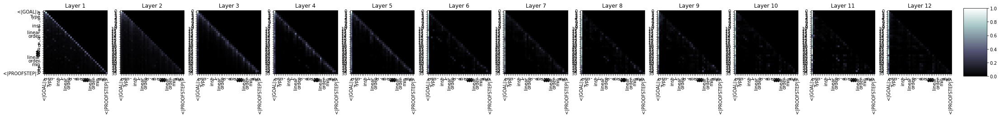

89599it [1:01:25, 24.20it/s]

  Step 89,600  of  147,271. Loss: 1.0544800758361816.   Elapsed: 1:01:25.
Sample:simp only [lt_or_lt,max_max, neg_le_neg,min_le_max, sup_le_neg, pow_div_eq]<|endoftext|><|PROOFSTEP|>simp_rw mem_def<|endoftext|><|PROOFSTEP|>simp at H.<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp_mem_is_lt<|endoftext|><|PROOFSTEP|>simpa [mem_mem, eq_comm, mem_eq_of_iff]<|endoftext|><|PROOFSTEP|>ext1 [eq_eq_iff]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_eq_mem_is_lt<|endoftext|><|PROOFSTEP|>haveI := le_iff_true<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_eq_true_left<|endoftext|><|PROOFSTEP|>mul_left<|endoftext|><|PROOFSTEP|>apply_eq_true_left<|endoftext|><|PROOFSTEP|>simp_one<|endoftext|><|PROOFSTEP|>exists_const_simp_one<|endoftext|><|PROOFSTEP|>bydefault<|endoftext|><|PROOFSTEP|>norm_zero_left<|endoftext|><|PROOFSTEP|>apply_symm,<|endoftext|><|PROOFSTEP|>exists_
s -> 0.4403999149799347
rw -> 0

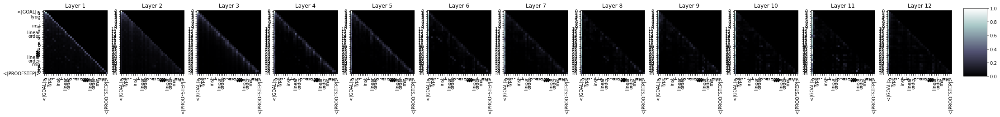

92798it [1:03:37, 28.67it/s]

  Step 92,800  of  147,271. Loss: 0.9071412086486816.   Elapsed: 1:03:37.
Sample:rw [max_comm, min_comm', min_div']<|endoftext|><|PROOFSTEP|>convert max_inv _ _ _ (max_inv_nat_le _ _ _ _)<|endoftext|><|PROOFSTEP|>repeat {convert ne_one}<|endoftext|><|PROOFSTEP|>have : a < 0 := int.mem_zero ht<|endoftext|><|PROOFSTEP|>have : nat.le_of_lt (le_of_lt _ _) (0 ^ 0, not_or_not)<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>ext1<|endoftext|><|PROOFSTEP|>split_iff<|endoftext|><|PROOFSTEP|>rw [mem_zero, ht_zero]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>cases_right<|endoftext|><|PROOFSTEP|>rint_coe : (left_not_iff_false _).1 (mem_zero : (left_not_iff_false _).1).1) : ↥cases_eq_right (le : false), by h<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>assume IH<|endoftext|><|PROOFSTEP|>have : set.not_nonempty
s -> 0.42267391085624695
rw -> 0.24157854914665222
ex -> 0.09454868733882904
apply -> 0.06207078695297241
cases -> 0.055701907724142075
have -> 

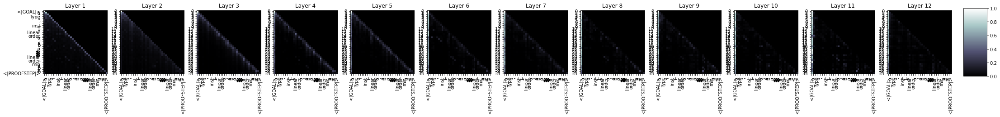

96000it [1:05:49, 26.73it/s]

  Step 96,000  of  147,271. Loss: 1.8555169105529785.   Elapsed: 1:05:49.
Sample:simp [le_cancel_left]<|endoftext|><|PROOFSTEP|>simp [le_cancel_right]<|endoftext|><|PROOFSTEP|>simp [le_cancel_top]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [top]<|endoftext|><|PROOFSTEP|>simp [top]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_ne_top<|endoftext|><|PROOFSTEP|>exact and<|endoftext|><|PROOFSTEP|>simp_zero<|endoftext|><|PROOFSTEP|>rw ←<|endoftext|><|PROOFSTEP|>simp_eq<|endoftext|>p_div_eq<|endoftext|>1<|endoftext|><|PROOFSTEP|>by_cases_div<|endoftext|>A B : ⟨1, 1, 2, 2, 3, 3, 4, 4, 5, 6, 7, 4⟩ : ↚, [1, 1, 2, 3, 6, 2, 2, 3, 4, 5, 6,5,6,7,10,7,10,10M,B⟩<|endoftext|><|PROOFSTEP|>simp_preimage<|endoftext|><|PROOFSTEP|>exact preimage<|endoftext|><|PROOFSTEP|>exact preimage_
s -> 0.42976605892181396
rw -> 0.23812788724899292
ex -> 0.08178826421499252
apply -> 0.07825770229101181
have -> 0.04777505621314049
cases -> 0.04179360345005989
int -> 0.029373912140727043
re 

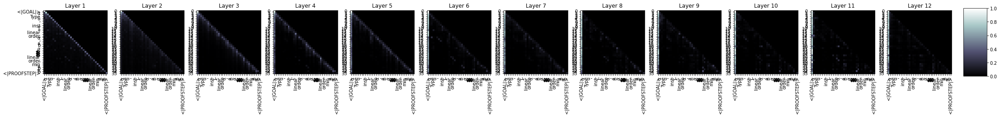

99200it [1:07:58, 24.65it/s]

  Step 99,200  of  147,271. Loss: 1.4203550815582275.   Elapsed: 1:07:59.
Sample:simp [mul_add_left_cancel a, min_of_neg a b]<|endoftext|><|PROOFSTEP|>exact le_iff.2<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintro ⟨⟩<|endoftext|><|PROOFSTEP|>simp [int.cast_eq_zero, int.cast_eq_one, int.cast_eq_zero]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rcases int.cast_eq_0.1 with ⟨_, _⟩<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw [mem_eq_zero, ← mem_zero, exact_zero, eq_zero.3]<|endoftext|><|PROOFSTEP|>subtype_eq_zero, h.symm, rfl<|endoftext|><|PROOFSTEP|>rw int.symm<|endoftext|><|PROOFSTEP|>subtype_neg<|endoftext|><|PROOFSTEP|>s := subtype_neg<|endoftext|><|PROOFSTEP|>exists : subtype_not_le'<|endoftext|><|PROOFSTEP|>rw subtype.iff_subtype_not_le<|endoftext|>
s -> 0.3873113691806793
apply -> 0.13712215423583984
rw -> 0.13409577310085297
ex -> 0.13258256018161774
have -> 0.05273961275815964
cases -> 0.0458539240062236

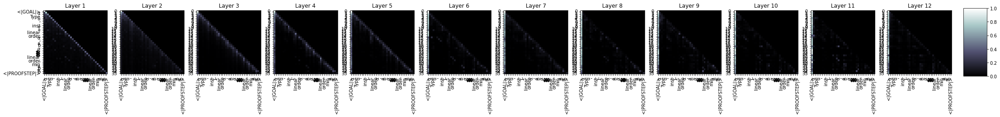

102399it [1:10:10, 27.36it/s]

  Step 102,400  of  147,271. Loss: 0.7733052372932434.   Elapsed: 1:10:10.
Sample:simp only [min_eq_lt_min, min_iff_above]<|endoftext|><|PROOFSTEP|>haveI : has_sum α := sum.mk_le<|endoftext|><|PROOFSTEP|>contradiction<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>associates_of_le<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simpa [le_const, or_iff] using is_law.of_le (le_const, le_iff_iff_orow_iff)<|endoftext|><|PROOFSTEP|>exists_le_iff_iff_santisymm<|endoftext|><|PROOFSTEP|>exists_le_iff<|endoftext|><|PROOFSTEP|>santisymm<|endoftext|><|PROOFSTEP|>use_right<|endoftext|><|PROOFSTEP|>try {to_lhs, by_contradiction}<|endoftext|><|PROOFSTEP|>exists_le_iff_orow<|endoftext|><|PROOFSTEP|>exists_one_right_right h, by_contradiction<|endoftext|><|PROOFSTEP|>rw [←le_prod
s -> 0.5079821944236755
rw -> 0.205920144

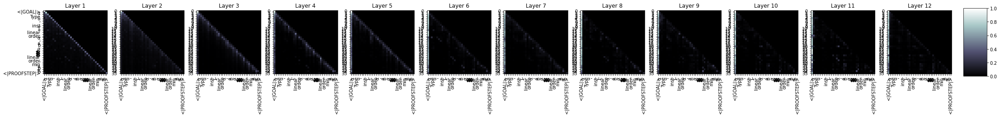

105598it [1:12:20, 25.66it/s]

  Step 105,600  of  147,271. Loss: 0.9352059960365295.   Elapsed: 1:12:20.
Sample:haveI := le_trans (max_le_max_max_le _)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw [←_]<|endoftext|><|PROOFSTEP|>sub_zero at zero.lt<|endoftext|><|PROOFSTEP|>simp [zero_of_pos]<|endoftext|><|PROOFSTEP|>sub_zero<|endoftext|><|PROOFSTEP|>simp_restrict<|endoftext|><|PROOFSTEP|>left<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw at bernstein<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>t_iff<|endoftext|><|PROOFSTEP|>apply_left<|endoftext|>sub_top_div<|endoftext|>⊢<|endoftext|><|PROOFSTEP|>rintros<|endoftext|>n<|endoftext|><|PROOFSTEP|>refl<|endoftext|>←dvd<|endoftext|>by<|endoftext|>S : ∀ (n : ℕ), n.snd = 2.dvd n.snd.snd<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rintrosn<|endoftext|><|PROOFSTEP|>rcases (s_rfl)<|endoftext|><|PROOFSTEP|>snd<|endoftext|><|PROOFSTEP|>snd<|endoftext|><|

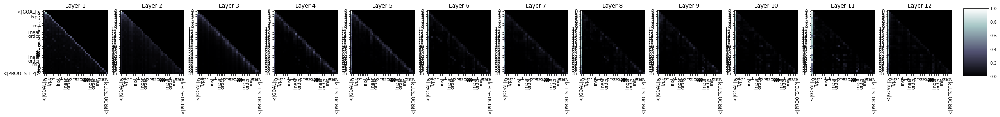

108800it [1:14:31, 29.20it/s]

  Step 108,800  of  147,271. Loss: 0.8234568238258362.   Elapsed: 1:14:32.
Sample:simpa only [←min_sub_eq_max_left_bot, max_le_iff_le] using max_le_bot ⟨b, hab⟩<|endoftext|><|PROOFSTEP|>exact int.elim ((max_le_bot ⟨a, hab⟩).elim.elim)<|endoftext|><|PROOFSTEP|>cases $ : ⟨a, hab⟩ hab<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [div_def]<|endoftext|><|PROOFSTEP|>rw [div_def]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have := apply_instance<|endoftext|><|PROOFSTEP|>exact_instance<|endoftext|><|PROOFSTEP|>ext1<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>simp_apply_instance<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>s<|endoftext|><|PROOFSTEP|>have<|endoftext|>x_ne_top<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>simp_eq.1.2<|endoftext|><|PROOFSTEP|>simp_eq.2.1 one_ne_top (
rw -> 0.3395887017250061
s -> 0.311823308467865
ex -> 0.1109772

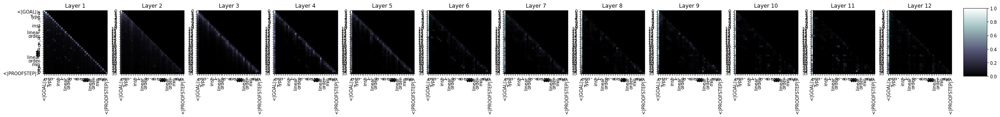

111999it [1:16:44, 25.17it/s]

  Step 112,000  of  147,271. Loss: 1.2089909315109253.   Elapsed: 1:16:44.
Sample:simp only [max_le, max_le, min_le]<|endoftext|><|PROOFSTEP|>simp only [← coe_max]<|endoftext|><|PROOFSTEP|>apply eq_of_sup_eq_self<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw {b : subtype nat.succ_eq_zero.1 (a' b)]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintros hb with j hab<|endoftext|><|PROOFSTEP|>t<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp only (b : cau_seq_eq_zero {cau_cancel_eq_some} ne {b : ↥) },<|endoftext|><|PROOFSTEP|>exact.1 (cau_cancel_eq_one ne cau_cancel_one cau_a' with b hb, hb hb, hb.2 with hab hb, hb.3<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact_right<|endoftext|><|PROOFSTEP|>
s -> 0.4431154131889343
rw -> 0.22800666093826294
ex -> 0.08968502283096313
cases -> 0.05923522636294365
apply -> 0.05627866089344025
int -> 0.03595821559429169
ha

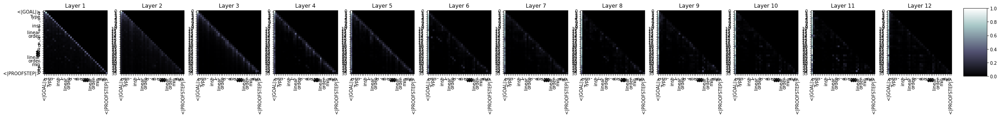

115199it [1:18:57, 26.23it/s]

  Step 115,200  of  147,271. Loss: 2.0207231044769287.   Elapsed: 1:18:57.
Sample:simp [min_comm]<|endoftext|><|PROOFSTEP|>simpa only [← if_pos bool.ff, (zero_le_true).elim.trans]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_def<|endoftext|><|PROOFSTEP|>apply_iff_of course_zero<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refine @iff_lt_trans _ {rx := nat.elim (1 : ∀ (x : ℕ), ⟨x, _x₁, _⟩}, 1 = (1 : ∀ (m n : ℕ), _1.trans n), 2 = m n ↔ (2.refl).trans_ne 0 n<|endoftext|><|PROOFSTEP|>rw {b : ℕ | b0 : ℕ | b0.trans_eq b⟩}<|endoftext|><|PROOFSTEP|>tidy_rpow {left := tidy_mul_right, right := mul_trans, or_self},
s -> 0.48928719758987427
rw -> 0.20103682577610016
ex -> 0.0812104195356369
cases -> 0.05487357825040817
apply -> 0.04799770563840866
have -> 0.039447057992219925
int -> 0.030666254460811615
re -> 0.025306185707449913
split -> 0.015621528029441833
sim -> 0.014553230255842209


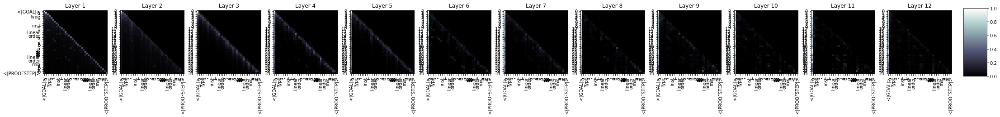

118399it [1:21:08, 22.66it/s]

  Step 118,400  of  147,271. Loss: 0.6597028374671936.   Elapsed: 1:21:09.
Sample:simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>split_le<|endoftext|><|PROOFSTEP|>simp [← le_antisymm]<|endoftext|><|PROOFSTEP|>by_cases h1 : has_compl<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>simp [← mul_eq_le_div_left, one_div_mul, mul_eq_div]<|endoftext|><|PROOFSTEP|>simp.1 {simp }<|endoftext|><|PROOFSTEP|>simp : inv ← inv_left_right (simp.1 _)<|endoftext|><|PROOFSTEP|>simp.2 {convert inv_eq_one_div_le, inv_sub_cancel, one_div_le_left, mul_right_right_eq_one_div_left, mul_assoc, inv_left_right_symm}<|endoftext|><|PROOFSTEP|>show (h : fpow_coe_eq_one_div_le, nat.sub_cancel_induction<|endoftext|><|PROOFSTEP|>use h<|endoftext|><|PROOFSTEP|>cases h1 :
s -> 0.347455769777298
rw -> 0.2646538019180298
ex -> 0.1186622604727745
apply -> 0.07220370322465897
cases -> 0.05016987398266792
have -> 0.04725039377808571
re -> 0.03341715410351753
int -> 0.03178861737251282
split -> 0.019975809

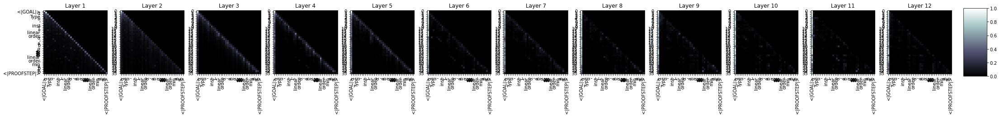

121600it [1:23:18, 24.63it/s]

  Step 121,600  of  147,271. Loss: 0.7140508890151978.   Elapsed: 1:23:19.
Sample:exact min_le_min_above (le_max_of_le b)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [← prod_eq_zero, ← sub_zero, ← sub_zero]<|endoftext|><|PROOFSTEP|>exact subzero.is_subtype.czero<|endoftext|><|PROOFSTEP|>cases h at h<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp only [symm_of_lt_lt_1, ne_of_lt_eq]<|endoftext|><|PROOFSTEP|>simpa [iff_one]<|endoftext|><|PROOFSTEP|>from λ x, id y x<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>exists_simp<|endoftext|><|PROOFSTEP|>rw sup1_iff_succ_of_sub set.one x<|endoftext|><|PROOFSTEP|>ds_zero_iff_succ<|endoftext|><|PROOFSTEP|>rw ←simp<|endoftext|><|PROOFSTEP|>by_contradiction h<|endoftext|><|PROOFSTEP|>refine refl.subset_one_of_symm<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>let_su
s -> 0.3780486285686493
rw -> 0.2839701175689697
ex -> 0.09976772218942642
apply -> 0.06718

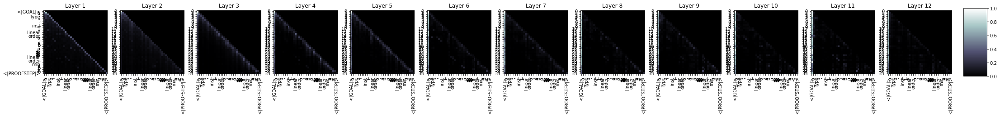

124799it [1:25:28, 28.19it/s]

  Step 124,800  of  147,271. Loss: 0.7094728350639343.   Elapsed: 1:25:28.
Sample:split<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw [← int.def, ← int.eq_one_iff]<|endoftext|><|PROOFSTEP|>rw [ne_iff.iff_of_le]<|endoftext|><|PROOFSTEP|>assumely!<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [← gp_def, gp_def, gp_def]<|endoftext|><|PROOFSTEP|>simp_rw [← gp_def, int.comm, int.comm, int.le, int.right_eq_eq]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>t<|endoftext|><|PROOFSTEP|>let _ = {a : ℕ | x a}<|endoftext|><|PROOFSTEP|>change ⟨, _, _, _, _⟩<|endoftext|><|PROOFSTEP|>rw int.le, ← int.ne_bot, ← nnreal.eq_bot [nat_pos_rpow', eq_bot_pos]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw sub_of_one_mem<|endoftext|><|PROOFSTEP|>
rw -> 0.331461638212204
s -> 0.299749493598938
ex -> 0.11539675295352936
int -> 0.05582629144191742
apply -> 0.050133880227804184
cases -> 0.04679431393742561
have -> 0.03474050760269165
re -> 0.030133375

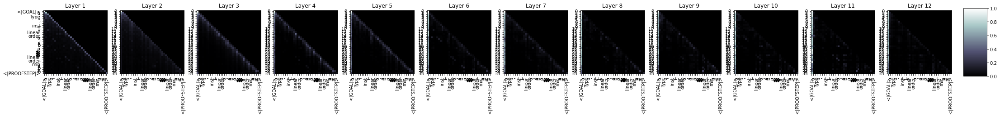

127998it [1:27:39, 25.88it/s]

  Step 128,000  of  147,271. Loss: 1.5761443376541138.   Elapsed: 1:27:39.
Sample:rw [min_le_iff, min_lt_iff, neg_left_iff]<|endoftext|><|PROOFSTEP|>have I : linear_order α := basis.of_alg_succ_lt_iff ⟨x, hx⟩ hx⟩<|endoftext|><|PROOFSTEP|>rw [←le_iff, le_iff_lt]<|endoftext|><|PROOFSTEP|>refine lt_of_pos_of_lt (le_of_lt _) ((pos_of_lt _).symm) (eq_or_lt _)<|endoftext|><|PROOFSTEP|>simp only [←le_iff_lt, _, le_iff_eq_iff_le, le_iff_eq_iff_iff_iff_iff_iff_iff_iff_iff_iff_iff_iff_iff_iff_eeee_le]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rwa [←mul_sup_self]<|endoftext|><|PROOFSTEP|>simp at this
rw -> 0.27016308903694153
s -> 0.21897092461585999
ex -> 0.1901422142982483
cases -> 0.07654021680355072
int -> 0.07045798003673553
apply -> 0.053786661475896835
have -> 0.04331229254603386
re -> 0.031735554337501526
ref -> 0.026680469512939453
split -> 0.01821064203977585


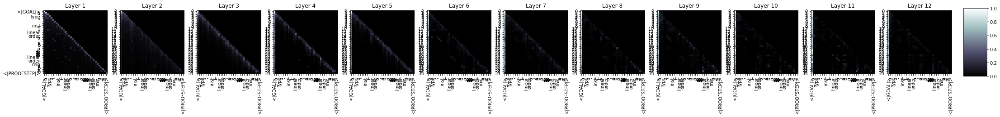

131200it [1:29:50, 27.67it/s]

  Step 131,200  of  147,271. Loss: 1.4449483156204224.   Elapsed: 1:29:50.
Sample:exact min_le_max a _<|endoftext|><|PROOFSTEP|>exact max_le_max_left _<|endoftext|><|PROOFSTEP|>simp [le]<|endoftext|><|PROOFSTEP|>exact add_le_max_right<|endoftext|><|PROOFSTEP|>simp 2nd_eq_right_of_mem<|endoftext|><|PROOFSTEP|>have I : x y z h z : ℓ := le_one.1 h<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have : ↑y ℓ := le_one.1 h<|endoftext|><|PROOFSTEP|>rw ← h : y<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>try {cases eq, h}<|endoftext|><|PROOFSTEP|>rw le_inter_iff_le.1<|endoftext|><|PROOFSTEP|>rw le_inter_iff_le_left<|endoftext|><|PROOFSTEP|>exists_eq.1 a b<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>cases {s // _ := _ _}<|endoftext|><|PROOFSTEP|>simp_restrict (a)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have at<|endoftext|><|PROOFS

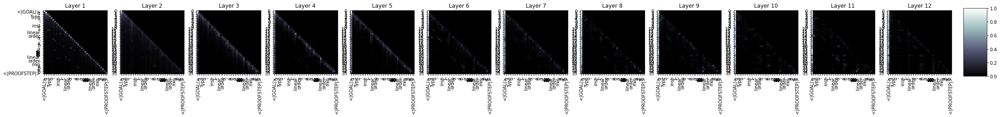

134400it [1:32:01, 25.74it/s]

  Step 134,400  of  147,271. Loss: 0.8739766478538513.   Elapsed: 1:32:02.
Sample:obtain ⟨l⟩ := min_sub_lt_max_of_lta l⟩<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simpa using rf_lt_of_nonpos_of_nonpos<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw hx<|endoftext|><|PROOFSTEP|>rw [le_antisymm, mul_le_le]<|endoftext|><|PROOFSTEP|>ext.ext h<|endoftext|><|PROOFSTEP|>by<|endoftext|><|PROOFSTEP|>contradiction<|endoftext|><|PROOFSTEP|>simp [mul_add_right]<|endoftext|><|PROOFSTEP|>exact_apply<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>cases _ with_bot.1 _<|endoftext|><|PROOFSTEP|>cases _ with enough is a<|endoftext|><|PROOFSTEP|>simpa_left_of_exists<|endoftext|><|PROOFSTEP|>apply_inj<|endoftext|><|PROOFSTEP|>simp (1 :<|endoftext|><|PROOFSTEP|>t1 h1)<|endoftext|><|PROOFSTEP|>rw t1<|endoftext|><|PROOFSTEP|>simp.1<|endoftext|><|PROOFSTEP|>simp (1 :

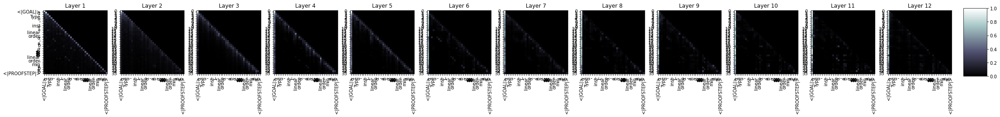

137598it [1:34:13, 25.25it/s]

  Step 137,600  of  147,271. Loss: 0.9451993703842163.   Elapsed: 1:34:14.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>ring<|endoftext|><|PROOFSTEP|>rcases rfl with ⟨d, hd₁, rfl⟩<|endoftext|><|PROOFSTEP|>exact ⟨d, rfl⟩<|endoftext|><|PROOFSTEP|>exact @tensor_coyoneda _ dvd_eq_nil.mpr _ _ _<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>by_cases ht' : ∑ b : ℕ, b ∣ b, ∑ a hb := (2 : ℕ), ⟨b, bp<|endoftext|><|PROOFSTEP|>induction c s.to_nat bs.to_nat cs, fpinduction bs.to_nat := (2 : ℕ)<|endoftext|><|PROOFSTEP|>exact ⟨b, bpinduction (s.to_nnreal 2)<|endoftext|><|PROOFSTEP|>exact sub_eq_of_cau
rw -> 0.31514087319374084
s -> 0.25336894392967224
ex -> 0.1389455944299698
apply -> 0.11691022664308548
have -> 0.0464777797460556
int -> 0.03954582288861275
cases -> 0.03318046033382416
re -> 0.027850136160850525
ref -> 0.01502534095197916
ext -> 0.013554858975112438


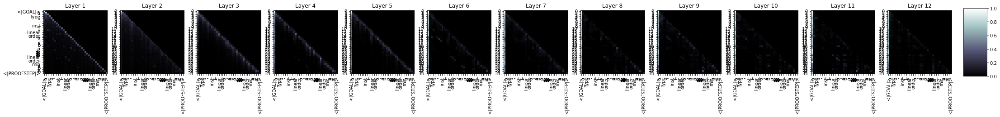

140798it [1:36:25, 23.64it/s]

  Step 140,800  of  147,271. Loss: 1.148423433303833.   Elapsed: 1:36:26.
Sample:rw min_le_min_of_eq at b<|endoftext|><|PROOFSTEP|>try {cases a} {cases b}<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>obtain ⟨�, Hn, hn⟩ := (h_le_inj_le.2 Hn $ Hn.refl).2<|endoftext|><|PROOFSTEP|>split_ifs with h.2<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [one_eq_one_eq_one, rfl]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_one<|endoftext|><|PROOFSTEP|>apply_instance_def<|endoftext|><|PROOFSTEP|>have h1 with h2<|endoftext|>I : ∀ {x : xs_one_ne_top}, ⊥ := top_eq_top_iff.mpr h1<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>cases, exact<|endoftext|><|PROOFSTEP|>have : 1 ∀ 1 = 1<|endoftext|><|PROOFSTEP|>rc_pos at eu<|endoftext|><|PROOFSTEP|>cases with a
rw -> 0.3763054609298706
s -> 0.2301858514547348
ex -> 0.14119531214237213
apply -> 0.0907474011182785
cases -> 0.037

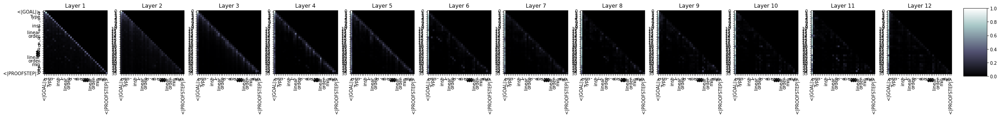

143998it [1:38:35, 20.90it/s]

  Step 144,000  of  147,271. Loss: 0.8955093026161194.   Elapsed: 1:38:35.
Sample:rw [le_of_lt_iff, min_lt_left, max_le]<|endoftext|><|PROOFSTEP|>push_neg at le_top<|endoftext|><|PROOFSTEP|>simp only [←←sup_cancel, ←sup_cancel, ←sup_cancel, ←succ_eq_top, ←succ_right, ←succ_div]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simpa using one_lt_one_div_mul_eq_top<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw top_ne_one_one<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>by simpa [←div_eq_top, top_eq_top] using one_mul<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>use {rw {x}<|endoftext|><|PROOFSTEP|>apply_def | one_lt_top, [comp]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>right_right<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_mem_pow 1 : ∀
s -> 0.36823245882987976
rw -> 0.3313499391078949
ex -> 0.08716461062431335
apply -> 0.06135018542408943
int -> 0.040625400841236115
re -> 0.0354810394346714
cases -> 0.028034158

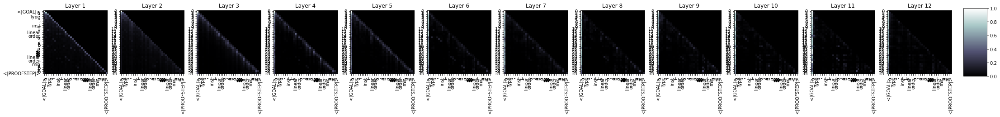

147199it [1:40:48, 26.17it/s]

  Step 147,200  of  147,271. Loss: 0.5837607979774475.   Elapsed: 1:40:48.
Sample:exact max_neg_lt_max<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp * : decidable_eq_of_le<|endoftext|><|PROOFSTEP|>intros x<|endoftext|><|PROOFSTEP|>simp_apply<|endoftext|><|PROOFSTEP|>by_cases {b} {b} {b}<|endoftext|><|PROOFSTEP|>have := hb<|endoftext|><|PROOFSTEP|>cases {b} ⊢ _<|endoftext|><|PROOFSTEP|>try {cases a}<|endoftext|><|PROOFSTEP|>apply_fun_pow<|endoftext|><|PROOFSTEP|>s := :=<|endoftext|><|PROOFSTEP|>refl<|endoftext|>�<|endoftext|><|PROOFSTEP|>simp_of_lt_top<|endoftext|><|PROOFSTEP|>apply_fun_pow<|endoftext|><|PROOFSTEP|>apply_fun_pow_tendsto<|endoftext|><|PROOFSTEP|>apply_intros<|endoftext|><|PROOFSTEP|>apply_mem<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>rw ←refl�<|endoftext|><|PROOFSTEP|>apply_lt_b<|endoftext|>A<|endoftext|><|PROOFSTEP|>rintrof [sub_b]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>refl<|endoftext|>dvd<|endoftext|><|PROOFSTEP|>refl

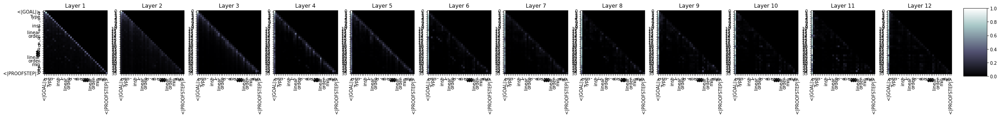

147271it [1:40:56, 24.31it/s]



  Average training loss: 1.07
  Training epoch took: 1:40:57

Running Validation...
  Validation Loss: 1.00
  Validation took: 0:01:33


3it [00:00, 28.59it/s]


======== Epoch 24 / 35 ========
Training...


3199it [02:06, 27.00it/s]

  Step 3,200  of  147,271. Loss: 1.0572893619537354.   Elapsed: 0:02:07.
Sample:rw [min_eq_iff_max, min_eq_iff_min]<|endoftext|><|PROOFSTEP|>rw [←max_mul_eq_def_min]<|endoftext|><|PROOFSTEP|>rw [←max_snd]<|endoftext|><|PROOFSTEP|>split_ifs<|endoftext|><|PROOFSTEP|>simp [sup_nonneg]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>let_instance := inv _<|endoftext|><|PROOFSTEP|>rw ← (of_eq _)<|endoftext|><|PROOFSTEP|>apply_instance with_bot.2 using _ ⟨-δ, δ⟩<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>have := (of_eq _)<|endoftext|><|PROOFSTEP|>summable_right<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>have : (1, 2, c_1, c_1_1_1) 2 0 2 0 0 1 1<|endoftext|><|PROOFSTEP|>have with b : bs 1 = 0, has_b 2 = 0, has_b c 2 = 1,<|endoftext|><|PROOFSTEP|>let
s -> 0.3303491771221161
ex -> 0.20973651111125946
rw -> 0.16601276397705078
apply -> 0.07823839783668518
cases -> 0.07805550843477249
int -> 0.0

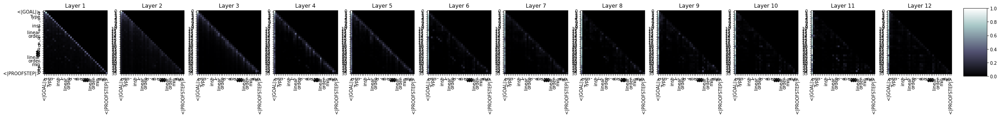

6399it [04:18, 26.64it/s]

  Step 6,400  of  147,271. Loss: 1.1064425706863403.   Elapsed: 0:04:18.
Sample:rw [min_iff_eq_max_iff, min_max_iff_max_iff]<|endoftext|><|PROOFSTEP|>exact or.inr<|endoftext|><|PROOFSTEP|>simp [← sub_singleton, sub_eq_max]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintro w h₁ : ∀ (h : is_conj h), s.trans (h.symm) ha₁ (h.symm)<|endoftext|><|PROOFSTEP|>try {simp}<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>tactic f = (λ y, hy, (IH : set (IH : IH1 ∈ set.IH), ⟨IH (IH1 : IH1 ∈ set.IH), ⟨IH IH1, h.symm.2 h⟩) h.symm.2.1<|endoftext|><|PROOFSTEP|>assumption {f
s -> 0.3044581711292267
ex -> 0.18635325133800507
apply -> 0.14749449491500854
rw -> 0.14007605612277985
cases -> 0.0694907009601593
have -> 0.050351981073617935
int -> 0.03480370715260506
re -> 0.03000982105731964
ref -> 0.02165892720222473
sim -> 0.015302804298698902


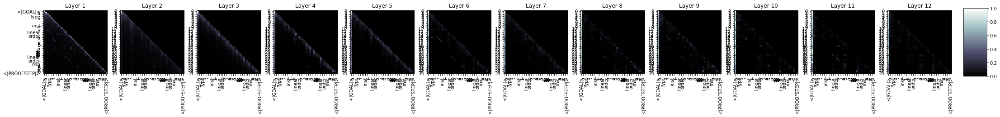

9599it [06:29, 27.16it/s]

  Step 9,600  of  147,271. Loss: 0.7040273547172546.   Elapsed: 0:06:30.
Sample:rw [min_eq_iff_min]<|endoftext|><|PROOFSTEP|>simp [←simp_iff_comm]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>intros x<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>exact_mem_prod<|endoftext|>this<|endoftext|><|PROOFSTEP|>refl<|endoftext|>sub.1<|endoftext|><|PROOFSTEP|>have : sub(s1) ∘ s2 (s2) ∘ S1<|endoftext|><|PROOFSTEP|>cases.1 : sub_eq<|endoftext|><|PROOFSTEP|>ext : sub_eq_zero := le_exists_le_zero.2<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>split.1 : split_eq_zero<|endoftext|><|PROOFSTEP|>s1<|endoftext|><|PROOFSTEP|>s1<|endoftext|><|PROOFSTEP|>s2<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>by rfl<|endoftext|>by rfl<|endoftext|>←<|endoftext|><|PROOFSTEP|>have<|endoftext|>p : one_smul : one_smul<|endoftext|><|PROOFSTEP|>s, one_bkne : one_smul<|endof

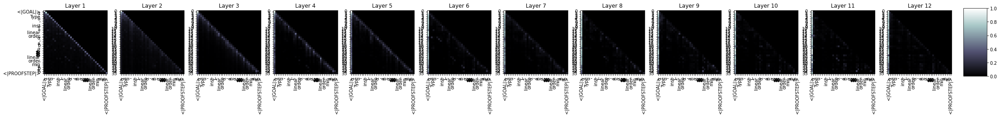

12799it [08:41, 24.57it/s]

  Step 12,800  of  147,271. Loss: 0.7169511318206787.   Elapsed: 0:08:42.
Sample:simp<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>simp [prod_le]<|endoftext|><|PROOFSTEP|>simp [lt_to_finset, int.to_finset]<|endoftext|><|PROOFSTEP|>simp with le_right<|endoftext|><|PROOFSTEP|>sintro<|endoftext|><|PROOFSTEP|>rintros⟩ ⟨⟨⟨⟨⟨⟨⟨⟨⟨⟩⟩⟩⟩⟩<|endoftext|><|PROOFSTEP|>by simpa<|endoftext|><|PROOFSTEP|>rw [h, simpa]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>s_of_real _ _ _<|endoftext|><|PROOFSTEP|>exists_right<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exists_left_of Originally<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>rw [mem_self_of_mem_mem (mem_iff_true_true), mem_mem_iff_true_true]<|endoftext|><|PROOFSTEP|>cases_
s -> 0.32368409633636475
rw -> 0.28586140275001526
ex -> 0.11015579849481583
apply -> 0.08446953445672989
cases -> 0.069202

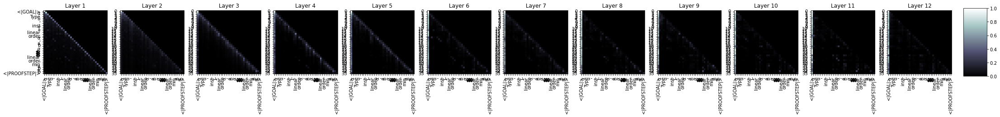

15998it [10:54, 24.33it/s]

  Step 16,000  of  147,271. Loss: 1.156753420829773.   Elapsed: 0:10:55.
Sample:ext<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>obtain ⟨δ, δ' δ', Π<|endoftext|><|PROOFSTEP|>induction a<|endoftext|><|PROOFSTEP|>rintros ⟨a, b, hb, hs, hs'⟩<|endoftext|><|PROOFSTEP|>ext ⟨x, x⟩<|endoftext|><|PROOFSTEP|>ext ⟨a, b, hb, c⟩<|endoftext|><|PROOFSTEP|>by {to_fun := ⟨0⟩, map_one, to_fun := _⟩}<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>cases' (inhabited.mem_connected) with ⟨s, h, rfl, rfl, sub_mk_refl, sub_inv_x, hs⟩<|endoftext|><|PROOFSTEP|>rw x<|endoftext|><|PROOFSTEP|>rw sub_left<|endoftext|><|PROOFSTEP|>rw [refl, hs, sub_right, rfl, sub_left, rfl, sub_one]<|endoftext|><|PROOFSTEP|>
rw -> 0.35661858320236206
s -> 0.32777634263038635
ex -> 0.08364249020814896
apply -> 0.07163456082344055
cases -> 0.055702611804008484
have -> 0.03882302716374397
re -> 0.02407722920179367
int -> 0.016317030414938927
by -> 0.0127897122874856
ref -> 0.012618351727724075


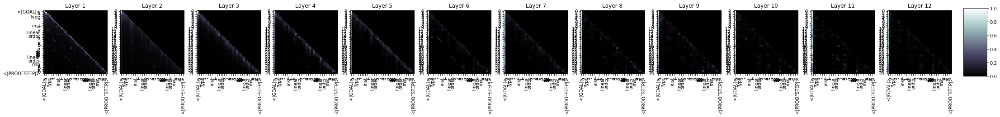

19199it [13:06, 22.85it/s]

  Step 19,200  of  147,271. Loss: 0.7254719138145447.   Elapsed: 0:13:06.
Sample:exact max_le_max _<|endoftext|><|PROOFSTEP|>have := min b<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have : nonneg := (is_neg.min (le_top.1 (neg.2 * (neg.1 ^ 2)).ne_top)<|endoftext|><|PROOFSTEP|>cases le_top.1 (neg.2 * 1)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance_eq<|endoftext|><|PROOFSTEP|>apply_dvd { exact }<|endoftext|><|PROOFSTEP|>apply_const { to ℕ }<|endoftext|><|PROOFSTEP|>refl := λ _ _, λ f, { exact }<|endoftext|><|PROOFSTEP|>refl, _<|endoftext|><|PROOFSTEP|>by_cases<|endoftext|><|PROOFSTEP|>s : 1 (1 : ℕ) 1 = 1, _<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>reflX : 1 (1 : ℕ) 1 = 1<|endoftext|><|PROOFSTEP|>s : decidable (pow_one_at_1).1 at 1.1 ⟨pow_one
s -> 0.32790693640708923
rw -> 0.23122501373291016
apply -> 0.11911914497613907
ex -> 0.09812312573194504
cases -> 0.07543621212244034
hav

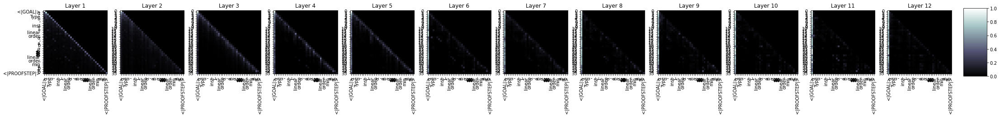

22397it [15:15, 26.08it/s]

  Step 22,400  of  147,271. Loss: 0.8517055511474609.   Elapsed: 0:15:16.
Sample:induction b with a ih<|endoftext|><|PROOFSTEP|>rw [neg_comm, neg_comm_neg, sub_left_comm, mul_one]<|endoftext|><|PROOFSTEP|>simp [neg_comm, neg_comm, sub_left_left]<|endoftext|><|PROOFSTEP|>simp [neg%.eq_self_iff, neg_comm]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>tidy_iff_symm<|endoftext|><|PROOFSTEP|>rintro (lifts_right rfl) (mul_right rfl)<|endoftext|><|PROOFSTEP|>simp_eq_mem [mem_def, mem_def]<|endoftext|><|PROOFSTEP|>tidy_iff_symm<|endoftext|><|PROOFSTEP|>refine rfl : h {0}<|endoftext|><|PROOFSTEP|>norm_one<|endoftext|><|PROOFSTEP|>simp (le_distrib_of_le.symm]<|endoftext|><|PROOFSTEP|>by<|endoftext|><|PROOFSTEP|>simp_lk<|endoftext|><|PROOFSTEP|>by_rw [self -1]<|endoftext|><|PROOFSTEP|>refl_of
s -> 0.4299965798854828
rw -> 0.20615254342556
cases -> 0.08494795858860016
ex

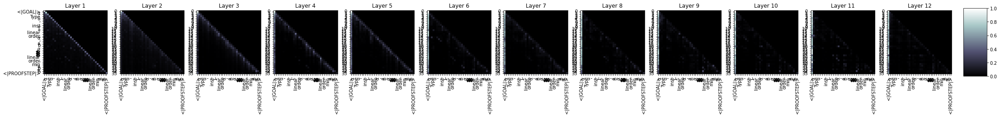

25599it [17:28, 27.04it/s]

  Step 25,600  of  147,271. Loss: 0.576835036277771.   Elapsed: 0:17:28.
Sample:exact min_lt_max<|endoftext|><|PROOFSTEP|>simp [comm]<|endoftext|><|PROOFSTEP|>intro h0<|endoftext|><|PROOFSTEP|>rw [← neg_neg, pos_ne_zero]<|endoftext|><|PROOFSTEP|>rw mul_self<|endoftext|><|PROOFSTEP|>have h := h<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>exact_right' (le_trans _ hf) {to_finset := hym, mul_self }<|endoftext|><|PROOFSTEP|>snd<|endoftext|><|PROOFSTEP|>exists_mul_is_mem _ _<|endoftext|><|PROOFSTEP|>dvd_one<|endoftext|><|PROOFSTEP|>apply_mem<|endoftext|><|PROOFSTEP|>subtype_of_mem<|endoftext|><|PROOFSTEP|>ext fc'<|endoftext|><|PROOFSTEP|>s2<|endoftext|><|PROOFSTEP|>ext_rw x<|endoftext|><|PROOFSTEP|>cases_top<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>refl<|endoftext|>A<|endoftext|><|PROOFSTEP|>sIc.Ico<|endoftext|><|PROOFSTEP|>cases_top<|endoftext|><|PROOFSTEP|>haveIc_Ico1<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rintro H<|endoftext|>

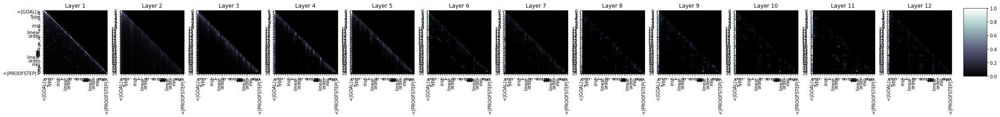

28799it [19:42, 22.31it/s]

  Step 28,800  of  147,271. Loss: 1.152803897857666.   Elapsed: 0:19:42.
Sample:exact max_le_max $ eq_top<|endoftext|><|PROOFSTEP|>congr<|endoftext|><|PROOFSTEP|>have : a : ℝ ≤ 0 := λ n<|endoftext|><|PROOFSTEP|>rw int.left_comm_left<|endoftext|><|PROOFSTEP|>simp at h<|endoftext|><|PROOFSTEP|>repeat { rintro rw [← int.comm, (int.comm_self _ _).left, ← int.comm, int.comm_self_int] }<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_rw [← nat.comm, nat.iff.2 h2t, nat.le_iff.1_lt, ← le_iff_lt_iff]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>haveI<|endoftext|><|PROOFSTEP|>exact_mod_cast.2 (refl.1)<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp_1<|endoftext|><|PROOFSTEP|>set_of_refl.to_zero.to_zero := to_zero<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>norm_right<|endoftext|><|PROOFSTEP|>re
s -> 0.4043533205986023
rw -> 0.17348414659500122
ex -> 0.1595606654882431
cases -> 0.06358905136585236
apply -> 0.04902425408363342
have -> 0.0462079122662544

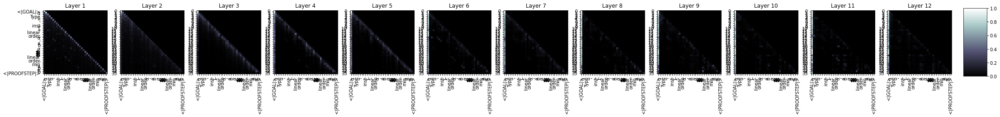

31999it [21:55, 24.93it/s]

  Step 32,000  of  147,271. Loss: 0.9302396774291992.   Elapsed: 0:21:56.
Sample:refl<|endoftext|><|PROOFSTEP|>simp [cancel_right]<|endoftext|><|PROOFSTEP|>set {x y z} {x} {y z} {hx} {hxy} {ha} {hha} {tz} {tz} {hxy} {hxyz} {tz} {s_1 z} {s_2 z} {st x y z z} {s_3 z z} {st x y z z} {s_4 z z} {s_5 z z} {s_6 z} {s_7 z} {s_8 z} {s_9 z} {s_10 z} {s_11 z} {s_12 z} {s_13 z} {s_14 z} {s_15 z} {s_16 z} {s_17 z} {s_18 z} {tz z z} {s_19 z z
s -> 0.37678062915802
ex -> 0.19488228857517242
rw -> 0.1636466085910797
apply -> 0.05350443720817566
cases -> 0.04686193913221359
have -> 0.04455481097102165
re -> 0.03992953523993492
int -> 0.03931955620646477
ref -> 0.023325100541114807
ext -> 0.017195045948028564


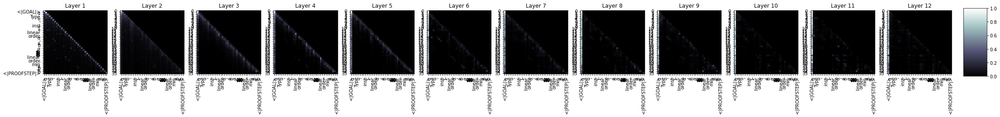

35199it [24:08, 28.34it/s]

  Step 35,200  of  147,271. Loss: 0.49462175369262695.   Elapsed: 0:24:09.
Sample:exact max_le_max a b<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact and_self_le_self_zero<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simpa using hare<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw [← H | ∀ ⟹, gt (s_1, s<|GOAL|>p1)⟩]<|endoftext|><|PROOFSTEP|>srt h1 : ∀ ⟹, s_1, sp1 ⟩ = rfl<|endoftext|><|PROOFSTEP|>simp [← harefl_trans, h1]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_rw [← harefl_trans, h1]<|endoftext|><|PROOFSTEP|>simp_rw<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>s' := {left := tt}<|endoftext|><|PROOFSTEP|>cases_conts : ∀ {n : ℕ} {g : ℕ} {A : Type v} := is_conts (nat.sub_cases_conts �
s -> 0.395102322101593
rw -> 0.3129006028175354
ex -> 0.11325571686029434
apply -> 0.03735596686601639
have -> 0.0317220464348793
re -> 0.030762778595089912
cases -> 0.025635454803705215
int -> 0.024022135883569717
ref -> 0.01608680747449398
sim

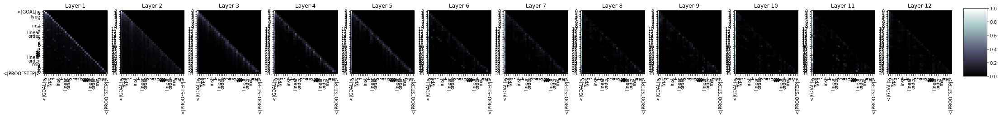

38399it [26:18, 22.54it/s]

  Step 38,400  of  147,271. Loss: 1.2096129655838013.   Elapsed: 0:26:19.
Sample:intros<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>norm_eq_one<|endoftext|><|PROOFSTEP|>simp [one_mul, one_mul] at h<|endoftext|><|PROOFSTEP|>simp only [one_mul, one_mul]<|endoftext|><|PROOFSTEP|>exact_comm<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact_right<|endoftext|><|PROOFSTEP|>simpa using is_left_def.1 (ne_of_pos).2<|endoftext|><|PROOFSTEP|>simp_apply<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_left_of_real<|endoftext|><|PROOFSTEP|>int_inj.1<|endoftext|><|PROOFSTEP|>simp_refl1<|endoftext|><|PROOFSTEP|>int_neg (not_le_nots)<|endoftext|><|PROOFSTEP|>apply_le_nots<|endoftext|><|PROOFSTEP|>have IH := (le_nots).1 Hsimp<|endoftext|><|PROOFSTEP|>exactIH<|endoftext|><|PROOFSTEP|>simp_le.2 (not_le.1 ih.2)<|endoftext|><|PROOFSTEP|>split_lt_two<|endoftext|><|PROOFSTEP|>exact
s -

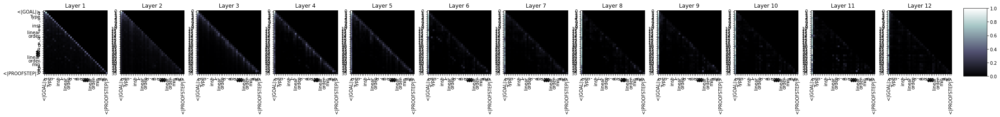

41600it [28:31, 23.75it/s]

  Step 41,600  of  147,271. Loss: 1.1999422311782837.   Elapsed: 0:28:32.
Sample:cases b<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>addro h<|endoftext|><|PROOFSTEP|>have my : xrf_of_nat (xrf_of_nat_of_self.symm) := hx<|endoftext|><|PROOFSTEP|>contrapose<|endoftext|><|PROOFSTEP|>obviously.<|endoftext|><|PROOFSTEP|>rw ← {0}IH := 1<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>suffix<|endoftext|><|PROOFSTEP|>rw [← eq_lt_one_iff]<|endoftext|><|PROOFSTEP|>apply_def<|endoftext|><|PROOFSTEP|>let_diff_self<|endoftext|>I := set.exists_of_symm<|endoftext|><|PROOFSTEP|>symm<|endoftext|><|PROOFSTEP|>by_case<|endoftext|><|PROOFSTEP|>rintro e : Σ<|endoftext|><|PROOFSTEP|>cases, e_le_refl<|endoftext|><|PROOFSTEP|>cases_eq_zero<|endoftext|><|PROOFSTEP|>repeat {contextual := {refl := {refl := {refl := {refl := {refl := {refl := {refl := "{refl := {refl := {refl := {
rw -> 0.2955576777458191
s -> 0.2537458837032318
ex -> 

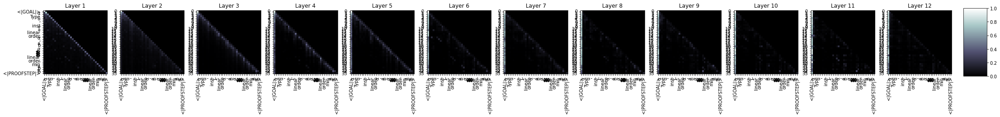

44800it [30:42, 26.95it/s]

  Step 44,800  of  147,271. Loss: 0.9503910541534424.   Elapsed: 0:30:42.
Sample:erw [max_assoc, le_of_lt a b]<|endoftext|><|PROOFSTEP|>have hd : a ≤ b := with_top.le_mul.1<|endoftext|><|PROOFSTEP|>simp_rw [lt_iff]<|endoftext|><|PROOFSTEP|>refine ⟨λ h, (s : ℕ), h.prod.succ _, _ ⟨_, _⟩<|endoftext|><|PROOFSTEP|>apply_def ⟨_, _⟩<|endoftext|><|PROOFSTEP|>show : ∀ ∈ (t : (λ (_x : ℕ), ''0 ∈ t), (0 ∨0 : (λ (_x : ℕ), ''0 ∈ t), 0 ∨0 : (λ (_x : ℕ), ''0 ∈ t), 0 ∨0 : (λ _x : ℕ), ''0 ∈ t), one_lt_one h (0 ∩ f_1)) ∧
s -> 0.32752344012260437
ex -> 0.210518479347229
rw -> 0.17551976442337036
cases -> 0.06785941869020462
have -> 0.05260578915476799
apply -> 0.05230284482240677
int -> 0.041165802627801895
re -> 0.033036984503269196
ref -> 0.024068795144557953
sim -> 0.015398622490465641


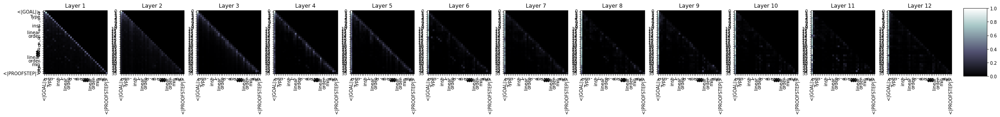

47999it [32:53, 26.46it/s]

  Step 48,000  of  147,271. Loss: 1.0448014736175537.   Elapsed: 0:32:54.
Sample:exact min_le.mpr a (le_max 1 b)<|endoftext|><|PROOFSTEP|>exact min_le.mpr (lt_top 1 b)<|endoftext|><|PROOFSTEP|>exact le_max at le_top.1 with hlt | h —<|endoftext|><|PROOFSTEP|>rw le_lt_iff_mem_ne_top<|endoftext|><|PROOFSTEP|>have := min_ne_one_add_iff_mem_ne_bot<|endoftext|><|PROOFSTEP|>apply nat.zero_of_le_of_le_supr<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_class<|endoftext|><|PROOFSTEP|>try { h }<|endoftext|><|PROOFSTEP|>apply'1 : not_not_not_not : (not_not_not_not.1 : only_not_not_not_not_not.2).not_not_not_not_not_not.1)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refine (const_of_not_not_not_not : not_not_not_not
s -> 0.25536927580833435
ex -> 0.23300914466381073
rw -> 0.16827541589736938
int -> 0.07475078105926514
cases -> 0.06667075306177139
apply -> 0.06421087682247162
have -> 0.05602794513106346
re -> 0.0325709767639637
ref -> 0.02568044140934944

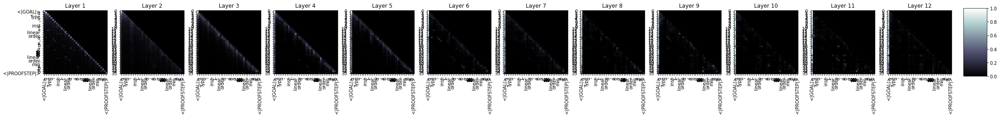

51198it [35:04, 26.64it/s]

  Step 51,200  of  147,271. Loss: 1.270965814590454.   Elapsed: 0:35:05.
Sample:simp *<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>try {tangent_mod_cast }<|endoftext|><|PROOFSTEP|>simpa using dvd.eq_add_dvd<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply congr_arg<|endoftext|><|PROOFSTEP|>congr<|endoftext|><|PROOFSTEP|>apply_dvd<|endoftext|><|PROOFSTEP|>intro y<|endoftext|><|PROOFSTEP|>have : intros.r with subsingleton.of<|endoftext|><|PROOFSTEP|>intros at hymm<|endoftext|><|PROOFSTEP|>apply_le<|endoftext|><|PROOFSTEP|>apply_left<|endoftext|><|PROOFSTEP|>rw [lt_refl]<|endoftext|><|PROOFSTEP|>subpair 0<|endoftext|><|PROOFSTEP|>rw [add_subt_succ_right_right, add_subt_symm, ne.subs_right, zero_add]<|endoftext|><|PROOFSTEP|>slt_rpow_of_ge<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>ext1_bot_eq_ne_top<|endoftext|><|PROOFSTEP|>have := one_of_ne_top (le_top_bot.ne_top)<|endoftext|><|PROOFSTEP|>rw [

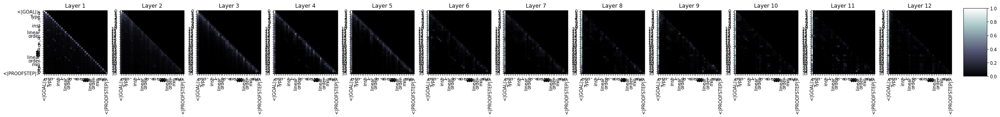

54400it [37:16, 28.13it/s]

  Step 54,400  of  147,271. Loss: 1.62467360496521.   Elapsed: 0:37:16.
Sample:simp only [linear_order.min]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance_derive_field<|endoftext|><|PROOFSTEP|>refine_instance (λ _, with_bot_iff _ _)<|endoftext|><|PROOFSTEP|>rwa [bot_iff.def]<|endoftext|><|PROOFSTEP|>apply_instance_derive_field<|endoftext|><|PROOFSTEP|>cases_of_ne_zero_nhds<|endoftext|><|PROOFSTEP|>apply_instance_derive_field.1<|endoftext|><|PROOFSTEP|>exact $ apply_instance_derive_field.1 _<|endoftext|><|PROOFSTEP|>rw [ne_zero_nhds, ne_one, and_def, nat.elim, nat.set_set_eq]<|endoftext|><|PROOFSTEP|>have, ihi, have_one_ne_one_ne_le, finset.2<|endoftext|><|PROOFSTEP|>have, ihm, eq_bot_iff, inhabit_iff, hd_eq_lt_iff'_le<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>intype_
s -> 0.3200111389160156
rw -> 0.22943763434886932
ex -> 0.15770821273326874
int -> 0.07914556562900543
have -> 0.050582487136125565
apply -> 0.04982639476656914
cases -> 0.04275156557559

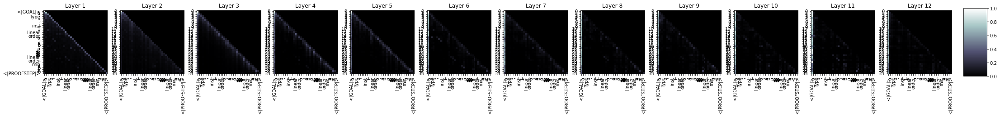

57599it [39:28, 30.59it/s]

  Step 57,600  of  147,271. Loss: 0.9731825590133667.   Elapsed: 0:39:28.
Sample:rintros ⟨_⟩<|endoftext|><|PROOFSTEP|>simp only [← max_iff]<|endoftext|><|PROOFSTEP|>split_eq_self<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have := {f : ℕ →+ bool hn}<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>simp.trans.fst<|endoftext|><|PROOFSTEP|>rw [← int.coe_iff, hn_le, int.coe_iff]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw _<|endoftext|><|PROOFSTEP|>rw [pow_ne_zero, pow_ne_one] at<|endoftext|><|PROOFSTEP|>rw [pow]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>falso [pow_one, pow_one]<|endoftext|><|PROOFSTEP|>obtain {refl] : ∈ {refl := int.coe_comp_1] ∈ {refl := int.coe_comp_1, int.coe_comp_1, int.coe_comp_1, int.comp_1]<|endoftext|><|PROOFSTEP|>
s -> 0.43081653118133545
rw -> 0.24076484143733978
ex -> 0.09456727653741837
int -> 0.05249355733394623
have -> 0.04171515256166458
apply -> 0.04147199168801308
cases -> 0.032664

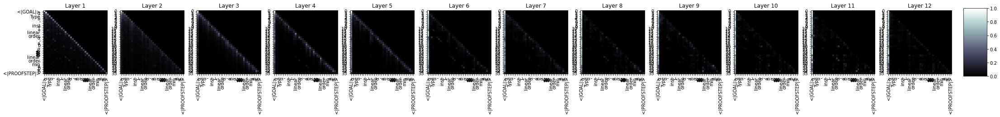

60797it [41:40, 24.78it/s]

  Step 60,800  of  147,271. Loss: 1.064487099647522.   Elapsed: 0:41:41.
Sample:ext<|endoftext|><|PROOFSTEP|>left<|endoftext|><|PROOFSTEP|>revert<|endoftext|><|PROOFSTEP|>have := rfl<|endoftext|><|PROOFSTEP|>revert ⟨_⟩<|endoftext|><|PROOFSTEP|>congr<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>rw [← intro (le_refl)]<|endoftext|><|PROOFSTEP|>rw [← intro (le_refl.1_refl]<|endoftext|><|PROOFSTEP|>have := (le_refl.coe_refl h.2.1.0.1 / (le_refl.coe_refl h.2.1.8.2)<|endoftext|><|PROOFSTEP|>sigma_s : fintype<|endoftext|><|PROOFSTEP|>s (fintype.card).le_refl<|endoftext|><|PROOFSTEP|>sigma_intro.1 (sigma_pow_card<|endoftext|><|PROOFSTEP|>rintros<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>s := seteq<|endoftext|><|PROOFSTEP|>s_of_le_to_mem _<|endoftext|><|PROOFSTEP|>sigma_lt<|endoftext|><|PROOFSTEP|>exists_s.mp le_top
s -> 0.4172151982784271
rw -> 0.22094427049160004
ex -> 0.0971202626824379
int -> 0.05305899679660797

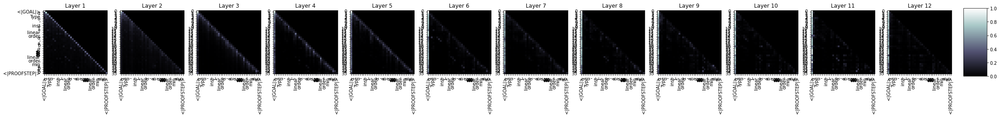

63999it [43:50, 30.03it/s]

  Step 64,000  of  147,271. Loss: 1.0531433820724487.   Elapsed: 0:43:51.
Sample:simp_rw [min_eq_iff_lt_max, ← coeff_coe]<|endoftext|><|PROOFSTEP|>simp (le_div_lt_iff_lt_max a b)<|endoftext|><|PROOFSTEP|>refine le_of_le_of_lt ( le_of_lt (le_of_lt a b))<|endoftext|><|PROOFSTEP|>refine le_of<|GOAL|>x_lt a<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refine le_of_lt_left(lt_iff_true a_inj<|endoftext|><|PROOFSTEP|>apply le_lt_left<|endoftext|><|PROOFSTEP|>apply le_iff_true lt_ne_zero<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [finset.add_add_eq]<|endoftext|><|PROOFSTEP|>norm_def<|endoftext|><|PROOFSTEP|>rw ← fintype.card.card_zero_not_div_right (card_eq_self _)<|endoftext|><|PROOFSTEP|>rw ← card_zero<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>assume<|endoftext|><|PROOFSTEP|>simp
s -> 0.40616217255592346
rw -> 0.2260320484638214
ex -> 0.11152312904596329
apply -> 0.057621099054813385
cases -> 0.0562657006084919
have -> 0.04867672547698021
int -

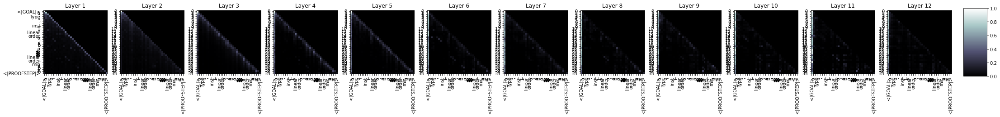

67199it [46:02, 27.56it/s]

  Step 67,200  of  147,271. Loss: 0.8830565214157104.   Elapsed: 0:46:02.
Sample:refine min_le_min _<|endoftext|><|PROOFSTEP|>simp [linear_order_iff_norm]<|endoftext|><|PROOFSTEP|>simp [← ← int_ne_zero]<|endoftext|><|PROOFSTEP|>simp [← ← int_ne_zero] ⊢ linear_order_eq_empty_iff_const_eq_zero_iff_norm<|endoftext|><|PROOFSTEP|>simp.1 (IHNX _ _)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp.2 (IH Nieto1<|endoftext|><|PROOFSTEP|>exact_const_const_const_const_const_const_const_univ : ∀ x y hx, y ∈ IH; x = hx, y = hx _<|endoftext|><|PROOFSTEP|>rw [⊤, ← (const_const_tendsto_const_const_const_const_const_const_const_const_const_const_const_const_
s -> 0.3668671250343323
rw -> 0.2405821681022644
ex -> 0.10806331038475037
apply -> 0.07171981036663055
have -> 0.05554300174117088
cases -> 0.05045599490404129
int -> 0.04036421701312065
re -> 0.03378531336784363
ref -> 0.018788080662488937
ext -> 0.013830968178808689

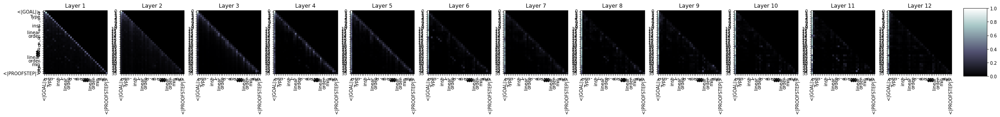

70400it [48:13, 22.51it/s]

  Step 70,400  of  147,271. Loss: 0.6842666268348694.   Elapsed: 0:48:13.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have := (lint_finset_of_nonpos _ _ _)_rhs hab<|endoftext|><|PROOFSTEP|>have := (eq_iff_nonpos _ _ _ _)<|endoftext|><|PROOFSTEP|>refine (mem_le_right.1) (tit.of_nat_nonpos_iff.1.1.1).symm.trans _<|endoftext|><|PROOFSTEP|>simp [mem_right, eq_iff_non<|GOAL|>AJ_1, (eq_iff_nonAJ]<|endoftext|><|PROOFSTEP|>exact (le.mp h).symm.symm.1)<|endoftext|><|PROOFSTEP|>symm<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [← add_def, add_comm]<|endoftext|><|PROOFSTEP|>refine {to_left : monotone, rfl, to_right := eq_left]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp, ennreal.one<|endoftext|><|PROOFSTEP|>
s -> 0.32955870032310486
rw -> 0.26493212580680847
ex -> 0.14042514562606812
apply -> 0.07838813215494156
have -> 0.06290631741285324
cases -> 0.036727938801050186
int -> 0.0292746908962726

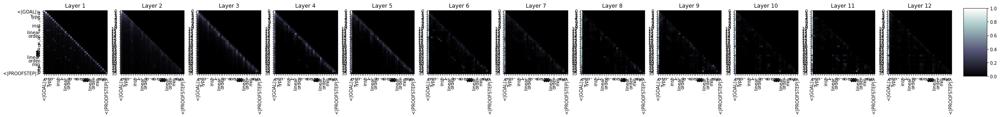

73598it [50:24, 25.59it/s]

  Step 73,600  of  147,271. Loss: 0.6392411589622498.   Elapsed: 0:50:25.
Sample:intros<|endoftext|><|PROOFSTEP|>ext j<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>simp_rw [smul_comm]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have := add_to_subset (subset_eq<|endoftext|><|PROOFSTEP|>rw [add_right_of_mem_def, mem_self]<|endoftext|><|PROOFSTEP|>ext_left<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>refine_match_left.refl2<|endoftext|><|PROOFSTEP|>exact_singleton_right<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>have := of_comp_self (top_left_of_preimage_right_of_image_sup<|endoftext|><|PROOFSTEP|>by_cases : ∀ ← top_left_of_preimage_right_of_comp_self, preimage_of_comp_image_superset (top_left_of_preimage_right_of_comp_self)<|endoftext|><|PROOFSTEP|>simp_exists_mem.3<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rp
rw -> 0.33879348635673523
s -> 0.24925023317337036
ex -> 0.1165579408407

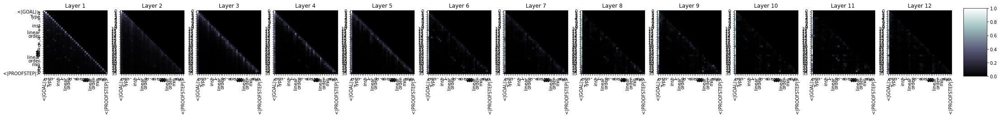

76799it [52:34, 23.84it/s]

  Step 76,800  of  147,271. Loss: 1.1284306049346924.   Elapsed: 0:52:35.
Sample:exact [le_max, min_le, min_lt_max]<|endoftext|><|PROOFSTEP|>transitivity<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp [eq_bot_iff]<|endoftext|><|PROOFSTEP|>have : real.add_lt<|endoftext|><|PROOFSTEP|>simp_right_left<|endoftext|><|PROOFSTEP|>rintros ⟨rfl⟩<|endoftext|><|PROOFSTEP|>simp @rw [← rfl⟩ | rfl⟩<|endoftext|><|PROOFSTEP|>let_le_total := {refl, ht, rfl⟩, exact}<|endoftext|><|PROOFSTEP|>simp_one.1 pgame.1<|endoftext|><|PROOFSTEP|>simp.2!<|endoftext|><|PROOFSTEP|>simp.1.2 (le_right_right) (right_right_left) (mem_eq_right_left.2 ht, right_right_left) (mem_mem_right_left.2 ht) (mem_mem_right_left.3 ht)<|endoftext|><|PROOFSTEP|>rw mul_
s -> 0.46282997727394104
rw -> 0.18723826110363007
ex -> 0.1164390817284584
have -> 0.05632317438721657
apply -> 0.05499972030520439
cases -> 0.040546827018260956
int -> 0.030365390703082085
re -> 0.018229270353913307
ext -> 0.017942167818546295
ref 

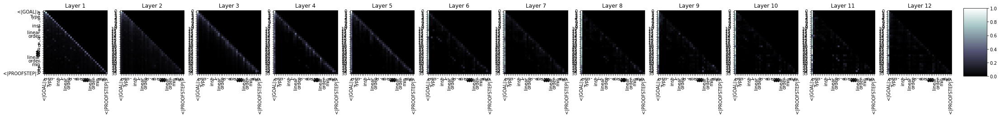

79998it [54:46, 25.88it/s]

  Step 80,000  of  147,271. Loss: 0.8126264214515686.   Elapsed: 0:54:46.
Sample:revert a<|endoftext|><|PROOFSTEP|>rw [mul_comm, mul_iff_mod.mk_one_lt_one]<|endoftext|><|PROOFSTEP|>rw [nat.left_add, mul_right_mk]<|endoftext|><|PROOFSTEP|>apply add_le_zero_of_pos_eq_one<|endoftext|><|PROOFSTEP|>rcases rfl with ⟨rfl⟩<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>rw [comap_nonneg, nonneg_iff, ← neg_eq_one, ← ← neg_coe, ← sub_eq_zero, ← one_eq_one, ← one_ne_nil, ← neg_cancel_iff]<|endoftext|><|PROOFSTEP|>classical, ennreal, decidable, classical.coe_symm, decidable.left, ennreal.coe_symm, decidable.nonneg, decidable.le_refl, neg_
rw -> 0.43854478001594543
s -> 0.21561476588249207
ex -> 0.13213907182216644
apply -> 0.05308064445853233
have -> 0.04074844345450401
cases -> 0.03853348270058632
int -> 0.03366249054670334
ext -> 0.0173534844070673
re -> 0.016933927312493324
ref -> 0.013388852588832378


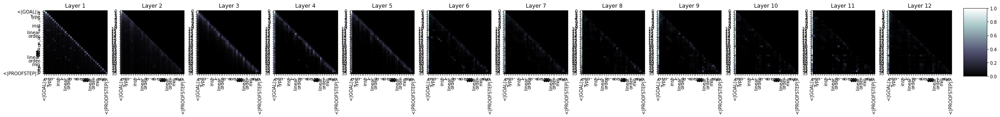

83200it [56:58, 23.17it/s]

  Step 83,200  of  147,271. Loss: 0.8386772871017456.   Elapsed: 0:56:58.
Sample:intro h<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>cases_compl_eq_coprime_right<|endoftext|><|PROOFSTEP|>simp only [cancel_iff_right_symm h]<|endoftext|><|PROOFSTEP|>exact (cancel_zero_left_le _.coe_zero_left).trans<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>rintro _ _ ⟨rfl, rfl⟩<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>exists (tat_of_ne_tat : (b = b) at (n.1 : tat_of_ne_ treadmill.tat).trans<|endoftext|><|PROOFSTEP|>simp1<|endoftext|><|PROOFSTEP|>by rfl⟩<|endoftext|><|PROOFSTEP|>rw add_sub<|endoftext|><|PROOFSTEP|>exists_def<|endoftext|><|PROOFSTEP|>apply_sub<|endoftext|><|PROOFSTEP|>have:<|endoftext|><|PROOFSTEP|>induction_of_bddle_div<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases_inh.1 (ne.
rw -> 0.3210643827915

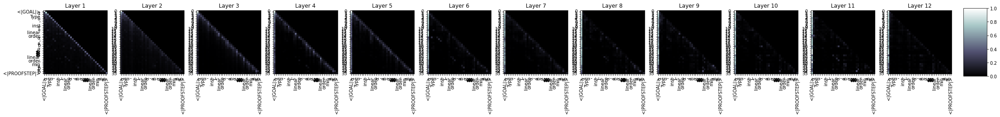

86400it [59:10, 27.56it/s]

  Step 86,400  of  147,271. Loss: 1.0620750188827515.   Elapsed: 0:59:11.
Sample:exact min_mod_of_is_max_le b (b :: b)<|endoftext|><|PROOFSTEP|>simp only [max_eq_zero, max_im_eq_max, neg_one]<|endoftext|><|PROOFSTEP|>simp only [max_eq_one, zero_eq_one] using set.inf_le_inf_of_le (set.zero_eq_inf_of_le _)<|endoftext|><|PROOFSTEP|>exact eq_lt_one<|endoftext|><|PROOFSTEP|>exact win_zero<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>ext u hx<|endoftext|><|PROOFSTEP|>simp_rw [zero_eq_one, zero_eq_one]<|endoftext|><|PROOFSTEP|>exact or.inr _<|endoftext|><|PROOFSTEP|>exists_not_le.imp<|endoftext|><|PROOFSTEP|>by_cases hx1 hx2 hx3 (refl)<|endoftext|><|PROOFSTEP|>simp at hx3<|endoftext|><|PROOFSTEP|>apply_comp<|endoftext|><|PROOFSTEP|>have := H<|endoftext|><|PROOFSTEP|>simp_unreal<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>
s -> 0.3473654091358185
rw -> 0.22734768688678741
ex -> 0.11339746415615082
cases -> 0.10784538835287094
apply -> 0.06326476484537125
int -> 0.04820573

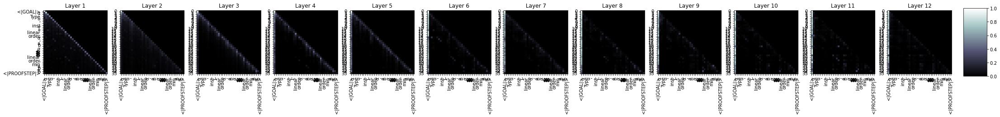

89599it [1:01:22, 27.75it/s]

  Step 89,600  of  147,271. Loss: 0.8365453481674194.   Elapsed: 1:01:22.
Sample:simp [min_of_lt_top b]<|endoftext|><|PROOFSTEP|>simp [min_of_lt]<|endoftext|><|PROOFSTEP|>simp [min_of_ steadily]<|endoftext|><|PROOFSTEP|>rw [continuous_neg]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s x<|endoftext|><|PROOFSTEP|>ext hx<|endoftext|><|PROOFSTEP|>rw with<|endoftext|><|PROOFSTEP|>simp H0<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp.2.2 0 Ih0<|endoftext|><|PROOFSTEP|>ext h<|endoftext|><|PROOFSTEP|>try {right }<|endoftext|><|PROOFSTEP|>s.cases_prox<|endoftext|><|PROOFSTEP|>cases_prox hx<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have:<|endoftext|><|PROOFSTEP|>ext1<|endoftext|>1<|endoftext|>(refl_add ⟨a,b,coe,hb⟩<|endoftext|><|PROOFSTEP|>s tl, ae, hb⟩<|endoftext|><|PROOFSTEP|>cases_prox<|endoftext|><|PROOFSTEP|>exact_h<|endoftext|><|PROOFSTEP|>exact_h<|endoftext|><|PROOFSTEP|>have_exists_add<|endoftext|><|PROOFSTEP|>exact<|endoft

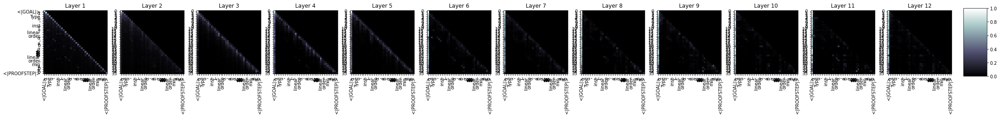

92800it [1:03:34, 27.56it/s]

  Step 92,800  of  147,271. Loss: 0.8920577764511108.   Elapsed: 1:03:34.
Sample:refl<|endoftext|><|PROOFSTEP|>apply le_antisymm<|endoftext|><|PROOFSTEP|>assume<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [one_mul]<|endoftext|><|PROOFSTEP|>cases_eq_zero.1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [one_mul]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintro rfl<|endoftext|>M K : ℝ, ℝ, ℝ, ℝ, |⊥⊥⊥⊥⊥⊥⊥⊥⊥1<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have at.apply_instance<|endoftext|><|PROOFSTEP|>have<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>tidy with IH<|endoftext|><|PROOFSTEP|>symm<|endoftext|><|PROOFSTEP|>cases_mem_subs<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have a<|endoftext|><|PROOFSTEP|>apply_instance<|e

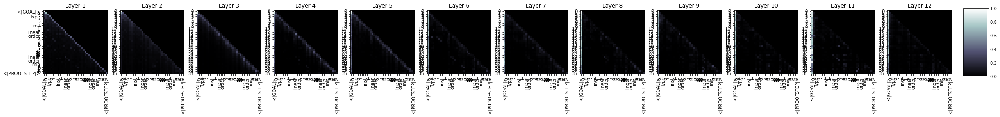

96000it [1:05:44, 21.80it/s]

  Step 96,000  of  147,271. Loss: 0.838093638420105.   Elapsed: 1:05:45.
Sample:apply min_div_eq_max<|endoftext|><|PROOFSTEP|>exact (le_neg_iff_lt_max pzero.1, le_min_iff_lt_max pzero.2)<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>apply abs_of yards_apply_zero.1 (lt_add_mem_eq)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw eof<|endoftext|><|PROOFSTEP|>exists_subset_one _<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_self.of_le.le.symm_left<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw mul_zero _<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>rw ←<|endoftext|><|PROOFSTEP|>let_insert h, hi<|endoftext|><|PROOFSTEP|>simp [mem_self_univ_univ, eq_eq_eq, eq_eq_eq_one] { tl := tl.to_subset_mem, eq_eq_eq, eq_eq_one}<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>
s -> 0.2822122871875763
rw -> 0.23099444806575775
ex -> 0.14566302299499512
apply -> 0.08367820084095001
int -

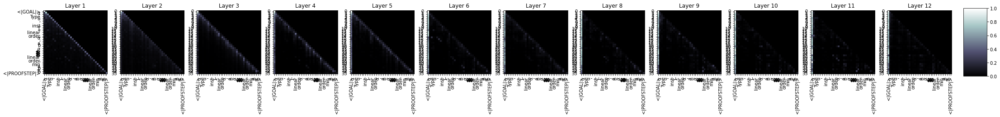

99198it [1:07:56, 26.23it/s]

  Step 99,200  of  147,271. Loss: 0.9185163974761963.   Elapsed: 1:07:56.
Sample:simp [min_eq_pi']<|endoftext|><|PROOFSTEP|>cases le_iff_nonneg_le with le_iff<|endoftext|><|PROOFSTEP|>exact_mod_cast (lt_le_iff_lt_iff_true.1 1 1)<|endoftext|><|PROOFSTEP|>simp [intros, intros]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>assumption : this is a measure θ<|endoftext|><|PROOFSTEP|>sintros<|endoftext|><|PROOFSTEP|>cases_nhds<|endoftext|><|PROOFSTEP|>assumption<|endoftext|><|PROOFSTEP|>s : only if it has only one, nhds, is itnhds (nil), is i nhds, (neg_not_nonneg)<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>assumption<|endoftext|><|PROOFSTEP|>s : only if it has 1 is false, is false<|endoftext|><|PROOFSTEP|>cases_nhds<|endoftext|><|PROOFSTEP|>apply (neg_norm_div_lt_one)<|endoftext|><|PROOFSTEP|>conform<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>by norm_div_self<

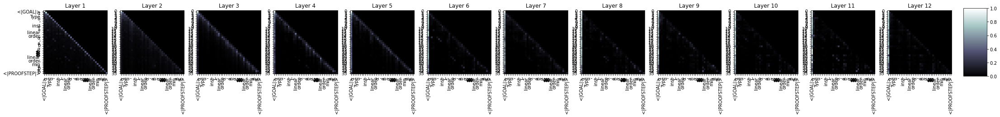

102399it [1:10:07, 27.39it/s]

  Step 102,400  of  147,271. Loss: 1.2454144954681396.   Elapsed: 1:10:08.
Sample:exact min_le_max a b<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>use [le_def]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>convert subtype.one<|endoftext|><|PROOFSTEP|>induction_self with a ih<|endoftext|><|PROOFSTEP|>simp [induction_self]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have := @dist_eq_right<|endoftext|><|PROOFSTEP|>by_cases : (1).1 : (1).1) := tendsto_one<|endoftext|><|PROOFSTEP|>cases le_right<|endoftext|><|PROOFSTEP|>s.1<|endoftext|><|PROOFSTEP|>simp [le_right_left, le_left] with ha<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact_refl<|endoftext|>refl<|endoftext|>←refl.iff_ne_bot _<|endoftext|><|PROOFSTEP|>sIo h<|endoftext|><|PROOFSTEP|>sIo<|endoftext|>G H1H2 : G.mem_le_right = H1H2H4<|endoftext|><|PROOFSTEP|>exact<|endoftext|><|PROOFSTEP|>apply_inst_eq _<|endoftext|><|PROOFSTEP|>s3 H1H2<|endoftext|>
s -

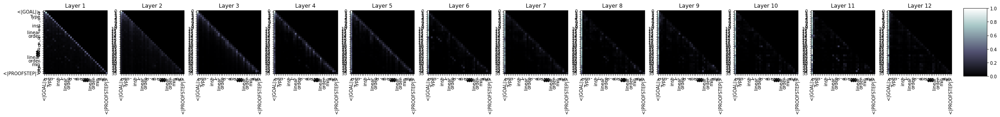

105600it [1:12:19, 24.68it/s]

  Step 105,600  of  147,271. Loss: 1.4712400436401367.   Elapsed: 1:12:19.
Sample:cases linear_order.max b<|endoftext|><|PROOFSTEP|>suffices : 1 ∈ b<|endoftext|><|PROOFSTEP|>cases h with h<|endoftext|><|PROOFSTEP|>rintro ⟨k, rfl⟩<|endoftext|><|PROOFSTEP|>to_dvd<|endoftext|><|PROOFSTEP|>intros h<|endoftext|><|PROOFSTEP|>cases rfl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [mem_def, add_mem, add_le, mem_def_mem h]<|endoftext|><|PROOFSTEP|>simp only [mem_def, add_le, add_mem, add_le, add_le, add_le]<|endoftext|><|PROOFSTEP|>rintro ⟨k, rfl⟩<|endoftext|><|PROOFSTEP|>simp only [mem_def, add_mem, add_le, add_le, add_le]<|endoftext|><|PROOFSTEP|>simp only [mul_self, mul_self]<|endoftext|><|PROOFSTEP|>simp_one<|endoftext|><|PROOFSTEP|>simpa only [←add_mul, add_one] using h with h<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>t
s -> 0.310589998960495
rw -> 0.29354289174079895
ex -> 0.12635940313339233
cases -> 0.0950135737657547
int -> 0.04682521894574165
apply -> 

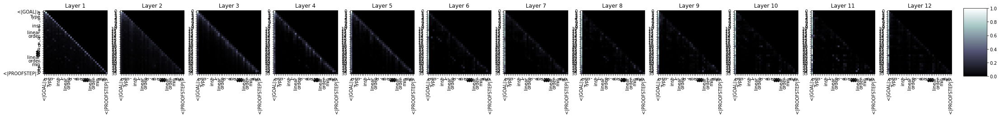

108798it [1:14:31, 23.87it/s]

  Step 108,800  of  147,271. Loss: 0.9118605256080627.   Elapsed: 1:14:32.
Sample:simp only [min_succ, max_le_iff, neg_le_neg] at a b<|endoftext|><|PROOFSTEP|>simp only [←max_le_iff_eq_left]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_def<|endoftext|><|PROOFSTEP|>apply_refl<|endoftext|><|PROOFSTEP|>simp [mul_def, inv]<|endoftext|><|PROOFSTEP|>try {contextual}<|endoftext|><|PROOFSTEP|>refine ⟨g, hg = rfl, refl, org_trans h.coe<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_def<|endoftext|><|PROOFSTEP|>have := (org_trans h.refl.symm), (add_le_right _ _).symm<|endoftext|><|PROOFSTEP|>let g := sigma.ne.symm<|endoftext|><|PROOFSTEP|>have := f.symm<|endoftext|><|PROOFSTEP|>assume.symm<|endoftext|><|PROOFSTEP|>rintr bool.symm<|endoftext|><|PROOFSTEP|>apply_apply<|endoftext|><|PROOFSTEP|>exact_symm<|endoftext|><|PROOFSTEP|>apply_inot_symm.symm.2<|endoftext|>
s -> 0.339863657951355
rw -> 0.2034319043159485
ex -> 0.1564401090145111
int -> 0.07040221244096756
cases 

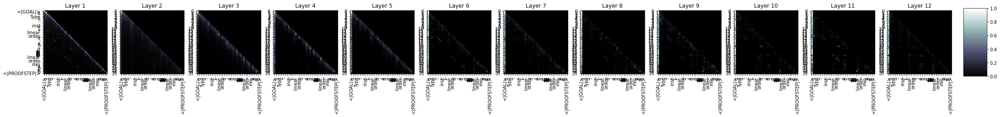

111999it [1:16:43, 26.28it/s]

  Step 112,000  of  147,271. Loss: 0.6117557287216187.   Elapsed: 1:16:44.
Sample:simp [le_refl_or_lt]<|endoftext|><|PROOFSTEP|>show a, b, a1, eq1, eq1_or_eq, eq2, eq2_or_eq, eq2, eq3, eq3, eq4, eq4, eq5<|endoftext|><|PROOFSTEP|>simp [←]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s n : ℕ,	r : ℕ,	h : n.coprime r,	h2 : (∃ (a : ℕ), a ⊔ a1 = 1) = 1,	h3 : a * 1 ≠ 0,	b : ℕ,	hb : b ⊔ bumped₁ b1,	h₁ : a * 1 ≠ 0	⊢ b = b (a1, b1) ↔ a = b _<|PROOFSTEP|>rw [← coprime_eq_iff,
s -> 0.36364638805389404
rw -> 0.22043587267398834
ex -> 0.12071587890386581
apply -> 0.08905769884586334
int -> 0.06675293296575546
cases -> 0.04953352361917496
re -> 0.03189139813184738
have -> 0.022230476140975952
ref -> 0.018454017117619514
split -> 0.01728173717856407


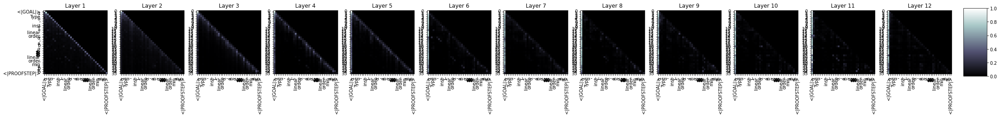

115199it [1:18:56, 26.56it/s]

  Step 115,200  of  147,271. Loss: 1.003770112991333.   Elapsed: 1:18:56.
Sample:simp only [coe_min_le_sup_iff, min_le_max]<|endoftext|><|PROOFSTEP|>have := has_le_sup_iff_eq_zero<|endoftext|><|PROOFSTEP|>try { refl }<|endoftext|><|PROOFSTEP|>rintro ⟨r, ⟨finset.coe_finset.sup, finset.supr, finset.coe_finset.supr, ←finset_image, finset_apply<|endoftext|><|PROOFSTEP|>simp only [eq_coe_sup,sup]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact congr_arg<|endoftext|><|PROOFSTEP|>letI := congr_arg congr_arg with one congr_arg<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>ds<|endoftext|><|PROOFSTEP|>sueduction<|endoftext|><|PROOFSTEP|>rw ← congr_arg<|endoftext|><|PROOFSTEP|>s_of_ne<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>by simp<|endoftext|><|PROOFSTEP|>by simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw ← int.def<|endoftext|><|PROOFSTEP|>show {IH : H ∈
s -> 0.4414275884628296
rw -> 0.265450656414032
ex -> 0.08529020845890045
apply -> 0.059153448

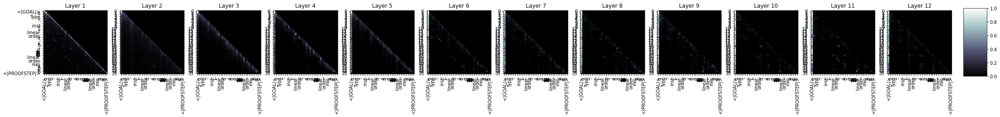

118400it [1:21:08, 27.38it/s]

  Step 118,400  of  147,271. Loss: 0.7892865538597107.   Elapsed: 1:21:09.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact_mod_cast $ prod_lt $ prod_sub_left $ dt_of_nonneg_le _<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>simp [sub_eq_sub, sub_eq_sub]<|endoftext|><|PROOFSTEP|>simp_rw [sub_eq_sub, sub_eq_sub, by simp]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>sub_eq_sub is_one.1<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_const.symm<|endoftext|><|PROOFSTEP|>apply_instance_symm<|endoftext|><|PROOFSTEP|>have := have<|endoftext|><|PROOFSTEP|>exists_comp_one_right<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_comp_one_rightsimp<|endoftext|><|PROOFSTEP|>simp_transient_le<|endoftext|><|PROOFSTEP|>apply (2)<|endoftext|><|PROOFSTEP|>suffix_one : one set.completion_eq<|endoftext|><|PROOFSTEP|>simp (comple

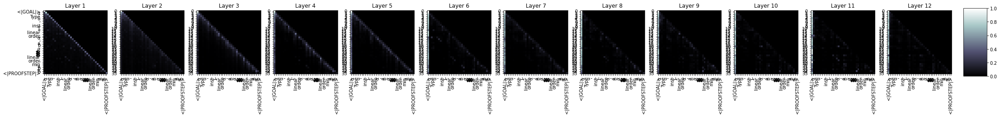

121600it [1:23:20, 23.40it/s]

  Step 121,600  of  147,271. Loss: 0.9882726669311523.   Elapsed: 1:23:21.
Sample:simpa only [← add_zero, min_le_add, add_assoc, min_le_add, add_neg] using min_le_add at a<|endoftext|><|PROOFSTEP|>simp only [mem_comm, zero_comm, mul_comm]<|endoftext|><|PROOFSTEP|>simp [zero_comm, mul_comm, zero_comm]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>by+1 x<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact inv_simp<|endoftext|><|PROOFSTEP|>have := {to := (exists_inr, add_iff.1 _).0} {to := (inr, add_iff.1 _).2}<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance : (curry_inr.mk (Curry subtype.coe_assoc).1 a b)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>apply_right<|endoftext|><|PROOFSTEP|>cases_right_of_inverse
s -> 0.33758077025413513
rw -> 0.2142166644334793
apply -> 0.13279761373996735
ex -> 0.12372621893882751
int -> 0.052955638

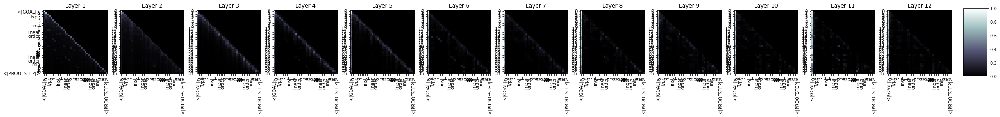

124798it [1:25:33, 26.28it/s]

  Step 124,800  of  147,271. Loss: 1.0584310293197632.   Elapsed: 1:25:33.
Sample:rw min_le<|endoftext|><|PROOFSTEP|>refine le_add_left_of_lt (le_max pnat.neg_eq_lt _)<|endoftext|><|PROOFSTEP|>rcases h : # of_nat_abs_of_nat h with (rcases h)<|endoftext|><|PROOFSTEP|>rw (nat.le_of_pos_iff_ne_zero) (ne_of_lt at h)<|endoftext|><|PROOFSTEP|>rw ← le_iff_ne_zero<|endoftext|><|PROOFSTEP|>refine (neg_of_pos_iff_ne_zero ⟨_, _, h, rfl | (neg_of_pos_iff_ne_zero h_nat_eq_zero).refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>assumption_ne_right<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply (finset_eq : subgroup, subgroup_zero, with_one_le)<|endoftext|><|PROOFSTEP|>rintros ⟨_, _, rfl�
s -> 0.3473498523235321
rw -> 0.22825533151626587
ex -> 0.15054060518741608
apply -> 0.08960876613855362
cases -> 0.05613972619175911
int -> 0.04398295655846596
re -> 0.02811679057776928
ref -> 0.02337709069252014
have -> 0.0184001624584198
split -> 0.0142286624

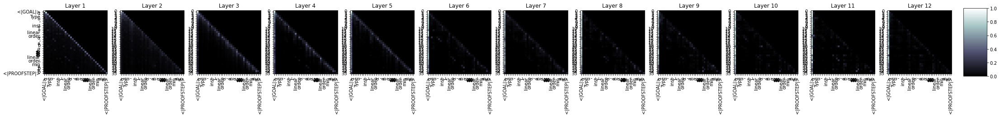

128000it [1:27:44, 22.89it/s]

  Step 128,000  of  147,271. Loss: 0.9765381813049316.   Elapsed: 1:27:44.
Sample:exact min_le_left _<|endoftext|><|PROOFSTEP|>ext (h' : not_lt a b)<|endoftext|><|PROOFSTEP|>norm_eq_coe h'<|endoftext|><|PROOFSTEP|>rw [coe_neg, h']<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact_mod_cast (IH.coe_neg_mul_right_eq_neg.2 hm)<|endoftext|><|PROOFSTEP|>linarith<|endoftext|><|PROOFSTEP|>exact_mod_cast hm<|endoftext|><|PROOFSTEP|>left<|endoftext|><|PROOFSTEP|>rw [sub_eq_left_mul, mul_apply_inj_mul, mul_apply_inj_one]<|endoftext|><|PROOFSTEP|>rw [mul_apply_inj, add_sub, add_sub_eq_left]<|endoftext|><|PROOFSTEP|>convert hm<|endoftext|><|PROOFSTEP|>by simp [cdiv_mul]<|endoftext|><|PROOFSTEP|>have := inv.2 (dof_sub_not_sub_right hm.1 hm.2 hm.2]<|endoftext|><|PROOFSTEP|>exists
s -> 0.2744961977005005
rw -> 0.20742815732955933
ex -> 0.16834673285484314
cases -> 0.10354750603437424
apply -> 0.09666658937931061
int -> 0.05341165512800217
re -> 0.030941491946578026
ref -> 0.0261642616242170

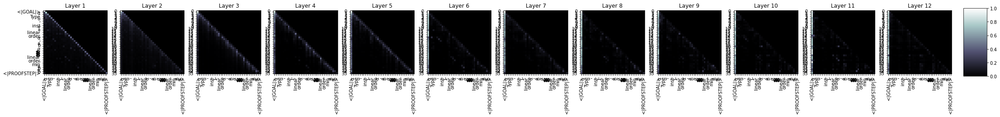

131200it [1:29:56, 23.52it/s]

  Step 131,200  of  147,271. Loss: 0.871332585811615.   Elapsed: 1:29:57.
Sample:intros b hb<|endoftext|><|PROOFSTEP|>intros a b' hb h' hb'<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simpa [left_comm] using hb<|endoftext|><|PROOFSTEP|>apply eq_not_le<|endoftext|><|PROOFSTEP|>simp [not_le]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>have H := hb, not_le H<|endoftext|><|PROOFSTEP|>simp $ ne_of_ne_of_not_le.mp<|endoftext|><|PROOFSTEP|>let's d1 h1 : not_le, not_le h1<|endoftext|><|PROOFSTEP|>apply ne_of_not_le at h1<|endoftext|><|PROOFSTEP|>apply h2<|endoftext|><|PROOFSTEP|>apply_le<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>apply_le_to_mul<|endoftext|><|PROOFSTEP|>apply_le_to_pow<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>exact' not_le h1<|endoftext|>1 h2<|endoftext|>0<|endoftext|><|PROOFSTEP|>cases h1 h1 h1 h1<|endoftext|><|PROOFSTEP|>simp only [mul, h2]<|endoftext|><|PROOFSTEP|>induction h2
s -> 0.25215986371040344
apply -> 0.163513854146

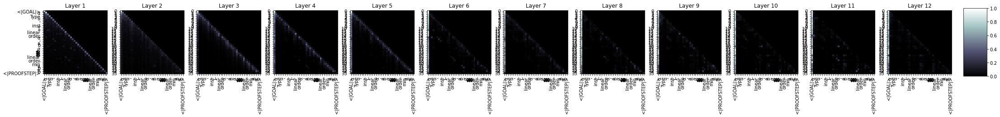

134398it [1:32:10, 18.87it/s]

  Step 134,400  of  147,271. Loss: 0.8480715751647949.   Elapsed: 1:32:11.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have := {p : nat.partrec ⟨x, p1⟩ := (I.h) tendsto x<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [h]<|endoftext|><|PROOFSTEP|>apply.of_le_of_subsymm<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_inv<|endoftext|><|PROOFSTEP|>apply_lt_coe<|endoftext|><|PROOFSTEP|>apply_inv (IH_pow_le_right) (0 : pow_lt_coe_eq_ne H_pow_ne_ne_one 2)<|endoftext|><|PROOFSTEP|>apply_cancel_right<|endoftext|><|PROOFSTEP|>congr<|endoftext|><|PROOFSTEP|>apply_inv<|endoftext|><|PROOFSTEP|>apply_inv<|endoftext|><|PROOFSTEP|>simp only.1 h.1.1<|endoftext|><|PROOFSTEP|>have := h.2<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp.1 (2^2⁻¹)<|endoftext|><|PROOFSTEP|>apply_right(pow_le_of_gt
s -> 0.27726882696151733
rw -> 0.23297885060310364
apply -> 0.155200466513

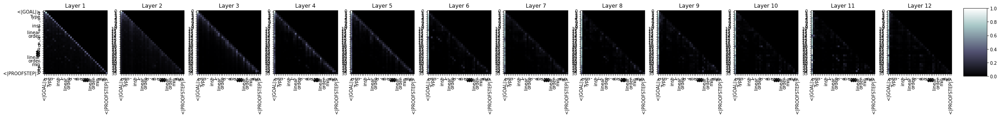

137600it [1:34:22, 27.68it/s]

  Step 137,600  of  147,271. Loss: 0.668664813041687.   Elapsed: 1:34:22.
Sample:induction b with bI bI'<|endoftext|><|PROOFSTEP|>induction bI' with<|GOAL|>a bI<|endoftext|><|PROOFSTEP|>by bkne_top bI<|endoftext|><|PROOFSTEP|>simpa only [induction_if_ne_top_or_zero] using [induction_if<|GOAL|>B, conditionally_le] using [induction_if_le, conditionally_le, ifB : conditionally_le]<|endoftext|><|PROOFSTEP|>intros ua<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact<|endoftext|><|PROOFSTEP|>exact_mod_cast<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>obtain ⟨p : {t : list ⟨⟨u, rfl⟩⟩ :=<|endoftext|><|PROOFSTEP|>szle : ∀ s, csum_eq_left_of_gt_pos ht, {u := ht, rfl⟩⟩<|endoftext|><|PROOFSTEP|>szle 1 2 2 3 4 5<|endoftext|><|PROOFSTEP|>exact { exact }<|endoftext|>
s -> 0.3118385970592499
ex -> 0.166446715593338
rw -> 0.1515008807182312
apply -> 0.12842394411563873
cases -> 0.10412285476922989
int -> 0.0455818772315979
have -> 0.03864066302776337
ref -> 0.020959217101335

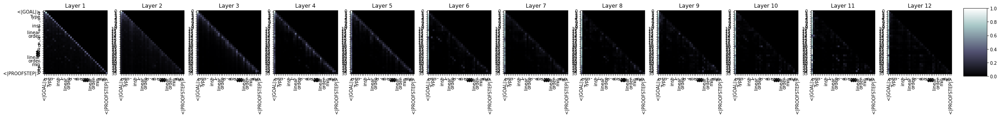

140799it [1:36:34, 26.31it/s]

  Step 140,800  of  147,271. Loss: 1.0224074125289917.   Elapsed: 1:36:35.
Sample:have := is_commutative_commutative_le_bot α a b.min_lt<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact ⟨x, hx⟩<|endoftext|><|PROOFSTEP|>left_eq<|endoftext|><|PROOFSTEP|>try {cases h]<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>symm<|endoftext|><|PROOFSTEP|>exact is_empty<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>s tl IH<|endoftext|><|PROOFSTEP|>rw [pow_top, h]<|endoftext|><|PROOFSTEP|>simpa using @h0n_of_mem with n_le_left<|endoftext|><|PROOFSTEP|>convert @h0n_top.2<|endoftext|><|PROOFSTEP|>use (n_le_left<|endoftext|><|PROOFSTEP|>ext hn_le_left.2 (b_ne_top _ _ _ _) hne2<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_left<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>rw (left_eq_one, right_eq_one)<|endoftext|><|PROOFSTEP|>refine (h.2
s -> 0.20282666385173798
cases -> 0

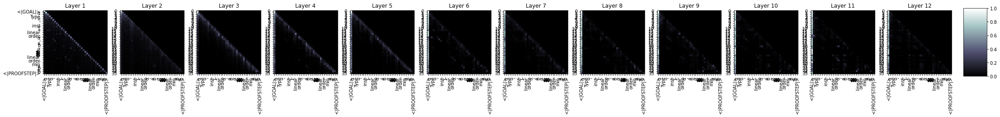

143998it [1:38:46, 19.78it/s]

  Step 144,000  of  147,271. Loss: 0.8213258385658264.   Elapsed: 1:38:47.
Sample:apply le_total<|endoftext|><|PROOFSTEP|>simp only [←IH, min_lt_top, ←lt_top]<|endoftext|><|PROOFSTEP|>have := bit0.lt_top.0<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>simp only [lt_top, le_top']<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>repr : fact (1 : ℕ) := nat.succ_fact_of_le_of_lt.mp (2.2 _)<|endoftext|><|PROOFSTEP|>have : A1₁ A2₂₁₂₂₁₉ A1₁₁₁.lt<|endoftext|><|PROOFSTEP|>have A1₂ : A1₁₁ A2₂₁₁₁₁A2₂₁X A1�
s -> 0.3389750123023987
cases -> 0.19662441313266754
ex -> 0.16967859864234924
rw -> 0.10579642653465271
apply -> 0.07723081111907959
have -> 0.03481603413820267
int -> 0.031048642471432686
split -> 0.016021782532334328
ref -> 0.015827937051653862
re -> 0.013980339281260967


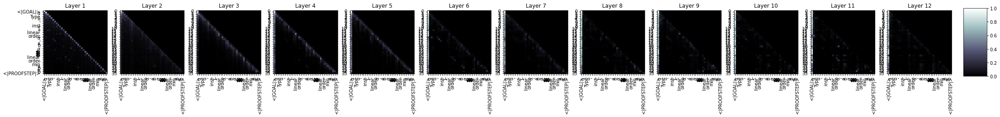

147198it [1:40:56, 25.16it/s]

  Step 147,200  of  147,271. Loss: 0.7177660465240479.   Elapsed: 1:40:57.
Sample:simp [min]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have h : ∀ {a b : α} {x : ℝ} {h : 0 < a} {y : ℝ}, 0 ≠ 0 < y.succ}, (a : ℝ), (b : ℝ), (b : ℝ), has_strict_deriv_at x b h y<|endoftext|><|PROOFSTEP|>refine ⟨(is_unit_of_pow_one_ne_top _ _ _).symm _⟩.trans h<|endoftext|><|PROOFSTEP|>rw [one_right_iff_1, le_iff_iff_2, ← one_succ_pow_one]<|endoftext|><|PROOFSTEP|>simp [pow, one_succ_pow, apply]<|endoftext|><|PROOFSTEP|>intro x<|endoftext|><|PROOFSTEP|>trans x<|endoftext|><|PROOFSTEP|>exact nat.inj _<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_
s -> 0.39515420794487
ex -> 0.17497709393501282
rw -> 0.15937316417694092
apply -> 0.07870036363601685
cases -> 0.06082942336797714
have -> 0.041489820927381516
int -> 0.036350563168525696
ref -> 0.01998879760503769
sim -> 0.018813299015164375
re -> 0.01432324480265379


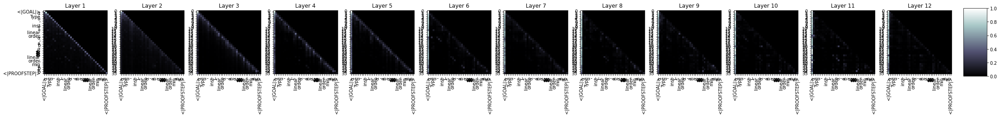

147271it [1:41:05, 24.28it/s]



  Average training loss: 1.05
  Training epoch took: 1:41:05

Running Validation...
  Validation Loss: 0.99
  Validation took: 0:01:32


3it [00:00, 26.95it/s]


======== Epoch 25 / 35 ========
Training...


3199it [02:06, 26.03it/s]

  Step 3,200  of  147,271. Loss: 0.6937006115913391.   Elapsed: 0:02:06.
Sample:ext x<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [← neg_eq_neg, ← top_cancel_right, eq_top]<|endoftext|><|PROOFSTEP|>cases iseq_nil_of_neg with is_neg_of_neg (fderiv_of_neg_of_pos zero_lt_one zero_lt_one)<|endoftext|><|PROOFSTEP|>apply iseq_nil_of_neg_pos<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [of_nonneg, of_nonneg_iff, of uncertain]<|endoftext|><|PROOFSTEP|>tauto<|endoftext|><|PROOFSTEP|>simp only [of_zero_neg]<|endoftext|><|PROOFSTEP|>rw ← tauto<|endoftext|><|PROOFSTEP|>by omle<|endoftext|><|PROOFSTEP|>simp only [of_zero_neg, eq_zero]<|endoftext|><|PROOFSTEP|>refine ⟨c, _, _, _, _, _, of_self, _, a, eq_self, hc, hc.1, of_lt
s -> 0.37351080775260925
ex -> 0.17095515131950378
rw -> 0.15960901975631714
cases -> 0.09300345182418823
apply -> 0.07517512887716293
int -> 0.03840763494372368
have -> 0.03550500050187111
ref -> 0.019923526793718338
rint -> 0.0187911465

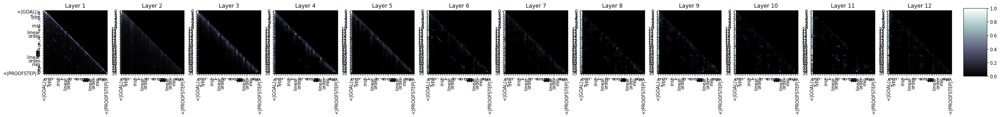

6399it [04:17, 23.26it/s]

  Step 6,400  of  147,271. Loss: 0.8702853322029114.   Elapsed: 0:04:18.
Sample:haveI := partial_order.min b b<|endoftext|><|PROOFSTEP|>apply h<|endoftext|><|PROOFSTEP|>apply_instance_derive_field<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simpa only [h] using ⟨h.1⟩<|endoftext|><|PROOFSTEP|>rintro rfl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>dsimp [← ha, ha_eq]<|endoftext|><|PROOFSTEP|>rintr<|endoftext|><|PROOFSTEP|>simp [← ha, ha_eq, ha_mem, e.mem_h, h.coe_iff, ha.coe_iff, ha_mem, eq_iff_and_not_eq]<|endoftext|><|PROOFSTEP|>simp (2)<|endoftext|><|PROOFSTEP|>rw ←simp₂<|endoftext|><|PROOFSTEP|>rintro.coe 2 (one.smul_one.1 1)<|endoftext|><|PROOFSTEP|>rintro.coe_one 1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases_eq : a b c' with a c' b c', 2 with b c'<|endoftext|><|PROOFSTEP|>simp (1)
s -> 0.4065755307674408
rw -> 0.17115110158920288
ex -> 0.1613222062587738
apply -> 0.06425797194242477
cases -> 0.06379489600658417
int -> 0.0369143299758

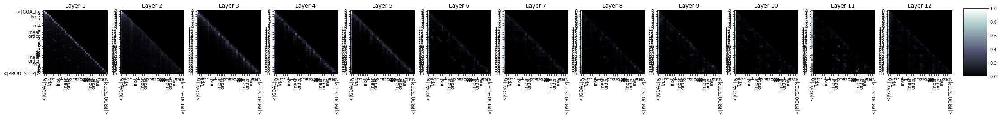

9600it [06:30, 26.15it/s]

  Step 9,600  of  147,271. Loss: 1.0219389200210571.   Elapsed: 0:06:31.
Sample:exact min_of_le_min a b<|endoftext|><|PROOFSTEP|>simp only [← a, min_le_left]<|endoftext|><|PROOFSTEP|>simp only [← min_bot, not_mem_iff, max_bot] using ⟨a, b, h⟩<|endoftext|><|PROOFSTEP|>change intros ⟨c, hc⟩<|endoftext|><|PROOFSTEP|>apply intros<|endoftext|><|PROOFSTEP|>have := hc hd<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>by+refl<|endoftext|><|PROOFSTEP|>have : [← set.mem_completion, ← mem_const, ← option.refl, ← option.of_mem_completion_eq_mem, ← set.mem_const, ← option.add_eq_not_mem, ← set.mem_completion]<|endoftext|><|PROOFSTEP|>apply add_eq_mem : is_const_const_iff (λ h, $snd, hsnd hd)
s -> 0.2934734523296356
ex -> 0.20876935124397278
rw -> 0.18637947738170624
cases -> 0.10449837893247604
apply -> 0.06516021490097046
have -> 0.0394415408372879
int -> 0.036916814744472504
re -> 0.028695672750473022
rc -> 0.01848743110895157
ref -> 0.018177738413214684


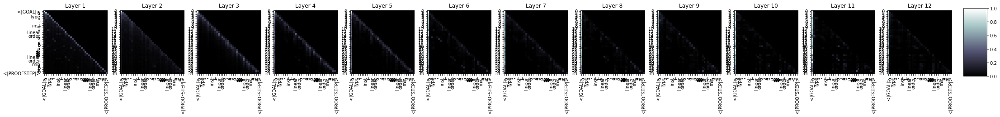

12798it [08:44, 23.70it/s]

  Step 12,800  of  147,271. Loss: 1.149672269821167.   Elapsed: 0:08:45.
Sample:simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp only [div_eq_left, zero_smul]<|endoftext|><|PROOFSTEP|>rcases {x} with ⟨hx, hx⟩<|endoftext|><|PROOFSTEP|>rcases { /* x, hy, hx⟩ | ⟨r, hx⟩, rx, hx⟩<|endoftext|><|PROOFSTEP|>have {x} {g, hg, hg, hg, rx, hx⟩} := dec_trivial<|endoftext|><|PROOFSTEP|>apply_instance_of_le_norm.1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases g<|endoftext|><|PROOFSTEP|>s' : comm_ring ↥, with, with gs<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>t<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp.1 (IH.2.trans (IH.2.of_inter (inter_eq_of_inter))<|endoftext|><|PROOFSTEP|>s
s -> 0.36473801732063293
rw -> 0.2034330517053604
ex -> 0.16994713246822357
cases -> 0.08687254786491394
apply -> 0.04653554782271385
have -> 0.040032148361206055
int -> 0.0323200486600399
sim -> 0.02

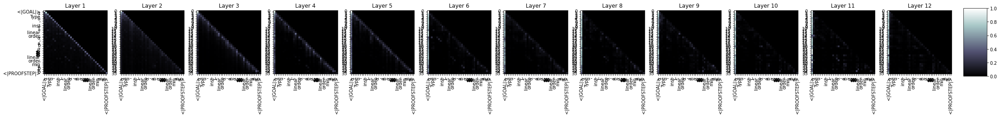

15998it [10:56, 19.81it/s]

  Step 16,000  of  147,271. Loss: 1.1561951637268066.   Elapsed: 0:10:56.
Sample:refl<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>set_x : ℕ := pnat_add<|endoftext|><|PROOFSTEP|>try {refl}<|endoftext|><|PROOFSTEP|>rw set_x<|endoftext|><|PROOFSTEP|>simpa using ysmul_preimage (simp_iff_pos)<|endoftext|><|PROOFSTEP|>rcases xsimp_iff_pos with ⟨xo, yo⟩<|endoftext|><|PROOFSTEP|>simp_iff_pos<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>assumption : has_one (is_one_iff_pos _)<|endoftext|><|PROOFSTEP|>have h : is_one (is_one _) := cmp has_one<|endoftext|><|PROOFSTEP|>have h<|endoftext|><|PROOFSTEP|>try {refl, }<|endoftext|><|PROOFSTEP|>exact {refl}<|endoftext|><|PROOFSTEP|>cases _<|endoftext|>P.P with ⟨rp, rp.p, rp.to⟩<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>have :<|endoftext|><|PROOFSTEP|>rc_eq ⟨rp, rp.p, r
ex -> 0.29659363627433777
s -> 0.24058683216571808
rw -> 0.16717715561389923
cases -> 0.06358243525028229
apply ->

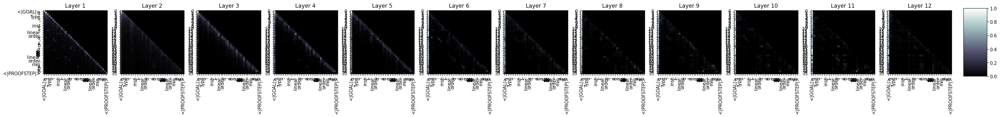

19200it [13:07, 23.87it/s]

  Step 19,200  of  147,271. Loss: 0.989112377166748.   Elapsed: 0:13:08.
Sample:by_cases ha : b ≤ a<|endoftext|><|PROOFSTEP|>rintros ⟨⟩<|endoftext|><|PROOFSTEP|>exact ⟨⟩<|endoftext|><|PROOFSTEP|>exact ⟨⟩<|endoftext|><|PROOFSTEP|>split_eq (lt_div_iff_nhds = _)<|endoftext|><|PROOFSTEP|>split_eq_nil_of_le_isow_of_le_isow_right<|endoftext|><|PROOFSTEP|>rintros ⟨⟩<|endoftext|><|PROOFSTEP|>s : one_symm (one_symm, ∀ h, h.symm) ⟨h<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simpa [finset.2] using h.symm<|endoftext|><|PROOFSTEP|>letsymm at (x).1.1<|endoftext|><|PROOFSTEP|>have : x.1 = 1<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>cases_id_le<|endoftext|><|PROOFSTEP|>from_comp_1<|endoftext|><|PROOFSTEP|>have_dvd_mem_right<|endoftext|><|PROOFSTEP|>rwa1<|endoftext|><|PROOFSTEP|>
s -> 0.31560656428337097
ex -> 0.20048166811466217
rw -> 0.17952904105186462
apply -> 0.06865620613098145
cases -> 0.0654974654

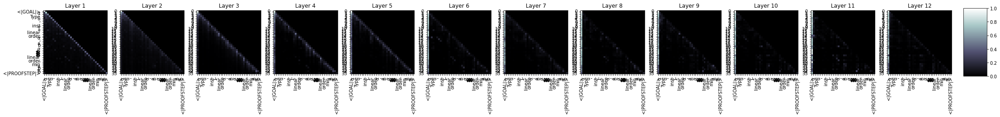

22400it [15:17, 22.13it/s]

  Step 22,400  of  147,271. Loss: 0.8500710129737854.   Elapsed: 0:15:18.
Sample:apply max_le_iff.1<|endoftext|><|PROOFSTEP|>apply le_self.mk_max<|endoftext|><|PROOFSTEP|>rintros ⟨⟩<|endoftext|><|PROOFSTEP|>exact ⟩<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>have := by<|endoftext|><|PROOFSTEP|>rintros ⟨⟩ ⟩<|endoftext|><|PROOFSTEP|>rintros ⟨⟩ ⟩<|endoftext|><|PROOFSTEP|>letI := {g : (← ↥, ↔ {G} × ↥), ihg, _, _, ihg_eq _}.symm<|endoftext|><|PROOFSTEP|>ext ⟨ihg⟩⟩<|endoftext|><|PROOFSTEP|>exists.elim<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>associates<|endoftext|><|PROOFSTEP|>subtype eq<|endoftext|>IH : IH xs H<|endoftext|><|PROOFSTEP|>ext.0.1 (H.1 (left H)).3 H, hf<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>s : hs<|endoftext|><|PROOFSTEP|>exists H<|endoftext|><|PROOFSTEP|>rw ← hsimp
s -> 0.2560935616493225
rw -> 0.21853305399417877
ex -> 0.1844344139099121
cases -> 0.0873604267835617
apply -> 0.08218217641115189
int -> 0.049602

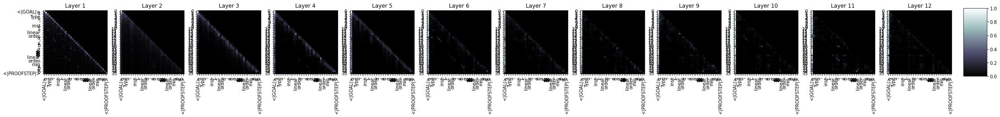

25598it [17:29, 26.81it/s]

  Step 25,600  of  147,271. Loss: 1.9975566864013672.   Elapsed: 0:17:29.
Sample:exact min_le_min b<|endoftext|><|PROOFSTEP|>apply min_le_max_iff_ne_top<|endoftext|><|PROOFSTEP|>apply mul_le_mem_one.1, le_self_iff.2<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>induction_pos λ a h a1 h2 H2<|endoftext|><|PROOFSTEP|>apply.infI<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>rw | ←IH<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp [h]<|endoftext|><|PROOFSTEP|>refine<|endoftext|>Ioc1₁ ⟨_₁, _₁, _₁, _₁, _₁, h₁, _₁, _₁, _₁, h₁, _₁, _₁⟩<|endoftext|><|PROOFSTEP|>sigma1 ⟨λ x,
s -> 0.4024915099143982
ex -> 0.15354177355766296
rw -> 0.1349698305130005
int -> 0.07203926146030426
cases -> 0.057555221021175385
apply -> 0.05222601443529129
have -> 0.043904371559619904
re -> 0.030975427478551865
ref ->

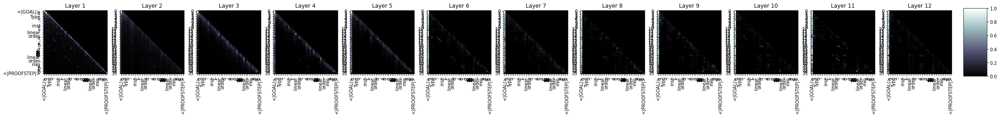

28798it [19:39, 22.13it/s]

  Step 28,800  of  147,271. Loss: 0.5238286852836609.   Elapsed: 0:19:40.
Sample:erw min_le_of_max a<|endoftext|><|PROOFSTEP|>apply le_top<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have : (1 : ℕ)⁻¹ ← ⟨1, 1'1, 1'2, 2⁻¹, h1⁻¹, h1,2⁻¹, h1,2,1⟩<|endoftext|><|PROOFSTEP|>refine κ 1_1_c : 1⁻¹ (2 : ℕ) ≠ 1⁻¹ c, _ (two_cancel_left_iff_ne' _)<|endoftext|><|PROOFSTEP|>simpa using (one_cancel_left_iff_ne' c h1 h2).1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>unival_ne<|endoftext|><|PROOFSTEP|>cases h1 : 1 <
s -> 0.39503416419029236
rw -> 0.17332184314727783
ex -> 0.13739289343357086
int -> 0.07164651900529861
cases -> 0.059139639139175415
apply -> 0.049620334059000015
have -> 0.039734479039907455
sim -> 0.027693411335349083
re -> 0.02433394640684

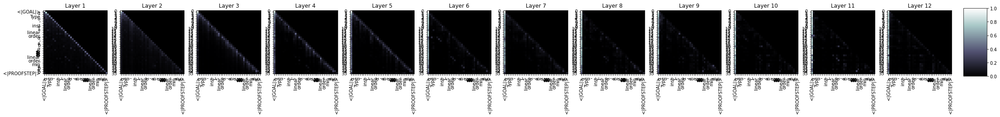

31999it [21:53, 23.35it/s]

  Step 32,000  of  147,271. Loss: 1.034801721572876.   Elapsed: 0:21:54.
Sample:rw [min_eq_max_iff]<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp only [pow_eq_self _ _]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intros_eq<|endoftext|><|PROOFSTEP|>simp [pow_eq_self _, nat_self, nat_self_self_lt]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp_mul<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>by @mihne_le_of_mem (mihne_le_of_mem) mihnow_dvd h : (intros).left.left_of_ne (mem_pow_eq_iff le_of_mem h)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ind<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact_instance<|endoftext|>eq_iff _<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ds<|endoftext|><|PROOFSTEP|>simp<|endoftext|>↩<|endoftext|><|PROOFSTEP|>cases_left<|endoftext|><|PROOFSTEP|>exact_const_left_symm
s -> 0.3659534156322479
rw -> 0.2

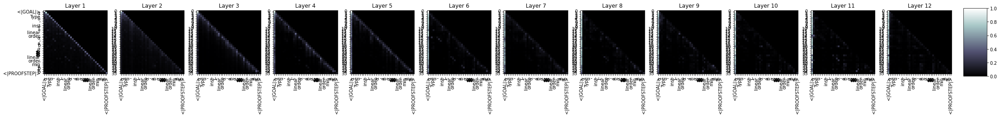

35200it [24:05, 23.81it/s]

  Step 35,200  of  147,271. Loss: 2.5901875495910645.   Elapsed: 0:24:06.
Sample:rwa min_le_min<|endoftext|><|PROOFSTEP|>apply le_antisymm<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [mul_one, mul_zero]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>classical<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_iff<|endoftext|>p<|endoftext|>Rp<|endoftext|>I : unique_factor_match<|endoftext|>B : nat.succ_eq_some ∘ (X Y), (X 0 : Y), ((X + (h X Y))⁻¹ X).ne_zero, (Y 0 : X ⊝ X).ne_zero, (Y 0 : Y ⊝ X).ne_zero, (Y 0 : Y ⊝ X).ne_zero, (Y 0 : X ⊝ Y).ne_zero)<|endoftext|><|PROOFSTEP|>exact mul_one _ _<|endoftext|><|PROOFSTEP|>s := mul_snd_le_of_
s -> 0.4834706783294678
rw -> 0.16325423121452332
ex -> 0.1479720026254654
apply -> 0.061477065086364746
int -> 0.034437395632267
have -> 0.02887616865336895
cases -> 0.025850828737020

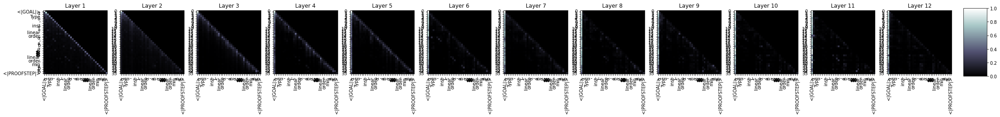

38399it [26:18, 26.83it/s]

  Step 38,400  of  147,271. Loss: 0.7142146825790405.   Elapsed: 0:26:18.
Sample:exactmax<|endoftext|><|PROOFSTEP|>constructor {re := min a, max b}<|endoftext|><|PROOFSTEP|>apply min_one<|endoftext|><|PROOFSTEP|>apply max_one<|endoftext|><|PROOFSTEP|>rintros ⟨⟩<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>intro x<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>b<|endoftext|><|PROOFSTEP|>apply_f_mem<|endoftext|>b<|endoftext|><|PROOFSTEP|>exact this<|endoftext|><|PROOFSTEP|>simp (h1)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|>A : (in b1, in b1) := b1, rfl<|endoftext|><|PROOFSTEP|>simp (h1)<|endoftext|><|PROOFSTEP|>apply_f_le<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw at one_memB<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>simp (h2 : sub_singleton)<|endoftext|><|PROOFSTEP|>simp : sub_singleton<|endoftext|><|PROOFSTEP|>apply_f<|e

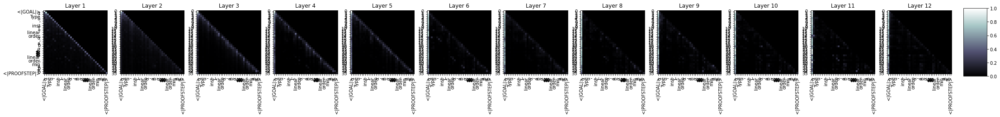

41599it [28:31, 22.97it/s]

  Step 41,600  of  147,271. Loss: 1.130303144454956.   Elapsed: 0:28:31.
Sample:cases a<|endoftext|><|PROOFSTEP|>try { refl}<|endoftext|><|PROOFSTEP|>show bool.sub_self 1 2 3 4 5<|endoftext|><|PROOFSTEP|>simp only [eq_sub_self] using sub_self.one<|endoftext|><|PROOFSTEP|>simp 1 2 3 4 5 6 7<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintro rfl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_rw ←⟨⟩<|endoftext|><|PROOFSTEP|>refl, rfl,<|endoftext|><|PROOFSTEP|><|endoftext|><|PROOFSTEP|>simp_mem_def<|endoftext|>n_cancel : C_lt_or_lt 2 < 0, C_lt_or_right 0, C_lt_right 0, ←←←simp_right<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>split_eq<|endoftext|><|PROOFSTEP|>simp_mem_inv<|endoftext|><|PROOFSTEP|>by_mem hsimp<|endoftext|>V<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_right<|endoftext|>mul := hsimp<|endoftext|>mul_lt_eq_eq_top (mem_le_
s -> 0.37886929512023926
rw -> 0.22891785204410553
ex -> 0.1497894823551178
apply -> 0.09641142934560776
ca

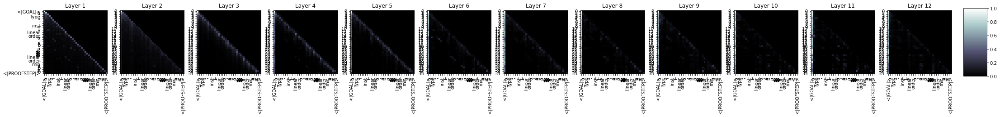

44800it [30:43, 27.60it/s]

  Step 44,800  of  147,271. Loss: 0.890296220779419.   Elapsed: 0:30:44.
Sample:intros<|endoftext|><|PROOFSTEP|>by_cases h0 : 0 < (1 : α) ^ 0<|endoftext|><|PROOFSTEP|>simp [one_ne_one]<|endoftext|><|PROOFSTEP|>mul : zero_add (1 : α) = 1 using mul_one_ne_one<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rintros ⟨ξ, _, f, hf, hf⟩<|endoftext|><|PROOFSTEP|>simp [(_, inv_, eq_one_ne_one] at hg.coe]<|endoftext|><|PROOFSTEP|>simp [one_ne_one] at hg.coe<|endoftext|><|PROOFSTEP|>simp [coe_one_ne_one]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>induction {right := nat.mul, left := hg.coe, by ntb<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rintrof {left := nat.topo with h, by ne, with h, hc, by h, a, by
s -> 0.39090946316719055
rw -> 0.21084442734718323
ex -> 0.14026327431201935
apply -> 0.09314072877168655
int -> 0.0536380372941494
cases -> 0.03223760798573494
have -> 0.027085034176707268
rint -> 0.0186696

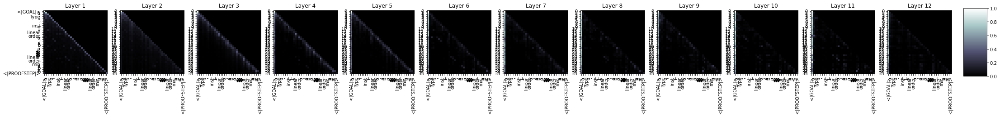

47998it [32:56, 26.67it/s]

  Step 48,000  of  147,271. Loss: 0.8540503978729248.   Elapsed: 0:32:56.
Sample:rw [le_max_left zn.max]<|endoftext|><|PROOFSTEP|>constructor<|endoftext|><|PROOFSTEP|>simp [left_comm, inv_of_mem x _]<|endoftext|><|PROOFSTEP|>ext r h<|endoftext|><|PROOFSTEP|>apply_bot'<|endoftext|><|PROOFSTEP|>by_cases h<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>t_left : 0 ≤ 2<|endoftext|><|PROOFSTEP|>simp_one : 0 ≤ 2<|endoftext|><|PROOFSTEP|>by_cases (zero_le_3_iff_nonneg_nonneg_of_le.2 : zero_lt_one)<|endoftext|><|PROOFSTEP|>rw h<|endoftext|><|PROOFSTEP|>apply_bot'<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_eq_nsmul_left<|endoftext|><|PROOFSTEP|>norm_div<|endoftext|><|PROOFSTEP|>rw one<|endoftext|><|PROOFSTEP|>refine_right.trans<|endoftext|><|PROOFSTEP|>simp in nat_le_2 at 2nd<|endoftext|><|PROOFSTEP|>apply_bit<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp_dist_right!<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_right_inv<|endoftext|><|PROO

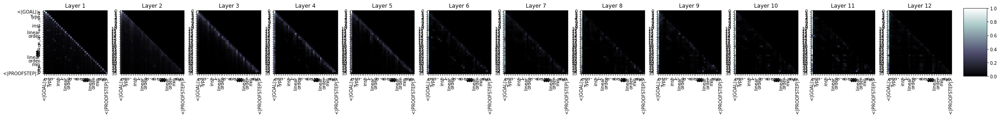

51198it [35:08, 24.16it/s]

  Step 51,200  of  147,271. Loss: 1.2912554740905762.   Elapsed: 0:35:08.
Sample:rw min_iff_zero at a<|endoftext|><|PROOFSTEP|>cases b<|endoftext|><|PROOFSTEP|>cases b<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>tactic.pi_instance_derive_field<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [left_mul, mul_right_comm, mul_iff_left, bx]<|endoftext|><|PROOFSTEP|>simp_apply<|endoftext|><|PROOFSTEP|>ring_of_sz : ⟨_, a, h, ⟨_, a, h⟩, rfl⟩<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s h1 h2<|endoftext|><|PROOFSTEP|>ext h3<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>s := le_trans.iff _ one_le, h2<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>rw ←refl<|endoftext|><|PROOFSTEP|>rw [set.coe_trans, set.coe_of_singleton_eq_self', set.coe_mul, set.coe_apply_def]<|endoftext|><|PROOFSTEP|>sz1 (
s -> 0.3030603528022766
rw -> 0.21103700995445251
ex -> 0.18384483456611633
apply -> 0.106743127107

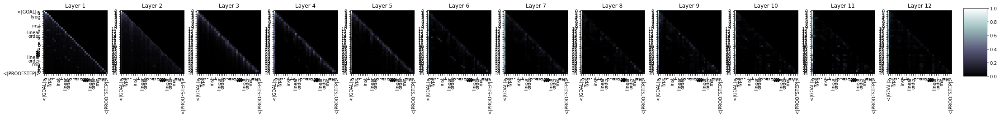

54400it [37:18, 24.10it/s]

  Step 54,400  of  147,271. Loss: 1.205257773399353.   Elapsed: 0:37:19.
Sample:rw min_le<|endoftext|><|PROOFSTEP|>split_ifs_not : is_closed (iff_unclosed (lt_iff_le.1 1))<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact le_or_lt_1.1 (int.iff_le _).1<|endoftext|><|PROOFSTEP|>have A : measurable_space (h0_space) (ha0_space) (h0_space.symm), (ne_top_ne_top (le_top_ne_top _)) := measurable_space.le_top_ne_top_eq.1<|endoftext|><|PROOFSTEP|>simp [ne_top]<|endoftext|><|PROOFSTEP|>rintro ⟨⟩<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases s<|endoftext|><|PROOFSTEP|>apply_factorial : ∀ (k : ℕ) (x : nat.lt _), nat.eq_top (lt_iff [lt_iff_eq_top] �
s -> 0.37010881304740906
rw -> 0.24282006919384003
ex -> 0.14355693757534027
apply -> 0.10113406926393509
int -> 0.0493757501244545
cases -> 0.030744710937142372
have -> 0.01969595067203045
re -> 0.015302343294024467
rint -> 0.014231638982892036
sim -> 0.01302

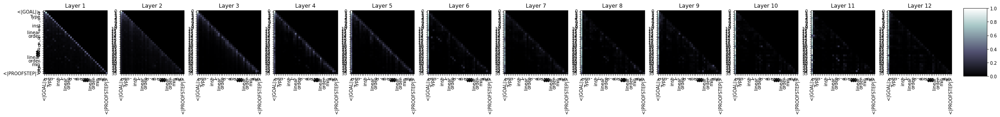

57600it [39:31, 22.71it/s]

  Step 57,600  of  147,271. Loss: 0.9085736870765686.   Elapsed: 0:39:31.
Sample:haveI := prime_min_left α<|endoftext|><|PROOFSTEP|>by_contradiction G i<|endoftext|><|PROOFSTEP|>simp only [of_real_mul_eq_left, of_real_mul_eq_left, of_real_sub_right]<|endoftext|><|PROOFSTEP|>assume<|endoftext|><|PROOFSTEP|>from is_prime_lt<|endoftext|><|PROOFSTEP|>simp only [one_apply, of_real_mul, ⟨mul_eq_left, of_real_eq_left, with_top_left]<|endoftext|><|PROOFSTEP|>rw [one_apply, of woman, with_top_left, with_top_left, with_top_left, ← [coe_eq_one_apply, ← [coe_not_coe, ← invert_coe, ← ← top_coe, ← with_top_le]<|endoftext|><|PROOFSTEP|>simp [1, h]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [← one
rw -> 0.320172518491745
s -> 0.2813970744609833
ex -> 0.15770380198955536
apply -> 0.10880051553249359
int -> 0.03711706027388573
cases -> 0.03466593101620674
have -> 0.021709568798542023
ref -> 0.013289815746247768
re -> 0.012972256168723106
rint -> 0.012171600945293903


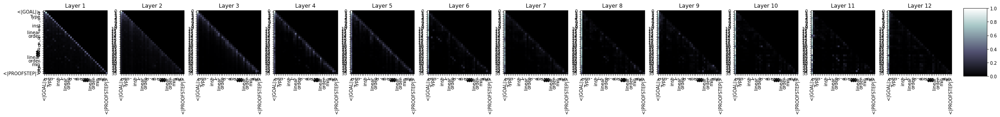

60798it [41:43, 28.19it/s]

  Step 60,800  of  147,271. Loss: 1.1398497819900513.   Elapsed: 0:41:44.
Sample:rw [←max_le_max, max_le_iff]<|endoftext|><|PROOFSTEP|>have : a < b<|endoftext|><|PROOFSTEP|>apply add_lt_add_left<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refine (← (le_trans.le_of_norm_of_pos_le _.refl _).comp<|endoftext|><|PROOFSTEP|>apply le_trans<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>sI : nat.is_prime ((prime_eq_zero.2) ⟨_,_,_,_,_,_,⟩⟩<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw ←preimage_ext<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>exists_exists<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>erw [preimage_exts, preimage_ext, ←self_image_mem, preimage_mem, preimage_iff]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp [one
s -> 0.2926882803440094
rw -> 0.2723875343799591
ex -> 0.18538159132003784
apply -> 0.09992178529500961
int -> 0.0

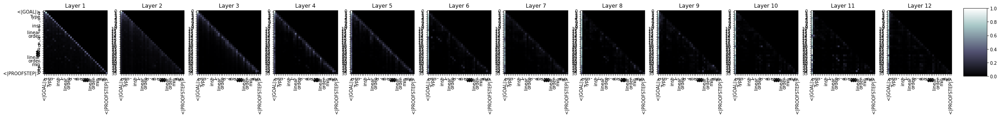

64000it [43:53, 25.68it/s]

  Step 64,000  of  147,271. Loss: 0.7429262399673462.   Elapsed: 0:43:54.
Sample:exact min_le_of_max a<|endoftext|><|PROOFSTEP|>rw [div_le_iff_and_subset_of_eq, coe_one, coe_mk, one_le, coeq.comm, neg_eq_iff'_iff', neg_eq_iff, neg_elim, sub_eq_iff_eq, neg_eq_iff_eq, one_le, one_lt'_iff']<|endoftext|><|PROOFSTEP|>exact (le_congr_right).symm<|endoftext|><|PROOFSTEP|>simp only [refl, subtype.coe_le_coe]<|endoftext|><|PROOFSTEP|>rw [mul, le_refl, alg, mul_mul]<|endoftext|><|PROOFSTEP|>let I := subtype.nat_eq_subtype.1.left<|endoftext|><|PROOFSTEP|>simp_one<|endoftext|><|PROOFSTEP|>simp_nonneg_coe_lhs<|endoftext|><|PROOFSTEP|>cases tl at rfl<|endoftext|><|PROOFSTEP|>simp : lt_
s -> 0.2951643168926239
rw -> 0.2228323072195053
ex -> 0.16162998974323273
apply -> 0.1252966970205307
cases -> 0.06903746724128723
int -> 0.039512019604444504
have -> 0.0313255749642849
re -> 0.020116740837693214
ref -> 0.01891639456152916
rint -> 0.016168510541319847


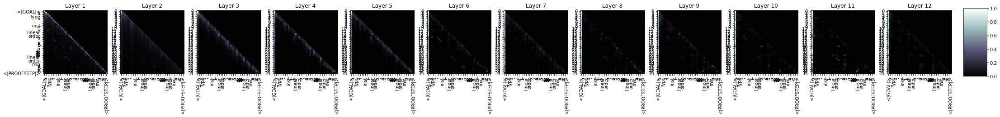

67200it [46:04, 23.60it/s]

  Step 67,200  of  147,271. Loss: 1.081089973449707.   Elapsed: 0:46:04.
Sample:exact min _<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>linarith<|endoftext|><|PROOFSTEP|>rw [mul_comm]<|endoftext|><|PROOFSTEP|>simp only [mul_mul, nnreal.comap_comm] using @nat.cast_left {to_pow := mul_left.mk.mp, ne_top := ne_top_iff _ }<|endoftext|><|PROOFSTEP|>apply mem_def_lt _<|endoftext|><|PROOFSTEP|>simp_cancel : cmp_def_lt, ←simp_cast_left<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_assoc : cmp_def_lt, comm_cancel_left, add_left_comm, add_left_comm, add_right_comm, ←cancel_a', add_right_comm, h, add_div_div_cancel<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>by_cases : (real.intro.cancel_cancel
s -> 0.3440401256084442
rw -> 0.22794748842716217
ex -> 0.13661889731884003
apply -> 0.08422008901834488
cases -> 0.07605516910552979
int -> 0.05683169886469841
have -> 0.02338453009724617
re -> 0.02000768855214119
ref -> 0.01693595

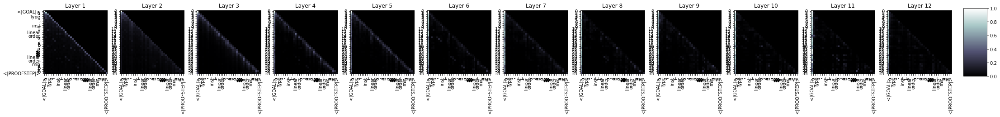

70399it [48:17, 20.97it/s]

  Step 70,400  of  147,271. Loss: 0.922132670879364.   Elapsed: 0:48:17.
Sample:exact min_dist<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp [div_eq_bot_iff_eq_bot, nat.min_min] {rwa [bot_eq_false, bool.pos, bot_eq_false, nat.eq_iff_false, ne_bot, [eq_bot_iff_eq_bot, nat.eq_bot, bool.lt_bot]}<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance.elim (const (set.univ.bundle_eq_distrib 0) at finset.univ<|endoftext|><|PROOFSTEP|>contradiction<|endoftext|><|PROOFSTEP|>have : nonrec_semiring ⟨λ h, h1, h2⟩ := le_antisymm<|endoftext|><|PROOFSTEP|>apply_instance.1 (const _)<|endoftext|><|PROOFSTEP|>induction ⟨g, rfl⟩ := λ b, l⟩<|endoftext|><|PROOFSTEP|>
s -> 0.239308163523674
rw -> 0.22648382186889648
ex -> 0.22510592639446259
apply -> 0.09751163423061371
cases -> 0.07859624922275543
int -> 0.059183236211538315
have -> 0.02286526747047901
re -> 0.019262051209807396
by -> 0.015871481969952583
ref -> 0.015

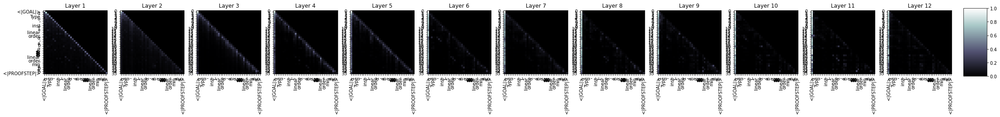

73600it [50:28, 27.59it/s]

  Step 73,600  of  147,271. Loss: 0.8309729099273682.   Elapsed: 0:50:29.
Sample:simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>apply_instance_derive_field<|endoftext|><|PROOFSTEP|>apply h<|endoftext|><|PROOFSTEP|>apply le_of_le.symm<|endoftext|><|PROOFSTEP|>apply h<|endoftext|><|PROOFSTEP|>apply_instance_derive_field<|endoftext|><|PROOFSTEP|>apply_instance_derive_neg<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refine (prod (refl' : (le_of_right h) (nat_pos _) : ←nat_pos _, nnreal.trans hn0, hn0 : ⟨0, nat_pos_left_one, nat_pos_right⟩, nat_pos _⟩<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>show nat.zero_ne_zero.1 (0 : 1), 0 : 1 0 at this := 0<|endoftext|><|PROOFSTEP|>simp only [zero_ne_zero
s -> 0.2598974406719208
rw -> 0.20884102582931519
ex -> 0.1876

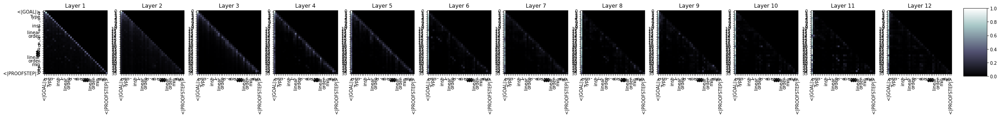

76798it [52:41, 26.07it/s]

  Step 76,800  of  147,271. Loss: 1.1721540689468384.   Elapsed: 0:52:42.
Sample:simp [linear_order.max_le]<|endoftext|><|PROOFSTEP|>change (λ x hx : {i // i < x}) = _<|endoftext|><|PROOFSTEP|>simp [zero_lt_one, zero_lt_one]<|endoftext|><|PROOFSTEP|>rw [eq_neg, int.zero_lt_one, int.neg_neg]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp [le_neg, le_refl, eq_or_lt_le]<|endoftext|><|PROOFSTEP|>rw [lt_two, le_one]<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [← a, a' (le_one_one, one_le, ne.one_one] at *, h, le_one, one_one_compl, h]<|endoftext|><|PROOFSTEP|>simp [one_eq]<|endoftext|><|PROOFSTEP|>rw [← one_eq one_le_one]<|endoftext|><|PROOFSTEP|>rw [← one_right, [one_eq]<|endoftext|>
s -> 0.31508007645606995
rw -> 0.22050130367279053
ex -> 0.16123130917549133
apply -> 0.07535400241613388
int -> 0.05998453125357628
norm -> 0.054715488106012344
cases -> 0.045085106045007706
have -> 0.0257928017526865
sim -> 0.0231329798698

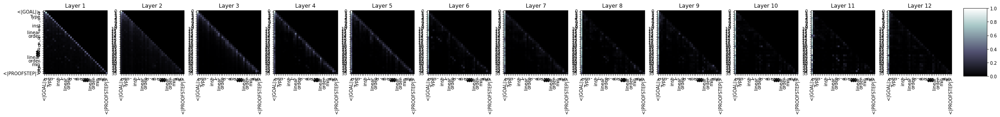

79998it [54:52, 28.62it/s]

  Step 80,000  of  147,271. Loss: 1.380077600479126.   Elapsed: 0:54:53.
Sample:rw [← min_lt_add_sub, max_le_iff]<|endoftext|><|PROOFSTEP|>rcases le_top with ⟨j hj, hj₁ hj₂⟩<|endoftext|><|PROOFSTEP|>have I : ℕ := classical.dec_eq_top<|endoftext|><|PROOFSTEP|>apply ⟨q, hq, hrc₁ hrc₂<|endoftext|><|PROOFSTEP|>simpa using /.<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp_rw [apply_inv, finset.singleton_subset]<|endoftext|><|PROOFSTEP|>change ae_eq_top : is_open <3 | rfl<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>exact this_apply at_le<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>rw [← of_true, one_le, finset_exists_true_iff]<|endoftext|><|PROOFSTEP|>cases' ae_iff<|endoftext|><|PROOFSTEP|>refine_eq_forall_le, h<|endoftext|><|PROOFSTEP|>exact (forall
s -> 0.29654812812805176
rw -> 0.20710352063179016
ex -> 0.18938887119293213
apply -> 0.13207055628299713
int -> 0.04280324652791023
cases -> 0.0367632620036602
norm -> 0.03400532528758049
have -> 0.0218593422323465

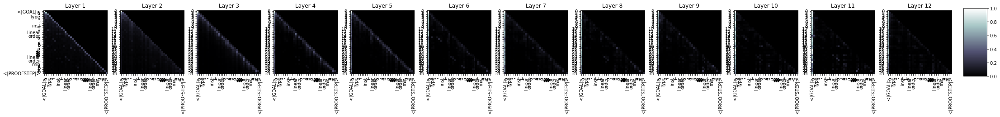

83198it [57:04, 24.87it/s]

  Step 83,200  of  147,271. Loss: 1.6292455196380615.   Elapsed: 0:57:04.
Sample:simp<|endoftext|><|PROOFSTEP|>refine le_intro _ _<|endoftext|><|PROOFSTEP|>apply le_trans_iff.symm<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>by_cases h1 : (1 : mv_polynomial α) = 0<|endoftext|><|PROOFSTEP|>simpa only [zero_pos] using finset_succ' 1 (add_le_iff : ∀) (m n, add_right : ℂ₂, n.le_add₂ (m n), mul_add_iff0) (add_inj $ (max_le _ _ _) (le_of_ne_zero $ finset.elim hn), using le_one]<|endoftext|><|PROOFSTEP|>have := (1 : finset (h : 1 ≠ 0))<|endoftext|><|PROOFSTEP|>s, rfl : ∀ (s : finset (h : 1 =
s -> 0.3244059681892395
rw -> 0.16279365122318268
ex -> 0.1586274951696396
apply -> 0.15466442704200745
int -> 0.04807639122009277
norm -> 0.04545781761407852
cases -> 0.03556559234857559
ref -> 0.026483139023184776
have -> 0.024801427498459816
spli

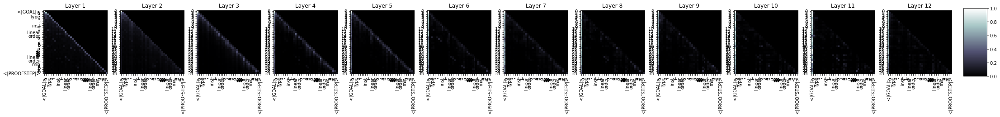

86399it [59:16, 21.55it/s]

  Step 86,400  of  147,271. Loss: 0.9260796308517456.   Elapsed: 0:59:17.
Sample:simp [(min_lt_one, min_lt_one, int.sub_eq_zero] (int.sub_eq_zero_iff.1 b))<|endoftext|><|PROOFSTEP|>rwa [sub_eq_zero_iff, add_div_right, sub_eq_zero, ← sub_eq_zero_iff]<|endoftext|><|PROOFSTEP|>simp [add_assoc]<|endoftext|><|PROOFSTEP|>simp [one_div]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_rw [one_div]<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>use.mem_singleton<|endoftext|><|PROOFSTEP|>apply_self.2.1<|endoftext|><|PROOFSTEP|>apply_self.2.1.is_lt<|endoftext|><|PROOFSTEP|>apply_self.2.3.5 : fintype.card = 0, (hdf := _, hdf_eq_zero)<|endoftext|><|PROOFSTEP|>solve_of_nat_zero_le<|endoftext|><|PROOFSTEP|>exists_is_lt (nat_eq_zero_le
s -> 0.34365546703338623
rw -> 0.25881317257881165
ex -> 0.11462181061506271
apply -> 0.08715461194515228
cases -> 0.04767050966620445
norm -> 0.043111592531204224
int -> 0.03458218649029732
have -> 0.030984140932559967
ref -> 0.021392200142145157
s

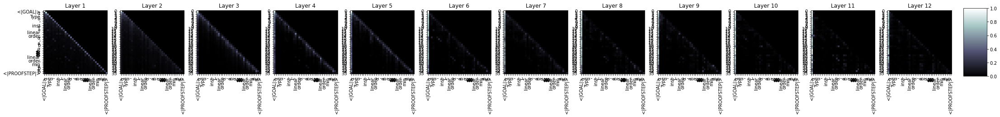

89598it [1:01:28, 21.80it/s]

  Step 89,600  of  147,271. Loss: 1.0280247926712036.   Elapsed: 1:01:29.
Sample:split<|endoftext|><|PROOFSTEP|>rw add_comm<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>simp * {re := nsmul, h}<|endoftext|><|PROOFSTEP|>rw [nsmul, ← mul_add, ← mul_div_cancel_left, ← nsmul_div_cancel]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>t_rw ← int.fib_zero<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [← int.fib_zero]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw ← (sub_eq_one_iff_lt_zero)<|endoftext|><|PROOFSTEP|>exists_eq_zero<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have<|endoftext|>pow := (neg := h.neg)<|endoftext|><|PROOFSTEP|>rw neg_lt_one_of_neg<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases_le<|endoftext|>c<|endoftext|><|PROOFSTEP|>apply_instance.mpr<|endoftext|><|PROOFSTEP|>try {to_jordan := λ.cases_eq_zero_one,
s -> 0.36601608991622925
rw -> 0.30478921532630

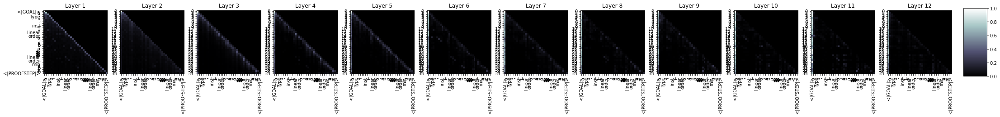

92800it [1:03:40, 25.04it/s]

  Step 92,800  of  147,271. Loss: 2.493342161178589.   Elapsed: 1:03:41.
Sample:norm_num<|endoftext|><|PROOFSTEP|>funext a<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>subsetfunext<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>by_cases {b} using :_true, {b} using<|endoftext|><|PROOFSTEP|>simp using intros<|endoftext|>U<|endoftext|><|PROOFSTEP|>b<|endoftext|><|PROOFSTEP|>unfoldU<|endoftext|>f : fintype ℝ := nat.succ_eq_of_lt<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>simpa only using a ⟨⟩<|endoftext|><|PROOFSTEP|>converg<|endoftext|><|PROOFSTEP|>by _<|endoftext|>IH : ¬⟨⟩,<|endoftext|><|PROOFSTEP|>exact ennreal.symm<|endoftext|><|PROOFSTEP|>converg.1<|endoftext|><|PROOFSTEP|>simp only x xs<|endoftext|><|PROOFSTEP|>exact_strict_def<|endoftext|>1<|endoftext|><|PROOFSTEP|>exact_strict_def1 (strict_def.2.1.1 (a.symm (H : real.comp (algebra_univ)) (a.symm (h : �
s -> 0.3107861280441284
rw -> 0.24940165877342224
ex -> 0.1383093297481537
apply -> 0.102580264210

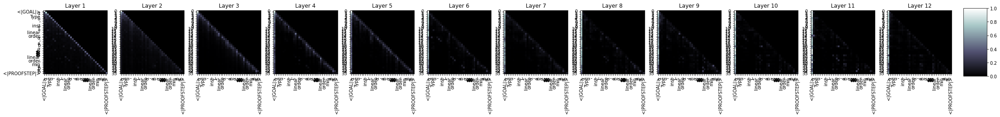

95998it [1:05:51, 27.92it/s]

  Step 96,000  of  147,271. Loss: 0.9256073832511902.   Elapsed: 1:05:52.
Sample:rw [min_le_min, min_comm, mul_comm]<|endoftext|><|PROOFSTEP|>simp [ne_zero]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>have : ∀ (n : ℕ), ae_real.ne_zero = n, ae_real.ne_zero<|endoftext|><|PROOFSTEP|>have : ∀ (n : ℕ), ae gets<|endoftext|><|PROOFSTEP|>apply congr_arg (nat.le_zero _ _)<|endoftext|><|PROOFSTEP|>simp_rw [hahn.comp, hahn_comp, ae_ne_zero]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>have : ae_real.ne_zero = 0_nhds with hd<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact hsimp<|endoftext|><|PROOFSTEP|>trivian<|endoftext|><|PROOFSTEP|>norm_ne_zero_of_mem<|endoftext|><|PROOFSTEP|>cases ht<|endoftext|><|PROOFSTEP|>have<|endoftext|>d_mem_pow_mem<|endoftext|><|PROOFSTEP|>rw [← hsimp.mem_pow
s -> 0.3461153209209442
rw -> 0.16804969310760498
ex -> 0.14646096527576447
cases -> 0.09777035564184189
apply -> 0.09402205795049667
norm -> 0.03724984824

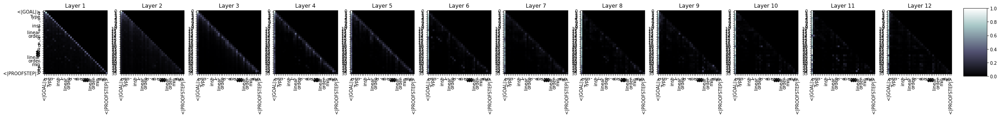

99200it [1:08:03, 26.02it/s]

  Step 99,200  of  147,271. Loss: 1.0278427600860596.   Elapsed: 1:08:04.
Sample:norm_cast<|endoftext|><|PROOFSTEP|>refine ⟨_, _⟩<|endoftext|><|PROOFSTEP|>apply h2<|endoftext|><|PROOFSTEP|>rw←image.comp_eq_symm h<|endoftext|><|PROOFSTEP|>convert H2<|endoftext|><|PROOFSTEP|>inoc (inhabited.default.default)<|endoftext|><|PROOFSTEP|>rw [←inhabited.set_compl, set.compl_one]<|endoftext|><|PROOFSTEP|>rintros (pi_pi_pi_of_ne h2inoc, h2inoc h2inoc) (pi_pi_of_ne h2inoc h2inoc)<|endoftext|><|PROOFSTEP|>rw ←rintros<|endoftext|><|PROOFSTEP|>s h2<|endoftext|><|PROOFSTEP|>exact ⟨pi_x, e, rfl⟩<|endoftext|><|PROOFSTEP|>refine @gcd_sub { _rec_right, pi_x,<|endoftext|><|PROOFSTEP|>refine ⟨i, rfl⟩<|endoftext|><|PROOFSTEP|>rw [←refl, add_ne, add_le, �
s -> 0.25358298420906067
ex -> 0.21618524193763733
rw -> 0.2128518670797348
cases -> 0.08773786574602127
apply -> 0.0854969322681427
have -> 0.04025560989975929
norm -> 0.037004370242357254
int -> 0.024233832955360413
re -> 0.02226206474006176
ref -> 0.02038

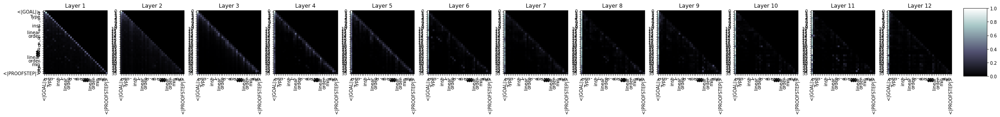

102398it [1:10:15, 24.85it/s]

  Step 102,400  of  147,271. Loss: 1.4521082639694214.   Elapsed: 1:10:16.
Sample:exact min_le_min_self b a<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_nonneg<|endoftext|><|PROOFSTEP|>cases h<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [apply_empty]<|endoftext|><|PROOFSTEP|>exists_true_of_true_eq_empty_of_not_true (exists_true_of_true_eq_self_of_true_eq_false.symm)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_self_of_true_eq_true_by_symm<|endoftext|><|PROOFSTEP|>simpa [is_exists_false_iff_false]<|endoftext|><|PROOFSTEP|>apply_equiv<|endoftext|><|PROOFSTEP|>apply_self_of_true_eq_true_by_symm at ⊢<|endoftext|><|PROOFSTEP|>apply_self_of_true_eq_true_by_symm at ⊢<|endoftext|><|PROOFSTEP|><|endoftext|><|PROOFSTEP|>simp [pow_nat]<|endoftext|><|PROOFSTEP|>exists_false<|endoftext|><|PROOFSTEP|>let h :=
ex -> 0.2864646315574646
s -> 0.23708787560462952
cases -> 0.1214127168059349
rw -> 0.1

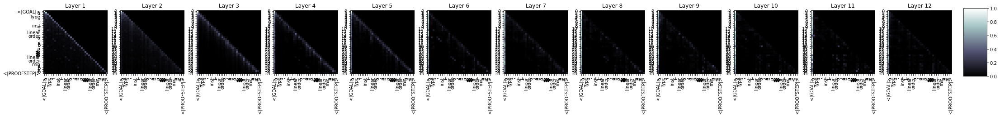

105598it [1:12:27, 26.36it/s]

  Step 105,600  of  147,271. Loss: 0.9282168745994568.   Elapsed: 1:12:27.
Sample:simpa [le_max_add, min_max_left] using min_max_le_max_left_le.2 b<|endoftext|><|PROOFSTEP|>convert quotient.subtype_pos_of_lt<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refine le_trans _ (prod.rec_norm_right ⟨λ h, _, _⟩)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rintros ⟨δ_, δ⟩<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>rw [← eq_comm, ← eq_right_iff, ← eq_right_id, ← eq_comm]<|endoftext|><|PROOFSTEP|>let f := λ h, eq_associated_of_eq_inl (inr_lt_of_eq_inr (inr_iff_mul_le_left_iff (le_iff_right_inr_lt_iff_iff_right
s -> 0.2744165062904358
ex -> 0.22638551890850067
rw -> 0.17502279579639435
apply -> 0.09073898941278458
cases -> 0.07553956657648087
have -> 0.040713950991630554
int -> 0.03914593532681465
norm -> 0.02863955684006214
re -> 0.026983261108398438
ref -> 0.022413941100239754


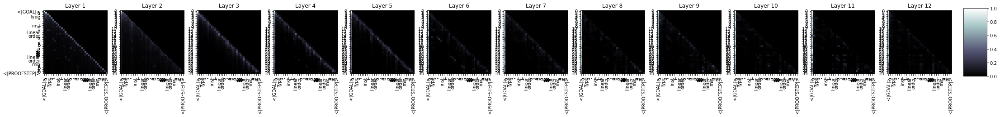

108798it [1:14:40, 24.14it/s]

  Step 108,800  of  147,271. Loss: 0.946860134601593.   Elapsed: 1:14:41.
Sample:ext<|endoftext|><|PROOFSTEP|>simpa [sub_eq_neg] using mod_coe_left_mul_neg (nat.balt_of_le_iff_neg_left (abs_le_coe_le_coe _))<|endoftext|><|PROOFSTEP|>simp [balt_of_le_iff_neg_right]<|endoftext|><|PROOFSTEP|>simp [balt_of_le_iff_neg_right]<|endoftext|><|PROOFSTEP|>to_trivial_div_eq_lt_self_iff_le'<|endoftext|><|PROOFSTEP|>left_comp_left<|endoftext|><|PROOFSTEP|>haveI := (trivial.balt_eq_neg_left _).mp {b, _, (div_iff_balt_eq_neg_left_div_iff).1}<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact @balt_eq_neg_left _ at (1:balt_le_balt _).prod simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>
s -> 0.3164096176624298
rw -> 0.17686907947063446
ex -> 0.1548336297273636
cases -> 0.12418898195028305
apply -> 0.06824225187301636
int -> 0.05910269543528557
have -> 0.032022710889577866
norm -> 0.02807009592652321
re -> 0.022598836570978165
ref -> 0.01766207069158554


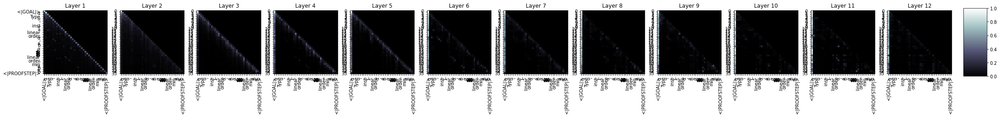

112000it [1:16:53, 24.72it/s]

  Step 112,000  of  147,271. Loss: 1.2028546333312988.   Elapsed: 1:16:53.
Sample:apply max_le_top<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have := min hs_max with hs_div :<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>simpa using int.ext x<|endoftext|><|PROOFSTEP|>exact not_inj_mem_eq_zero.1.1<|endoftext|><|PROOFSTEP|>apply_image_sup rfl<|endoftext|><|PROOFSTEP|>congr<|endoftext|><|PROOFSTEP|>exact not_inj_mem_right<|endoftext|><|PROOFSTEP|>exact (not_true_left<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simpa only [left_inj_eq_lt] using with_basis<|endoftext|><|PROOFSTEP|>s ih<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>delta ih<|endoftext|>₁<|endoftext|><|PROOFSTEP|>exact (with_basis_pow_zero]<|endoftext|><|PROOFSTEP|>by simp<|endoftext|>b<|endoftext|><|PROOFSTEP|>refl A_by_id<|endoftext|>�<|endoftext|><|PROOFSTEP|>exact set_of_le<|endoftext|>₁_dvd.1<|endoftext|><|PROOFSTEP|>have : ⟨a,b
s -> 0.276673

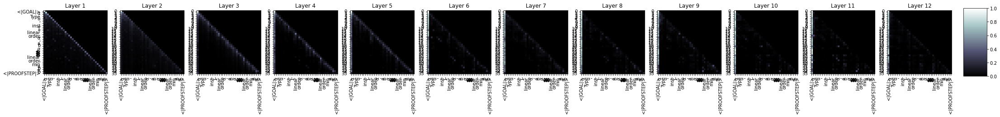

115199it [1:19:06, 22.18it/s]

  Step 115,200  of  147,271. Loss: 1.0756592750549316.   Elapsed: 1:19:07.
Sample:intro h<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>cases b<|endoftext|><|PROOFSTEP|>rw [one_div_neg, one_div_lt]<|endoftext|><|PROOFSTEP|>simpa [one_div_lt, one_div_pos]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>split_pos<|endoftext|><|PROOFSTEP|>have := eq<|endoftext|>n_pos _<|endoftext|><|PROOFSTEP|>have := eq_neg_neg _<|endoftext|>⟨⟨x, hx₁, hx₂, hx₁⟩⟨⟨p, hp₁, hp₁⟩⟨p, hp₁, hp₁⟩⟩⟩<|endoftext|><|PROOFSTEP|>rw [← h, ← eq_neg_neg, hp0, hp0, hp0, hm0]<|endoftext|><|PROOFSTEP|>dsimp<|endoftext|><|PROOFSTEP|>exact λ (f, _, _), (p.
s -> 0.2063089907169342
cases -> 0.20498459041118622
ex -> 0.20139209926128387
rw -> 0.16437974572181702
apply -> 0.07836366444826126
int -> 0.05098787695169449
have -> 0.028817659243941307
re -> 0.02441318705677986
norm -> 0.021126925945281982
ext -> 0.019225317984819412


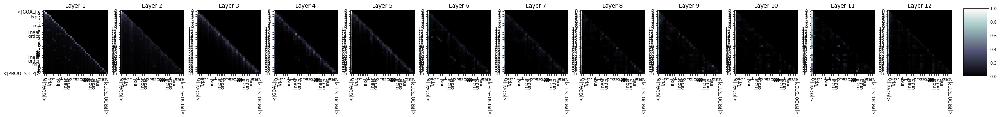

118398it [1:21:18, 24.26it/s]

  Step 118,400  of  147,271. Loss: 0.6213534474372864.   Elapsed: 1:21:19.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>assumption<|endoftext|><|PROOFSTEP|>exact_mod_cast<|endoftext|>1 : (x.to_nat_iff_eq_self_iff).symm<|endoftext|><|PROOFSTEP|>induction_left<|endoftext|>(finset.induction_right {to_nat_iff := this}) with ⟨c, i, g, hc, hg, hg, hx, _, a, rfl, hb, hy⟩<|endoftext|><|PROOFSTEP|>induction_eq_top<|endoftext|><|PROOFSTEP|>simpa [induction_left, nhds.coe_zero] using ⟨C, i, c, hc, hc, hg, hx, rfl, hx, rfl, hx, _, hf, _, _, hc, rfl, hc, rfl, hf, h
s -> 0.2699248492717743
ex -> 0.2239563763141632
cases -> 0.12335205078125
rw -> 0.1205662190914154
apply -> 0.11779452860355377
int -> 0.056905731558799744
have -> 0.029255766421556473
norm -> 0.02305927500128746
re -> 0.01763886772096157
ext -> 0.017546353861689568


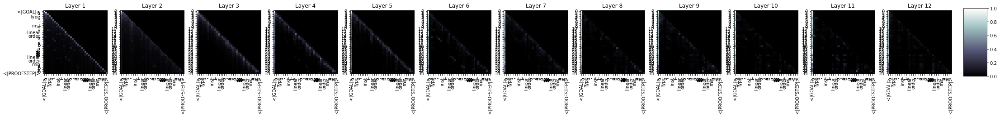

121599it [1:23:30, 24.25it/s]

  Step 121,600  of  147,271. Loss: 0.6603487730026245.   Elapsed: 1:23:30.
Sample:split<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_refl<|endoftext|>a [1]<|endoftext|><|PROOFSTEP|>induction h1 h2<|endoftext|>by simp only [induction_h1, of_true, 1_true, 2_true, hy, le_1, ha2]<|endoftext|><|PROOFSTEP|>simp only [set_eq_one, of_true]<|endoftext|><|PROOFSTEP|>refine_single using if_false (set_eq_one)<|endoftext|><|PROOFSTEP|>simp at h1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp3 [1]<|endoftext|><|PROOFSTEP|>apply_self<|endoftext|>I {inh, is_true, not_true} using<|endoftext|><|PROOFSTEP|>rw [false_eq_one]<|endoftext|><|PROOFSTEP|>clear2 {to_true, one_true, inh, not_true}<|endoftext|><|PROOFSTEP|>apply.rec<|endoftext|><|PROOFSTEP|>refine_one<|endoftext|><|PROOFS

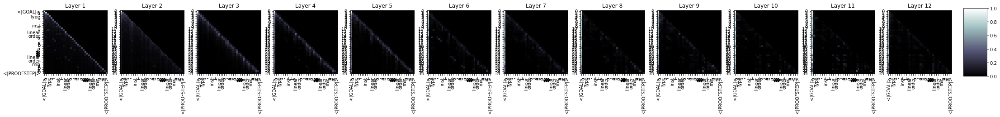

124800it [1:25:43, 27.09it/s]

  Step 124,800  of  147,271. Loss: 0.9556509256362915.   Elapsed: 1:25:43.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>exact min_mem_of_true a.2.zero_le<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intros jHne a hne<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext jHne<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact (mem_image_of_false_of_to_lt.2 hne_image_of_mem.2 hne] (image(iff_eq_top.2_mem_left)<|endoftext|><|PROOFSTEP|>exists set.mem_center (mem_nhds (set_of_image_of_iff_ne_top (lt_image_right hne)).symm) hsymm<|endoftext|><|PROOFSTEP|>exists ⟨t : set i, ereal a, (IH : IH i = ∀ {x : i, iH : i's_to_top.1 hne} x, x + i.to_top.2 h
s -> 0.3733176589012146
ex -> 0.17957472801208496
cases -> 0.10950196534395218
rw -> 0.10942064970731735
apply -> 0.09341488778591156
int -> 0.041901059448719025
have -> 0.0319894440472126
re -> 0.02057388611137867
norm -> 0.02026338130235672
ext -> 0.02004232257604599


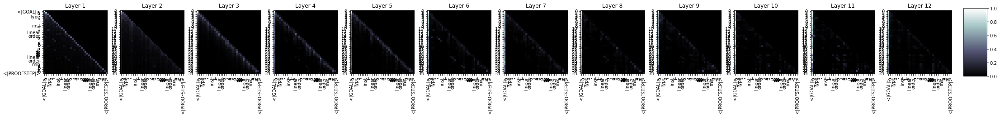

127999it [1:27:56, 25.35it/s]

  Step 128,000  of  147,271. Loss: 0.9077692627906799.   Elapsed: 1:27:57.
Sample:rw [←max_comm, max_comm]<|endoftext|><|PROOFSTEP|>simp [h]<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>use_def.one _<|endoftext|><|PROOFSTEP|>cases_nonneg a hb with a hb hb<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [mul_right_left, hb.2, or.1_or, (mem_self _).1_or, or.1_lt] using (or.1_or, or.1_lt, hb.1_or, hb.2_or, hb.2_lt, (mem_self _).1_or, (mem_self _).1_or, _or, (hb.1_or, hb.2_or, hb.2_lt hb.2_lt, hb.1_lt, [eq_or, or.1_or, hb.2_or, h
s -> 0.4322107434272766
ex -> 0.1710730344057083
cases -> 0.10817372798919678
rw -> 0.0839313492178917
apply -> 0.0680873692035675
int -> 0.06251265853643417
have -> 0.02063683234155178
re -> 0.018238620832562447
split -> 0.01762021705508232
ext -> 0.017515337094664574


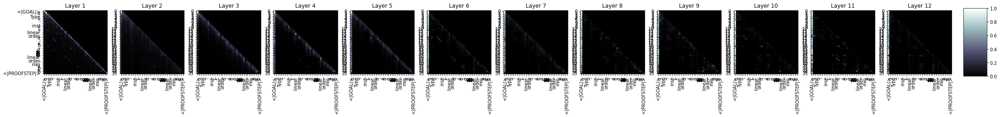

131199it [1:30:09, 24.37it/s]

  Step 131,200  of  147,271. Loss: 0.6124062538146973.   Elapsed: 1:30:09.
Sample:cases a<|endoftext|><|PROOFSTEP|>exact eq_comm _<|endoftext|><|PROOFSTEP|>intros h<|endoftext|><|PROOFSTEP|>cases_of_le<|endoftext|><|PROOFSTEP|>cases_of dB<|endoftext|><|PROOFSTEP|>assumption<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>haveI := eq_eq_coe hf<|endoftext|>1<|endoftext|><|PROOFSTEP|>by simp only [eq_comm]<|endoftext|><|PROOFSTEP|>exact eq_comm<|endoftext|>Pow_def with e_def<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases<|endoftext|>c<|endoftext|>I : e<|endoftext|>niv := e := eq_pow_def.2<|endoftext|><|PROOFSTEP|>rintros ⟨ rfl⟩<|endoftext|><|PROOFSTEP|>cases_of_not_pow_eq<|endoftext|>b<|endoftext|><|PROOFSTEP|>intro<|endoftext|>IH<|endoftext|><|PROOFSTEP|>have : (λ (p : hf.symm), p.to_real, hf.symm) : p < hf.symm<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only 

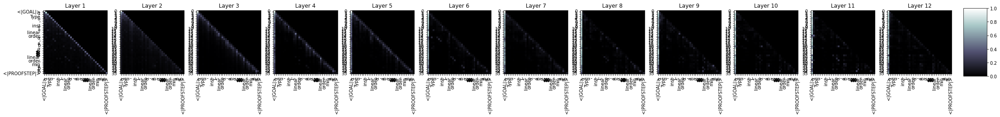

134400it [1:32:20, 22.29it/s]

  Step 134,400  of  147,271. Loss: 0.7542566061019897.   Elapsed: 1:32:21.
Sample:refl<|endoftext|><|PROOFSTEP|>simp only [div_eq_zero_iff, zero_add, add_neg, add_comm, div_add_eq_one]<|endoftext|><|PROOFSTEP|>simp only [div_eq_zero, neg_mul, neg_mul_iff_not_neg, neg_mul_eq_one_neg, multiplicative_eq_zero] at *<|endoftext|><|PROOFSTEP|>injection_true<|endoftext|><|PROOFSTEP|>s : (real.pow_pos bool.1 (lt_le_of_lt (pow_pos_lt_zero_iff.2.1 (pow_neg_lt_one_iff (le_lt_one_iff_coe_zero_iff.1 $ (lt_nonneg_le_nonneg : nonpos_nonneg) (neg_le_one_iff_eq_zero : zero_nonneg)) 0)) (λ y, (neg_le
s -> 0.4570411741733551
ex -> 0.12381117045879364
rw -> 0.11475443840026855
cases -> 0.08611792325973511
apply -> 0.08209862560033798
int -> 0.03992354869842529
have -> 0.036146294325590134
split -> 0.020754894241690636
re -> 0.0197627991437912
ref -> 0.019589079543948174


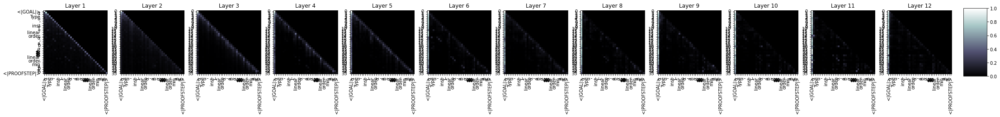

137598it [1:34:32, 25.34it/s]

  Step 137,600  of  147,271. Loss: 0.6722684502601624.   Elapsed: 1:34:32.
Sample:norm_num<|endoftext|><|PROOFSTEP|>intros x f g<|endoftext|><|PROOFSTEP|>simp [div_eq_comm]<|endoftext|><|PROOFSTEP|>simp_rw [add_comm]<|endoftext|><|PROOFSTEP|>simp [div_eq_comm]<|endoftext|><|PROOFSTEP|>dsimp<|endoftext|><|PROOFSTEP|>exact (1:vow_of_eq_right_zero_one_left_of_le_one_nonneg f (pow_left_of_neg iow_zero_one.mpr f $ inv.mpr (le_of_le_one _ (zero_le.0 _))])<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply {to : ∀ (t : pos_neg (x : pos_neg (x : pos_pos))) := pow_neg<|endoftext|><|PROOFSTEP|>rintros ⟨h₁ : h₂⟩<|endoftext|><|PROOFSTEP|>exists (of_mem<|endoftext|><|PROOFSTEP|>apply h₁ : {zero, h₁]})
s -> 0.5566015243530273
rw -> 0.12013234198093414
ex -> 0.09457538276910782
cases -> 0.0729139968752861
apply -> 0.04453081637620926
have -> 0.030354870483279228
int -> 0.02734014205634594
re -> 0.020619086921215057
split -> 0.017808903008699417
ref -> 0.015122899785637856


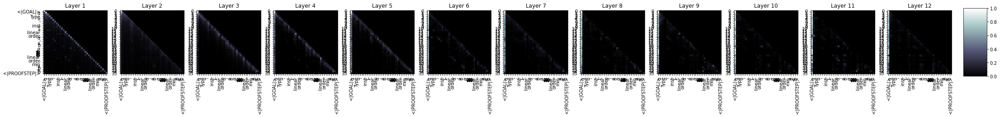

140799it [1:36:44, 27.05it/s]

  Step 140,800  of  147,271. Loss: 0.8037955164909363.   Elapsed: 1:36:44.
Sample:rw [←min_min, max_le_max, max_le_max, max_le_min]<|endoftext|><|PROOFSTEP|>rintro ⟨⟨c, hc⟩, h₁, hc₂, x, hx₁, hx₂, hx₃, hx₃⟩<|endoftext|><|PROOFSTEP|>simpa only [c, hC, hc, hx, zero_lt_cancel hc] using nat.le_zero<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refine le_im_lt_right_of_lt {b} _ _ | ne_b _ {refl, add (ne.symm_b_right _), add_le }<|endoftext|><|PROOFSTEP|>simpa.ne_of_lt<|endoftext|><|PROOFSTEP|>refine le_im_lt_right_of_lt _<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>rintro ⟨
s -> 0.3655203878879547
rw -> 0.21701520681381226
ex -> 0.11447834968566895
cases -> 0.0943974107503891
apply -> 0.05617530643939972
have -> 0.043801434338092804
int -> 0.043045807629823685
re -> 0.029327353462576866
split -> 0.018450036644935608
ref -> 0.01778871938586235


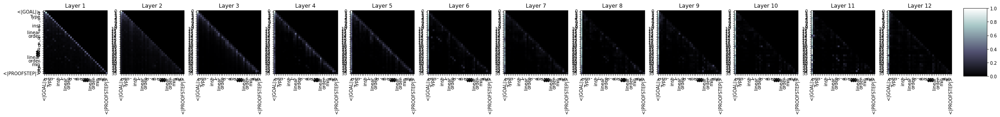

143998it [1:38:55, 24.36it/s]

  Step 144,000  of  147,271. Loss: 1.1050519943237305.   Elapsed: 1:38:55.
Sample:have := min_left_le_sum (max_lt_max b a) (max_le_max b a)<|endoftext|><|PROOFSTEP|>induction x with i hx i i' i'<|endoftext|><|PROOFSTEP|>rintros ⟨i'⟩ ⟨h'⟩<|endoftext|><|PROOFSTEP|>rintros ⟨x⟩<|endoftext|><|PROOFSTEP|>apply, coe, hx⟩<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>rw [mul_comm]<|endoftext|><|PROOFSTEP|>apply_instance_derive_field<|endoftext|>A<|endoftext|><|PROOFSTEP|>simp_mem_iff<|endoftext|>(1:1)<|endoftext|><|PROOFSTEP|>let_match : 1 ≠ 1 (one)<|endoftext|><|PROOFSTEP|>simp at ⟨a, b⟩<|endoftext|><|PROOFSTEP|>have : a = -b⟩<|endoftext|><|PROOFSTEP|>norm_sub_tendsto<|endoftext|><|PROOFSTEP|>exact norm_subset<|endoftext|>1<|endoftext|><|PROOFSTEP|>rintros<|endoftext|>n<|endoftext|><|PROOFSTEP|>induction.elim<|endoftext|>m using :1 _
rw -> 0.33731114864349365
s -> 0.2746905982494354
ex -> 0.08133471757173538
cases -> 0.0780317410826683
apply -> 0.06947558373212814
have -> 0.05710236

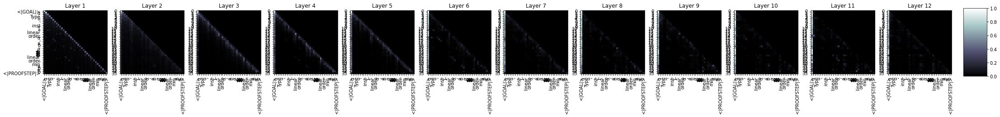

147200it [1:41:06, 25.17it/s]

  Step 147,200  of  147,271. Loss: 1.1651232242584229.   Elapsed: 1:41:07.
Sample:rw [max_eq_min]<|endoftext|><|PROOFSTEP|>rw [sq, add_le_add]<|endoftext|><|PROOFSTEP|>rw [add_le_add nnreal_iff, mul_rpow]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [add_pos, one_pos]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw ← functor.fst_nat_mul<|endoftext|><|PROOFSTEP|>rw functor_fst<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>rw [← nat.sub_assoc, ← ndvd, ← nat.sub_lt]<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>ext_iff<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [compassoc, ← nat.sub_dvd_of_iff_self, ← gcd_of_int_comp, add_of_int_iff_right]<|endoftext|><|PROOFSTEP|>apply_deriv_right<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>have H<|endoftext|><|PROOFSTEP|>ext_iff
s -> 0.3069423735141754
rw -> 0.2011798918247223
apply -> 0.11736643314361572
ex -> 0.100849

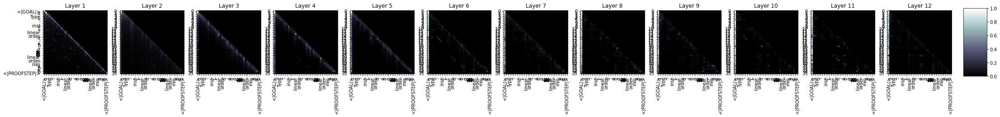

147271it [1:41:15, 24.24it/s]



  Average training loss: 1.03
  Training epoch took: 1:41:15

Running Validation...
  Validation Loss: 0.98
  Validation took: 0:01:33


3it [00:00, 25.51it/s]


======== Epoch 26 / 35 ========
Training...


3199it [02:06, 28.43it/s]

  Step 3,200  of  147,271. Loss: 1.515778660774231.   Elapsed: 0:02:07.
Sample:apply min_le_top<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintro ⟨a.⟩<|endoftext|><|PROOFSTEP|>rw [add_comm, inf_self]<|endoftext|><|PROOFSTEP|>rw [add_comm, inf_self, neg_iff, sub_eq_right_iff_symm, neg_iff_add]<|endoftext|><|PROOFSTEP|>rintro ⟨h, c, hc⟩<|endoftext|><|PROOFSTEP|>rw rfl<|endoftext|><|PROOFSTEP|>rw ← e := pnat.sub_refl a<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>rw [add_comp, e.comp, add_iff, add_comp, pnat.sub_refl, or, hc⟩, and_eq<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw h<|endoftext|><|PROOFSTEP|>rw [h, add_comp, add_comp, a, e, pnat.sub_refl, neg_iff_le_add_left, pnat.sub_le_add_right
s -> 0.3841436207294464
rw -> 0.17827795445919037
ex -> 0.1237451359629631
apply -> 0.09154367446899414
cases -> 0.07293453067541122
have -> 0.050846926867961884
int -> 0.044005606323480606
re -> 0.020176690071821213
split -> 0.017450416460633278
by -> 0.01

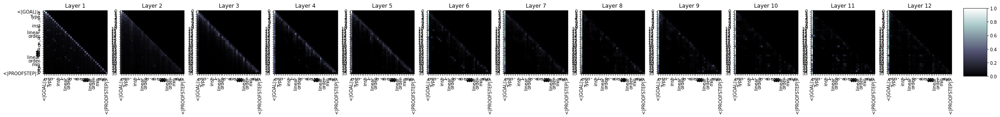

6398it [04:19, 25.37it/s]

  Step 6,400  of  147,271. Loss: 0.785703182220459.   Elapsed: 0:04:20.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>use_rpow_of>>\<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rcases rfl|Rfl|Rfl<|endoftext|><|PROOFSTEP|>exact_mod_cast_mod_mod (exists_refl<|endoftext|><|PROOFSTEP|>rw [← sub_iff] at 1<|endoftext|><|PROOFSTEP|>rw [sub_iff_mem_cancel, ← sub_eq_iff_mem_cancel]<|endoftext|><|PROOFSTEP|>norm_eq_mem<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have : 1 : ∀ 1 ∈ a, 1 < a+1 (norm_exists_eq_eq_one_norm),<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>exists_eq_one_eq_one<|endoftext|><|PROOFSTEP|>have<|endoftext|><|PROOFSTEP|>simp_of 1926.2 (pow_zero_lt_pow_one (0 : 0 ≠ 0) (b : 0 <
rw -> 0.2478303760290146
s -> 0.2444385439157486
ex -> 0.20176886022090912
cases -> 0.08848976343870163
apply -> 0.0

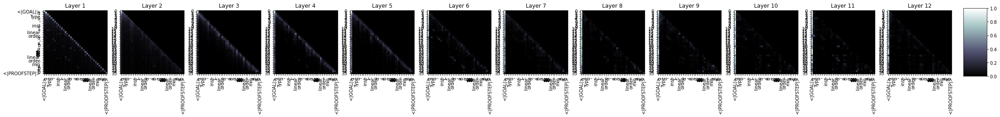

9600it [06:32, 21.94it/s]

  Step 9,600  of  147,271. Loss: 1.2592828273773193.   Elapsed: 0:06:33.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_eq_of_mem<|endoftext|>1<|endoftext|><|PROOFSTEP|>simp [sub_eq_to_mem, inter_mem, preimage_eq_to_mem]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_to_mem2<|endoftext|>I : Type : Type I, Type R, Type S, subtype.1, subtype.2, subtype.3, subtype.4, h, intros<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>rcases iq with ⟨h|2, h2⟩<|endoftext|><|PROOFSTEP|>s1 ⟨h2⟩<|endoftext|><|PROOFSTEP|>s2 ⟩<|endoftext|><|PROOFSTEP|>intro_tot_c<|endoftext|>I<|endoftext|><|PROOFSTEP|>transient h1 IH<|endoftext|>⟩<|endoftext|><|PROOFSTEP|>s1<|endoftext|>₀<|endoftext|><|PROOFSTEP|>ext1 : 0 = 1<|endoftext|>
s -> 0.3449109196662903
rw -> 0.

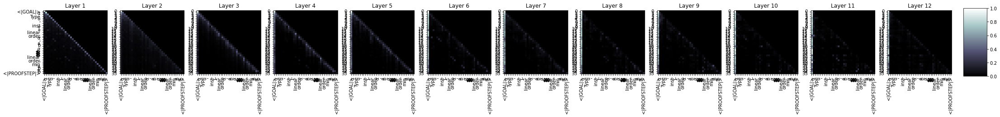

12800it [08:46, 26.79it/s]

  Step 12,800  of  147,271. Loss: 0.7339184880256653.   Elapsed: 0:08:46.
Sample:exact max_le_max<|endoftext|><|PROOFSTEP|>assume_left<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>by_cases only [div, rpow_def, mul_pos]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact_instance<|endoftext|>I<|endoftext|><|PROOFSTEP|>congr<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>b : comm_semiring (zero_comp_right)<|endoftext|><|PROOFSTEP|>by_cases<|endoftext|>I : ∀ _ _, _, _, one_comp_right<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>induction_on<|endoftext|>n : ∀ (i : ℕ), i < 1, i.1 a b, i.2 a b, i.1 a = 1<|endoftext|><|PROOFSTEP|>exact_instance<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>by_cases : 0 = 0<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp.mk<|endoftext|><|PROOFSTEP|>cases<|endoftext|>is<|endoftext|>to_trivial<|endoftext|>by_finset.1 2 x_rfl<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>exactI is

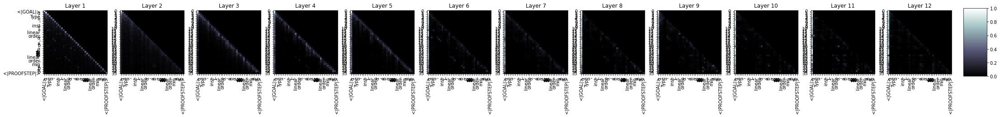

15998it [10:57, 28.68it/s]

  Step 16,000  of  147,271. Loss: 1.2289795875549316.   Elapsed: 0:10:58.
Sample:haveI := min_le<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>cases b<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rcases coe<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance_iff at nhds e.univ<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact_instance<|endoftext|>I.fst _<|endoftext|>F : is_well_order.of_mem_is_well_ordered1 f, (is_well_ordered, _)<|endoftext|><|PROOFSTEP|>s1 s2<|endoftext|><|PROOFSTEP|>intros (g hs1 hs2 : (intro g).1 (g.2) (hs1 hs2 : hs2.1)<|endoftext|><|PROOFSTEP|>s1 nhds1 nhds2 : (set.nonempty (is_well_ordered s1).1 (is_well_ordered s2).1).1 (fst _).1 hs1 nhds1<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact_instance
s -> 0.47444844245910645
ex -> 0.17174012959003448
rw -> 0.1338028907775879
apply -> 0.07023373991250992
int -> 0.0455220565199852
cases -> 0.040180888026952744
have -

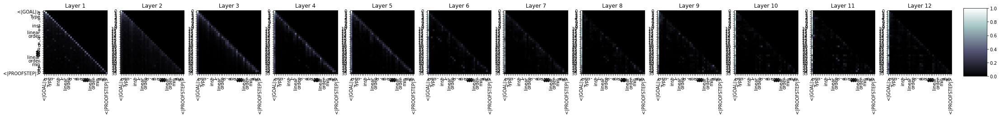

19198it [13:10, 25.60it/s]

  Step 19,200  of  147,271. Loss: 0.9423967599868774.   Elapsed: 0:13:10.
Sample:rwa [min_le_min, min_max_le]<|endoftext|><|PROOFSTEP|>rw [dvd, le_rec, coe_iff_le]<|endoftext|><|PROOFSTEP|>refine le_refl _<|endoftext|><|PROOFSTEP|>rw [← le_ref, neg_le_iff_left]<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>rw [def.def, comp, one]<|endoftext|><|PROOFSTEP|>rc_self, one_iff_mul, one_iff_add_mul<|endoftext|><|PROOFSTEP|>rc_self<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>r<|endoftext|><|PROOFSTEP|>rw a<|endoftext|><|PROOFSTEP|>intro<|endoftext|>M<|endoftext|><|PROOFSTEP|>simpa [ne_of_real] using int.1<|endoftext|><|PROOFSTEP|>apply_int<|endoftext|>refl<|endoftext|>by : inv_inv ← inv.of_real<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>inq (symm.mem.of_real' _ _).1 (symm.to_real, hm! (mem.of_real))<|endoftext|><|PROOFSTEP|>apply_int
s -> 0.3627873957157135
ex -> 0.19415239989757538
rw -> 0.18048767745494843
apply -> 0.0833393782377243
int -> 0.047675017267465

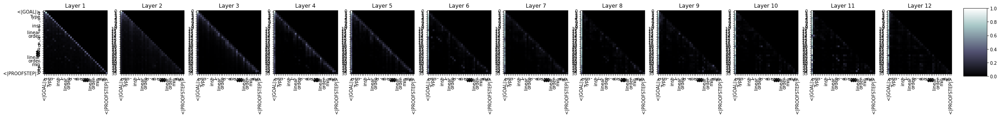

22397it [15:24, 24.22it/s]

  Step 22,400  of  147,271. Loss: 0.7031365036964417.   Elapsed: 0:15:25.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact_mod_cast_of_le h<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [← of_ne, of_ne]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [← of_ne]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>ext x<|endoftext|>by : euclidean_cocone<|endoftext|>N (n + 1)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact (n + 1).1<|endoftext|><|PROOFSTEP|>exact (1)<|endoftext|><|PROOFSTEP|>simp<|endoftext|>n'ed.2 (N.1 N.2)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintros ⟨1, 2⟩<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases hn<|endoftext|>I<|endoftext|><|PROOFSTEP|>simp<|endoftext|>[1_ne]<|endoftext|>pow_succ,<|endoftext|><|PROOFSTEP|>convert_eq<|endoftext|>sub<|endoftext|>0.1 $ simp<|endoftext|>0 (finset.sub_pos_zero<|endoftext|><|PROOFSTEP|>simp<|endofte

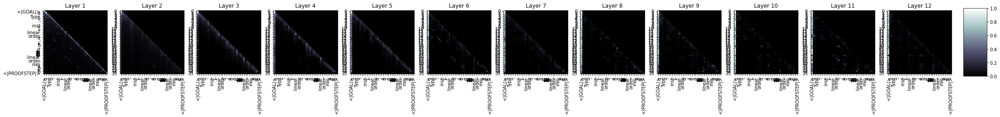

25599it [17:37, 24.08it/s]

  Step 25,600  of  147,271. Loss: 1.6290919780731201.   Elapsed: 0:17:37.
Sample:assume iH<|endoftext|><|PROOFSTEP|>funext iHs<|endoftext|><|PROOFSTEP|>simpa only [commutes_to_right] using commutes_right<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>sub_mod_cast : is_stoo_right_refl := le_sub {left_refl, right_refl, (is_stoo_right_refl.symm).right_ext, hym.symm.preimage]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>simp [refl]<|endoftext|><|PROOFSTEP|>have := : h, by simpa<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have : h 0 = p<|endoftext|><|PROOFSTEP|>apply_instance.mem<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>intro<|endoftext|>M<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>S<|endoftext|><|PROOFSTEP|>induction_of_pow_inv_mem_pow<|endoftext|>pow_inv_left inv_mem_inv_mem_pow_inv_
s -> 0.3881910741329193
rw -> 0.2372

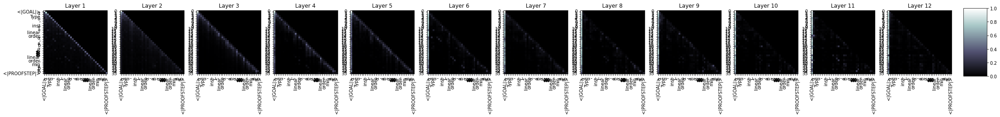

28798it [19:49, 29.09it/s]

  Step 28,800  of  147,271. Loss: 0.5238683819770813.   Elapsed: 0:19:50.
Sample:obtain ⟨λ h a hb : α, hb a hb⟩ := h<|endoftext|><|PROOFSTEP|>rw [← mem_order, min_comm]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp [← le_max_of_le, le_top_of_le_of_le]<|endoftext|><|PROOFSTEP|>simp [le_left_of_mem, mul_of_refl, int.sub_of_le, ← h, sub_of_lt]<|endoftext|><|PROOFSTEP|>have I : set (℀ a b) := has_lt.mpr (subset.mpr a b)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|>h : int.sub (pow_sub a (le_one a b))<|endoftext|><|PROOFSTEP|>convert_lt_iff_nsmul_of_subset<|endoftext|><|PROOFSTEP|>refl<|endoftext|>
s -> 0.4849323034286499
ex -> 0.14800406992435455
rw -> 0.09755435585975647
apply -> 0.0812450721859932
int -> 0.0648072138428688
cases -> 0.035705190151929855
have -> 0.02899850904941559
split -> 0.021963708102703094
re -> 0.02

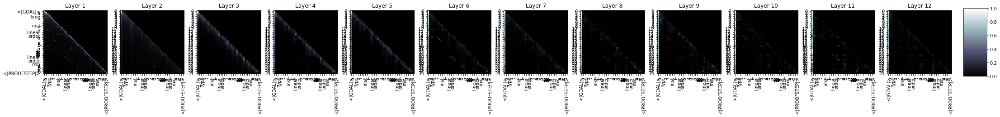

31999it [22:01, 21.66it/s]

  Step 32,000  of  147,271. Loss: 1.1190232038497925.   Elapsed: 0:22:02.
Sample:unfold min<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp at *simp.smul_iff<|endoftext|>I := if (bX = 0)<|endoftext|><|PROOFSTEP|>trivial<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>N mRfl<|endoftext|>H1<|endoftext|><|PROOFSTEP|>apply_eq_univ<|endoftext|>(incl_lt.symm h1 h2)<|endoftext|><|PROOFSTEP|>rw [h1, hy2, inv_prop, inv_of_incl_ne h2, h2_symm]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintros a b x<|endoftext|><|PROOFSTEP|>refl<|endoftext|>⊢ (1:v<|endoftext|><|PROOFSTEP|>simp only [b, h2.1, wm_inv, h2.2, h2.2, (v.1, h2.1]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp
s -> 0.4349907636642456
ex -> 0.14564543962478638
apply -> 0.

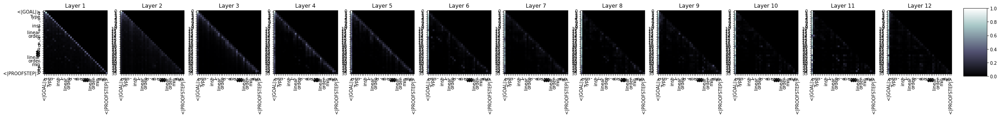

35199it [24:12, 23.26it/s]

  Step 35,200  of  147,271. Loss: 1.1844738721847534.   Elapsed: 0:24:12.
Sample:simp [min_eq_max]<|endoftext|><|PROOFSTEP|>simp [max_eq_min, max_comm]<|endoftext|><|PROOFSTEP|>simp [max_eq_min, max_comm]<|endoftext|><|PROOFSTEP|>simp at this<|endoftext|><|PROOFSTEP|>unfold a b<|endoftext|><|PROOFSTEP|>by<|endoftext|>R : Type u,	p : Σ _,	f : Σ_ (eq_of_lt) _, inhabited Σ, inhabited_equiv f, inhabited_ne f, inhabited_sub_eq_of_lt' := (unleast_le hf).symm<|endoftext|><|PROOFSTEP|>simp_rw mem_uniform<|endoftext|><|PROOFSTEP|>apply_instance_le<|endoftext|><|PROOFSTEP|>s_eq_of_lt<|endoftext|><|PROOFSTEP|>simp_mem_of_lt 0 rfl<|endoftext|><|PROOFSTEP|>apply_instance_eq_sub.2 (tactic.ext _)<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>s2 (of _ ⟨_, hf, h
s -> 0.39855602383613586
rw -> 0.18379557132720947
ex -> 0.1373114138841629
apply -> 0.0899495780467987
int -> 0.053983982652425766
cases -> 0.04046962782740593
have -> 0.02871796302497387
re -> 0.0267513

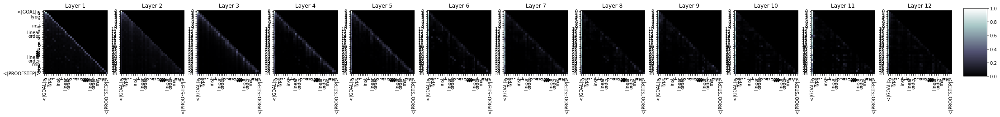

38399it [26:24, 25.77it/s]

  Step 38,400  of  147,271. Loss: 0.9792930483818054.   Elapsed: 0:26:24.
Sample:rw [← min_right _, min_max]<|endoftext|><|PROOFSTEP|>exact_mod_cast _ _<|endoftext|><|PROOFSTEP|>exists_le_of_lt (univ_le_of_gt _).symm<|endoftext|><|PROOFSTEP|>ext i<|endoftext|><|PROOFSTEP|>exacts_const_eq_left_of_lt<|endoftext|><|PROOFSTEP|>rw [← inv_right_of_zero_of_lt]<|endoftext|><|PROOFSTEP|>contradiction<|endoftext|><|PROOFSTEP|>exists_lt_left_of_gt { rw inv_one.2 } { }<|endoftext|><|PROOFSTEP|>intro rfl<|endoftext|><|PROOFSTEP|>simp only [sub_le, inv_le, inv_lt_right]<|endoftext|><|PROOFSTEP|>rw ←le_iff_one<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exists_le<|endoftext|><|PROOFSTEP|>exists_le_one with A<|endoftext|><|PROOFSTEP|>exists_le_top<|endoftext|><|PROOFSTEP|>ring<|endoftext|><|PROOFSTEP|>exists_right<|endoftext|>tactic B<|endoftext|><|PROOFSTEP|>refine int.mul_to_int
s -> 0.3020037114620209
rw -> 0.17173650860786438
ex -> 0.14356376230716705
apply -> 0.14253461360931

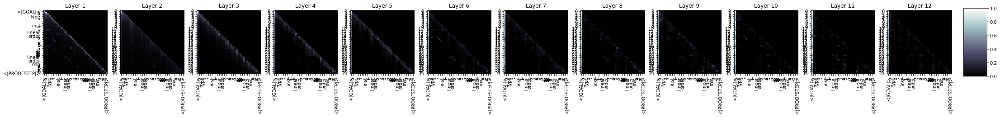

41600it [28:34, 25.05it/s]

  Step 41,600  of  147,271. Loss: 1.1490398645401.   Elapsed: 0:28:35.
Sample:simp [min]<|endoftext|><|PROOFSTEP|>simp [div_comm]<|endoftext|><|PROOFSTEP|>simpa only [min_comm_cancel, mul_comm] using mul_left<|endoftext|><|PROOFSTEP|>simp_apply<|endoftext|><|PROOFSTEP|>rwa inv_eq_or<|endoftext|><|PROOFSTEP|>simp_bot at rfl<|endoftext|><|PROOFSTEP|>simp_bot<|endoftext|><|PROOFSTEP|>trivial<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rcasesrcases<|endoftext|>I 0 with ⟨a, a'⟩<|endoftext|><|PROOFSTEP|>rcasesI.0 with ⟨b⟩<|endoftext|><|PROOFSTEP|>simp rfl<|endoftext|><|PROOFSTEP|>simp (1:mul_one)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>by rfl<|endoftext|>M<|endoftext|><|PROOFSTEP|>apply_inst_eq_to_left<|endoftext|>b<|endoftext|><|PROOFSTEP|>apply_right<|endoftext|>⊢ A' ⊢ A' ⊢ A' ⊢ A' ⊢ A' ⊢<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp_intro<|endoftext|><|PROOFSTEP|>symm
s -> 0.36783602833747864
rw -> 0.24471822381019592
ex -> 0.10643104463815689
apply

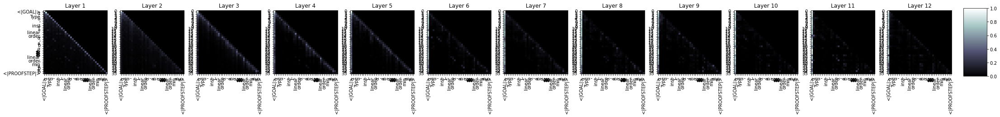

44800it [30:46, 26.05it/s]

  Step 44,800  of  147,271. Loss: 1.3311101198196411.   Elapsed: 0:30:47.
Sample:intros<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>have meow : one is a<|endoftext|><|PROOFSTEP|>by_case : (1) {x // 1 = x}s<|endoftext|><|PROOFSTEP|>exact eq_univ _<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>sH : (1) is a {x // 1 = x}<|endoftext|><|PROOFSTEP|>simpa using is_not_dvd_of_is_not_dvd<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [←simp_iff, has_self, not_dvd, not_dvd_of_is_not_dvd_of_nonneg]<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>exfalso<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exfalso<|endoftext|><|PROOFSTEP|>have this.<|endoftext|><|PROOFSTEP|>f1 : one ←f_1, f_2, f_3, f_4, hf2, hf5, hf7, hf8<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw<|endoftext|>
s -> 0.26259294152259827
rw -> 0.2490529865026474
ex -> 0.12156014889478683
apply -> 0.09270218759775162
int -> 0.06722696125507355
ca

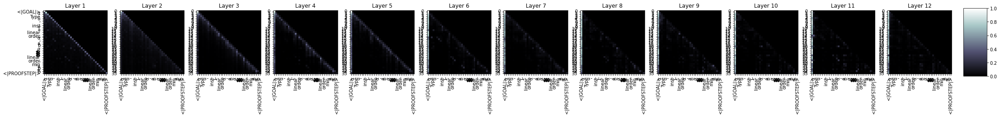

48000it [32:55, 26.06it/s]

  Step 48,000  of  147,271. Loss: 0.8575009107589722.   Elapsed: 0:32:56.
Sample:have hb := min_le_max_iff.3 (lt_top.1 (div_le_bot (lt_top_iff.2 (lt_top _))))<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>have := to_dvd 0<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_le_zero<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_left<|endoftext|><|PROOFSTEP|>apply_left<|endoftext|><|PROOFSTEP|>refl<|endoftext|>α_1 : (∃_1 (a : ℝ) (H : a ≤ 1) := (ne_of_lt H H)<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp_rw<|endoftext|><|PROOFSTEP|>reflιt : ¬¬1 = 0 := ⟨1, nat.symm⟩<|endoftext|><|PROOFSTEP|>apply_zero<|endoftext|><|PROOFSTEP|>split_eq<|endoftext|><|PROOFSTEP|>subtype _<|endoftext|><|PROOFSTEP|>rw }<|endoftext|><|PROOFSTEP|>apply_left<|endoftext|><|PROOFSTEP|>apply_right<|endoftext|><|PROOFSTEP|>exact, e.def using e.gcd.3
rw -> 0.25933021306991577
s -> 0.20692768692970276
ex -> 0.17566347122192383
int -> 0.084097

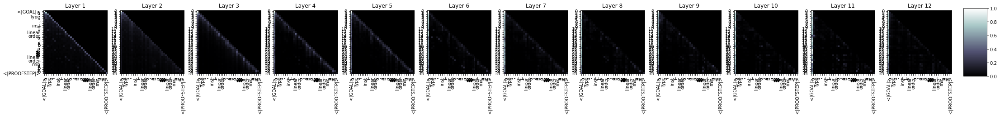

51200it [35:08, 25.06it/s]

  Step 51,200  of  147,271. Loss: 0.9405339360237122.   Elapsed: 0:35:08.
Sample:norm_cast<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>obtain ⟨v, hv, hv_eq_pi⟩ := tendsto_le_top.extend_lt_left_iff_end<|endoftext|><|PROOFSTEP|>have := tendsto_le_top.iff_end_eq_pi_right<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simpa using (le_bot.coe_mem).prod<|endoftext|><|PROOFSTEP|>rcases Iio1 with ⟨v, hv, hv_eq_ Raspberry_RJ, nat.ne_rpow.1 hv, with rfl⟩<|endoftext|><|PROOFSTEP|>show (λ x, _, hx, hx_refl⟩<|endoftext|><|PROOFSTEP|>schoose x m<|endoftext|><|PROOFSTEP|>schoose hv I (hx, _, hbkx, rfl⟩<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact H.
s -> 0.4175982177257538
rw -> 0.15294019877910614
ex -> 0.1456715315580368
int -> 0.06377491354942322
apply -> 0.05886201187968254
cases -> 0.04132354259490967
have -> 0.03716631606221199
split -> 0.02874467335641384
re -> 0.027006931602954865
norm -> 0.026911649852991

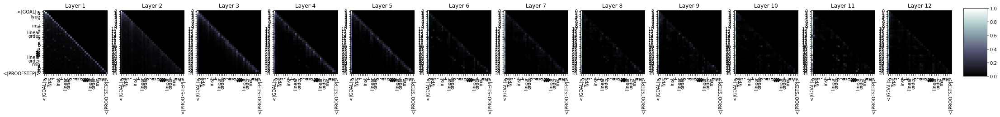

54398it [37:20, 23.10it/s]

  Step 54,400  of  147,271. Loss: 0.5924715995788574.   Elapsed: 0:37:21.
Sample:have : min a 1 = 1<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw nat.sub_eq_bot_iff<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simpa using this<|endoftext|><|PROOFSTEP|>try { to }<|endoftext|><|PROOFSTEP|>exact @pow_pow_of_finset_of_eq_bot_zero _ _ (finset.mem_pow pow_eq_bot.1 $ ⟨a, b, hb⟩<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>intros x<|endoftext|><|PROOFSTEP|>try { rw [nsmul pow_pos, inv_pos]<|endoftext|><|PROOFSTEP|>rw [← mul_pos_right X Y Y, mul_pos]<|endoftext|><|PROOFSTEP|>intros x v, rw [nsmul rpow, ← nsmul_mem]<|endoftext|><|PROOFSTEP|>apply.not_mem<|endoftext|><|PROOFSTEP|>rwa<|endoftext|><|PROOFSTEP|>cases<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply (univ.le_sup_
s -> 0.2623380422592163
rw -> 0.20412833988666534
ex -> 0.1406673938035965
apply -> 0.11072301119565964
int -> 0.10545795410871506
cases -> 0.04730182

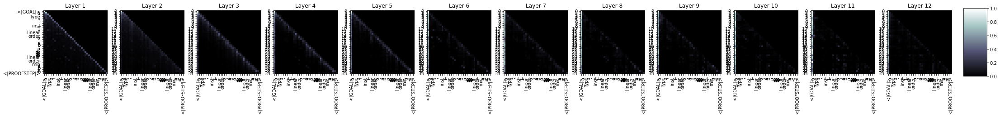

57598it [39:34, 28.78it/s]

  Step 57,600  of  147,271. Loss: 1.1747472286224365.   Elapsed: 0:39:35.
Sample:simp<|endoftext|><|PROOFSTEP|>simpa using min_le_max_eq x y<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>letI := I'<|endoftext|><|PROOFSTEP|>casesI<|endoftext|><|PROOFSTEP|>ext h<|endoftext|><|PROOFSTEP|>have := H := mt setI<|endoftext|>I.1 M a<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>sI⊢ (I := by simp)<|endoftext|><|PROOFSTEP|>rwa [le_iff_true_eq_iff, top_completion, one_mem, one_lt, one_lt, coe_ne_bot]<|endoftext|><|PROOFSTEP|>use a.sub set_Icc (subset_of_eq_subset)<|endoftext|><|PROOFSTEP|>simp only [subset_le_subset, subset_le_subset_of_right, subset_of_le_one]<|endoftext|><|PROOFSTEP|>split_iff_le_left<|endoftext|><|PROOFSTEP|>rintros ⟨⟩<|endoftext|><|PROOFSTEP|>by rcofexact le_of_lt<|endoftext|>
s -> 0.22856031358242035
ex -> 0.17355860769748688
apply -> 0.15213395655155182
rw -> 0.1291433572769165
int -> 0.12555967271327972
cases -> 0.0564124

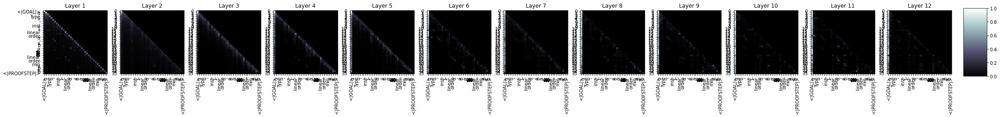

60800it [41:46, 25.53it/s]

  Step 60,800  of  147,271. Loss: 0.9421720504760742.   Elapsed: 0:41:47.
Sample:cases a<|endoftext|><|PROOFSTEP|>rintros ⟨V₁⟩ ⟨V₂⟩ ⟨V₁⟩ ⟨V₂⟩ ⟨v₁⟩ ⟨v₂⟩<|endoftext|><|PROOFSTEP|>have : ∀ {x : ℕ} {h'' : x ≤ 1}, 1 ≤ x → (∃ x = 0), x.succ ≤ 1 := x.ne_zero<|endoftext|><|PROOFSTEP|>by simpa using @le_antisymm _ _ _ _ _ _ _ a ih<|endoftext|><|PROOFSTEP|>have (left_smul _), bernstein_pos_left _ using bernstein<|endoftext|><|PROOFSTEP|>intro v1 h<|endoftext|><|PROOFSTEP|>rw bernstein_pos_right<|endoftext|><|PROOFSTEP|>have<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_le (0 : ae_le _ λ a0<|endoftext|><|PROOFSTEP|>simp
s -> 0.3839101493358612
rw -> 0.15048353374004364
ex -> 0.13555683195590973
apply -> 0.08495146036148071
int -> 0.06458953022956848
cases -> 0.06317128241062164
have -> 0.04976467043161392
split -> 0.02994879148900509
norm -> 0.019054774194955826
ref -> 0.01856904663145542


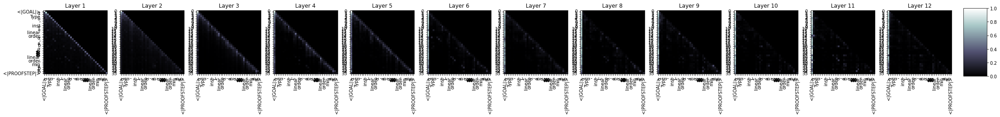

63998it [43:58, 27.71it/s]

  Step 64,000  of  147,271. Loss: 0.9550828337669373.   Elapsed: 0:43:59.
Sample:simp<|endoftext|><|PROOFSTEP|>have I : ℕ := classical.some_order_of_le_of_eq_of_le<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>rw [← le_iff_eq_top]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>s_lt<|endoftext|><|PROOFSTEP|>sdiff<|endoftext|><|PROOFSTEP|>simp only [le_sub, add_le]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp, invertible<|endoftext|><|PROOFSTEP|>rw ← inv_sub.1 (subsingleton.1 (mem_singleton) (mem_singleton.2 (singleton.1).symm)<|endoftext|><|PROOFSTEP|>have : (mem_singleton, $ int.trans.trans (refl_refl $ _) (mem_singleton _) _)<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>convert subsingleton.1.1 (mem_singleton.2.1; subsingleton.1.2)<|endoftext|><|PROOFSTEP|>apply.rec<|endoftext|>
s -> 0.3778745234012604
ex -> 0.16062913835048676
rw -> 0.13003405928611755
apply -> 0.07707143574953079
have -> 0.067963436

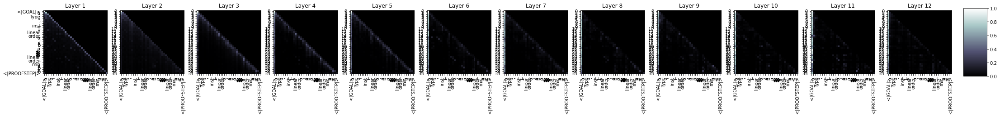

67198it [46:10, 18.37it/s]

  Step 67,200  of  147,271. Loss: 0.977512001991272.   Elapsed: 0:46:11.
Sample:rw [max_def_comm, max_eq_min, max_eq_min, linear_order.min_eq_min]<|endoftext|><|PROOFSTEP|>cases subtype h with hi<|endoftext|><|PROOFSTEP|>cases h with hi<|endoftext|><|PROOFSTEP|>congr' with hi<|endoftext|><|PROOFSTEP|>simp [subtype]<|endoftext|><|PROOFSTEP|>intro x<|endoftext|><|PROOFSTEP|>un_iff_neg<|endoftext|><|PROOFSTEP|>apply_bot<|endoftext|><|PROOFSTEP|>cases {⊢ ¬true⊢ ∑ (x : ℝ) in 1.to_nnreal_of_degree_neg (x -<|endoftext|><|PROOFSTEP|>simp [subtype_lt_top, λ_ne_le, zero_of_pos_true]<|endoftext|><|PROOFSTEP|>ring_eq_zero_of_two_eq_one_lt<|endoftext|><|PROOFSTEP|>rw zero_of_lt_top<|endoftext|><|PROOFSTEP|>apply_bot<|endoftext|><|PROOFSTEP|>apply_bot<|endoftext|><|PROOFSTEP|>simp_ne<|endoftext|><|PROOFSTEP|>simp_ne<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>ext hb<|endoftext|>X
s -> 0.3399732708930969
rw -> 0.15018723905086517
ex -> 0.12929922342300415
cases -> 0.10925698280334473
apply 

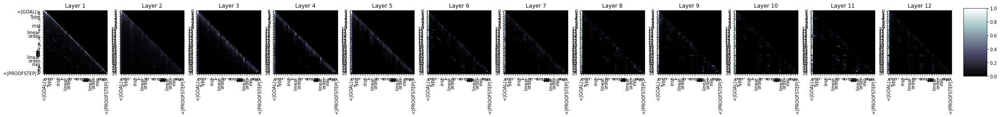

70399it [48:21, 27.98it/s]

  Step 70,400  of  147,271. Loss: 0.6016411185264587.   Elapsed: 0:48:22.
Sample:rw min_self at a, min_self<|endoftext|><|PROOFSTEP|>show only ⊥ ⊥<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_left<|endoftext|><|PROOFSTEP|>apply_right<|endoftext|><|PROOFSTEP|>apply_right<|endoftext|><|PROOFSTEP|>apply_one : with a ⊥ (not_nots_of uncertain).symm_to_symm<|endoftext|><|PROOFSTEP|>apply_is_not_nonneg<|endoftext|><|PROOFSTEP|>apply_le_nonneg : x : ℝ, y z :=<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_eq_top<|endoftext|><|PROOFSTEP|>apply_eq_top<|endoftext|><|PROOFSTEP|>tidy<|endoftext|><|PROOFSTEP|>rw top_eq_top_not_top at is_nonneg_of_le.eq_top_of_neg_of_not_le<|endoftext|><|PROOFSTEP|>simp.symm<|endoftext|><|PROOFSTEP|>try { exact := }<|endoftext|><|PROOFSTEP|>convert le_right<|endoftext|><|PROOFSTEP|>show_subset_of_real (mem_top_of (not_nonneg_of_neg.
s -> 0.2130914181470871
ex -> 0.17846375703811646
rw -> 0.138580322265625
apply -> 0.1

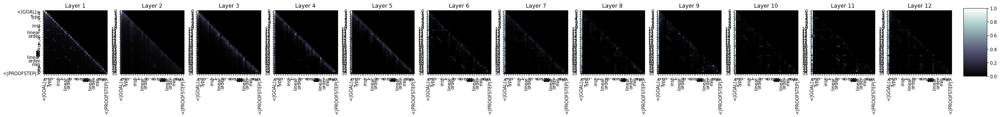

73598it [50:32, 25.36it/s]

  Step 73,600  of  147,271. Loss: 1.6983251571655273.   Elapsed: 0:50:33.
Sample:dsimp only [max_or_le]<|endoftext|><|PROOFSTEP|>exact le_max_of_le_max a b<|endoftext|><|PROOFSTEP|>trivial<|endoftext|><|PROOFSTEP|>apply le_max_of_le_max<|endoftext|><|PROOFSTEP|>rw (le_refl_iff)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_subset<|endoftext|><|PROOFSTEP|>cases hk with p1 with p2<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance_left<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have t<|endoftext|>←<|endoftext|><|PROOFSTEP|>s : pythagorean_pow p1 p2 h_1<|endoftext|><|PROOFSTEP|>exact (y.pow_c1.2 h_1.2.1.1 h_2.2.1)<|endoftext|><|PROOFSTEP|>apply_instance_eq_bot<|endoftext|><|PROOFSTEP|>have : 2nd p1 p2 hb_1 p2 h_2.2.2<|endoftext|><|PROOFSTEP|>exact (1.2_1.0 hb_1).1
s -> 0.1955506056547165
int -> 0.1779412031173706
rw -> 0.1636359691619873
apply -> 0.15435932576656342
ex -> 0.1167946606874466
have -> 0.063

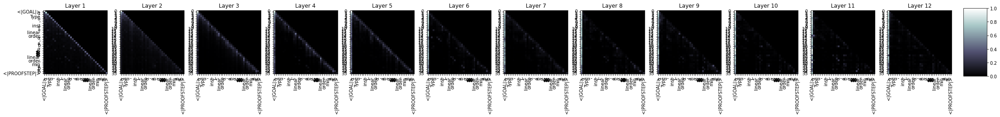

76799it [52:44, 23.12it/s]

  Step 76,800  of  147,271. Loss: 0.9798546433448792.   Elapsed: 0:52:45.
Sample:rintros ⟨⟩<|endoftext|><|PROOFSTEP|>assumption h<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rintros ⟨⟩ : ∀ ⊃ a, a * a⁻¹ = ⟨a, hab, b₁⟩<|endoftext|><|PROOFSTEP|>rintros ⟨⟩ : ∀ ⊃ a, somebody.cof_eq (1) ⟨a, hab, b₁⟩ := classical.right_curry (1⁻¹ ⟨a, hab, b₁⟩)<|endoftext|><|PROOFSTEP|>have := classical.left_curry<|endoftext|><|PROOFSTEP|>apply_classical<|endoftext|><|PROOFSTEP|>set {a_eq_of_left_eq} {b : hab | ∃ a c : hab hb, hb hb = hb hb} {d : has_deriv_at ⟨a,
rw -> 0.24743548035621643
s -> 0.16560781002044678
ex -> 0.14852267503738403
apply -> 0.12851040065288544
cases -> 0.09157758951187134
int -> 0.08270063996315002
have -> 0.05716467276215553
ext -> 0.027618996798992157
ref -> 0.025826161727309227
split -> 0.025035537779331207


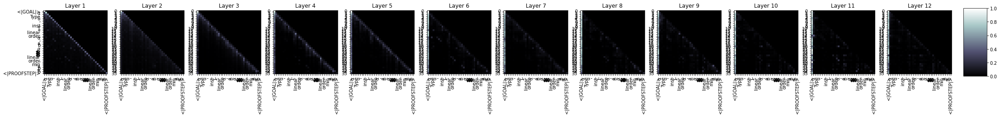

80000it [54:56, 24.84it/s]

  Step 80,000  of  147,271. Loss: 1.150589942932129.   Elapsed: 0:54:56.
Sample:refl<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_mod_cast<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_funs<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ds a b c<|endoftext|><|PROOFSTEP|>rw [intro]<|endoftext|><|PROOFSTEP|>apply_fun_inv (inhabited.of_of_eq_eq_self.2_of_eq.symm_coe_inj<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>ext g<|endoftext|><|PROOFSTEP|>assoc, by [of_eq_mem, one_le_iff.coe_eq_lt_of_ne]<|endoftext|><|PROOFSTEP|>symm_ge hg<|endoftext|><|PROOFSTEP|>rintros_1 : ∀ (n : ℕ), exists_of_ne := (le_of_eq_ge)<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>apply_le_iff_mem<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_le.symm<|endoftext|><|PROOFSTEP|>rintros_1<|endoftext|><|PROOFSTEP|>unfold set.eq_sing
s -> 0.23307690024375916
rw -> 0.176811

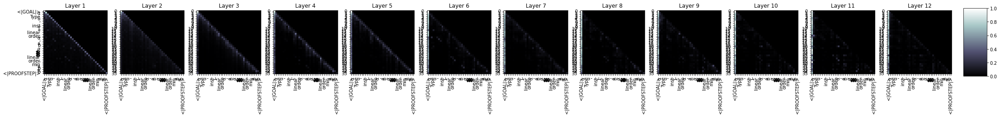

83199it [57:09, 22.61it/s]

  Step 83,200  of  147,271. Loss: 0.7169935703277588.   Elapsed: 0:57:09.
Sample:by_cases hb, hb0 : b ≤ 0<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>assumption_le_of twenty_le_b<|endoftext|><|PROOFSTEP|>funext_tidy<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>haveI := tp_self_of_ne_zero_of_le_ne_zero.1 (ne_zero_of_le_zero).1 (tp_self_le_le_ne_zero.2_ne_zero.2, tp_self_le_ne_one)<|endoftext|><|PROOFSTEP|>rw [ne_zero_of_ne_zero_of_le_eq_zero_of_ne_one.1]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>show $ : le_repr (0.1 : pgame) (0 : pgame) 0 = 1<|endoftext|><|PROOFSTEP|>simp only [eq_one, eq_one_iff]<|endoftext|><|PROOFSTEP|>rint (⟨
s -> 0.29709717631340027
apply -> 0.15724512934684753
rw -> 0.15419960021972656
ex -> 0.11453394591808319
cases -> 0.0596303790807724
have -> 0.056991372257471085
int -> 0.05674915760755539
split -> 0.03634267672896385
ref -> 0.03467041999101639
rint -> 0.03254016488790512


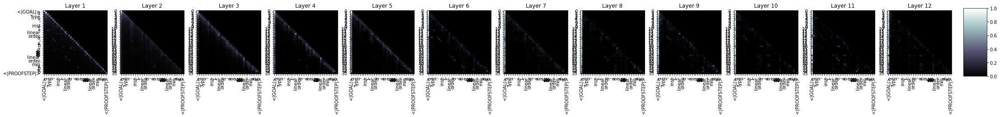

86399it [59:20, 25.74it/s]

  Step 86,400  of  147,271. Loss: 0.9275718331336975.   Elapsed: 0:59:21.
Sample:intro h<|endoftext|><|PROOFSTEP|>rcases rfl with ⟨s, sb, rfl⟩<|endoftext|><|PROOFSTEP|>by_cases hs, htl, hr, hs, htlR<|endoftext|><|PROOFSTEP|>simp only [norm, hc_norm, rfl_norm, rfl_of_le]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply eq_of_lt_iff_true<|endoftext|><|PROOFSTEP|>apply_comp_self (λ l m, hl₁ m, rfl₁ hm₁) _<|endoftext|><|PROOFSTEP|>sdiff<|endoftext|><|PROOFSTEP|>exists_prop_of_injectory (1:2) rfl<|endoftext|><|PROOFSTEP|>by_cases<|endoftext|><|PROOFSTEP|>simp_ne_of_true<|endoftext|><|PROOFSTEP|>apply_comp_true<|endoftext|><|PROOFSTEP|>apply_distro<|endoftext|><|PROOFSTEP|>apply_distro_left<|endoftext|><|PROOFSTEP|>apply_distro_symm<|endoftext|><|PROOFSTEP|>simp_ne_of_true_lt<|endoftext|><|PROOFSTEP|>rintros �
s -> 0.26835086941719055
rw -> 0.19999125599861145
apply -> 0.15706102550029755
ex -> 0.08868847787380219
cases -> 0.08599917590618134
int -> 0.053725119680166245
have -> 0

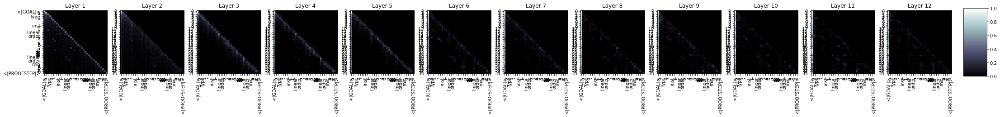

89600it [1:01:31, 24.00it/s]

  Step 89,600  of  147,271. Loss: 1.1902698278427124.   Elapsed: 1:01:32.
Sample:simp only [min_le, max_lt_max, min_eq_max, max_lt, max_le]<|endoftext|><|PROOFSTEP|>refine le_trans _ _ _<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext xs hxr xs xs xs<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_self<|endoftext|><|PROOFSTEP|>to_finset<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have := @cancel_left.dec<|endoftext|><|PROOFSTEP|>apply.injective (finset.card_inj).1<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>assumption<|endoftext|>I := {mul_singleton, lt_mul}<|endoftext|><|PROOFSTEP|>assumption.1 rfl [sub]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>haveI : mnfld_of_mem<|endoftext|><|PROOFSTEP|>exact memto_iff<|endoft

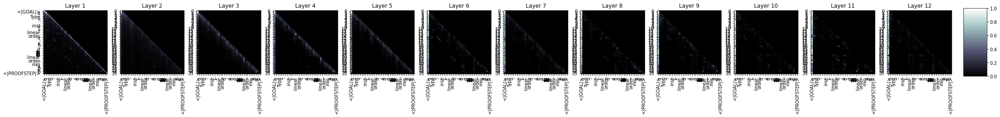

92799it [1:03:44, 27.43it/s]

  Step 92,800  of  147,271. Loss: 0.8730068802833557.   Elapsed: 1:03:45.
Sample:split<|endoftext|><|PROOFSTEP|>simp only [add_comm]<|endoftext|><|PROOFSTEP|>rw [add_le_add_right_iff, ne.def]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refine {to_nsmul := λ i, int.def, nsmul_right_iff_one, le_iff_ne, le_ne_of_not_le, add_le_iff]<|endoftext|><|PROOFSTEP|>haveI := set.mem_of_nsmul with set.ne_zero<|endoftext|><|PROOFSTEP|>exact! ⟨nsmul_mul, ⟨i, hi, hm, hm⟩<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>apply_ext<|endoftext|><|PROOFSTEP|>linarith<|endoftext|><|PROOFSTEP|>by : well_founded.mk_of_refl<|endoftext|><|PROOFSTEP|>by<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s_refl<|endoftext|>←s_refl<|endoftext|>⟩<|endoftext|><|PROOFSTEP|>apply_distrib ⟩<|endoftext|><|PROOFSTEP|>simp<|endoftext|>
s -> 0.3476080000400543
rw -> 0.2277018129825592
cases -> 0.10137785971164703
apply -> 0.07538002729415894
ex -> 0.07210958749055862
int -> 0.06092003360390663
h

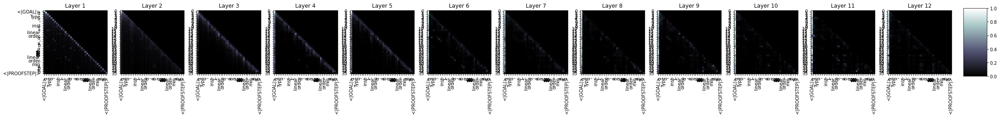

95998it [1:05:57, 26.64it/s]

  Step 96,000  of  147,271. Loss: 1.1162762641906738.   Elapsed: 1:05:57.
Sample:ext<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>split_iff<|endoftext|><|PROOFSTEP|>have := @nat_exists_neg := nat.neg_of_le_pos_left<|endoftext|><|PROOFSTEP|>exists_neg_eq<|endoftext|><|PROOFSTEP|>split_eq<|endoftext|><|PROOFSTEP|>have_le_nhds : nat_le_neg_of_pos_left _ hpos := $ rfl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>subst (int.cast_of _)<|endoftext|><|PROOFSTEP|>refine (mul_le_right)<|endoftext|><|PROOFSTEP|>rintro ⟨_, rfl, ⟨_, _⟩<|endoftext|><|PROOFSTEP|>refine ⟨_, is_sub, rfl⟩<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>try { :symm }<|endoftext|><|PROOFSTEP|>exfalso<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply.pow<|endoftext|><|PROOFSTEP|>tactic.2 | ⟨_, le_pow⟩ :=<|endoftext|><|PROOFSTEP|>unfold<|endoftext|><|PROOFSTEP|>exact at
s -> 0.2443128526210785
rw -> 0.21315930783748627
ex -> 0.1412920206785202
apply -> 0.1

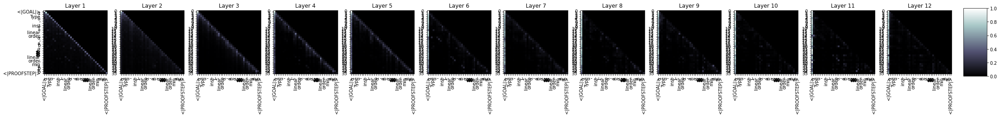

99198it [1:08:09, 27.94it/s]

  Step 99,200  of  147,271. Loss: 0.6420658230781555.   Elapsed: 1:08:10.
Sample:dsimp [min]<|endoftext|><|PROOFSTEP|>dsimp [max_def, max_neg]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintros ⟨x⟩<|endoftext|><|PROOFSTEP|>simp [← rfl]<|endoftext|><|PROOFSTEP|>exactI {a | _}<|endoftext|><|PROOFSTEP|>rw erase_right<|endoftext|><|PROOFSTEP|>ring<|endoftext|><|PROOFSTEP|>rintros<|endoftext|><|PROOFSTEP|>rw erase_left<|endoftext|>S<|endoftext|><|PROOFSTEP|>sub { simp } : [sub_eq_left, eq_self_of_self, ← ←self_singleton]<|endoftext|><|PROOFSTEP|>ext1 (0 : sub_self)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>by_cases<|endoftext|>H : 0 < 1, at 1 ⊢ 1 = 0<|endoftext|><|PROOFSTEP|>rw [2 : sub_eq_right]<|endoftext|><|PROOFSTEP|>rintros<|endoftext|><|PROOFSTEP|>rw [0.1, 1, one, one 1, one_right, one_left, zero]<|endoftext|><|PROOFSTEP|>rfl<|endoftext|><|PROOFSTEP|>apply H<|endoftext|><|PROOFSTEP|>simp [one : one_eq
rw -> 0.2924284040927887
s -> 0.2729983329772949
cases -> 0

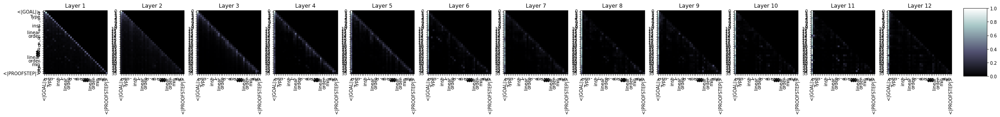

102398it [1:10:21, 24.00it/s]

  Step 102,400  of  147,271. Loss: 1.2580758333206177.   Elapsed: 1:10:22.
Sample:by_cases hb : b ≤ 0<|endoftext|><|PROOFSTEP|>ring_eq_zero_iff.mp (le_antisymm_one_eq_zero_iff)<|endoftext|><|PROOFSTEP|>exact zero_mem_left _ (le_zero_left_of_lt _ _)<|endoftext|><|PROOFSTEP|>simp [zero_mem_right]<|endoftext|><|PROOFSTEP|>exact le_one<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>reflx<|endoftext|><|PROOFSTEP|>rwa [sub_iff_comm]<|endoftext|><|PROOFSTEP|>cases_one<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>trivial h<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>have (ne0_top.gt) := htop.lt<|endoftext|><|PROOFSTEP|>have : top_of_gt_top<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>trivial<|endoftext|><|PROOFSTEP|>rw ←top_iff_top<|endoftext|><|PROOFSTEP|>use_induction_right<|endoftext|>h<|endoftext|><|PROOFSTEP|>left<|endoftext|><|PROOFSTEP|>apply_injective<|en

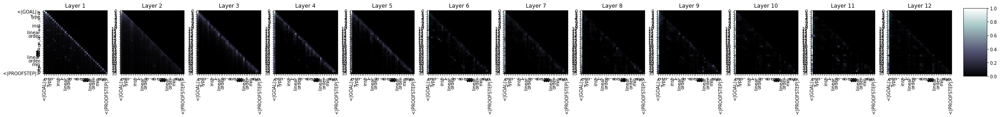

105599it [1:12:32, 26.50it/s]

  Step 105,600  of  147,271. Loss: 1.0993285179138184.   Elapsed: 1:12:32.
Sample:exact min_max_lose_max<|endoftext|><|PROOFSTEP|>exact min_max_dvd_nonempty<|endoftext|><|PROOFSTEP|>rw [min_max_rfl, zero_eq_one]<|endoftext|><|PROOFSTEP|>rw [zero_eq_one, one_eq_zero]<|endoftext|><|PROOFSTEP|>rw [one_eq_zero, zero_eq_one, one_eq_zero]<|endoftext|><|PROOFSTEP|>simp [zero_zero, zero_eq_one, eq_mul_self, inv_inv]<|endoftext|><|PROOFSTEP|>refine {mod_mod_zero, le_mul}<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [n]<|endoftext|><|PROOFSTEP|>apply add_mod<|endoftext|>C<|endoftext|><|PROOFSTEP|>refl<|endoftext|>[2]<|endoftext|><|PROOFSTEP|>by msmul+tsum1<|endoftext|><|PROOFSTEP|>have1 at ⊤<|endoftext|><|PROOFSTEP|>apply add_neg_right<|endoftext|>[1:1]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>unfold : 2<|endoftext|><|PROOFSTEP|>re
s -> 0.2777784764766693
ex -> 0.2155531793832779
rw -> 0.15881089866161346
ca

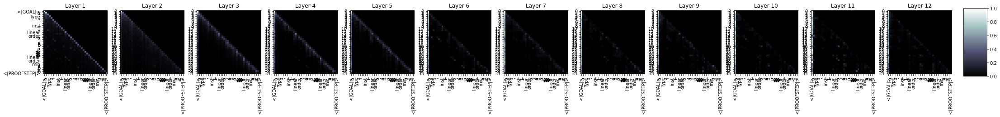

108798it [1:14:42, 27.66it/s]

  Step 108,800  of  147,271. Loss: 1.3274236917495728.   Elapsed: 1:14:42.
Sample:rw [← min_iff_eq_max_iff, min_iff_eq_max]<|endoftext|><|PROOFSTEP|>simp [max_le]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [top_comm]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [x]<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>refine (λ h, id) (mem_cons_of_fn _ _)<|endoftext|><|PROOFSTEP|>by rw [eq_cons]<|endoftext|><|PROOFSTEP|>cases_eq_max_iff_self_right<|endoftext|><|PROOFSTEP|>assoc<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply eq_max_iff_right<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_right_refl<|endoftext|>A : (is_assoc (has_le.2 (has_le.3 (le.3.2) (le.3.iff.2)) (le.1 has_le.3 (le.1.1) (le.3.2)))<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>
s -> 0.34083881974220276
ex -> 0.1759815216064453
rw -> 0.151138037443161
apply -> 0.07874171435832977
int -> 0.0677303597331047
cases -> 0.06032

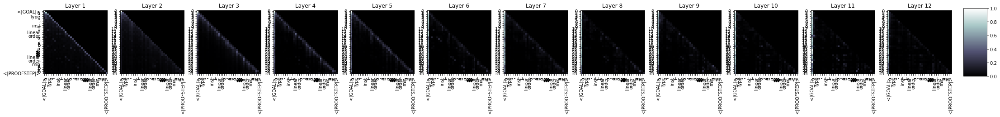

111998it [1:16:52, 27.14it/s]

  Step 112,000  of  147,271. Loss: 1.1247079372406006.   Elapsed: 1:16:53.
Sample:have hb : linear_order.min a b ≤ set.range b := λ d, set.range b<|endoftext|><|PROOFSTEP|>by : ereal_bit0 ereal_bit1 : ∃ y, linear_order.min y = a b<|endoftext|><|PROOFSTEP|>haveI : ∀ {x y z : list α} x ∈ x ∧ y.cases_on x z<|endoftext|><|PROOFSTEP|>intros hx1 hx2<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>by witt_iff<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>by x<|endoftext|><|PROOFSTEP|>rintros<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>rw add ennreal_top_iff<|endoftext|><|PROOFSTEP|>classical<|endoftext|><|PROOFSTEP|>simps<|endoftext|><|PROOFSTEP|>apply (1 : 1).0<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>by rconverge<|endoftext|>this<|endoftext|><|PROOFSTEP|>by simp<|endoftext|>1<|endoftext|>A : (1 : 1).fst (2 : bool {b : b := 1.fst}), (2 : bool {b : b := 2.
s -> 0.30787304043769836
rw -> 0.19746461510658264
ex -> 0.14650483429431915
apply -> 0.093580134212

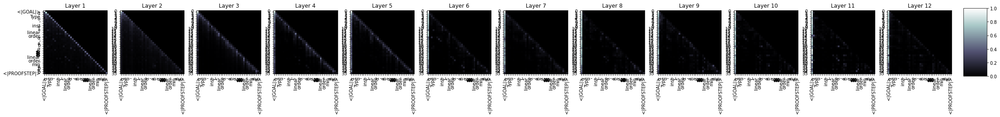

115199it [1:19:04, 28.14it/s]

  Step 115,200  of  147,271. Loss: 0.9733771681785583.   Elapsed: 1:19:05.
Sample:rw [min, min_eq_one_iff, min_le_iff, zero_le_one]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rintro _ ⟨a, ha, hb⟩<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have := prod_eq_of_nonneg_ne ⟨a, ha, rfl⟩<|endoftext|><|PROOFSTEP|>exact exists_mem_lt.2 has_le_symm<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have := eq_of_nonneg _ _<|endoftext|><|PROOFSTEP|>induction_right<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_trivial<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>by_instance<|endoftext|>E : (one - ineff_of_ne_of_ne_ne).1 {contextual, eq}, ←in, eq}.1:1 : ineff_of_ne _<|endoftext|><|PROOFSTEP|>let ne := is_ne
s -> 0.3192392885684967
rw -> 0.2538606524467468
ex -> 0.12008567899465561
int -> 0.07195454835891724
apply -> 0.0

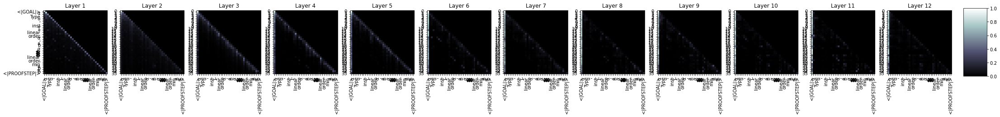

118399it [1:21:18, 28.25it/s]

  Step 118,400  of  147,271. Loss: 0.7141029834747314.   Elapsed: 1:21:19.
Sample:have ha :max = min<|endoftext|><|PROOFSTEP|>norm_cast : ℕ → ℕ<|endoftext|><|PROOFSTEP|>rw [nat.le, nat.le_def.1]<|endoftext|><|PROOFSTEP|>rintro ℚ hc<|endoftext|><|PROOFSTEP|>rintro ℚ' ℚ' ℚ' ℚ'<|endoftext|><|PROOFSTEP|>tactic.pi_instance_derive_field<|endoftext|><|PROOFSTEP|>rw [mem_cons_prop, eq_prop_not_true]<|endoftext|><|PROOFSTEP|>obtain ⟨x, hx⟩ := { exact, eq this, hx⟩<|endoftext|><|PROOFSTEP|>exact ⟨z, ha⟩<|endoftext|><|PROOFSTEP|>intros x hx⟩<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [ext, sup, or.iff, h1, this, eq_apply]<|endoftext|><|PROOFSTEP|>ext_of_eq, eq_apply_iff_iff, not_some<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>
rw -> 0.25446581840515137
s -> 0.23415787518024445
ex -> 0.14917916059494019
apply -> 0.0900176465511322
int -> 0.07566653937101364
have -> 0.05315394327044487
cases -> 0.04414953663945198
ref -> 0.036492161452

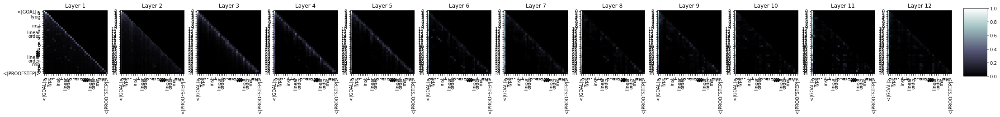

121600it [1:23:31, 22.82it/s]

  Step 121,600  of  147,271. Loss: 0.8576331734657288.   Elapsed: 1:23:32.
Sample:rw [min_eq_max_iff_max_iff_left_le_max_iff_le_max_iff_left_le_max_iff_right_eq_sup_sup_lt, max_iff_left, lt_le_add_left, le_lt_right]<|endoftext|><|PROOFSTEP|>exact max_eq_max<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp only [coe_one, add_coe]<|endoftext|><|PROOFSTEP|>s1 {contextual := c hn, simp, is_coe_mul_left_iff_left_iff_left, ct_coe_left]<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>simp only [simp_right]<|endoftext|><|PROOFSTEP|>assumption<|endoftext|><|PROOFSTEP|>subtype h<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>split (refl _ hd : (ext_of_nat_def hd : decidable_le.of_mem _ _).
s -> 0.297075480222702
rw -> 0.2866780459880829
ex -> 0.12731419503688812
int -> 0.06383714079856873
apply -> 0.06268593668937683
have -> 0.042749565094709396
cases -> 0.040923696011304855
ref -> 0.0276913084089756
re -> 0.0

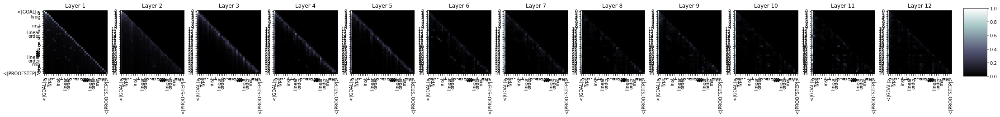

124799it [1:25:44, 24.66it/s]

  Step 124,800  of  147,271. Loss: 0.9475341439247131.   Elapsed: 1:25:45.
Sample:split_ifs with ha_in hb<|endoftext|><|PROOFSTEP|>have I := (has_iff.2 a).1 hb<|endoftext|><|PROOFSTEP|>have := λ v hv, has_iff v hv<|endoftext|><|PROOFSTEP|>simp only [interject, submodule.coe_iff, is_compact]<|endoftext|><|PROOFSTEP|>have hw hne<|endoftext|><|PROOFSTEP|>rw [← mul_comm, submodule.coe_iff, ← mul_comm, submodule.coe_eq_map, ← submodule.coe_map]<|endoftext|><|PROOFSTEP|>rw [← mul_comm, submodule.coe_iff, ← mul_eq_map, ← finset.image.coe_intros, set.mem_image.2, ← finset.coe_nat_basis, ← finset.coe_nat_basis_coe, and_comm]<|endoftext|><|PROOFSTEP|>rw [← finset.image_eq_map
s -> 0.2511868476867676
rw -> 0.23227131366729736
ex -> 0.18469518423080444
apply -> 0.0892803817987442
int -> 0.08355502039194107
cases -> 0.04416842758655548
have -> 0.039822183549404144
re -> 0.02552219294011593
ref -> 0.024992862716317177
norm -> 0.024505577981472015


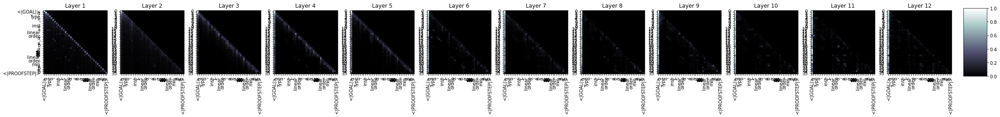

128000it [1:27:56, 27.21it/s]

  Step 128,000  of  147,271. Loss: 0.7220928072929382.   Elapsed: 1:27:56.
Sample:rw [min_singleton, max_lt_one, mul_le_top]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>try {cases false}<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have := has_sub := has_sub<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>cases_of regardless<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_mem<|endoftext|><|PROOFSTEP|>apply_instance_iff.1<|endoftext|><|PROOFSTEP|>apply_instance_is_instance<|endoftext|><|PROOFSTEP|>assoc<|endoftext|><|PROOFSTEP|>apply_apply<|endoftext|><|PROOFSTEP|>apply_def<|endoftext|><|PROOFSTEP|>apply_def.1 ⟨_, a, a3, a2, a2, j, h, h, h2, h2, h, h2, h2, a3, a2, a2, h4⟩<|endoftext|><|PROOFSTEP|>rw [one_def, set_eq_one, set_eq_one, set_eq_one]<|endoftext|><|PROOFSTEP|>re
s -> 0.2871013879776001
rw 

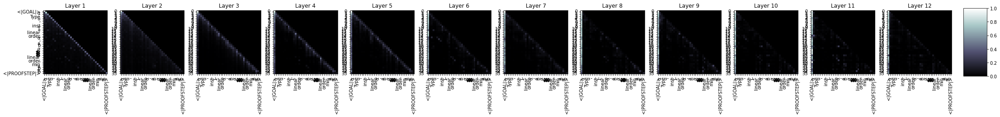

131200it [1:30:09, 26.25it/s]

  Step 131,200  of  147,271. Loss: 1.226392388343811.   Elapsed: 1:30:09.
Sample:rw [neg_comm]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refine (λ (_x : list α), a)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_def<|endoftext|><|PROOFSTEP|>simp only [_self_iff.1]<|endoftext|><|PROOFSTEP|>rw [← @coe_inter_self_iff.1]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_symm<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [has_one, at_top_iff, at_top_iff, @s1.1.2_iff, at_top_iff, by rw [h<|endoftext|><|PROOFSTEP|>apply_instance, exists_eq_right_iff, ← at_top.iff.2, at_top_iff, by rw, at_top_iff]<|endoftext|><|PROOFSTEP|>exact_instance<|endoftext|><|PROOFSTEP|>simp (ext_arg (nat.symm_iff_comp_comp_subtype : is_comp_
s -> 0.4287055730819702
ex -> 0.17703747749328613
rw -> 0.11393971741199493
apply -> 0.10111968219280243
int -> 0.053722284734249115
cases -> 0.0300712

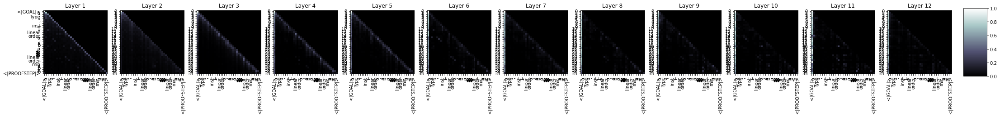

134399it [1:32:23, 24.29it/s]

  Step 134,400  of  147,271. Loss: 0.9973878860473633.   Elapsed: 1:32:23.
Sample:exact min_dist_right_cancel_right B a<|endoftext|><|PROOFSTEP|>dsimp [le_right, add_cancel, ← mul_one]<|endoftext|><|PROOFSTEP|>apply one_le<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext1<|endoftext|><|PROOFSTEP|>exact ⟨b, hb⟩<|endoftext|><|PROOFSTEP|>ext1 : hb⟩<|endoftext|><|PROOFSTEP|>s : ereal (real.real.real_univ) ← int.is_pi_nreal<|endoftext|><|PROOFSTEP|>s : real (ereal.real_univ)<|endoftext|><|PROOFSTEP|>have : with.<|endoftext|><|PROOFSTEP|>have<|endoftext|><|PROOFSTEP|>s : set (real.real_univ) := {x : real (ereal.real_univ) | hx⟩<|endoftext|><|PROOFSTEP|>exact (set.inter_range.to_set_prod).inter<|endoftext|><|PROOFSTEP|>s1 : set, with ⊥ := set.Iic<|endoftext|>
s -> 0.45067694783210754
rw -> 0.14991258084774017
ex -> 0.14603249728679657
apply -> 0.09450928121805191
int -> 0.04725173860788345
have -> 0.0238

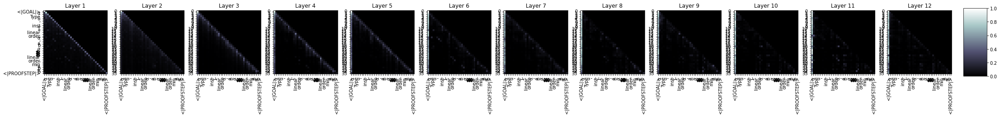

137600it [1:34:35, 23.50it/s]

  Step 137,600  of  147,271. Loss: 1.0274232625961304.   Elapsed: 1:34:36.
Sample:simp<|endoftext|><|PROOFSTEP|>by_cases b0 : 0 < b, by simp only [zero_or_add, neg_one]<|endoftext|><|PROOFSTEP|>cases a<|endoftext|><|PROOFSTEP|>simp [zero_or_add, add_assoc, one_mul, mul_assoc, mul_one, mul_refl]<|endoftext|><|PROOFSTEP|>rw int.add_comm<|endoftext|><|PROOFSTEP|>s₁<|endoftext|><|PROOFSTEP|>solve_right<|endoftext|><|PROOFSTEP|>solve_right : ∀ b := b.neg (nat.div2 b).2<|endoftext|><|PROOFSTEP|>classical<|endoftext|><|PROOFSTEP|>exact_left<|endoftext|><|PROOFSTEP|>s1 (expos.of_pos_left (nat.neg_le<|endoftext|><|PROOFSTEP|>m_b_mem _ _)<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>syndicate<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>intros<|endoftext|>d_eq_to_fun<|endoftext|>pow<|endoftext|><|PROOFSTEP|>snd<|endoftext|><|PROOFSTEP|>sne1<|endoftext|><|PROOFSTEP|>sne1 : 0 = 0<|endoftext|><|PROOFSTEP|>
s -> 0.4421093165874481
rw -> 0.21592125296592

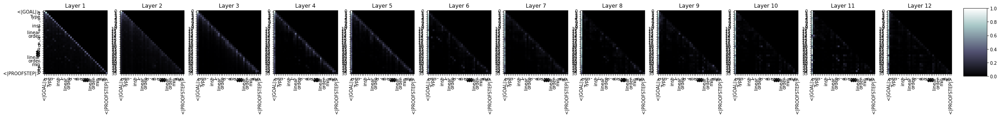

140800it [1:36:47, 26.01it/s]

  Step 140,800  of  147,271. Loss: 0.93197101354599.   Elapsed: 1:36:48.
Sample:simp only [min_eq_zero_iff_lt_top_le_iff, min_eq_zero_iff_infinite]<|endoftext|><|PROOFSTEP|>suffices : is_simple_elim (has_one {o : ℕ | o.snd < o.snd}) ↔ is_simple enough _<|endoftext|><|PROOFSTEP|>rw [← nat.div_eq_bot, ← ← not_not]<|endoftext|><|PROOFSTEP|>rw [le_top, ← not_not] at le_top<|endoftext|><|PROOFSTEP|>rw [lt_top, ← this, ← coeff_mod, top, ← id_le] at le_top<|endoftext|><|PROOFSTEP|>rw [add_one, ← add_all, ← coeff_iff_nat_eq_bot]<|endoftext|><|PROOFSTEP|>exact eq_false_of_le_false<|endoftext|><|PROOFSTEP|>rw ← ← exists_false_of<|GOAL|>n<|endoftext|><|PROOFSTEP|>simp<|endoftext|>
rw -> 0.3030242323875427
s -> 0.23193559050559998
ex -> 0.15816150605678558
apply -> 0.12743234634399414
int -> 0.055353689938783646
have -> 0.03197012096643448
cases -> 0.029293902218341827
re -> 0.022417165338993073
split -> 0.021542470902204514
ref -> 0.018868938088417053


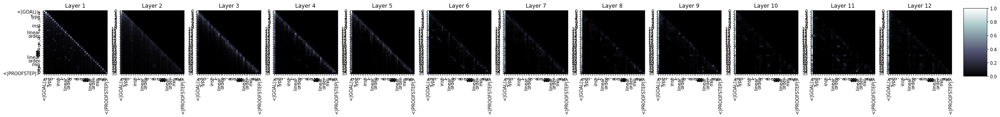

143999it [1:39:01, 25.82it/s]

  Step 144,000  of  147,271. Loss: 1.162930965423584.   Elapsed: 1:39:01.
Sample:rw [max_iff, min_eq_right_iff, max_iff_le, max_iff_le]<|endoftext|><|PROOFSTEP|>ext x y<|endoftext|><|PROOFSTEP|>exact le_trans _ _<|endoftext|><|PROOFSTEP|>simp [← hsq]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rcases hxy := hxy<|endoftext|><|PROOFSTEP|>exact hx<|endoftext|><|PROOFSTEP|>ext_left<|endoftext|><|PROOFSTEP|>apply left_mul<|endoftext|><|PROOFSTEP|>refine le_refl<|endoftext|>by_refl<|endoftext|>F<|endoftext|><|PROOFSTEP|>norm_left<|endoftext|><|PROOFSTEP|>refl<|endoftext|>← nat_fst<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw ← rt_image_eq_mem<|endoftext|><|PROOFSTEP|>norm_left<|endoftext|><|PROOFSTEP|>injector<|endoftext|><|PROOFSTEP|>rw ← nat_fst_eq_mem<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply h<|endoftext|>x<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>ext_inter<|endoftext|>by_le<|endoftext|>h<|endoftext|><|PROOFSTEP|>simp<|endoftext|>X

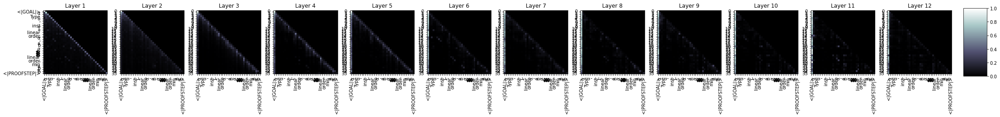

147199it [1:41:12, 23.96it/s]

  Step 147,200  of  147,271. Loss: 0.9736790060997009.   Elapsed: 1:41:13.
Sample:split<|endoftext|><|PROOFSTEP|>obtain ⟨x, hx, hx⟩ := ne_of_le_left<|endoftext|><|PROOFSTEP|>have : 1 = 1<|endoftext|><|PROOFSTEP|>set i : set (interior (set.interior x)) :=Interior_of_Iio<|endoftext|><|PROOFSTEP|>haveI : Iio x1 x0	⊢ 1 = x1 x0<|endoftext|><|PROOFSTEP|>apply (subset_eq_one_iff_finite_set.2 (subset_eq_one_iff_finite_set.1))<|endoftext|><|PROOFSTEP|>apply (set_of_one_neg<|endoftext|><|PROOFSTEP|>apply (of_one_eq_one_iff_finite_set.8)<|endoftext|><|PROOFSTEP|>apply_mod_self<|endoftext|><|PROOFSTEP|>exact<|endoftext|><|PROOFSTEP|>apply_mod_self<|endoftext|>mul_not_unfib<|endoftext|><|PROOFSTEP|>apply_def<|endoftext|>d<|endoftext|><|PROOFSTEP|>symm<|endoftext|><|PROOFSTEP|>apply_distrib<|endoftext|>this<|endoftext|>simp only [pow_
s -> 0.39177629351615906
rw -> 0.16712549328804016
ex -> 0.15762820839881897
apply -> 0.13017597794532776
int -> 0.042969707399606705
re -> 0.029373079538345337
have -

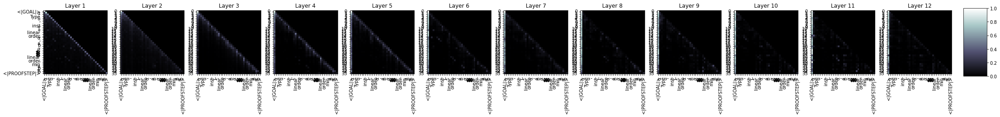

147271it [1:41:21, 24.22it/s]



  Average training loss: 1.02
  Training epoch took: 1:41:22

Running Validation...
  Validation Loss: 0.96
  Validation took: 0:01:33


3it [00:00, 28.23it/s]


======== Epoch 27 / 35 ========
Training...


3199it [02:06, 28.94it/s]

  Step 3,200  of  147,271. Loss: 0.5773823261260986.   Elapsed: 0:02:06.
Sample:intros<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have h<|endoftext|><|PROOFSTEP|>intros at h1 h2 h2 h2<|endoftext|><|PROOFSTEP|>apply_classical<|endoftext|><|PROOFSTEP|>sub := preimage.symm<|endoftext|><|PROOFSTEP|>apply_classical<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>intros<|endoftext|>I : {x : [x] | nxor x.1 : 1, one_one, one_ne_one, one_ne_one] }<|endoftext|><|PROOFSTEP|>s : ⟨x, y, x.2⟩,<|endoftext|><|PROOFSTEP|>convert (x' {x}⟩)<|endoftext|><|PROOFSTEP|>ext ⟨x, y, x.2⟩<|endoftext|><|PROOFSTEP|>t : nnreal.dist 0 nnfinsupp.1 0 1 with nnfinsupp.2<|endoftext|><|PROOFSTEP|>refine ⟨x' x' y'⟩<|endoftext|><|PROOFSTEP|>refine (eq_one_eq
s -> 0.32679280638694763
ex -> 0.17050865292549133
apply -> 0.16046547889709473
rw -> 0.13291922211647034
int -> 0.08978716284036636
have -> 0.03247908130288124

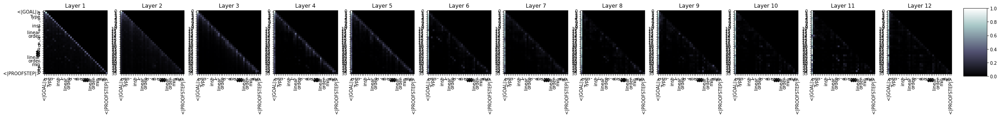

6398it [04:20, 24.22it/s]

  Step 6,400  of  147,271. Loss: 0.850674033164978.   Elapsed: 0:04:21.
Sample:intros<|endoftext|><|PROOFSTEP|>refine (max_eq_max_iff.4 (λ _ _ _ _).symm).symm.2<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>intro hx<|endoftext|><|PROOFSTEP|>apply_right<|endoftext|><|PROOFSTEP|>simp only [inv_comp]<|endoftext|><|PROOFSTEP|>simp_self<|endoftext|><|PROOFSTEP|>refl<|endoftext|>I<|endoftext|><|PROOFSTEP|>tidy<|endoftext|><|PROOFSTEP|>apply_mem<|endoftext|>this.0 at v1<|endoftext|><|PROOFSTEP|>apply_left<|endoftext|>I<|endoftext|><|PROOFSTEP|>rint_iff<|endoftext|>(mul - tmul)<|endoftext|><|PROOFSTEP|>refl<|endoftext|>⊢ 0 _ = 1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [mul0, mema, and_imp_eq_zero] at mul<|endoftext|><|PROOFSTEP|>convert _<|endoftext|><|PROOFSTEP|>refl<|endoftext|>K<|endoftext|><|PROOFSTEP|>convert ⟨X, sub_le, hydite⟩<|endoftext|><|PROOFSTEP|>simp_refl<|endoftext|><|PROOFSTEP|>show {unfold_eq, sub_le, hf_con
s -> 0.37624

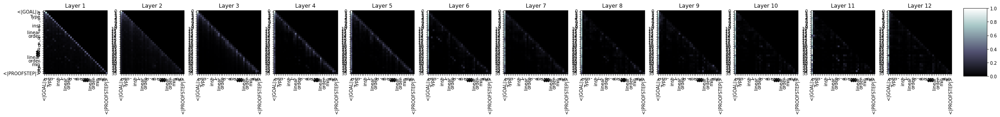

9598it [06:33, 24.64it/s]

  Step 9,600  of  147,271. Loss: 0.7300835251808167.   Elapsed: 0:06:33.
Sample:conv_lhs { lhs }<|endoftext|><|PROOFSTEP|>exact max_max (le_max_iff_ne_top _ _)<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact le_max_ne _ (max_le_top _ _ _ _)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact or.def rfl<|endoftext|><|PROOFSTEP|>show a<|endoftext|><|PROOFSTEP|>refl<|endoftext|>f : one (one) = nth_le_sub : (1 : one) = nth_le_sub<|endoftext|><|PROOFSTEP|>exact ⟨c₁ _.1, hn₁, c₂.1, hn₂, hn₁.2<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>split_iff<|endoftext|><|PROOFSTEP|>exact<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp: one (one) = nth_le_sub<|endoftext|><|PROOFSTEP|>int_ne_top<|endoftext|><|PROOFSTEP|>exact if _.1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>
s -> 0.39001181721687317
ex -> 0.1519373208284378
rw -> 0.1385413110256195
apply -> 0.1354554295539856
int -> 0.0816301628947258
have -> 0.0304753

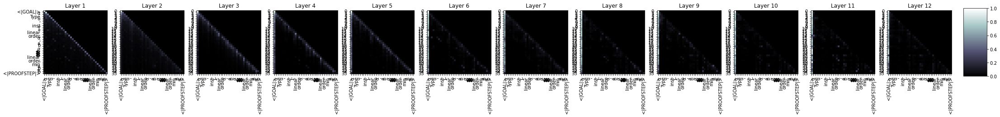

12800it [08:45, 23.58it/s]

  Step 12,800  of  147,271. Loss: 0.841593861579895.   Elapsed: 0:08:45.
Sample:simp [min_ne_top]<|endoftext|><|PROOFSTEP|>simp only [div_eq_one_mul_left, div_eq_one_mul_right]<|endoftext|><|PROOFSTEP|>apply dvd_left<|endoftext|><|PROOFSTEP|>apply dev_sup (dvd_right a b)<|endoftext|><|PROOFSTEP|>apply c1_mul<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply | (le_refl_top $ dvd_top (le_of_ne $ hle_uncongr $ le_refl $ dvd_top $ hle_uncongr $ le_refl $ dvd_-_trans (h' : sigma.to_top.to_top.symm tsigma.to_top.symm $ nat_prod_left_symm.1 $ nat_prod_left_symm.2 $ nat_prod_left_symm $ nat_prod_left_
apply -> 0.2766275107860565
s -> 0.20862726867198944
ex -> 0.16900357604026794
int -> 0.11249317228794098
rw -> 0.10243812203407288
have -> 0.04310131072998047
re -> 0.031065914779901505
ref -> 0.022009797394275665
cases -> 0.018853826448321342
sim -> 0.015779394656419754


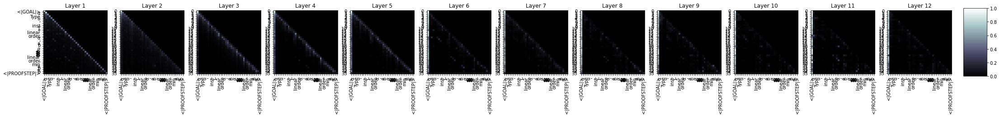

15998it [10:56, 27.35it/s]

  Step 16,000  of  147,271. Loss: 0.8910008072853088.   Elapsed: 0:10:56.
Sample:intros<|endoftext|><|PROOFSTEP|>simp [← rpow_le_iff_one, pow_one]<|endoftext|><|PROOFSTEP|>simp [← rpow_right]<|endoftext|><|PROOFSTEP|>simp [← mul_right, mul_left, zero_mul]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [← int.add_right]<|endoftext|><|PROOFSTEP|>sim_assoc (add_right a b b c c d [← add_right] _, int.sub_left]<|endoftext|><|PROOFSTEP|>simpa [(add_le_left rfl] by rw [add_nhds, add_sub_cancel_left] h]<|endoftext|><|PROOFSTEP|>simp (1 2 3 4)<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rwa [add_left]<|endoftext|><|PROOFSTEP|>simp (1 2 3 4)<|endoftext|><|PROOFSTEP|>apply_trans<|endoftext|><|PROOFSTEP|>rwa [add_add_right]<|endoftext|><|PROOFSTEP|>apply_trans<|endoftext|><|PROOFSTEP|>apply_trans<|endoftext|><|PROOFSTEP|>
s -> 0.4696335792541504
rw -> 0.14903011918067932
apply -> 0.0990990474820137
ex -> 0.0976371243596077
int -> 0.07034148275852203
re -> 0.0234699230641126

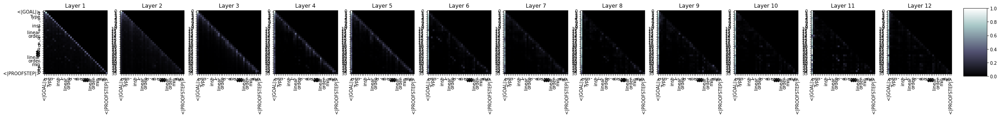

19200it [13:08, 26.81it/s]

  Step 19,200  of  147,271. Loss: 0.6775677800178528.   Elapsed: 0:13:09.
Sample:exact_mod_cast _ _<|endoftext|><|PROOFSTEP|>exact or.inr (λ a b c, _)<|endoftext|><|PROOFSTEP|>symmetry<|endoftext|><|PROOFSTEP|>intros x hx<|endoftext|><|PROOFSTEP|>by_cases hx : x is a 0<|endoftext|><|PROOFSTEP|>simpa : ⟨x, hx⟩, _, xrefl⟩<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact! (I.mem_Icc_Icc)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have_fst_mem_mem_inv<|endoftext|><|PROOFSTEP|>exists_mem_inv (I.mem_Icc _ x).symm<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact_eq<|endoftext|><|PROOFSTEP|>simp_cast<|endoftext|><|PROOFSTEP|>refl<|endoftext|>by_induction (le_to_finset)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact (le_to_finset.elim<|endoftext|><|PROOFSTEP|>exact_le_self<|endoftext|><|PROOFSTEP|>by_le<|endoftext|><|PROOFSTEP|>exact_f
s -> 0.37788015604019165
apply -> 0.1468716859817505
ex -> 0.133091539144516
rw -> 0.09746567904949188
int -> 0

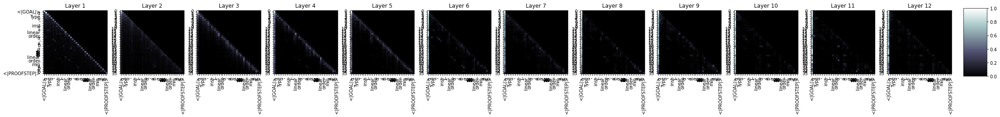

22400it [15:20, 25.32it/s]

  Step 22,400  of  147,271. Loss: 0.9496360421180725.   Elapsed: 0:15:21.
Sample:simp only [min_le_add_le, max_le_add, min_add_le_add, max_le_add_left, max_le_add_right, max_le_add_right]<|endoftext|><|PROOFSTEP|>apply inv_self<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>by_cases {h}<|endoftext|><|PROOFSTEP|>induction 0 (0)<|endoftext|><|PROOFSTEP|>exact or.in_le h0 rfl<|endoftext|><|PROOFSTEP|>rw [← sub_not_neg, add_symm_pos_iff, add_sub, sub_right_def, ← a2p]<|endoftext|><|PROOFSTEP|>simp H.1 A 2 : (sub_eq_pos h).1 (0 : 1) → sub_eq_pos h.2 (1 : 2)<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>by_mod<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>s : list_perm_add_of_le h<|endoftext|>
s -> 0.3851787745952606
apply -> 0.17247366905212402
rw -> 0.12085123360157013
ex -> 0.09817004948854446
cases -> 0.05758485570549965
int -> 0.05294362083077431
by -> 0.03992440178990364
have -> 0.027584234252572

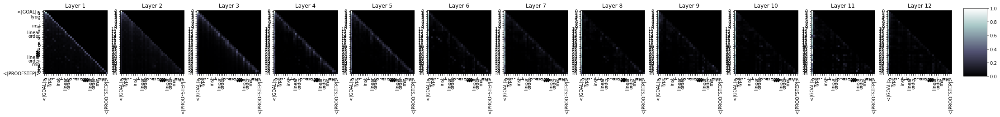

25597it [17:32, 27.96it/s]

  Step 25,600  of  147,271. Loss: 0.8896045088768005.   Elapsed: 0:17:33.
Sample:simp [min_le_le]<|endoftext|><|PROOFSTEP|>simp [min_le_le_iff_right a]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>symm<|endoftext|><|PROOFSTEP|>simp {to_i | to_i}<|endoftext|><|PROOFSTEP|>simp_1 [ne_self, int.right_to_inj, ⟨]<|endoftext|><|PROOFSTEP|>simp_2<|endoftext|><|PROOFSTEP|>simp_2<|endoftext|><|PROOFSTEP|><|endoftext|><|PROOFSTEP|>cases (1 1)<|endoftext|><|PROOFSTEP|>rcases rfl1 (1 1) with ⟨1, rfl1.2⟩<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>rfl, tsum, rfl2<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintros ⟨⟩, ⟩⟩⟩<|endoftext|><|PROOFSTEP|>tsum.1 (1 1)<|endoftext|><|PROOFSTEP|>apply tsum.2<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintros<|endoftext|>
s -> 0.3715541660785675
rw -> 0.14084111154079437

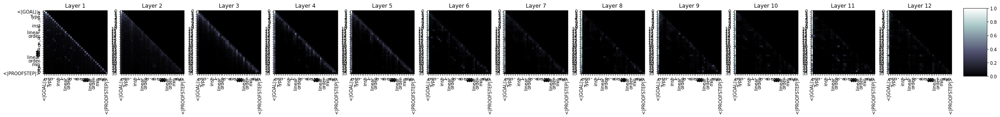

28799it [19:44, 27.66it/s]

  Step 28,800  of  147,271. Loss: 1.0283730030059814.   Elapsed: 0:19:45.
Sample:rintros ⟨x y hy, hxy⟩ ⟨x, hy, hxy⟩<|endoftext|><|PROOFSTEP|>obtain ⟨f, ha, hf⟩ := ⟨⟩<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_eq_const' f<|endoftext|><|PROOFSTEP|>have := has_insert<|endoftext|><|PROOFSTEP|>apply_eq_convert_div' c_of_ne_zero_of_ne (f.ne_zero_of_ne_zero.0)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exists_comp_norm<|endoftext|><|PROOFSTEP|>exists_comp_eq_convert_eq_convert_norm' c_of_ne_zero<|endoftext|><|PROOFSTEP|>by_cases : ne.symm<|endoftext|><|PROOFSTEP|>cases h : set.range (∃ x, h) = set.range (∃ x, 𝓝 x),<|endoftext|><|PROOFSTEP|>cases hx : hx = set.range hx
s -> 0.30817192792892456
ex -> 0.1666361391544342
apply -> 0.13873504102230072
rw -> 0.13621705770492554
cases -> 0.1135813519358635
int -> 0.046167388558387756
by -> 0.028601430356502533
have -> 0.02641267329454422
ref -> 0.018628139048814774
re -> 0.016848938539624214


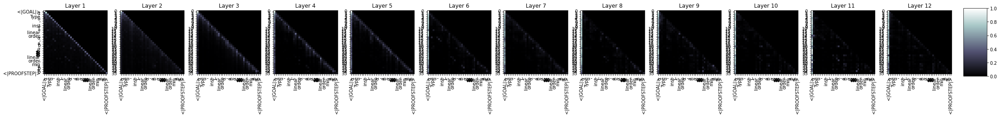

31999it [21:55, 26.09it/s]

  Step 32,000  of  147,271. Loss: 0.8268788456916809.   Elapsed: 0:21:55.
Sample:rw [min_le_iff_nonneg]<|endoftext|><|PROOFSTEP|>ext s<|endoftext|><|PROOFSTEP|>rw nnreal.neg_le_iff_neg<|endoftext|><|PROOFSTEP|>rw nnreal.neg_le_iff_neg_le'<|endoftext|><|PROOFSTEP|>rw a<|endoftext|><|PROOFSTEP|>simp only [finset.coe']<|endoftext|><|PROOFSTEP|>rw [apply_def]<|endoftext|><|PROOFSTEP|>have := sub_to_finset.2 (of_mem a b)<|endoftext|><|PROOFSTEP|>apply_def<|endoftext|><|PROOFSTEP|>rw [eq_def_eq, hb']<|endoftext|><|PROOFSTEP|>rw [add_apply, neg_apply, ←set_eq.symm, ←set_set_iff, sub_eq h]<|endoftext|><|PROOFSTEP|>unfold_iff<|endoftext|><|PROOFSTEP|>s with h<|endoftext|><|PROOFSTEP|>ds general_iso<|endoftext|><|PROOFSTEP|>simpa [simp.1_ne] using simp.1<|endoftext|><|PROOFSTEP|>apply_def<|endoftext|><|PROOFSTEP|>refine<|endoftext|><|PROOFSTEP|>refine, rfl<|endoftext|><|PROOFSTEP|>simp.2.1
s -> 0.3103591203689575
ex -> 0.20340827107429504
rw -> 0.19752776622772217
apply -> 0.1001308485865593
cas

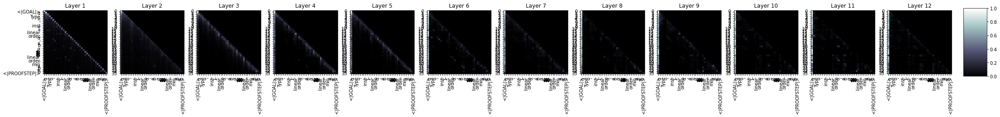

35200it [24:07, 27.17it/s]

  Step 35,200  of  147,271. Loss: 0.6680046916007996.   Elapsed: 0:24:07.
Sample:simp [max_eq_max]<|endoftext|><|PROOFSTEP|>exact (max_le ⟨⟩).mpr (max_le ⟨⟩).snd)<|endoftext|><|PROOFSTEP|>simp [*, eof_iff]<|endoftext|><|PROOFSTEP|>by : eof_iff<|endoftext|><|PROOFSTEP|>simp.1 (pow_le_one_iff, one_symm $ ne.symm_self)<|endoftext|><|PROOFSTEP|>simp [1, one_symm, one_symm_eq_iff, zero_symm, or_le]<|endoftext|><|PROOFSTEP|>by rintros rfl<|endoftext|><|PROOFSTEP|>by rfl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw [← at this, one_symm_eq_iff]<|endoftext|><|PROOFSTEP|>subset_le<|endoftext|><|PROOFSTEP|>refine @subset_le using subset_le_left<|endoftext|><|PROOFSTEP|>apply_of_subset<|endoftext|><|PROOFSTEP|>rw [add_one_mul, of_subset_left']
s -> 0.4012666940689087
ex -> 0.21722114086151123
rw -> 0.12895457446575165
apply -> 0.07261203974485397
cases -> 0.05345167964696884
int -> 0.05166248977184296
by -> 0.023556282743811607
ref -> 0.0183220487087965
rc -> 0.01672513782978058
re ->

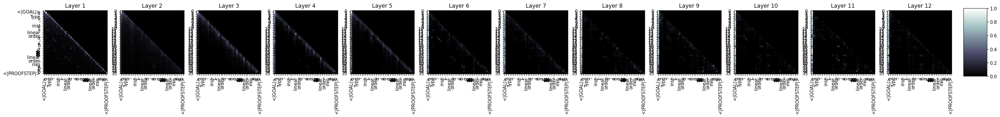

38400it [26:17, 26.19it/s]

  Step 38,400  of  147,271. Loss: 0.9591662287712097.   Elapsed: 0:26:17.
Sample:simp [min_right]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>intros (hd_eq_dvd : nat.le_dvd_iff hd_eq_ Dude)<|endoftext|><|PROOFSTEP|>classical<|endoftext|><|PROOFSTEP|>convert<|endoftext|><|PROOFSTEP|>s hd_zero<|endoftext|><|PROOFSTEP|>simp { exact }<|endoftext|><|PROOFSTEP|>rw [pow_def, sub_apply, add_add, add_eq_def]<|endoftext|><|PROOFSTEP|>exact hd_zero_right<|endoftext|><|PROOFSTEP|>exact $ not_le $ not_infi<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>tactic<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>rintros {to_pow_one, e_pow, one_pow₁} {to_pow_one }<|endoftext|><|PROOFSTEP|>cases this<|endoftext|><|PROOFSTEP|>simp [pow_of_pow, e_pow']<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rwa [pow_def, e_pow]<|endoftext|><|PROOFSTEP|>cases h
s -> 0.4907166659832001
ex -> 0.17274156212806702
rw -> 0.11403494328260422
apply -> 0

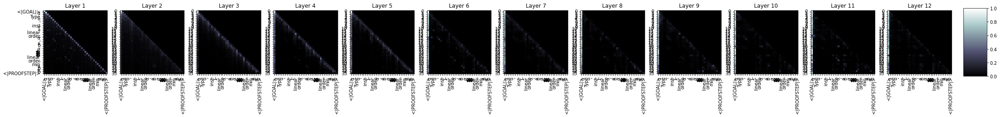

41599it [28:27, 25.57it/s]

  Step 41,600  of  147,271. Loss: 0.7868122458457947.   Elapsed: 0:28:28.
Sample:exact min_le_max_iff<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>by_cases h : cau_seq ⟨_, rfl⟩<|endoftext|><|PROOFSTEP|>simp only [list_of_le_left_left, list_of_le_right, add_right_iff_left]<|endoftext|><|PROOFSTEP|>simp_rw [mul_succ_left]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_self<|endoftext|><|PROOFSTEP|>ring_mul (IH : IH)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>try {contextual, intros}<|endoftext|><|PROOFSTEP|>rintro<|endoftext|><|PROOFSTEP|>intro ⟨h₁⟩ h₂⟩<|endoftext|><|PROOFSTEP|>exact_dist_comp<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>simp_le_right<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>by_add ⟨⟩<|endoftext|><|PROOFSTEP|>apply<|endoftext|>
s -> 0.2872467339038849
r

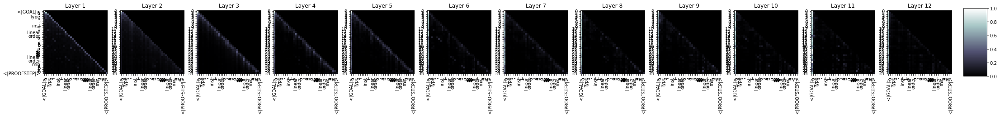

44799it [30:40, 24.20it/s]

  Step 44,800  of  147,271. Loss: 0.6882365942001343.   Elapsed: 0:30:40.
Sample:simp<|endoftext|><|PROOFSTEP|>exactI a<|endoftext|><|PROOFSTEP|>cases (le : ⊓) a<|endoftext|><|PROOFSTEP|>exact_mod_cast (show only a) (le_of_lt ⟨a, le_of_lt ⟨b, le<|GOAL|>A₁ ⟨hb, _₂]<|endoftext|><|PROOFSTEP|>exactI 0<|endoftext|><|PROOFSTEP|>have := h0<|endoftext|><|PROOFSTEP|>exact_mem_univ<|endoftext|><|PROOFSTEP|>s_eq_zero_of_zero_le n hn<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply nat.zero_le_right<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>by_default<|endoftext|><|PROOFSTEP|>simp only [le_lt_iff]<|endoftext|><|PROOFSTEP|>simp_not_right_iff<|endoftext|><|PROOFSTEP|>congr (1:le_of_right [← inf_subset_left, le_cancel, ← not_iff_nonneg, �
s -> 0.3626459538936615
ex -> 0.17067010700702667
rw -> 0.16226574778556824
apply -> 0.12705908715724945
cases -> 0.0495419017970562
int -> 0.041544009

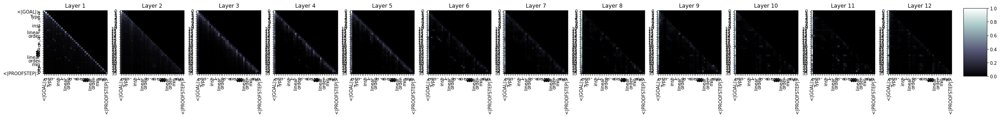

47999it [32:50, 24.82it/s]

  Step 48,000  of  147,271. Loss: 1.2225395441055298.   Elapsed: 0:32:51.
Sample:simp<|endoftext|><|PROOFSTEP|>simp [min_div_eq_iff_ne_zero]<|endoftext|><|PROOFSTEP|>simp [le_iff_ne_zero]<|endoftext|><|PROOFSTEP|>simp [ne_iff_ne_zero]<|endoftext|><|PROOFSTEP|>simp [ne_iff_ne_zero, ne_iff_not_iff]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp [ne_iff_not_iff, not_nonneg]<|endoftext|><|PROOFSTEP|>simp [not_nonneg] (set.not_nonneg (neg_neg a)), (not_nonneg a).1<|endoftext|><|PROOFSTEP|>simp {to_fun := (not_nonneg a) }<|endoftext|><|PROOFSTEP|>tendsto_le_one_mul_of%.1 (tendsto_one_le_one $ tendsto_one_le_one.1 (le_one_of_ne_zero' (le_one_of_ne_zero)) (
s -> 0.49939289689064026
rw -> 0.15867078304290771
ex -> 0.11097413301467896
apply -> 0.08482188731431961
cases -> 0.03697206825017929
by -> 0.028805848211050034
int -> 0.023114826530218124
sim -> 0.02074914239346981
ref -> 0.01909671351313591
t -> 0.01740175485610962


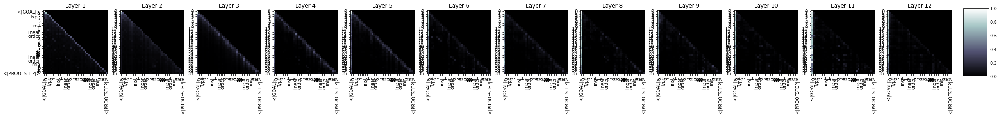

51200it [35:01, 24.03it/s]

  Step 51,200  of  147,271. Loss: 1.1645418405532837.   Elapsed: 0:35:01.
Sample:rw [lt_iff_le_iff, tendsto_iff]<|endoftext|><|PROOFSTEP|>rw [limit_eq_limit_nonneg].def<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>ext x<|endoftext|><|PROOFSTEP|>apply!<|endoftext|><|PROOFSTEP|>exact_univ<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>apply_left.symm<|endoftext|><|PROOFSTEP|>assumption 1<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact_eq_max<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases_right<|endoftext|>N : ∀(n : ℕ), (k : ℝ) ≠ ℚ, N = N.1<|endoftext|><|PROOFSTEP|>have rfl<|endoftext|><|PROOFSTEP|>letrfl<|endoftext|><|PROOFSTEP|>rc := n<|endoftext|><|PROOFSTEP|>set_nhds<|endoftext|><|PROOFSTEP|>exact_top<|endoftext|><|PROOFSTEP|>rw [max_rfl, rfl]<|endoftext|><|PROOFSTEP|>tendsto<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply (nhds_of_dvd hs_inj).symm<|endoftext|><|PROOFSTEP|>exact_eq_dvd<|endoftext|>


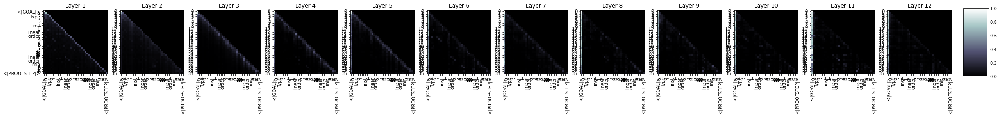

54398it [37:12, 26.48it/s]

  Step 54,400  of  147,271. Loss: 1.101941466331482.   Elapsed: 0:37:13.
Sample:rwa [min_add_left_iff,min_neg_left_iff,neg_eq_iff_neg]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact inv_eq_zero_of_eq_one_of_mem _<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>exact eq_zero_of barring_fintype<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>exact _<|endoftext|><|PROOFSTEP|>refine prod_not_prod ⟨g, gt, hg, b, not_prod_mem⟩<|endoftext|><|PROOFSTEP|>rintro _ ⟨g, gt, hg, not_prod_mem⟩<|endoftext|><|PROOFSTEP|>haveh := {left]<|endoftext|><|PROOFSTEP|>simplex, not_prod, no_prod := subtype.nonneg_is_right ⟨f, cg, le_mul, not_prod_mem⟩<|endoftext|><|PROOFSTEP|>cases e<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>
s -> 0.5133655667304993
ex -> 0.12276554852724075
rw -> 0.11586686223745346
apply -> 0.1127602756023407
int -> 0.029542455449700356
cases -> 0.025784792378544807
t -> 0.024174660444259644
ref -> 0.0202175322920084
re -> 0.01816572435200214

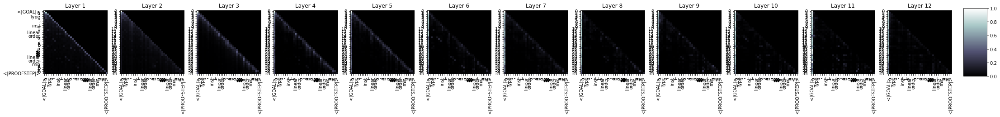

57598it [39:26, 28.67it/s]

  Step 57,600  of  147,271. Loss: 0.7407380938529968.   Elapsed: 0:39:26.
Sample:rw min_eq_max_iff_left<|endoftext|><|PROOFSTEP|>rwa [mem_iff_self_iff, min_iff_right]<|endoftext|><|PROOFSTEP|>simp [max_eq_iff]<|endoftext|><|PROOFSTEP|>assumption (inv_mem_iff.1 (inv_mem_iff.2 {inv_inv := i] {inv := inv_iff.1 j _ }<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intro x y<|endoftext|><|PROOFSTEP|>refl0<|endoftext|><|PROOFSTEP|>refine le_of_eq<|endoftext|><|PROOFSTEP|>exact_le<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>rw [nat.snd, finset.coe_le]<|endoftext|><|PROOFSTEP|>sneq : is_comm_compl_eq_self : has_lt_iff_eq<|endoftext|><|PROOFSTEP|>sneq<|endoftext|><|PROOFSTEP|>sneq ⟨x, hx⟩<|endoftext|><|PROOFSTEP|>sineq<|endoftext|><|PROOFSTEP|>exact rt_mem<|endoftext|><|PROOFSTEP|>apply.symm<|endoftext|><|PROOFSTEP|>norm<|endoftext|><|PROOFSTEP|>exact! rp
s -> 0.34931424260139465
ex -> 0.2374531477689743
rw -> 0.12798939645290375
apply -> 0.12572158873081207
int -> 0.

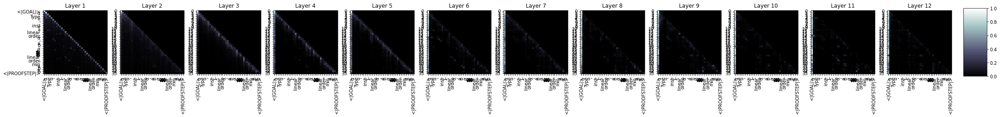

60799it [41:38, 22.52it/s]

  Step 60,800  of  147,271. Loss: 1.4561671018600464.   Elapsed: 0:41:38.
Sample:exact min_lt_min (le_left_of_lt a b)<|endoftext|><|PROOFSTEP|>simp [simp_top]<|endoftext|><|PROOFSTEP|>simp [le_top_iff_eq_top]<|endoftext|><|PROOFSTEP|>ext w ←simp_top_bunion<|endoftext|><|PROOFSTEP|>rintros ⟨rfl⟩<|endoftext|><|PROOFSTEP|>rw ←←<|endoftext|><|PROOFSTEP|>indicator (instructor.1 : instructor.1_inl 0)<|endoftext|><|PROOFSTEP|>simp only [x_rfl]<|endoftext|><|PROOFSTEP|>rw [indicator_eq]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>dvd_iff.elim _<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rw hrc : set.mem_singleton.2 (dvd_eq.1 1 : x_rfl)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>tidy<|endoftext|><|PROOFSTEP|>simp : ∀ x x y x' a, x' ∣ x' a → y' a, x' x'
s -> 0.31418007612228394
ex -> 0.1906883716583252
apply -> 0.1659700721502304
rw -> 0.16017301380634308
cases -> 0.0344834104180336
int -> 0.03351592645049095
norm -> 0.030896171927452087
have -> 0.0276126004755

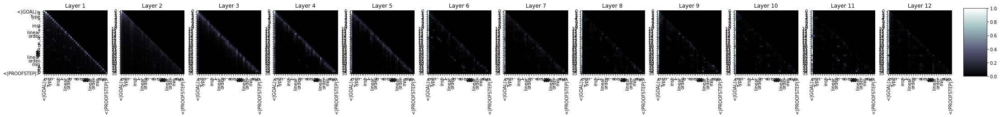

63998it [43:51, 25.48it/s]

  Step 64,000  of  147,271. Loss: 1.0005830526351929.   Elapsed: 0:43:52.
Sample:ext<|endoftext|><|PROOFSTEP|>exact min_ne_zero $ sup_ne _ (by simp) (min_ne_zero (le_antisymm a b))<|endoftext|><|PROOFSTEP|>have := λ s hs, by simp<|endoftext|><|PROOFSTEP|>simp [ne_empty] ha, zero_le_zero (hs), mul_zero (zero_le_iff)<|endoftext|><|PROOFSTEP|>split_right<|endoftext|><|PROOFSTEP|>apply is_ne_bot.1<|endoftext|><|PROOFSTEP|>apply is taught_in<|endoftext|><|PROOFSTEP|>apply.2<|endoftext|><|PROOFSTEP|>apply_of_mem_subsingleton<|endoftext|><|PROOFSTEP|>obtain ⟨0, sub_eq_top⟩ := sub_eq_top.2<|endoftext|><|PROOFSTEP|>by<|endoftext|><|PROOFSTEP|>apply_of<|GOAL|>_le_iff1<|endoftext|><|PROOFSTEP|>apply_of_le_iff1<|endoftext|><|PROOFSTEP|>apply_of_le_iff1<|endoftext|><|PROOFSTEP|>simp_refl<|endoftext|><|PROOFSTEP|>exact _<|endoftext|><|PROOFSTEP|>apply_of_le_iff1<|endoftext|><|PROOFSTEP|>by
s -> 0.25438809394836426
apply -> 0.23355922102928162
ex -> 0.20989452302455902
rw -> 0.11385036259889603
int -

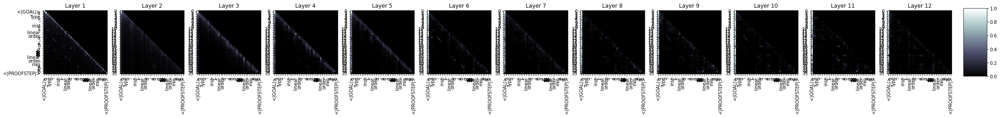

67199it [46:03, 21.69it/s]

  Step 67,200  of  147,271. Loss: 1.4474291801452637.   Elapsed: 0:46:04.
Sample:rw [← hab_le_iff_zero]<|endoftext|><|PROOFSTEP|>simp[← h]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refine (repr_of_inv {inv := @inv_def _ _ _ _ _ _ _ _ _ _ _ _ _ _ (inv.coe_inv_def _ _ _))<|endoftext|><|PROOFSTEP|>simp [← (def_eq_coe a}, ← (def_eq_coe (inv.coe_def _ _) _ _]<|endoftext|><|PROOFSTEP|>rw [← (def_eq_coe (inv.cast_def _)) _]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>by simp : (λ t : ℝ, t ↑4) (λ r r : ℝ, r xs t)<|endoftext|><|PROOFSTEP|>simp (2 : ℝ), inv_cast (2 : ℝ), inv_cast_def, inv_cast_def, simp
s -> 0.25106000900268555
rw -> 0.23709164559841156
ex -> 0.16674479842185974
apply -> 0.1630437970161438
cases -> 0.04689539223909378
int -> 0.039717625826597214
have -> 0.034543227404356
ind -> 0.02141886204481125
norm -> 0.021389057859778404
ref -> 0.018095653504133224


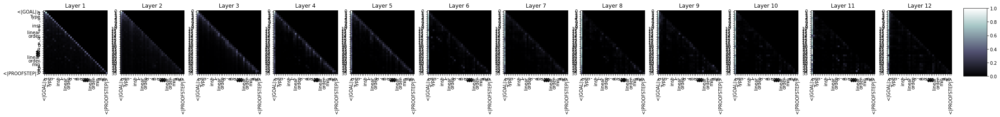

70400it [48:15, 23.08it/s]

  Step 70,400  of  147,271. Loss: 1.057998538017273.   Elapsed: 0:48:16.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>exact ⟨_, (x_one_lt_one.2 x_one_lt_one.1) (g.2 : x_one_lt_one ⟨_, (x_one_lt_one.2 x_one_lt_one.1) (g : (x_one_lt_one ⟨_, (x_one_lt_one ⟨_, (x_one_lt_one ⟨_, (x_one_lt_one ⟨_, (x_one_lt_one ⟨_, (x_one_lt_one ⟨_, (x_one_lt_one ⟨_, (x_one_lt_one ⟨_, (x_one_lt_one ⟨_, (x_one_lt_one ⟨
s -> 0.2995125651359558
rw -> 0.24907732009887695
apply -> 0.15250729024410248
ex -> 0.13108165562152863
cases -> 0.055304791778326035
int -> 0.03895463049411774
have -> 0.026255611330270767
norm -> 0.016565270721912384
ind -> 0.015405407175421715
ref -> 0.015335516072809696


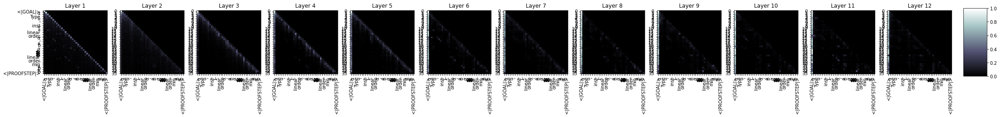

73599it [50:27, 30.74it/s]

  Step 73,600  of  147,271. Loss: 0.5605189800262451.   Elapsed: 0:50:27.
Sample:simp only [min_eq_iff_le_min, min_le_iff_mul_le]<|endoftext|><|PROOFSTEP|>simp only [← max_eq_iff_le_mk_iff]<|endoftext|><|PROOFSTEP|>simp only [add_zero,mk_eq_iff_le_zero]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply @nat.le_top_iff_int_eq_le at<|endoftext|><|PROOFSTEP|>ext at at<|endoftext|><|PROOFSTEP|>apply this<|endoftext|><|PROOFSTEP|>apply.<|endoftext|><|PROOFSTEP|>apply_nat<|endoftext|><|PROOFSTEP|>right<|endoftext|>by rfl : (1)<|endoftext|><|PROOFSTEP|>norm_tauto<|endoftext|><|PROOFSTEP|>exact (1)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_mem_mem.1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_mem_apply<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>tac.mulright<|endoftext|><|PROOFSTEP|>obtain (pow_of_le_zero_iff_le_zero_lt'_of_zero : (1) :
s -> 0.4168880581855774
apply -> 0.14334778487682343
rw -> 0

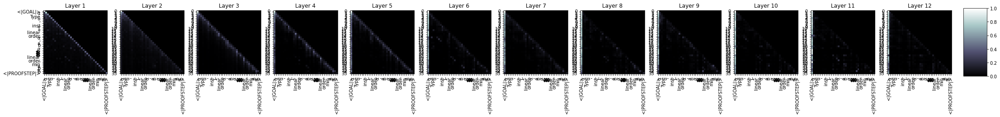

76798it [52:39, 25.52it/s]

  Step 76,800  of  147,271. Loss: 0.9886255860328674.   Elapsed: 0:52:40.
Sample:simp [min_le]<|endoftext|><|PROOFSTEP|>simp at *<|endoftext|><|PROOFSTEP|>simp_rw [← hb, ← mul_prod_symm, mul_one, or]<|endoftext|><|PROOFSTEP|>cases h<|endoftext|><|PROOFSTEP|>simp_rw [← @pow_div_def_right]<|endoftext|><|PROOFSTEP|>simp_def_bot<|endoftext|><|PROOFSTEP|>simp_iff<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_lt_bot_one<|endoftext|>N : [bot_def, nat.symm, bot_def, bot_def, nat.smul, bot, co_def, nat.symm]<|endoftext|><|PROOFSTEP|>have : intros 1 1 _ 1 1 0 = 1 1 0<|endoftext|><|PROOFSTEP|>rintros<|endoftext|><|PROOFSTEP|>apply_apply<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>s : ← (1 : nat.of_le, ∑1 : nat.one_div_le, 1 1 0)1, 1<|endoftext|><|PROOFSTEP|>unassoc<|endoftext|><|PROOFSTEP|>s
s -> 0.3014647364616394
apply -> 0.2112538069486618
ex -> 0.1789918690919876
rw -> 0.10806554555892944
int -> 0.07380204647779465
cases -> 0.04052635654807091
have -> 0.03782165423035

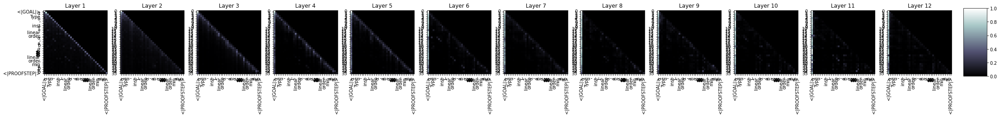

79999it [54:51, 31.24it/s]

  Step 80,000  of  147,271. Loss: 0.8638536930084229.   Elapsed: 0:54:52.
Sample:exact min_le_max<|endoftext|><|PROOFSTEP|>simpa using add_mul_le_add_right<|endoftext|><|PROOFSTEP|>exact add_le_neg_le_one a<|endoftext|><|PROOFSTEP|>left_mul<|endoftext|><|PROOFSTEP|>exact le_of_le_le_left_right<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have := le_of_of_add_left.2 (one_le_div_add]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have := _<|endoftext|>I := I1<|endoftext|>b<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>I1<|endoftext|>{contextual : is_well_ord.right _ I1}<|endoftext|><|PROOFSTEP|>cases_st<|endoftext|>II b I2 B (I1 : ℕ)<|endoftext|><|PROOFSTEP|>have A<|endoftext|><|PROOFSTEP|>refl := by H.n<|endoftext|><|PROOFSTEP|>have R := _<|endoftext|><|PROOFSTEP|>trivial<|end

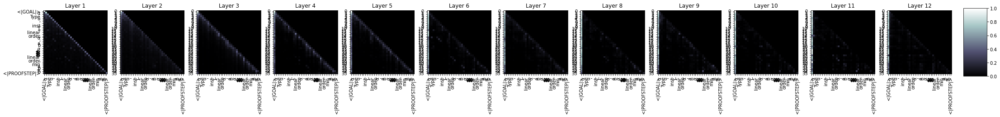

83200it [57:03, 23.73it/s]

  Step 83,200  of  147,271. Loss: 1.215623378753662.   Elapsed: 0:57:04.
Sample:simp only [(min, zero_le), one_le]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply max_le_top<|endoftext|><|PROOFSTEP|>rw [← max_lt_top, ← zero_le_top, max_le_top]<|endoftext|><|PROOFSTEP|>simp at h<|endoftext|><|PROOFSTEP|>t<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>have : t1_t2 := (top_t1.2 $ t1_t2.1 : top_trans).mp<|endoftext|><|PROOFSTEP|>cases h1 h2 with j (top_t1.1 : top_trans)<|endoftext|><|PROOFSTEP|>simp_exists<|endoftext|><|PROOFSTEP|>simp_of COURG<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>simpa using ha<|endoftext|><|PROOFSTEP|>refl<|endoftext|>I.coe_zero<|endoftext|><|PROOFSTEP|>let harefl := {x // x}<|endoftext|><|PROOFSTEP|>rw t2<|endoftext|>← t2.1<|endoftext|><|PROOFSTEP|>simp_of.mk ← hrefl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>asset.pow<|endoftext|><|PROOFSTEP|>
s -> 0.39074525237083435
ex -> 0.19846753776073456
rw -> 0.1179772242903709

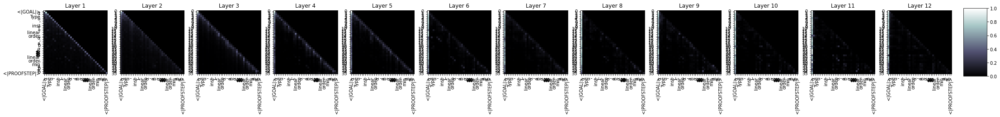

86398it [59:13, 26.01it/s]

  Step 86,400  of  147,271. Loss: 0.786577582359314.   Elapsed: 0:59:14.
Sample:rintro ⟨1, ⟨2, rfl⟩<|endoftext|><|PROOFSTEP|>have := @total_lt α _ ε_ _ _ _<|endoftext|><|PROOFSTEP|>rw [not_def]<|endoftext|><|PROOFSTEP|>have := Posted at ⊤<|endoftext|><|PROOFSTEP|>exact tendsto_left_of_-_ne_not<|endoftext|><|PROOFSTEP|>exact tendsto_left_of_-_ne_not_def.symm<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>apply_comm<|endoftext|><|PROOFSTEP|>exact le_iff.2<|endoftext|><|PROOFSTEP|>exact le_lt_le<|endoftext|>b<|endoftext|><|PROOFSTEP|>exact not_lt_le<|endoftext|>1 at<|endoftext|><|PROOFSTEP|>rc<|endoftext|><|PROOFSTEP|>ext<|endoftext|>m<|endoftext|><|PROOFSTEP|>apply_to_summable at<|endoftext|>in<|endoftext|>I₁ : is_inverse R with _ (h₁) (h₂)<|endoftext|><|PROOFSTEP|>exact h₁<|endoftext|><|PROOFSTEP|>exact H<|endoftext|><|PROOFSTEP|>controutes<|endoftext|><|PROOFSTEP|>letI := {to_s
ex -> 0.32886433601379395
s -> 0.21706464886665344
apply -> 0.15210963785648346
rw -> 0.08023498952388

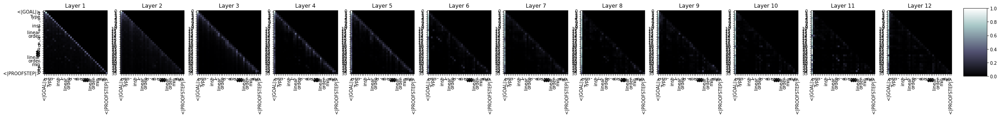

89600it [1:01:24, 26.35it/s]

  Step 89,600  of  147,271. Loss: 0.9286665916442871.   Elapsed: 1:01:25.
Sample:constructor<|endoftext|><|PROOFSTEP|>have anon : a ∈ ⊤ := preorder_iff.mp (nat.lt_top.mp a)<|endoftext|><|PROOFSTEP|>rw [le_top]<|endoftext|><|PROOFSTEP|>simp [le_top_eq_infi]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>this : is_trans (is_trans_of_trans _ _) (is_trans 1 ∘ has_dist.dist_ne)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_eq_one : one _ (is_trans_of_trans_one_left_iff_left_right_of_not_is_trans (is_trans 2 (IH_right (eq_of_trans (is_trans_of_trans_one 2 1)) ?1)) $ {to_le, hs }<|endoftext|><|PROOFSTEP|>simp one<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>
s -> 0.3087534010410309
ex -> 0.19849327206611633
rw -> 0.17192614078521729
apply -> 0.10268363356590271
int -> 0.07098395377397537
cases -> 0.053111318

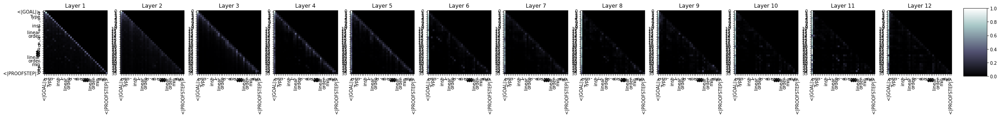

92800it [1:03:36, 22.70it/s]

  Step 92,800  of  147,271. Loss: 1.2393569946289062.   Elapsed: 1:03:37.
Sample:exact min_max _<|endoftext|><|PROOFSTEP|>exact max_le_max_le<|endoftext|><|PROOFSTEP|>exact max_le_max_top x<|endoftext|><|PROOFSTEP|>exact int.cast<|endoftext|><|PROOFSTEP|>simp only [sub_def, if_nhds]<|endoftext|><|PROOFSTEP|>rw ← one_add_right<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>tidy<|endoftext|><|PROOFSTEP|>refl<|endoftext|>H : one_add_one<|endoftext|>1 <$> p - h<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>to_hs_rfl<|endoftext|>C<|endoftext|>p<|endoftext|>p : (x : ℝ) ∣ x<|endoftext|>1 ∈ hx1 hx1.to_eq_of_le_refl_h1_right<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>simp<|endoftext|>(simp.2.rfl)<|endoftext|><|PROOFSTEP|>refl II<|endoftext|><|PROOFSTEP|>simp<|endoftext|>← p at this<|endoftext|><|PROOFSTEP|>simp<|endoftext|>1 : 1 = 1 ↔ 1<|endoftext|><|PROOFSTEP|>simpa [1
s -> 0.3448324203491211
rw -> 0.16645485162734985
ex -> 0.1572121530771

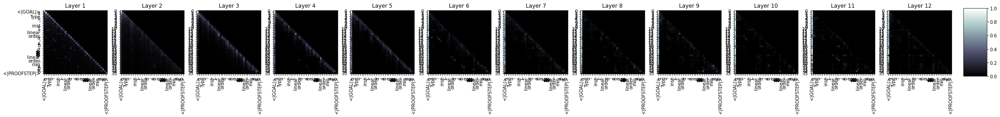

96000it [1:05:49, 26.83it/s]

  Step 96,000  of  147,271. Loss: 0.5895441770553589.   Elapsed: 1:05:50.
Sample:convert coe_lt_max_iff_le _<|endoftext|><|PROOFSTEP|>exact le_max_iff (le_max_of_le _)<|endoftext|><|PROOFSTEP|>apply h<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>unfold_le<|endoftext|><|PROOFSTEP|>induction h1 h2 with hy1<|endoftext|><|PROOFSTEP|>apply_mem<|endoftext|><|PROOFSTEP|>simp only [h1.1, int.coe_coe_coe] with H<|endoftext|><|PROOFSTEP|>let y := hy2, rfl<|endoftext|><|PROOFSTEP|>left<|endoftext|><|PROOFSTEP|>assumption x<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>contradiction<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>s_id_right : is_distrib_comm (a : is_distrib_comm _)<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>rw [distrib_comm]<|endoftext|><|PROOFSTEP|>rw [is_distrib_comm_mul_eq_left]<|endoftext|><|PROOFSTEP|>rw a<|endoftext|><|PROOFSTEP|>rw exists_right<|endoftext|><|PROOFSTEP|><|end

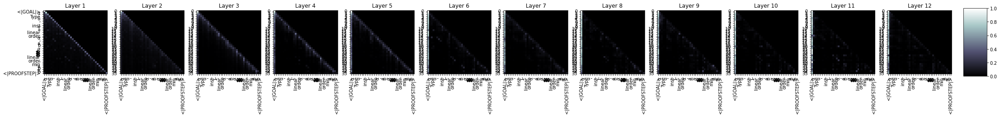

99198it [1:08:01, 25.33it/s]

  Step 99,200  of  147,271. Loss: 1.0977503061294556.   Elapsed: 1:08:01.
Sample:convert max_of_min_le_max a b<|endoftext|><|PROOFSTEP|>norm_le_max_le_zero_right : ∀ {norm_eq_norm_le}, a ∣ some_neg c₁ = b ∣ some_neg c₂<|endoftext|><|PROOFSTEP|>exact ⟨delta₁, zero_le_add⟩<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>exact h, set.exists_self<|endoftext|><|PROOFSTEP|>have I := xrp_rpow_pos_of_mem hx<|endoftext|><|PROOFSTEP|>exact_fn {transposition := tt}<|endoftext|><|PROOFSTEP|>exact_function {cases eq := with, nat.subsingleton }<|endoftext|><|PROOFSTEP|>cases le_refl<|endoftext|><|PROOFSTEP|>rcases h with ⟨v, hv, hv, hy, rfl, rfl⟩<|endoftext|><|PROOFSTEP|>simp only [←hv_rpow_pos_of_mem
s -> 0.36326995491981506
rw -> 0.16502486169338226
ex -> 0.14594648778438568
apply -> 0.09912654757499695
int -> 0.0677172839641571
cases -> 0.03590135648846626
by -> 0.03320547938346863
sim -> 0.031856048852205276
re -> 0.03070155903697014
split -> 0.027250440791249275


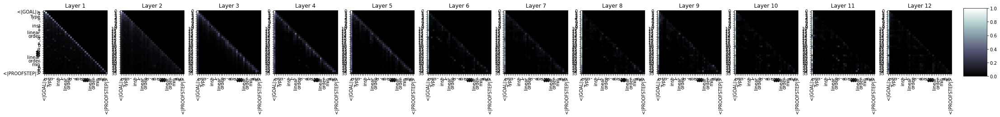

102399it [1:10:11, 25.48it/s]

  Step 102,400  of  147,271. Loss: 1.2829937934875488.   Elapsed: 1:10:11.
Sample:simp [min_eq_max]<|endoftext|><|PROOFSTEP|>simpa only [max_le] using max_le<|endoftext|><|PROOFSTEP|>split_right<|endoftext|><|PROOFSTEP|>simp only [def, pow_left, h, mul_right]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintros ⟨rpow_left ⟨rpow_right ⟨rpow_eq ⟨rpow_eq ⟨rpow_eq ⟨rpow_eq ⟨rpow_eq ⟨rpow_eq ⟨rpow_eq ⟨rpow_eq ⟨rpow_eq ⟨rpow_eq ⟨rpow_eq ⟨rpow_eq ⟨rpow_eq ⟨rpow_eq ⟨rpow_eq ⟨rpow
s -> 0.45618936419487
rw -> 0.18505339324474335
ex -> 0.11314341425895691
apply -> 0.0831502228975296
int -> 0.041795846074819565
ref -> 0.026011768728494644
cases -> 0.025492604821920395
sim -> 0.023898394778370857
by -> 0.023406807333230972
have -> 0.02185826003551483


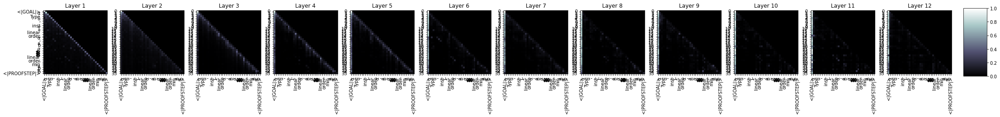

105599it [1:12:21, 29.36it/s]

  Step 105,600  of  147,271. Loss: 1.366151213645935.   Elapsed: 1:12:22.
Sample:rw [min_eq_zero_iff, min_one_iff]<|endoftext|><|PROOFSTEP|>rw [← mul_comm, zero_mul, mul_assoc, mul_self]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_apply<|endoftext|><|PROOFSTEP|>apply_not_right<|endoftext|><|PROOFSTEP|>rintro _ ⟨_, rfl⟩<|endoftext|><|PROOFSTEP|>rintro ⟨_, m, rfl⟩<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>rintro<|endoftext|><|PROOFSTEP|>rintro / if_neg in ⟨_, rfl⟩<|endoftext|><|PROOFSTEP|>refine ⟨_, rfl⟩<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>exact or.comm<|endoftext|><|PROOFSTEP|>refl<|endoftext|>I!<|endoftext|><|PROOFSTEP|>exact or.eq<|endoftext|>fro<|endoftext|>I : nat.elim _ (nat.elim' (not_le.lfl) (not_le.lfl, not_le.lfl,
s -> 0.5238003134727478
rw -> 0.1578999161720276
ex -> 0.12258419394493103
apply -> 0.047195423394441605
int -> 0.042424123734235764
cases -> 0.03080668859183

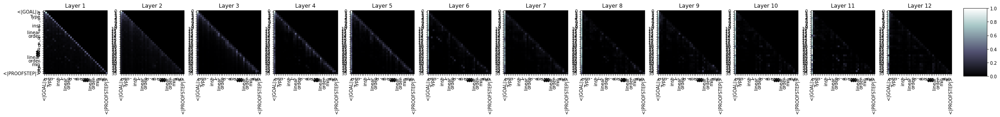

108800it [1:14:32, 22.75it/s]

  Step 108,800  of  147,271. Loss: 0.9278624653816223.   Elapsed: 1:14:33.
Sample:intros ht<|endoftext|><|PROOFSTEP|>simp only [neg_not_neg, neg_not_neg]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>dunfold_le<|endoftext|><|PROOFSTEP|>apply le_div_right<|endoftext|><|PROOFSTEP|>apply_right (le_of_gt _)<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact (@le_trans_of_nonpos _)<|endoftext|><|PROOFSTEP|>apply_bot<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_district<|endoftext|><|PROOFSTEP|>exact_ne (symm.sub_symm<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>sdiff_le<|endoftext|>m<|endoftext|><|PROOFSTEP|>use sub_lem_distrib.1<|endoftext|><|PROOFSTEP|>apply_conts<|endoftext|><|PROOFSTEP|>s : (a) 1 2 2<|endoftext|>I.2 (a1 2 : 1 _) 2.0 (a2 1 : 1 _)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_iff<|endoftext|><|PROOFSTEP|>rwa [← a1_lk 0, a1rq_l
s -> 0.3296513259410858
rw -> 0.2081774920225143

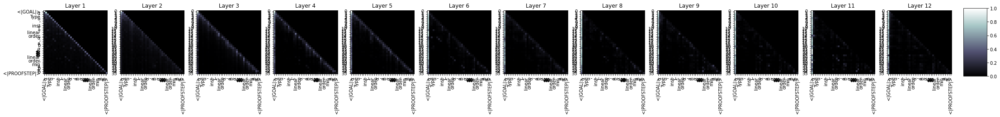

112000it [1:16:44, 24.48it/s]

  Step 112,000  of  147,271. Loss: 1.091102123260498.   Elapsed: 1:16:45.
Sample:induction a with a [measurable_le]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [mul_comm, sum_nonempty]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_left_of victory<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_to_nat_subset_of_le_of_mem<|endoftext|><|PROOFSTEP|>by_cases : one ∈ ln<|endoftext|><|PROOFSTEP|>rw ← le_top<|endoftext|><|PROOFSTEP|>apply_subset_iff<|endoftext|>K : ∀ x y, has_dist.dist x y = 0, x = 0<|endoftext|><|PROOFSTEP|>classical<|endoftext|><|PROOFSTEP|>rw [← dist_left, dist_right]<|endoftext|><|PROOFSTEP|>apply_left := dist_right<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintros ⟨x⟩ ⟨x⟩<|endoftext|><|PROOFSTEP|>apply_right<|endoftext|><|PROOFSTEP|>apply_left<|endoftext|><|PROOFSTEP|>exact_pos<|endoftext|><|PROOFSTEP|>rw ←simp<|endoftext|><|PROOFSTEP|>simp.5<|endoftext|><|PROOFSTEP|><|endoftext|><|PROOFS

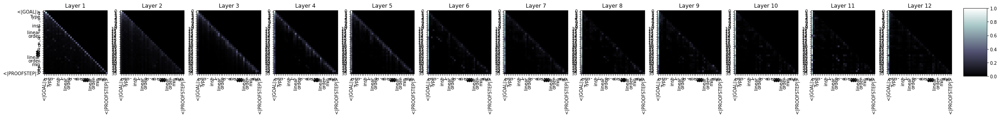

115200it [1:18:56, 20.56it/s]

  Step 115,200  of  147,271. Loss: 0.967501163482666.   Elapsed: 1:18:56.
Sample:rw [min_le]<|endoftext|><|PROOFSTEP|>simp [left_imp]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [left_imp]<|endoftext|><|PROOFSTEP|>simp_left<|endoftext|><|PROOFSTEP|>simp_right<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>sim_right<|endoftext|>α : (0 + -0)⁻¹ X := zero_one_rpow<|endoftext|><|PROOFSTEP|>simp_f_mem<|endoftext|><|PROOFSTEP|>right<|endoftext|><|PROOFSTEP|>rw a<|endoftext|><|PROOFSTEP|>rintro<|endoftext|>simp<|endoftext|><|PROOFSTEP|>simp_posoid<|endoftext|>L<|endoftext|><|PROOFSTEP|>simp_of 02<|endoftext|>p<|endoftext|>I<|endoftext|><|PROOFSTEP|>simp.3 (λ h, hb, inv.1 hb, hb.1, hb.2, inv.1 hb.2) (mem_image_of_simp_posoid p : (0 + h).1).1, hb.2, inv.2 hb.3, inv.3 hb.4, hb.5,
s -> 0.4871245324611664
rw -> 0.20281557738780975
ex -> 0.12801524996757507
apply -> 0.0489075630903244
have -> 0.03088040091097355
int -> 0.02483862265944481
ref -> 0.021651454269886017
cases 

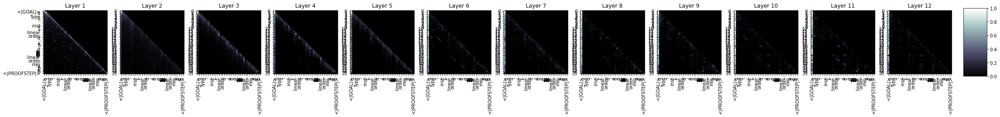

118400it [1:21:07, 25.96it/s]

  Step 118,400  of  147,271. Loss: 1.5585485696792603.   Elapsed: 1:21:08.
Sample:split<|endoftext|><|PROOFSTEP|>linarith<|endoftext|><|PROOFSTEP|>induction_on<|endoftext|><|PROOFSTEP|>letI := lt_1.4.1 lt_1.2 • lt_1.1<|endoftext|><|PROOFSTEP|>induction_of_le : is_right_lt _<|endoftext|><|PROOFSTEP|>letK := {p : {o₁ : onote | o₂ : onote | onof := ⟨_, is_right_lt.1 (h_1.1 | h_1.2))⟩<|endoftext|><|PROOFSTEP|>tactic.noetherian<|endoftext|><|PROOFSTEP|>finish : [1, a, 1, e, mfld_iff_cancel_right, h, [0, one), neg_one] {o₁, o₂, h $ by rw [of_le_iff_cancel_right_cancel_left] }<|endoftext|><|PROOFSTEP|>exactI 1 (add_pow_c
s -> 0.45226454734802246
rw -> 0.2039896845817566
ex -> 0.12966397404670715
apply -> 0.05572003871202469
have -> 0.03917635977268219
int -> 0.03253166377544403
cases -> 0.02880222164094448
sim -> 0.021676918491721153
ref -> 0.018533295020461082
re -> 0.01764126867055893


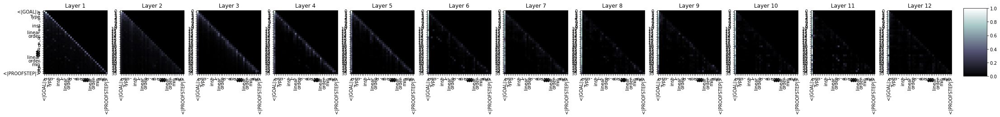

121600it [1:23:17, 27.67it/s]

  Step 121,600  of  147,271. Loss: 0.6351052522659302.   Elapsed: 1:23:18.
Sample:convert min_add_left_distrib a b<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>by_cases h : euclidean.gcd_left_l1 h<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp only [mem_gcd, mem_gcd_right, gcd_right, gcd_one]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>split_eq_left (left_injective eq_of_eq_right (left_injective ha_eq_right) h)<|endoftext|><|PROOFSTEP|>have := ha.2.2.left<|endoftext|><|PROOFSTEP|>let r := at_top : right.2 (left_inj<|endoftext|><|PROOFSTEP|>rw [eq_apply_left_of_eq_right (has_apply_right_inj]<|endoftext|><|PROOFSTEP|>rw nat_not_left]<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>injective<|endoftext|><|PROOFSTEP|>refine le.symm_prod<|endoftext|>
s -> 0.3419616222381592
rw -> 0.23755262792110443
ex -> 0.16515475511550903
apply -> 0.08902822434902191
have -> 0

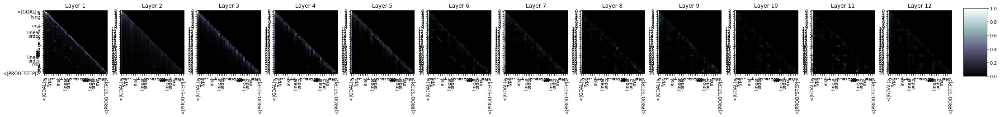

124800it [1:25:30, 24.04it/s]

  Step 124,800  of  147,271. Loss: 0.8111081123352051.   Elapsed: 1:25:31.
Sample:rw [min_eq_zero, min_le_min]<|endoftext|><|PROOFSTEP|>let g := b'<|endoftext|><|PROOFSTEP|>cases z<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact.symm<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact_instance<|endoftext|>I<|endoftext|><|PROOFSTEP|>have := pnat_cast_mul_left<|endoftext|>S_nhds<|endoftext|><|PROOFSTEP|>ext ⟨1, hs, hx⟩<|endoftext|><|PROOFSTEP|>obtain ⟨1, hx, rfl⟩ := hx<|endoftext|><|PROOFSTEP|>apply_apply<|endoftext|><|PROOFSTEP|>cases hs<|endoftext|><|PROOFSTEP|>rw ← hs<|endoftext|><|PROOFSTEP|>s<|endoftext|><|PROOFSTEP|>sigma1<|endoftext|>C : ∀ (n : ℕ), ∈ (n' ⟨n'', hsn', hsn' hsn'], [← (ne_iff_antisymm := (0 : ae_ne_zero ∨n', hsn'
s -> 0.37478429079055786
rw -> 0.2255704700946808
ex -> 0.13938124477863312
apply -> 0.10451814532279968
cases -> 0.043467383831739426
have -> 0.03763188049197197
int -> 0.02509

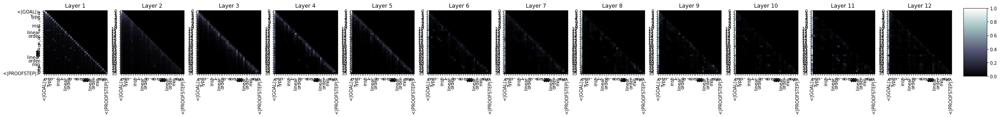

127998it [1:27:43, 26.40it/s]

  Step 128,000  of  147,271. Loss: 0.9718275666236877.   Elapsed: 1:27:44.
Sample:simp [max_eq_max]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp_constant<|endoftext|><|PROOFSTEP|>exact inv_ne<|endoftext|><|PROOFSTEP|>t_zero<|endoftext|><|PROOFSTEP|>simp_constant_right (int.mul_le_left_of_lt.1 $ finsupp.le<|endoftext|><|PROOFSTEP|>apply_induction_on<|endoftext|><|PROOFSTEP|>simp.not_lt_iff.symm<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>norm_nonpos<|endoftext|><|PROOFSTEP|>simp [norm, eq]<|endoftext|><|PROOFSTEP|>sub_eq_bot_eq_top, sub_eq_bot, eq_bot_nonpos, eq_bot_pos_iff, h, H, h, ne, ne, not_lt, not_lt'<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s_simp_mul, ←simp_one<|endoftext|><|PROOFSTEP|>simp, ←simp_right<|endoftext|><|PROOFSTEP|>exists_sub_right<|endoftext|><|PROOFSTEP|>s.
s -> 0.4978647530078888
rw -> 0.1661456674337387
ex -> 0.11188061535358429
apply -> 0.07907433807849884
cases -> 0.035945

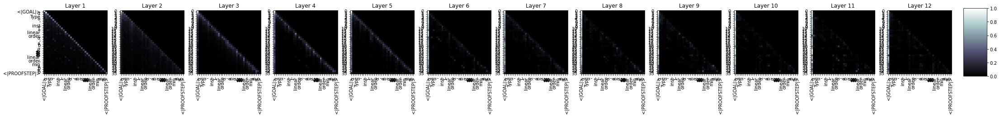

131200it [1:29:56, 28.31it/s]

  Step 131,200  of  147,271. Loss: 0.9117701053619385.   Elapsed: 1:29:57.
Sample:exact min_le_max<|endoftext|><|PROOFSTEP|>by k<|endoftext|><|PROOFSTEP|>simp only [mem_def, min_le_iff, max_eq_max]<|endoftext|><|PROOFSTEP|>tactic.pi_instance_derive_field<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>split_ifs :<|endoftext|><|PROOFSTEP|>simp : ∃ (u v : ℝ) (g : ℝ), u ≠ v → ∃ u = v, g = v, hg = v<|endoftext|><|PROOFSTEP|>have I :=<|endoftext|><|PROOFSTEP|>have A := ha<|endoftext|><|PROOFSTEP|>apply_instance_derive_mul<|endoftext|><|PROOFSTEP|>have := A<|endoftext|><|PROOFSTEP|>apply_assumption_of_mul<|endoftext|><|PROOFSTEP|>use_dvd<|endoftext|><|PROOFSTEP|>exact_instance A<|endoftext|><|PROOFSTEP|>apply_instance_of_mul<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_of_mem_of_iff<|endoftext|><|PROOFSTEP|>induction (and.1 {and})<|endoftext|><|PROOFSTEP|>inhabit<|endoftext|><|PROOFSTEP|>by<|endoftext|>
s -> 0.329284787

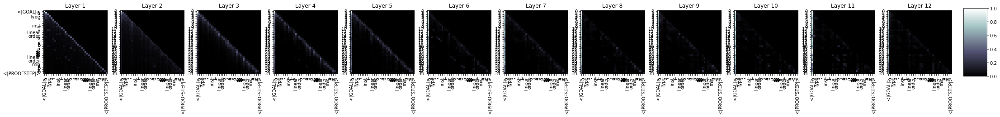

134399it [1:32:06, 25.84it/s]

  Step 134,400  of  147,271. Loss: 1.1286224126815796.   Elapsed: 1:32:07.
Sample:letI := tendsto_congr_le α b (a ≠ 0)<|endoftext|><|PROOFSTEP|>rintros ⟨a, hb⟩<|endoftext|><|PROOFSTEP|>have hn : ∀ (n : ℤ), 0 = ⟨a, hb⟩<|endoftext|><|PROOFSTEP|>rintros ⟨b, hb₁⟩<|endoftext|><|PROOFSTEP|>exact_mod_cast $ ⟨t, rfl, rfl⟩<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply_mod_cast<|endoftext|><|PROOFSTEP|>exact:symm<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>exact le_trans<|endoftext|>p<|endoftext|><|PROOFSTEP|>exact_exists<|endoftext|><|PROOFSTEP|>cases_of_le_right_of_le_left hn<|endoftext|><|PROOFSTEP|>apply_le_right<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply.principal_ne_top<|endoftext|><|PROOFSTEP|>have_mem_bot<|endoftext|><|PROOFSTEP|>have_empty_mem_right<|endoftext|><|PROOFSTEP|>apply_left<|endoftext|><|PROOFSTEP|>have_
s -> 0.3641766309738159
rw -> 0.241840660572052
ex -> 0.10835534334182739
apply -> 0.0717945247888565
int -> 0.0548241101205349
cas

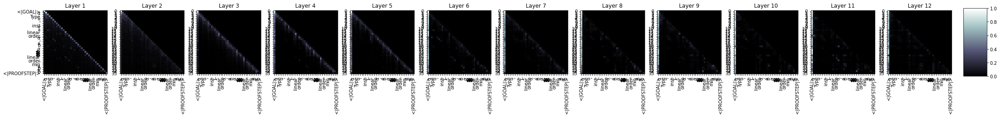

137599it [1:34:19, 26.93it/s]

  Step 137,600  of  147,271. Loss: 0.784656286239624.   Elapsed: 1:34:20.
Sample:split<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>unfunext a h : ∥∥∥∥∥∥ := h<|endoftext|><|PROOFSTEP|>refine (le_trans _).trans.trans<|endoftext|><|PROOFSTEP|>induction_one with one a b'<|endoftext|><|PROOFSTEP|>rc_distrib _<|endoftext|><|PROOFSTEP|>snd<|endoftext|><|PROOFSTEP|>simp [f_repr]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>pow_lhs : f -I ≠ I<|endoftext|><|PROOFSTEP|>simps<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp_distrib<|endoftext|>I<|endoftext|><|PROOFSTEP|>unient : (1 : nat.pow 1 (1 : nat.prime 1))<|endoftext|><|PROOFSTEP|>rintros ⟨1, f, rfl⟩<|endoftext|><|PROOFSTEP|>by simp<|endoftext|><|PROOFSTEP|>indr<|endoftext|><|PROOFSTEP|>by : nat.pow 1 (1 : nat.nat.1 1.2 _),<|endoftext|><|PROOFSTEP|>s : 1 : nat.pow 1 1,
s -> 0.4938182532787323
rw -> 0.18557076156139374
ex -> 

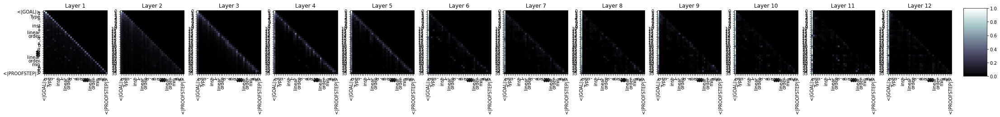

140799it [1:36:30, 27.44it/s]

  Step 140,800  of  147,271. Loss: 0.6269720792770386.   Elapsed: 1:36:30.
Sample:exact min_ne_zero abs<|endoftext|><|PROOFSTEP|>induction a with a<|endoftext|><|PROOFSTEP|>induction a with a b<|endoftext|><|PROOFSTEP|>simp only [induction_of_nat_eq_neg, not_neg, not_neg]<|endoftext|><|PROOFSTEP|>assumption<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>s'<|endoftext|><|PROOFSTEP|>simp [left_le_left]<|endoftext|><|PROOFSTEP|>induction_left<|endoftext|>0 0 _<|endoftext|><|PROOFSTEP|>simp_right<|endoftext|>by_cases.1 1 0 = 0<|endoftext|><|PROOFSTEP|>intro x<|endoftext|>I<|endoftext|><|PROOFSTEP|>simp<|endoftext|>← one_right (zero_eq_add_zero.2 $ $ le_top ⟨₊₂₂, Σ, h₁ h₂, h₂, (2_add_self _₁).le_right.2₁ $ 2_add_right $ 1 ⟨₊₂₂, Σ
s -> 0.38908612728118896
rw -> 0.31089743971824646
ex -> 0.0711321234703064
apply -> 0.05492629483342171
have -> 0.04058602452278137
int -> 0.040124814957380295
cases -> 0.0283169187605381
sim -> 0.022388948127627373
split -> 0.021545659750699997
re -> 0.020

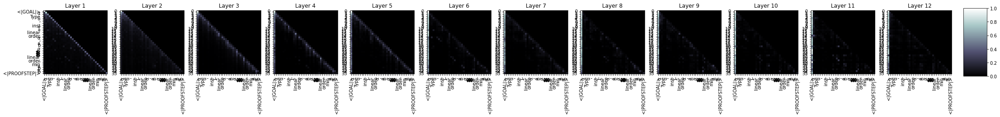

143999it [1:38:43, 25.43it/s]

  Step 144,000  of  147,271. Loss: 1.4152315855026245.   Elapsed: 1:38:44.
Sample:split<|endoftext|><|PROOFSTEP|>use (nat.eq_of_le : a * b ≠ 0)<|endoftext|><|PROOFSTEP|>simp [sub_eq_lt_one, ← sub_add_comm]<|endoftext|><|PROOFSTEP|>assoc<|endoftext|><|PROOFSTEP|>exact (inverse_add_neg (le_of_lt.le)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact<|endoftext|><|PROOFSTEP|>exact<|endoftext|><|PROOFSTEP|>exact $ x : nat.sub_indicator.le x<|endoftext|><|PROOFSTEP|>exact nat_sub_indicator<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>apply: _<|endoftext|>Icc_eq_right (one -<|endoftext|><|PROOFSTEP|>apply_instance.0.2<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply.inj<|endoftext|><|PROOFSTEP|>assoc, iocontact<|endoftext|><|PROOFSTEP|>s_of_is_mul.1 iocontact<|endoftext|><|PROOFSTEP|>exact iocontact<|endoftext|><|PROOFSTEP|>convert iocontact<|endoftext|><|PROOFSTEP|>image.le.symm<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>sic_le
s -> 0.338984757661

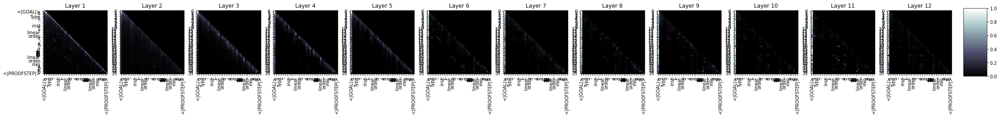

147199it [1:40:55, 28.37it/s]

  Step 147,200  of  147,271. Loss: 0.8298406600952148.   Elapsed: 1:40:56.
Sample:apply min_le_sup_max<|endoftext|><|PROOFSTEP|>apply_fun<|endoftext|><|PROOFSTEP|>rw[←le_of_eq_mul_one, mul_one]<|endoftext|><|PROOFSTEP|>tidy : is_compl ((is_compl (2 : ℤ)) (is_compl_self 1)).symm, simp [one_eq_one_iff, one_eq_one_iff]<|endoftext|><|PROOFSTEP|>simp only [one_eq_one_iff, one_eq_one_iff_right, one_ne_zero] at *<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [bInter_eq_iff_left] at this with hi<|endoftext|><|PROOFSTEP|>apply this.comp_sym<|endoftext|><|PROOFSTEP|>have : (is_compl.iff_self h_exists_one a _).is_compl<|endoftext|><|PROOFSTEP|>have : ih<|endoftext|><|PROOFSTEP|>have : a ∘ p.to_partrec 1 := le_le_2 (mem_
rw -> 0.3726864755153656
s -> 0.28959542512893677
ex -> 0.07912479341030121
apply -> 0.07894961535930634
cases -> 0.05395719036459923
int -> 0.03707881644368172
have -> 0.0359073281288147
re -> 0.019847998395562172
split -> 0.01657913252711296
norm -> 0.01627319

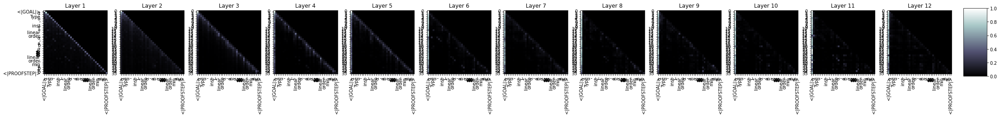

147271it [1:41:04, 24.28it/s]



  Average training loss: 1.01
  Training epoch took: 1:41:04

Running Validation...
  Validation Loss: 0.96
  Validation took: 0:01:32


3it [00:00, 29.93it/s]


======== Epoch 28 / 35 ========
Training...


3200it [02:04, 22.85it/s]

  Step 3,200  of  147,271. Loss: 0.8602051734924316.   Elapsed: 0:02:05.
Sample:intro h<|endoftext|><|PROOFSTEP|>conv_fun<|endoftext|><|PROOFSTEP|>have There := tendsto : a = 0<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>refine tendsto_comp_eq<|endoftext|><|PROOFSTEP|>apply_right<|endoftext|>isomorphisms<|endoftext|><|PROOFSTEP|>simp [dist_eq_zero]<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>rintros ⟨rfl⟩ ⟨rfl⟩<|endoftext|><|PROOFSTEP|>simp_rw [dist_eq_zero]<|endoftext|><|PROOFSTEP|>have<|endoftext|>F : (p.not_right.trivial_finset.gcf_bodd_of_bodd_left_of_bodd _) (finset.gcf_bodd_of_bodd_left_of_bodd_left_of_bodd_right_of_bodd_right_of_bodd_to_bodd]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>haveF := ⟨0, h,
s -> 0.335476279258728
rw -> 0.24059998989105225
apply -> 0.13916626572608948
ex -> 0.08997992426156998
int -> 0.05073070153594017
have -> 0.04916631802916527
cases -> 0.03268013149499893
re -> 0.02404718659

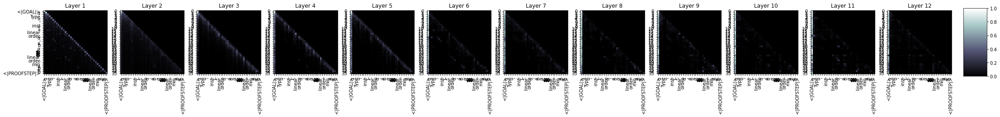

6400it [04:19, 23.12it/s]

  Step 6,400  of  147,271. Loss: 1.0220835208892822.   Elapsed: 0:04:20.
Sample:apply_instance<|endoftext|><|PROOFSTEP|>exact zero_lt_one_iff_of_le<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simpa [int.le_int_iff, le_int_iff_coe] using nat.le_neg_le<|endoftext|><|PROOFSTEP|>linarith<|endoftext|><|PROOFSTEP|>norm_cast at norm_cast<|endoftext|><|PROOFSTEP|>simp [norm_cast]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>suffix (h : h)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>have : has_insert.is_insert, by this IH<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact_true<|endoftext|><|PROOFSTEP|>cases h :<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>exact_true<|endoftext|>A<|endoftext|><|PROOFSTEP|>have with H<|endoftext|>R<|endoftext|>X : xrpow xrpow_neg xrpow_eq<|endoftext|><|PROOFSTEP|

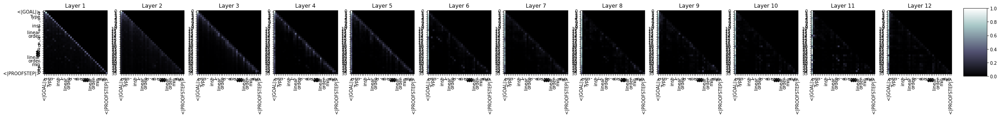

9597it [06:33, 28.69it/s]

  Step 9,600  of  147,271. Loss: 0.9997657537460327.   Elapsed: 0:06:33.
Sample:intrib<|endoftext|><|PROOFSTEP|>rintros ⟨a⟩ ⟨b⟩<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>simp only [⟨a⟩, (of_mem a⟩, of_ ....) ⟨b⟩<|endoftext|><|PROOFSTEP|>assume<|endoftext|><|PROOFSTEP|>funext x<|endoftext|><|PROOFSTEP|>exact has_exists_exists_prop _ (by cont.mem_exists_iff.ext)<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simpa<|endoftext|><|PROOFSTEP|>tactic.2.1 has_inv<|endoftext|><|PROOFSTEP|>rintros<|endoftext|><|PROOFSTEP|>f : ⟨re, rfl⟩⟩<|endoftext|><|PROOFSTEP|>rintros<|endoftext|>this R<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>injective<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>apply_xr<|endoftext|>I : ∀ ⟨0, not : is_exists_of_mem_inj<|endoftext|><|PROOFSTEP|>rintrosf<|endoftext|><|PROOFSTEP|>use<|endoftext|>
s -> 0.30582621693611145
rw -> 0.21180425584316254
apply -> 0.14409510

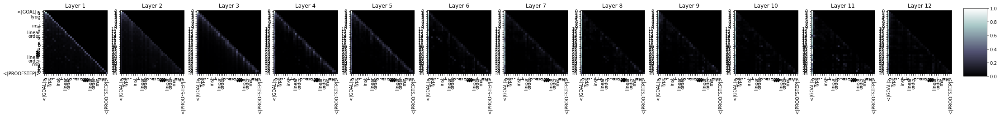

12798it [08:44, 26.54it/s]

  Step 12,800  of  147,271. Loss: 0.7131615877151489.   Elapsed: 0:08:44.
Sample:rwa [min_le, max_le, mod_min_mod] at *<|endoftext|><|PROOFSTEP|>simp only [sub_eq_iff_sub, div_le, div_iff_mul_le]<|endoftext|><|PROOFSTEP|>simp only [add_sub_self, subs_self]<|endoftext|><|PROOFSTEP|>intros<|endoftext|><|PROOFSTEP|>simp only [one_mul, one_mul]<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>linarith<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refl<|endoftext|>refl<|endoftext|>⊢ ←to_finset<|endoftext|>K K<|endoftext|><|PROOFSTEP|>simp at K<|endoftext|><|PROOFSTEP|>simp<|endoftext|>←to_finset<|endoftext|>R : is_is_iff<|endoftext|>norm := to_finset.finset<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>refl<|endoftext|>M : {x // has_lt_one x}<|endoftext|><|PROOFSTEP|>exact exists_lt.mpr x<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>trans<|endoftext|><|PROOFSTEP|>exact h
s -> 0.21177151799201965
rw -> 0.18743781745433807
apply 

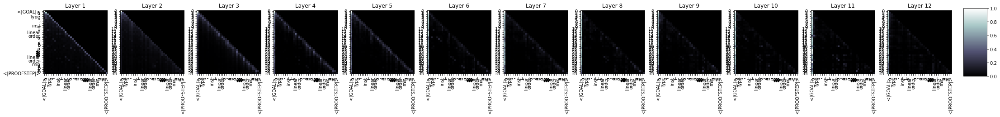

16000it [10:57, 23.54it/s]

  Step 16,000  of  147,271. Loss: 0.7885213494300842.   Elapsed: 0:10:58.
Sample:have_max : min a b = max a<|endoftext|><|PROOFSTEP|>simpa only [min_div_right, max_iff_top] using div_dist_left_bounded_subset.div_const (div_eq_bot_iff.mp div_dist_left_bounded_subset.coe) (div_dist_right_bounded_subset.div_const (div_eq_bot_iff.mp div_dist_left_bounded_subset.coe) (div_dist_eq_bot_iff.mp div_dist_left_bounded_subset.coe)<|endoftext|><|PROOFSTEP|>apply pow_div_eq_bot_iff.mp (bounded_subset_top.div_right) (bounded_subset_top.div_left)<|endoftext|><|PROOFSTEP|>exact dec_trivial<|endoftext|><|PROOFSTEP|>split_ifs with picn<|endoftext|><|PROOFSTEP|>simp only [nat.
s -> 0.2573115825653076
ex -> 0.21702304482460022
rw -> 0.21184492111206055
apply -> 0.12538117170333862
have -> 0.056293290108442307
int -> 0.03971333056688309
cases -> 0.03399991616606712
ind -> 0.021418584510684013
ref -> 0.019557049497961998
re -> 0.017457151785492897


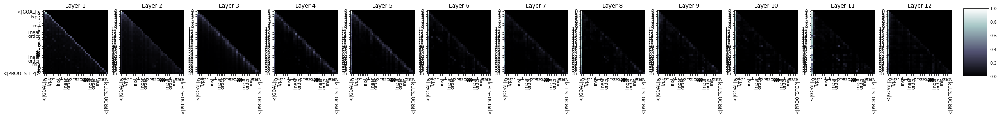

19198it [13:08, 24.30it/s]

  Step 19,200  of  147,271. Loss: 0.5300605297088623.   Elapsed: 0:13:09.
Sample:haveI := min_le_min_le (λ t ht, ht.le) hyt<|endoftext|><|PROOFSTEP|>haveI : (∃ i : {x // x ∈ set.Icc a b}), x ∈ set.Icc a b - i<|endoftext|><|PROOFSTEP|>induction I : I ⊆ set.Icc a b with hI h<|endoftext|><|PROOFSTEP|>induction (I : I ⊆ I) : I ⊆ ⟨I, hI⟩ :=<|endoftext|><|PROOFSTEP|>induction _ _ _ _ _ _ _ _ _ _ _ _ _ _ ih generalists<|endoftext|><|PROOFSTEP|>induction H : I ⊆ I<|endoftext|><|PROOFSTEP|>ext Y<|endoftext|><|PROOFSTEP|>apply H<|endoftext|><|PROOFSTEP|>apply_of practiced<|endoftext|><|PROOFSTEP|>apply_id<|endoftext|><|PROOFSTEP|>induction_left<|endoftext|><|PROOFSTEP|>apply_injective<|endoftext|><|PROOFSTEP|>t1<|endoftext|><|PROOFSTEP|>induction Y<|endoftext|><|PROOFSTEP|>ex<|endoftext|><|PROOFSTEP|>apply_left<|endoftext|><|PROOFSTEP|>exact h1<|endoftext|>dvd<|endoftext|><|PROOFSTEP|>
s -> 0.2641502320766449
ex -> 0.21302694082260132
rw -> 0.19638104736804962
apply -> 0.12043610960245132
cases 

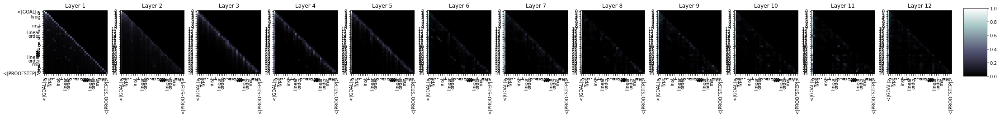

22398it [15:20, 24.24it/s]

  Step 22,400  of  147,271. Loss: 1.1109848022460938.   Elapsed: 0:15:21.
Sample:exact linear_order.max_min a b<|endoftext|><|PROOFSTEP|>exact max_min a<|endoftext|><|PROOFSTEP|>rintros ⟨⟩<|endoftext|><|PROOFSTEP|>ext ⟩<|endoftext|><|PROOFSTEP|>apply nat.exists_iff_exists_left<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simpa only [← int.cast_inter_of_mem, of_mem_iff_exists, of_mem_iff_cast] using int.cast_inter_of_mem_not_exists<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>left<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>exact ⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨⟨�
s -> 0.27443942427635193
ex -> 0.2671734094619751
rw -> 0.21084828674793243
apply -> 0.08218739926815033
have -> 0.045141104608774185
cases -> 0.039798226207494736
int -> 0.02621566504240036
split -> 0.022300057113170624
ref -> 0.018460018560290337
ind -> 0.013436391949653625


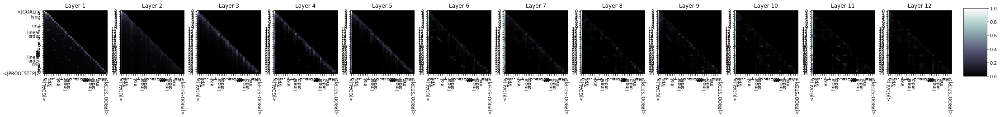

25598it [17:32, 25.36it/s]

  Step 25,600  of  147,271. Loss: 0.9699124097824097.   Elapsed: 0:17:33.
Sample:simp [min_eq_max_iff_eq_max]<|endoftext|><|PROOFSTEP|>split_ifs<|endoftext|><|PROOFSTEP|>cases h : h<|endoftext|><|PROOFSTEP|>have : a = zorn.max a'<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp [H.6, le_def, inv_eq_mul_iff, h.1, coe_le_iff]<|endoftext|><|PROOFSTEP|>have a := h.1<|endoftext|><|PROOFSTEP|>apply_pos<|endoftext|><|PROOFSTEP|>simp_rw [h.2, coe_ne_zero]<|endoftext|><|PROOFSTEP|>apply_pos<|endoftext|><|PROOFSTEP|>symm<|endoftext|><|PROOFSTEP|>subtype h<|endoftext|><|PROOFSTEP|>apply_pos<|endoftext|>H<|endoftext|><|PROOFSTEP|>indo<|endoftext|><|PROOFSTEP|>simp_left<|endoftext|>A : is_univ<|endoftext|><|PROOFSTEP|>simpa only [has_univ, simp_ne_zero, rfl, rfl_prod]<|endoftext|><|PROOFSTEP|>subtype<|endoftext|><|PROOFSTEP|>have : is_univ := h<|endoftext|><|PROOFSTEP|>have<|endoftext|><|PROOFSTEP|>show H<|endoftext|><|PROOFSTEP|>s -1<|endoftext|><|PROOFSTEP|>
s -> 0.48632684350013733
ex

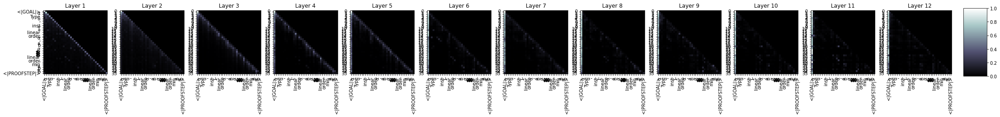

28799it [19:44, 24.18it/s]

  Step 28,800  of  147,271. Loss: 1.0186158418655396.   Elapsed: 0:19:45.
Sample:rw min_succ_iff at b<|endoftext|><|PROOFSTEP|>rintros ⟨⟩<|endoftext|><|PROOFSTEP|>rw mul_comm<|endoftext|><|PROOFSTEP|>by_cases h : a ≤ a<|endoftext|><|PROOFSTEP|>simp only [set.of_le_of_nonneg (nonneg_one _) (nonpos.nonneg _), sub_le.not_le]<|endoftext|><|PROOFSTEP|>simp [set.one_self, sub_le.not_le, set.nonneg]<|endoftext|><|PROOFSTEP|>simp only [set.nonneg, set.of_le_nonneg]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>have := set.of_le_of_neg (le_distrib_right (finset_coe_iff.2.1 $ {a : a}).symm<|endoftext|><|PROOFSTEP|>simpa [is_coe_eq, mul_zero, not_le.mpr.2] using (is_coe_eq
s -> 0.42925146222114563
ex -> 0.18954740464687347
rw -> 0.09806805104017258
apply -> 0.09589099884033203
cases -> 0.06820771098136902
have -> 0.03753713145852089
int -> 0.028580613434314728
split -> 0.021969005465507507
ref -> 0.016127130016684532
re -> 0.0148205552250

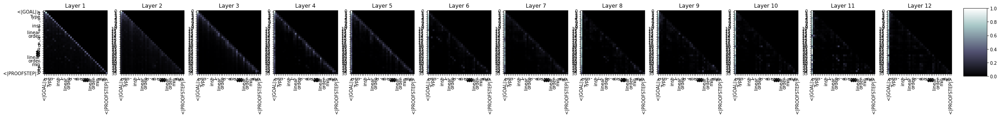

31999it [21:56, 23.91it/s]

  Step 32,000  of  147,271. Loss: 1.0699397325515747.   Elapsed: 0:21:57.
Sample:simp only [le_max_iff]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp_one<|endoftext|><|PROOFSTEP|>simp_one<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rintros ⟨f, hf, hf.2, rfl⟩<|endoftext|><|PROOFSTEP|>simp : ∀ (x : ℕ), x ∈ set.top α, x ∈ set.exists ℕ → ∀ (x : ℕ), x ∈ set.succ ℙ⟩<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>convertI (mem_inj).mem_cons'<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>refine nat_singleton.1<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have := nat_empty_symm this<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp!<|endoftext|><|PROOFSTEP|>rcases le_refl with ⟨a, ha, a'<|endoftext|><|PROOFSTEP|>s, hb, hab,
s -> 0.4577730596065521
rw -> 0.15792793035507202
ex -> 0.12905225157737732
apply -> 0.0840090662240982
cases -> 0.0678369551897049
have -> 0.0

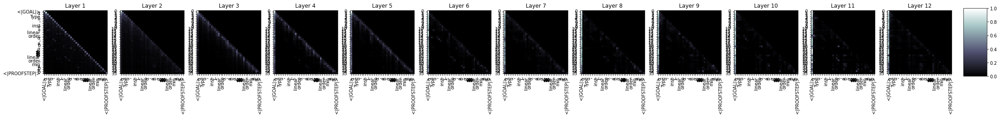

35199it [24:07, 26.80it/s]

  Step 35,200  of  147,271. Loss: 0.789387583732605.   Elapsed: 0:24:07.
Sample:simp [min_eq_top]<|endoftext|><|PROOFSTEP|>by_cases h : ∀ {s : set α} {b : α} [b : b], s ∈ s → set.range a b ≤ set.range<|GOAL|>c a b<|endoftext|><|PROOFSTEP|>apply le_iff_le_nonneg<|endoftext|><|PROOFSTEP|>apply le_of_eq_nonneg<|endoftext|><|PROOFSTEP|>apply le_supr<|endoftext|><|PROOFSTEP|>apply nonneg_assoc<|endoftext|><|PROOFSTEP|>apply nonneg_right<|endoftext|><|PROOFSTEP|>apply lt_of_eq_nonneg<|endoftext|><|PROOFSTEP|>apply neg_one<|endoftext|><|PROOFSTEP|>apply prepos_eq_nonneg_left<|endoftext|><|PROOFSTEP|>apply le_nonneg_right<|endoftext|><|PROOFSTEP|>apply prepos_eq_nonneg_left<|endoftext|><|PROOFSTEP|>apply prepos_eq_nonneg_right<|endoftext|><|PROOFSTEP|>cases_nth_eq_nonneg_left with hi<|endoftext|><|PROOFSTEP|>assoc<|endoftext|><|PROOFSTEP|>apply prepos_left<|endoftext|><|PROOFSTEP|>apply_of_mem_of_self, a, b
s -> 0.48556092381477356
rw -> 0.16006480157375336
ex -> 0.10382947325706482
cases -> 0

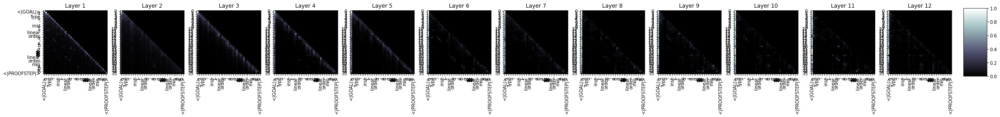

38400it [26:18, 27.67it/s]

  Step 38,400  of  147,271. Loss: 1.7039642333984375.   Elapsed: 0:26:18.
Sample:rcases lt_or_lt_top _ _ with ha₁ hy₂ hy₂<|endoftext|><|PROOFSTEP|>rw [← inv_lt_top]<|endoftext|><|PROOFSTEP|>rw [← inv_eq_iff_le_self, iff_true]<|endoftext|><|PROOFSTEP|>rw at_top<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw iff_false<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>apply_factorial_inter_right<|endoftext|>I<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rw [intro, intro, rfl, iff_true, simp, iff_true, ifsimp]<|endoftext|><|PROOFSTEP|>rw iff_true<|endoftext|><|PROOFSTEP|>apply_factorial_inter_rightI<|endoftext|><|PROOFSTEP|>exact iff_true<|endoftext|><|PROOFSTEP|>simp.symm<|endoftext|><|PROOFSTEP|>rw S2<|endoftext|><|PROOFSTEP|>exactI<|endoftext|><|PROOFSTEP|>induction<|endoftext|>I.elim $ I.elim<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>rintrosI<|endoftext|><|PROOFSTEP|>conj I.elim<|endoftext|>
s -> 0.43905800580978394
rw -> 0.17889100313186646
ex -

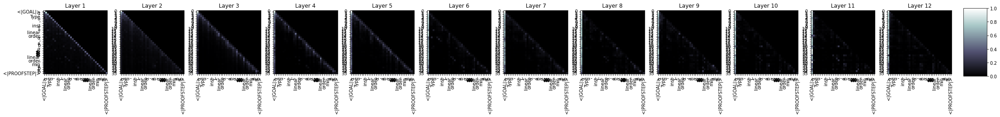

41599it [28:30, 19.47it/s]

  Step 41,600  of  147,271. Loss: 1.059415340423584.   Elapsed: 0:28:30.
Sample:simp [min_zero]<|endoftext|><|PROOFSTEP|>ext f0<|endoftext|><|PROOFSTEP|>simp [infi]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>rintro ⟨_⟩<|endoftext|><|PROOFSTEP|>s : ∃ ℝ, is_closed ←is_open ←is_closed.to_lt_iff_open, is_closed.to_top.1<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>exact is_open_symm_left _<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp only [←preimage_preimage, ←preimage_sub, ←preimage_set_eq, to_le_left_of_gt]<|endoftext|><|PROOFSTEP|>obtain ⟨rfl, hrfl, hl, hlt_iff]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>injections<|endoftext|><|PROOFSTEP|>let_rfl : n sigma at this : ∀
s -> 0.5031121969223022
rw -> 0.1715511828660965
ex -> 0.10558746010065079
cases -> 0.06806571781635284
apply -> 0.0552145279943943
int -> 0.024

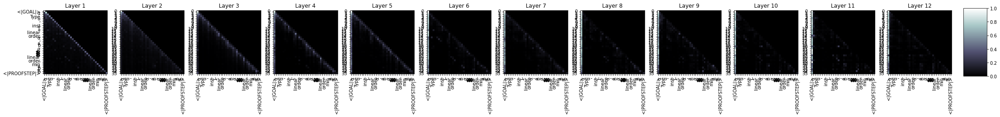

44798it [30:41, 23.51it/s]

  Step 44,800  of  147,271. Loss: 0.8347945809364319.   Elapsed: 0:30:41.
Sample:rw [le_def, min_div_iff]<|endoftext|><|PROOFSTEP|>rw min_div_iff at *<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_inv<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>exact (h_finset_eq_of_mem).1<|endoftext|><|PROOFSTEP|>rw eq_inj, h_eq_out<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>intro h<|endoftext|>IJ<|endoftext|><|PROOFSTEP|>haveI : Π {a : hx, b : IHx {n : ℕ} | n + 3} {s : ℕ | 3, 1}, hs : 4s, h3), hd : 4s, hd3, hs_1<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>refine _<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>convert g : (1 : 1) _ (1 : 3)<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>obtain {s : b - (2 : b
s -> 0.3964166045188904
rw -> 0.2711464762687683
ex -> 0.16239792108535767
apply -> 0.04893558472394943
cases -> 0.03451957553625107
i

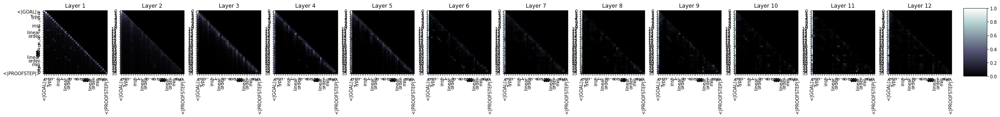

47998it [32:51, 24.72it/s]

  Step 48,000  of  147,271. Loss: 1.1664154529571533.   Elapsed: 0:32:52.
Sample:simp only [min_apply, zero_lt_one, zero_lt_one]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [nat.sub_eq_iff, sub_eq_iff.1, nat.iff_const, sub_iff_iff_iff]<|endoftext|><|PROOFSTEP|>simp.1 [nat.not_bot, not_bot, not_bot, not_bot_iff]<|endoftext|><|PROOFSTEP|>simp.1 [bot_iff_self.1.mem, not_bot, not_bot_iff_self, not_bot_iff_self, not_bot_iff_self.2]<|endoftext|><|PROOFSTEP|>simp.1<|endoftext|><|PROOFSTEP|>split_eq_div_one [simp.2, division, one_div, one_div_1, one_div_left]<|endoftext|><|PROOFSTEP|>ext2 simp<|endoftext|><|PROOFSTEP|>split_eq_div_
s -> 0.39754146337509155
rw -> 0.26301005482673645
ex -> 0.1178094893693924
apply -> 0.06039333716034889
cases -> 0.043396104127168655
int -> 0.035294849425554276
have -> 0.028522241860628128
split -> 0.02136596292257309
ref -> 0.0167

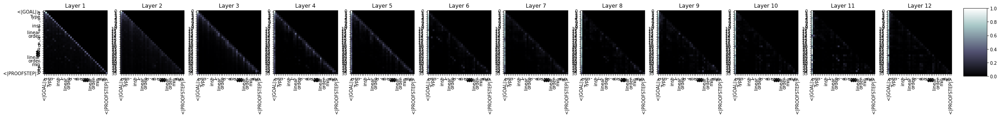

51200it [35:06, 19.66it/s]

  Step 51,200  of  147,271. Loss: 0.47577759623527527.   Elapsed: 0:35:06.
Sample:rw [min_eq_inf_max]<|endoftext|><|PROOFSTEP|>norm_num<|endoftext|><|PROOFSTEP|>split<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>ext<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_inst_1<|endoftext|>I.coe_eq_left : ℝ := h with a H.1 h.2<|endoftext|><|PROOFSTEP|>simp only [h.1 h.2 h.3, one_left]<|endoftext|><|PROOFSTEP|>simp only [h.1 h.4.2, one_left, one_right, one_div] at ⊢<|endoftext|><|PROOFSTEP|>assumption_mul<|endoftext|><|PROOFSTEP|>simp (right_left h.1), rfl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance (left_right h.1, mul_right<|endoftext|><|PROOFSTEP|>by_cases h1 := simp (one_left h.2), one_right<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>assumption<|endoftext|><|PROOFSTEP|>apply_instance : is_
s -> 0.4533449411392212
ex -> 0.1

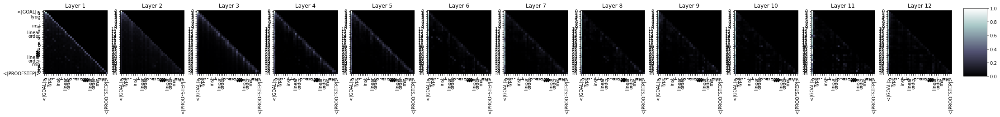

54399it [37:17, 29.23it/s]

  Step 54,400  of  147,271. Loss: 0.640639066696167.   Elapsed: 0:37:17.
Sample:rw [←min_le_iff_of_le]<|endoftext|><|PROOFSTEP|>casesI<|endoftext|><|PROOFSTEP|>by_cases h : 0 < 1<|endoftext|><|PROOFSTEP|>rw hx<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>refine (mul_exists_eq_of_neg (0 : 0 < 1)).trans _<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw<|endoftext|><|PROOFSTEP|>exists_symm<|endoftext|><|PROOFSTEP|>dsimp_lt<|endoftext|>{refl | ae := λ n, n' y, n' ht, rfl, rfl, ht, h, ne hne}<|endoftext|><|PROOFSTEP|>simp_eq_self<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp at tmul ht<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases rfl<|endoftext|>simp with hsimp<|endoftext|>n<|endoftext|><|PROOFSTEP|>refl<|endoftext|>t_left<|endoftext|>mul<|endoftext|><|PROOFSTEP|>exact {IH}<|endoftext|>simp_refl<|endoftext|>I.1 (2 pgame_r
s -> 0.3351122736930847
rw -> 0.2907748818397522
ex -> 0.13286235928535

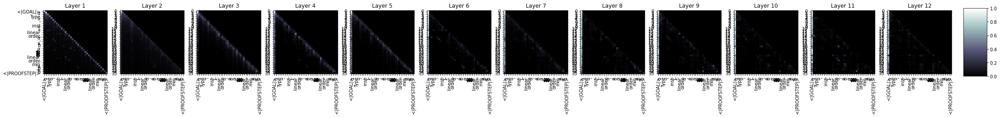

57599it [39:27, 26.91it/s]

  Step 57,600  of  147,271. Loss: 0.8482244610786438.   Elapsed: 0:39:28.
Sample:let p' : α := {p', sub_eq_zero}<|endoftext|><|PROOFSTEP|>simp [inv_def]<|endoftext|><|PROOFSTEP|>rw [inv_def]<|endoftext|><|PROOFSTEP|>cases_by_nhds : vpn.cases_by_nhds_left : nhds_to_top := ht_nhds_of yesterday<|endoftext|><|PROOFSTEP|>simp at *<|endoftext|><|PROOFSTEP|>apply exists_trans (0 : ∃ (a_1 : pos_num), {x})<|endoftext|><|PROOFSTEP|>apply (of_pos_num (is_pos), (is_pos_of_pos_of_nat_pos (is_pos_of_pos_of_nat_pos), pos_num_zero, pos_of_pos_of_neg, zero_neg]<|endoftext|><|PROOFSTEP|>apply_assoc<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intro x<|endoftext|><|PROOFSTEP|>apply_pos<|endoftext|><|PROOFSTEP|>exact has_of_lt (λ _, nat.
rw -> 0.3548644483089447
s -> 0.30904632806777954
ex -> 0.12274633347988129
apply -> 0.0671379342675209
int -> 0.039073169231414795
have -> 0.02777698077261448
cases -> 0.026674164459109306
split -> 0.022102022543549538
ref -> 0.01614352874457836
norm 

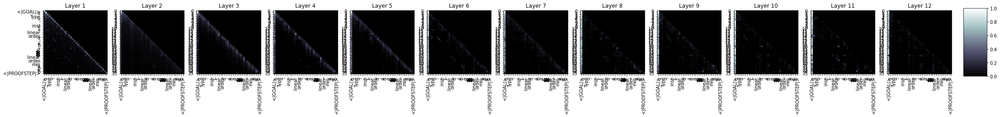

60800it [41:39, 24.83it/s]

  Step 60,800  of  147,271. Loss: 1.3820160627365112.   Elapsed: 0:41:40.
Sample:rw [min_eq_iff_le_eq, le_iff_le, max_eq_iff]<|endoftext|><|PROOFSTEP|>rw min_eq_zero at h<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw [apply_mul, set_apply]<|endoftext|><|PROOFSTEP|>simp [sup_not_infi]<|endoftext|><|PROOFSTEP|>rw sup_not_ {\not_distrib | sup_not_simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>from subtype.1.symm (subtype.2 by simp)<|endoftext|><|PROOFSTEP|>apply_instance_mul<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance_nonneg _<|endoftext|><|PROOFSTEP|>linarisk<|endoftext|><|PROOFSTEP|>apply.mpr<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>by<|endoftext|>R : (a_one _).0.1.1<|endoftext|><|PROOFSTEP|>intro_left (IHI : a_one_neg.0.1.1)<|endoftext|><|PROOFSTEP|>
s -> 0.3840741217136383
rw -> 0.29

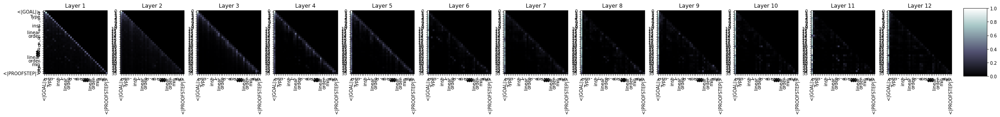

63998it [43:51, 24.07it/s]

  Step 64,000  of  147,271. Loss: 0.8547144532203674.   Elapsed: 0:43:51.
Sample:split<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp only [finset.mem_succ]<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp_assoc<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simpa only [pow_nhds, eq_nil_of_neg, ← mul_eq_add_neg]<|endoftext|><|PROOFSTEP|>simp_self<|endoftext|><|PROOFSTEP|>exists_eq_pow_le_one_eq_pow_neg<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>intros<|endoftext|>M<|endoftext|><|PROOFSTEP|>simp<|endoftext|>R : P := (S).1, (pow_pos.2 $ S).1, (pow_pos.2 $ S).2, (pow_pos.1 $ S).3, (pow_pos.2 $ S).2, (pow_pos.1 $ S).2<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_apply_instance<|endoftext|><|PROOFSTEP|>
s -> 0.33549442887306213
rw -> 0.17591017484664917
ex -> 0.1414921134710312
apply -> 0.1015314981341362
cases -> 0.09503879398107529

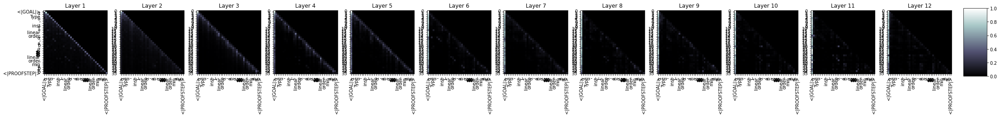

67199it [46:01, 29.32it/s]

  Step 67,200  of  147,271. Loss: 1.2057827711105347.   Elapsed: 0:46:02.
Sample:simp only [max_eq]<|endoftext|><|PROOFSTEP|>cases b<|endoftext|><|PROOFSTEP|>tangent_eq_max<|endoftext|><|PROOFSTEP|>rw [eq_max_eq]<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>ext h<|endoftext|><|PROOFSTEP|>exact ⟨le_refl, bx⟩⟩<|endoftext|><|PROOFSTEP|>tsum.le_lt_ne<|endoftext|><|PROOFSTEP|>rw ← nat.exists_ne<|endoftext|><|PROOFSTEP|>cases_b<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>cases_b<|endoftext|>d<|endoftext|><|PROOFSTEP|>simp<|endoftext|>d := classical.trans<|endoftext|><|PROOFSTEP|><|endoftext|><|PROOFSTEP|>exact this<|endoftext|>Iic.1<|endoftext|>exactIic.2 {<|endoftext|>IK := classical.trans, sub_Iic k.1<|endoftext|><|PROOFSTEP|>exactIic.2 (of IK.1 (in_sub_cancel IK.2.1)<|endoftext|><|PROOFSTEP|>exactIic<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp [←1]<|endoftext|><|PROOFSTEP|>exactIic.2
s -> 0.29931584000587463
ex -> 0.171447

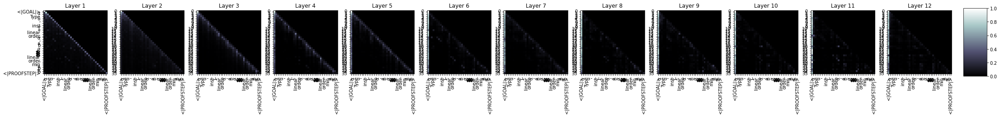

70399it [48:11, 26.35it/s]

  Step 70,400  of  147,271. Loss: 0.677676796913147.   Elapsed: 0:48:12.
Sample:rw [min_le_iff_eq_max_of_eq (le_max_of_le (le_max_of_le a b),lt_of_lt] at b]<|endoftext|><|PROOFSTEP|>exact I_le_mul_le.1 _<|endoftext|><|PROOFSTEP|>try {tactic}<|endoftext|><|PROOFSTEP|>refl<|endoftext|><|PROOFSTEP|>simp only [set_image, ←image_apply, tsum]<|endoftext|><|PROOFSTEP|>by_cases ih<|endoftext|><|PROOFSTEP|>exact tsum<|endoftext|><|PROOFSTEP|>simp_instance<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>sapply<|endoftext|><|PROOFSTEP|>rw [set_image_apply]<|endoftext|><|PROOFSTEP|>simp_eq<|endoftext|><|PROOFSTEP|>apply_eq<|endoftext|><|PROOFSTEP|>simp_subset<|endoftext|>← nat.sub_eq<|endoftext|><|PROOFSTEP|>apply<|endoftext|><|PROOFSTEP|>simp_apply<|endoftext|>1 : inv (inset (intr_const_inset).trans (coe_in (coe_inset (inset (coe_inset (coe_inset (in
s -> 0.3509233593940735
rw -> 0.17679695785045624
ex -> 0.16537192463874817
cases -> 0.09328048676252365
apply -> 0.08970627933740616
int ->

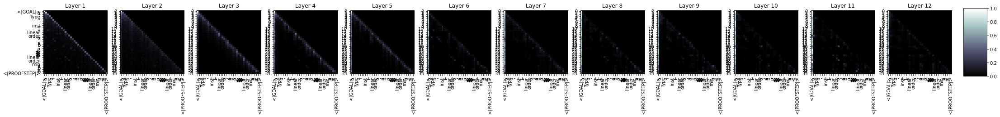

73600it [50:21, 25.73it/s]

  Step 73,600  of  147,271. Loss: 1.2765730619430542.   Elapsed: 0:50:22.
Sample:refine ⟨⟨(a, b)⟩, le_max _⟩<|endoftext|><|PROOFSTEP|>intro h<|endoftext|><|PROOFSTEP|>tidy<|endoftext|><|PROOFSTEP|>injection le<|endoftext|><|PROOFSTEP|>apply nat.succ h_nat_apply<|endoftext|><|PROOFSTEP|>exact nat.ne<|endoftext|><|PROOFSTEP|>simp only [le_antisymm, mul_le_sub, one_eq_iff, single_lt_one]<|endoftext|><|PROOFSTEP|>intros x hx hy<|endoftext|><|PROOFSTEP|>t<|endoftext|><|PROOFSTEP|>rw hx<|endoftext|><|PROOFSTEP|>intro<|endoftext|><|PROOFSTEP|>rintros [← eiff_le_left]<|endoftext|><|PROOFSTEP|>have h1 : eiff_le_right.1 h2<|endoftext|><|PROOFSTEP|>assumption<|endoftext|><|PROOFSTEP|>s a<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>s rfl<|endoftext|>fld<|endoftext|>refl<|endoftext|>[1]<|endoftext|><|PROOFSTEP|>triviality<|endoftext|>refl<|endoftext|>brefl<|endoftext|>R : rfl.is, is.is.is.is.is, rfl.is.
s -> 0.3562103807926178
ex -> 0.20800445973873138
rw -> 0.18307307362556458
apply -> 

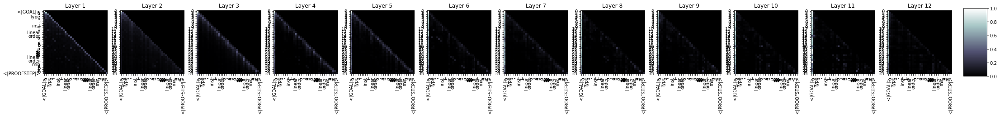

76799it [52:33, 25.76it/s]

  Step 76,800  of  147,271. Loss: 1.7243802547454834.   Elapsed: 0:52:34.
Sample:let g : α → α := min_lt_max 1<|endoftext|><|PROOFSTEP|>intros h₂ h₁ h₂<|endoftext|><|PROOFSTEP|>intros hs₁ hs₂<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>tac at hs₁<|endoftext|><|PROOFSTEP|>convert wf_eq.le<|endoftext|><|PROOFSTEP|>simp [wf_def, eq_def, int.def]<|endoftext|><|PROOFSTEP|>have fun with a s<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|><|PROOFSTEP|>rw eq_def<|endoftext|>S<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>apply_instance<|endoftext|>a<|endoftext|>H1<|endoftext|>m using H1m h1<|endoftext|>I : (1) (m, p1)<|endoftext|><|PROOFSTEP|>rw [add_comm, add_comm, one_comm_eq_singleton], one_eq_singleton<|endoftext|><|PROOFSTEP|>simp<|endoftext|><|PROOFSTEP|>have, h1m<|endoftext|><|PROOFSTEP|>sub_comp<|endoftext|>
s -> 0.5437478423118591
ex

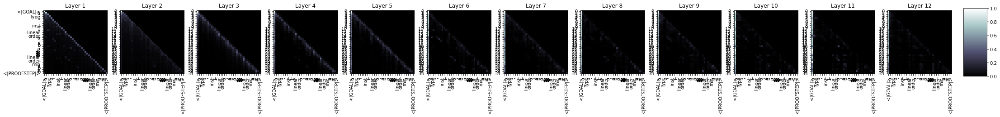

79999it [54:46, 24.94it/s]

  Step 80,000  of  147,271. Loss: 1.677416443824768.   Elapsed: 0:54:47.


In [ ]:
import regex as re

# Wandb manage model weights statistics 
if is_experimenting:
    wandb.watch(model)

total_t0 = time.time()
# training_stats = []
# min_val_loss = float('inf')

for epoch_i in range(current_epoch+1, epochs):

    # ========================================
    #               Training
    # ========================================

    print("")
    print('======== Epoch {:} / {:} ========'.format(epoch_i, epochs))
    print('Training...')
    
    t0 = time.time()
    model.train()
    total_train_loss = 0
    loss = 0
    for step, batch in tqdm(enumerate(train_dataloader)):
        
        b_input_ids = batch[0].to(device).unsqueeze(0) # Need to have 2 sizes
#         print(enc.decode(b_input_ids.cpu().numpy()[0]))
        
#         b_labels = batch[0].to(device)
#         b_masks = batch[1].to(device)

        model.zero_grad()        
        outputs = model(b_input_ids,
                        lm_labels=b_input_ids,) 
#                           attention_mask=b_masks,)\
#         print(outputs)
#         raise
        loss = outputs[0] 
#         print(loss)
#         raise
        batch_loss = loss.item()
        total_train_loss += batch_loss
        loss /= gradient_acc_steps 
        
        # Attention table
        
        # Get sample every x batches.
        if (step/gradient_acc_steps) % sample_every == 0 and not step == 0:
            elapsed = format_time(time.time() - t0)
            print('  Step {:>5,}  of  {:>5,}. Loss: {:>5,}.   Elapsed: {:}.'.format(step, len(train_dataloader), batch_loss, elapsed))
            model.eval()
            
            # Generate a sample sequence
            context_text = " <|GOAL|>α : Type u,\n_inst_1 : linear_order α,\na b : α\n⊢ linear_order.min a b ≤ b <|PROOFSTEP|>" # Answer: 'min_tac a b'
            context_tokens = enc.encode(context_text)
            out = sample_sequence(
                model=model, length=200,
                context=context_tokens,
                batch_size=1,
                temperature=0.95, 
                top_k=50, device=device
            )
            out = out[:, len(context_tokens):].tolist()
            text = enc.decode(out[0])
            print(f"Sample:{text}")

            # Show attention table
            display_attn_and_confidence(model, context_text)
            
            model.train()
        
        # Update
        loss.backward()
        
        if (step+1) % gradient_acc_steps == 0 or (step + 1 == len(train_dataloader)):            
            optimizer.step()
            scheduler.step()
            if is_experimenting:
                wandb.log(
                    {
                        "epoch": epoch_i,
                        'batch_loss': batch_loss
                    }
                )
                # wandb log attention table
    #             wandb.join()
        
    # Report training
    avg_train_loss = total_train_loss / len(train_dataloader)       
    training_time = format_time(time.time() - t0)
    print("")
    print("  Average training loss: {0:.2f}".format(avg_train_loss))
    print("  Training epoch took: {:}".format(training_time))
        
    # ========================================
    #               Validation
    # ========================================
    
    print("")
    print("Running Validation...")

    t0 = time.time()
    model.eval()
    total_eval_loss = 0
    nb_eval_steps = 0
    # Evaluate data for one epoch
    for batch in validation_dataloader:
        
        b_input_ids = batch[0].to(device).unsqueeze(0)
#         b_labels = batch[0].to(device)
#         b_masks = batch[1].to(device)  
        
        with torch.no_grad():        
            outputs  = model(b_input_ids, 
                             lm_labels=b_input_ids,) 
#                            token_type_ids=None, 
#                              attention_mask = b_masks,          
            loss = outputs[0]  
        batch_loss = loss.item()
        total_eval_loss += batch_loss        

    # Report validation
    avg_val_loss = total_eval_loss / len(validation_dataloader)
    if min_val_loss > avg_val_loss:
        min_val_loss = avg_val_loss
    validation_time = format_time(time.time() - t0)    
    print("  Validation Loss: {0:.2f}".format(avg_val_loss))
    print("  Validation took: {:}".format(validation_time))
    
    # Record all statistics from this epoch.
    training_stats.append(
        {
            'epoch': epoch_i + 1,
            'Training Loss': avg_train_loss,
            'Valid. Loss': avg_val_loss,
            'Training Time': training_time,
            'Validation Time': validation_time
        }
    )
    
    if save_model_on_epoch:
        # Save training stats
        with open(os.path.join(output_dir, "stats.json"), 'w') as f:
            json.dump(training_stats, f)
        # Save two files: current best model and current epoch model
        if avg_val_loss < min_val_loss:
            torch.save(
                model.state_dict(),
                os.path.join(output_dir, f"{output_prefix}-best.pt"),
            )
        torch.save(
            model.state_dict(),
            os.path.join(output_dir, f"{output_prefix}-{epoch_i}.pt"),
        )
        if epoch_i > 1 and epoch_i != 2 and epoch_i != 3 and epoch_i != 5 and epoch_i != 9 and epoch_i != 17 and epoch_i != 33:
            # Remove previous checkpoint
            os.remove(os.path.join(output_dir, f"{output_prefix}-{epoch_i-1}.pt"))

print("")
print("Training complete!")
print("Total training took {:} (h:mm:ss)".format(format_time(time.time()-total_t0)))
type(model) == GPT2LMHeadModel

In [ ]:
# Need to generate lyrics for test set, get loss, evaluate on persplexity, bleu and rougev 
# Want to see model's confidence knowing context as well -> attention 

In [ ]:
# Need to check if exists directory, if no, try to create
# Try save a dummy model and delete it
# These checks are done at the start of notebook
# Resume: Check if the directory has a checkpoint

In [ ]:
config = GPT2Config()
# model = GPT2LMHeadModel(config)
config.vocab_size += 2
model, current_epoch, min_val_loss, training_stats = load_checkpoint(config, output_dir, output_prefix)

In [ ]:
def print_nested_tuple(x):
    if type(x) == tuple:
        print(len(x))
        for y in x:
            print_nested_tuple(y)
    else:
        print(x.shape)

In [ ]:
# ========================================
#               Test
# ========================================

length = 20
temperature=0.7
top_k=40
model.cuda()

print("")
print("Running Test...")

t0 = time.time()
model.eval()
total_eval_loss = 0
# Evaluate data for one epoch
for i, batch in tqdm(enumerate(test_dataloader)):
    
    b_input_ids = batch.to(device).view(batch_size, -1)
#     print(b_input_ids.shape)
#         b_labels = batch[0].to(device)
#         b_masks = batch[1].to(device)  

    with torch.no_grad():   
          
        # Find loss
        loss, _, _  = model(b_input_ids, 
                         lm_labels=b_input_ids,)
    
    batch_loss = loss.item()
    total_eval_loss += batch_loss
    
#     print(f"Outputs have {len(outputs)} items:\noutputs[0]={outputs[0]}\noutputs[1]={outputs[1].shape}\noutputs[2]={[x.shape for x in outputs[2]]}")
#     if i >= 3:
#         break
    
# Report test
avg_test_loss = total_eval_loss / len(test_dataloader)
test_time = format_time(time.time() - t0)    
print("  Test Loss: {0:.2f}".format(avg_test_loss)) #2.25
print("  Test took: {:}".format(test_time))
len(contexts), len(true_lyrics), len(generated_lyrics)

contexts[7]+"|||"+true_lyrics[7], contexts[7]+"|||"+generated_lyrics[7]

# #Finish the sentences when there is a point, remove after that
final=[]

for i in range(len(true_lyrics)):
    to_remove = generated_lyrics[i].split('.')[-1]
    final.append(generated_lyrics[i].replace(to_remove,''))

# test_set['Generated_lyrics'] = final
# test_set.head()

#Using BLEU score to compare the real sentences with the generated ones
import statistics
from nltk.translate.bleu_score import sentence_bleu

scores=[]

for i in range(len(true_lyrics)):
    reference = [true_lyrics[i]]
    candidate = final[i]
    scores.append(sentence_bleu(reference, candidate))

statistics.mean(scores)

#Rouge score
from rouge import Rouge
rouge=Rouge()

rouge.get_scores(final, true_lyrics, avg=True, ignore_empty=True)

In [ ]:
# from torch.utils.data import DataLoader
# from torch.utils.data import RandomSampler, SequentialSampler

# # Create the DataLoaders for our datasets.
# # We'll take training samples in random order. 
# train_dataloader = DataLoader(
#             train_dataset,  # The training samples.
#             sampler = RandomSampler(train_dataset), # Select batches randomly
#             batch_size = batch_size # Trains with this batch size.
#         )
# # For validation and test the order doesn't matter, so we'll just read them sequentially.
# validation_dataloader = DataLoader(
#             val_dataset, # The validation samples.
#             sampler = SequentialSampler(val_dataset), # Pull out batches sequentially.
#             batch_size = batch_size # Evaluate with this batch size.
#         )
# test_dataloader = DataLoader(
#             test_dataset, # The validation samples.
#             sampler = SequentialSampler(test_dataset), # Pull out batches sequentially.
#             batch_size = batch_size # Evaluate with this batch size.
#         )

In [ ]:
# Each entry of the matrix is a row in attention table (for wandb logging)
        # Log wandb
#         columns=["s_ind", "t_ind", "s_word", "t_word", "attn"]
#         attn_table = wandb.Table(columns=columns)
#         temp = context_text.split(" ")
#         for s_ind in range(seq_len):
#                 attn_table.add_data(s_ind, t_ind, temp[s_ind], temp[t_ind], attn_maps[row][column][0][s_ind][t_ind])
#         wandb.log({"attn_table": attn_table})